In [1]:
import time
import torch
import json
import random
import math
import warnings
import torchvision
import os
import torchvision.transforms as transforms
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
import torchvision.models as models
from pathlib import Path
from collections import OrderedDict
import shutil

from pathlib import Path
from tqdm import tqdm
from PIL import Image
from sklearn import metrics
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report, precision_recall_fscore_support
from torch.utils.data import Dataset, DataLoader
from torchvision.models import EfficientNet
from utils.loss_functions import tkd_kdloss
from utils.loss_functions import DKDLoss, DirectNormLoss, KDLoss
from torch.optim import lr_scheduler
from utils.misc_tools import best_LR_wider


# Suppress all warnings
warnings.filterwarnings("ignore")

In [2]:
# Hyperparameters / Inputs
teacher_learning_rate = 0.001                 # 0.0003987876097113909
student_learning_rate = teacher_learning_rate # 0.08502421780208597
teacher_epochs = 10
student_epochs = teacher_epochs
teacher_patience = 12
student_patience = 180
temperature = 4.0
alpha = 0.9
momentum = 0.9
batch_size = 64
num_workers = 4
weight_decay = 1e-5
epsilon = 0.05
margin = 0.01
num_classes = 16
base_save_dir = "disparity_pipeline_out"
teacher_name = 'efficientnetb3'

# list of lambda values to loop through for grid search
teacher_lambda_factor_list = [0]
# student_lambda_factor_list = [0,20,40,80,100,150]
student_lambda_factor_list = [0,5,10,15,20,25,30,40,80,100,150]

In [3]:
# labels used including for plotting
class_labels = [0, 1, 3, 4, 6, 7, 11, 15, 17, 18, 19, 20, 22, 25, 27, 28, 30, 31, 33, 35, 36, 37, 39, 43, 44, 50, 51, 54, 57, 58]
class_labels_new = torch.tensor([i for i in range(len(class_labels))])
class_names_new = [f"Class {label}" for label in range(num_classes)]


In [4]:
# set device to cuda if available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [5]:
file_path = './WIDER/Annotations/wider_attribute_trainval.json'

with open(file_path, 'r') as file:
    # Load the JSON data from the file
    data = json.load(file)

class_idx = data['scene_id_map']

In [6]:
new_label_mapping = {
    0: "Team_Sports",
    1: "Celebration",
    2: "Parade",
    3: "Waiter_Or_Waitress",
    4: "Individual_Sports",
    5: "Surgeons",
    6: "Spa",
    7: "Law_Enforcement",
    8: "Business",
    9: "Dresses",
    10: "Water_Activities",
    11: "Picnic",
    12: "Rescue",
    13: "Cheering",
    14: "Performance_And_Entertainment",
    15: "Family"
}

# Ensure that all 16 new classes are covered
# If some classes are not explicitly mentioned in new_label_mapping, add them
for i in range(num_classes):
    if i not in new_label_mapping:
        new_label_mapping[i] = "Additional Category {}".format(i)

class_idx = new_label_mapping

In [7]:
class DataSet(Dataset):
    def __init__(self, ann_files, augs, img_size, dataset):

        # Create a mapping from old labels to new labels
        self.label_mapping = {old_label: new_label for new_label, old_label in enumerate(sorted(class_labels))}

        self.new_label_mapping = {
            0: 2,  # Parade
            1: 8,  # Business
            2: 7,  # Law Enforcement
            3: 14,  # Performance and Entertainment
            4: 1,  # Celebration
            5: 13,  # Cheering
            6: 8,  # Business
            7: 8,  # Business
            8: 1,  # Celebration
            9: 14,  # Performance and Entertainment
            10: 15, # Family
            11: 15, # Family
            12: 11, # Picnic
            13: 7, # Law Enforcement
            14: 6, # Spa
            15: 13, # Cheering
            16: 5, # Surgeons
            17: 3, # Waiter or Waitress
            18: 4, # Individual Sports
            19: 0, # Team Sports
            20: 0, # Team Sports
            21: 0, # Team Sports
            22: 4, # Individual Sports
            23: 10, # Water Activities
            24: 4, # Individual Sports
            25: 1, # Celebration
            26: 9, # Dresses
            27: 12, # Rescue
            28: 10,# Water Activities
            29: 0  # Team Sports
        }

        self.dataset = dataset
        self.ann_files = ann_files
        self.augment = self.augs_function(augs, img_size)
        # Initialize transformations directly
        self.transform = transforms.Compose(
            [
                transforms.ToTensor(),
                transforms.Normalize(mean=[0, 0, 0], std=[1, 1, 1])
            ] 
        )
        if self.dataset == "wider":
            self.transform = transforms.Compose(
                [
                    transforms.ToTensor(),
                    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])                ] 
            )        

        self.anns = []
        self.load_anns()
        print(self.augment)

    def augs_function(self, augs, img_size):            
        t = []
        if 'randomflip' in augs:
            t.append(transforms.RandomHorizontalFlip())
        if 'ColorJitter' in augs:
            t.append(transforms.ColorJitter(brightness=0.5, contrast=0.5, saturation=0.5, hue=0))
        if 'resizedcrop' in augs:
            t.append(transforms.RandomResizedCrop(img_size, scale=(0.7, 1.0)))
        if 'RandAugment' in augs:
            t.append(transforms.RandAugment())

        t.append(transforms.Resize((img_size, img_size)))

        return transforms.Compose(t)
    
    def load_anns(self):
        self.anns = []
        for ann_file in self.ann_files:
            json_data = json.load(open(ann_file, "r"))
            self.anns += json_data

    def __len__(self):
        return len(self.anns)

    def __getitem__(self, idx):
        # Make sure the index is within bounds
        idx = idx % len(self)
        ann = self.anns[idx]
        
        try:
            # Attempt to open the image file
            img = Image.open(f'WIDER/Image/{ann["file_name"]}').convert("RGB")

            # x, y, w, h = ann['bbox']
            # img_area = img.crop([x, y, x+w, y+h])
            img_area = self.augment(img)
            img_area = self.transform(img_area)
            attributes_list = [target['attribute'] for target in ann['targets']]
            attributes_list = [[max(0, element) for element in inner_list] for inner_list in attributes_list]
            num_people = len(attributes_list)
            attributes_distribution = [max(sum(attribute), 0)/num_people for attribute in zip(*attributes_list)]
            # Extract label from image path
            img_path = f'WIDER/Image/{ann["file_name"]}'
            label = self.extract_label(img_path)
            
            return {
                "file": ann["file_name"],
                "label": label,
                "target": torch.tensor([attributes_distribution[0]], dtype=torch.float32),
                "img": img_area
            }
            
        except Exception as e:
            # If any error occurs during the processing of an image, log the error and the index
            print(f"Error processing image at index {idx}: {e}")
            # Instead of returning None, raise the exception
            raise

    def extract_label(self, img_path):
        original_label = None
    
        if "WIDER/Image/train" in img_path:
            label_str = img_path.split("WIDER/Image/train/")[1].split("/")[0]
            original_label = int(label_str.split("--")[0])
        elif "WIDER/Image/test" in img_path:
            label_str = img_path.split("WIDER/Image/test/")[1].split("/")[0]
            original_label = int(label_str.split("--")[0])
        elif "WIDER/Image/val" in img_path:  # Handle validation images
            label_str = img_path.split("WIDER/Image/val/")[1].split("/")[0]
            original_label = int(label_str.split("--")[0])
    
        if original_label is not None:
            remapped_label = self.label_mapping[original_label]
            new_label_mapping = self.new_label_mapping[remapped_label]
            return new_label_mapping
        else:
            raise ValueError(f"Label could not be extracted from path: {img_path}")

In [8]:
train_file = ['data/wider/trainval_wider.json']
test_file = ['data/wider/test_wider.json']


In [9]:
def custom_collate(batch):
    # Filter out any None items in the batch
    batch = [item for item in batch if item is not None]
    # If after filtering the batch is empty, handle this case by either returning an empty tensor or raising an exception
    if len(batch) == 0:
        raise ValueError("Batch is empty after filtering out None items.")
    return torch.utils.data.dataloader.default_collate(batch)


In [10]:
# train_dataset = DataSet(train_file, augs = ['RandAugment'], img_size = 226, dataset = 'wider')
train_dataset = DataSet(train_file, augs = [], img_size = 226, dataset = 'wider')
test_dataset = DataSet(test_file, augs = [], img_size = 226, dataset = 'wider')

trainloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, 
                         num_workers=num_workers, collate_fn=custom_collate)
testloader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=num_workers, collate_fn=custom_collate)


Compose(
    Resize(size=(226, 226), interpolation=bilinear, max_size=None, antialias=warn)
)
Compose(
    Resize(size=(226, 226), interpolation=bilinear, max_size=None, antialias=warn)
)


In [11]:
def one_hot_encode(labels, num_classes):
    return np.eye(num_classes)[labels]

def calculate_recall_multiclass(conf_matrix):
    recalls = np.diag(conf_matrix) / np.sum(conf_matrix, axis=1)
    recalls[np.isnan(recalls)] = 0
    return recalls

def evaluate_model_with_gender_multiclass(pred, label, gender, num_classes):
    predictions = pred.cpu()
    true_labels = label.cpu()
    gender = gender.cpu()

    # Identify male and female indices based on the gender threshold
    male_indices = np.where(gender >= 0.5)[0]
    female_indices = np.where(gender < 0.5)[0]

    # Convert labels to one-hot encoding
    one_hot_labels = one_hot_encode(true_labels, num_classes=num_classes)
    one_hot_preds = one_hot_encode(predictions, num_classes=num_classes)

    # Initialize recall arrays
    male_recall = np.zeros(num_classes)
    female_recall = np.zeros(num_classes)

    # Extract predictions and labels for male and female indices
    male_predictions = np.argmax(one_hot_preds[male_indices], axis=1)
    female_predictions = np.argmax(one_hot_preds[female_indices], axis=1)
    male_labels = np.argmax(one_hot_labels[male_indices], axis=1)
    female_labels = np.argmax(one_hot_labels[female_indices], axis=1)

    # Check if the class labels are within the expected range
    assert (0 <= male_predictions.min() < num_classes) and (0 <= male_predictions.max() < num_classes), "Invalid class indices in male predictions"
    assert (0 <= female_predictions.min() < num_classes) and (0 <= female_predictions.max() < num_classes), "Invalid class indices in female predictions"
    assert (0 <= male_labels.min() < num_classes) and (0 <= male_labels.max() < num_classes), "Invalid class indices in male labels"
    assert (0 <= female_labels.min() < num_classes) and (0 <= female_labels.max() < num_classes), "Invalid class indices in female labels"

    # Calculate confusion matrices for each gender
    male_conf_matrix = confusion_matrix(male_labels, male_predictions, labels=np.arange(num_classes))
    female_conf_matrix = confusion_matrix(female_labels, female_predictions, labels=np.arange(num_classes))

    # Calculate recall for each class and gender
    male_recall[:len(male_conf_matrix)] = calculate_recall_multiclass(male_conf_matrix)
    female_recall[:len(female_conf_matrix)] = calculate_recall_multiclass(female_conf_matrix)

    return male_recall - female_recall, male_conf_matrix, female_conf_matrix


In [12]:
class Critic(nn.Module):
    def __init__(self, input_size, hidden_size=256):
        super(Critic, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_size)
        self.fc2 = nn.Linear(hidden_size, 1)  # Outputting a single value for bias

    def forward(self, x):
        x = F.relu(self.fc1(x))
        x = torch.sigmoid(self.fc2(x))
        return x
        

In [13]:
def get_emb_fea(model, dataloader):
    ''' Used to extract the feature embeddings in a teacher model '''
    
    def get_features(name):
        def hook(model, input, output):
            features[name] = output.detach()
        return hook

    
    model.eval()
    model.avgpool.register_forward_hook(get_features('feats'))

    EMB = {}


    with torch.no_grad():

        for batch_data in dataloader:
            FEATS = []
            features = {}
            # images, labels = images.cuda(), labels.cuda()
            images = batch_data["img"].to(device)
            labels = batch_data["label"].to(device)
            curr_batch_size = len(images)


            # compute output
            # emb_fea, logits = model(images, embed=True)
            outputs = model(images)
            # feats = features['feats'].cpu().numpy()
            # emb_fea = feats.flatten()
            FEATS.append(features['feats'].cpu().numpy())
            emb_fea = np.concatenate(FEATS)
            # reshape embedding features to flatten 
            emb_fea = emb_fea.reshape((curr_batch_size, emb_fea.shape[1]))


            for emb, i in zip(emb_fea, labels):
                i = i.item()
                emb_size = len(emb) 
                if str(i) in EMB:
                    for j in range(emb_size):
                        EMB[str(i)][j].append(round(emb[j].item(), 4))
                else:
                    EMB[str(i)] = [[] for _ in range(emb_size)]
                    for j in range(emb_size):
                        EMB[str(i)][j].append(round(emb[j].item(), 4))

    for key, value in EMB.items():
        for i in range(emb_size):
            EMB[key][i] = round(np.array(EMB[key][i]).mean(), 4)

    return EMB

def retrieve_teacher_class_weights(model, lmda, data_name, dataloader, model_name, best_model_weights):
    ''' Use the extracted feature embeddings to create a json of class means for teacher'''

    # session = boto3.session.Session()
    # s3 = session.client('s3')

    # teacher_model_weights_buffer = io.BytesIO()
    # s3.download_fileobj(bucket_name, model_weight_path, teacher_model_weights_buffer)
    # teacher_model_weights_buffer.seek(0)  

    # # Load the model
    # # model = models_package.__dict__[model_name](num_class=num_class)
    # checkpoint = torch.load(teacher_model_weights_buffer)
    # # print("Keys in checkpoint:", checkpoint.keys())
    
    # print("model is loaded properly")
    # checkpoint = model.state_dict()
    checkpoint = best_model_weights

    new_state_dict = OrderedDict()
    for k, v in checkpoint.items():
        name = k[7:] if k.startswith('module.') else k
        new_state_dict[name] = v
    model.load_state_dict(new_state_dict)
    model.eval()

    for param in model.parameters():
        param.requires_grad = False
    
    model = model.cuda()

    # emb = get_emb_fea(model=model, dataloader=dataloader, batch_size=batch_size)
    # emb_json = json.dumps(emb, indent=4)
    # with open("./class_means/{}_embedding_fea/{}.json".format(data_name, model_name), 'w', encoding='utf-8') as f:
    #     f.write(emb_json)

    emb = get_emb_fea(model=model, dataloader=dataloader)
    emb_json = json.dumps(emb, indent=4)

    # Create the directory if it doesn't exist
    output_dir = "./class_means/{}_embedding_fea".format(data_name)
    os.makedirs(output_dir, exist_ok=True)

    with open("{}/{}_lmda_{}.json".format(output_dir, model_name, lmda), 'w', encoding='utf-8') as f:
        f.write(emb_json)

In [14]:
def train_teacher(teacher, teacher_optimizer, teacher_loss_fn, patience=teacher_patience, 
                  epochs=teacher_epochs, device=device, base_save_dir=base_save_dir, teacher_name=teacher_name):
    
    train_accuracies = []
    train_disparities = []
    train_mean_non_zero_abs_disparities = []
    train_losses = []
    train_main_losses = []
    val_accuracies = []
    val_disparities = []
    val_mean_non_zero_abs_disparities = []
    val_losses = []
    val_main_losses = []
    
    patience_counter = 0 
    best_val_accuracy = 0
    best_val_loss = float('inf')
    best_val_mean_abs_disparity = 0
    teacher_best_model_state = None

    # Create a subdirectory for the current lambda_factor
    lambda_dir = os.path.join(base_save_dir, f'TEACHER_lambda_{lambda_factor}')
    os.makedirs(lambda_dir, exist_ok=True)

    print(f'Training Teacher with Lambda Value of {lambda_factor}')
    
    # Training and Validation Loop
    for epoch in range(epochs):
        # Initialize metrics for each epoch
        epoch_train_disparities = []
        epoch_train_losses = []
        epoch_train_accuracies = []
        epoch_val_disparities = []
        epoch_val_losses = []
        epoch_val_accuracies = []
    
        confusion_male = np.zeros((num_classes, num_classes))
        confusion_female = np.zeros((num_classes, num_classes))
        total_correct = 0
        total_samples = 0
        total_val_loss = 0.0
        num_batches = 0
        
        # Training
        for batch_data in tqdm(trainloader, desc=f'Epoch {epoch+1}/{epochs}, Training'):
            # Load data to device
            teacher.train()
            teacher.to(device)
            images = batch_data["img"].to(device)
            labels = batch_data["label"].to(device)
            gender_scores = batch_data["target"].to(device)
    
            teacher_optimizer.zero_grad()            
            # Forward pass through actor
            teacher_output = teacher(images)
    
            main_loss = teacher_loss_fn(teacher_output, labels)
            class_predictions = torch.argmax(teacher_output, dim=1)


            main_loss.backward()
            teacher_optimizer.step()
    
            # Calculate and accumulate metrics
            accuracy = (class_predictions == labels).float().mean().item()
            epoch_train_accuracies.append(accuracy)
    
            total_samples += labels.size(0)
            total_correct += (class_predictions == labels).sum().item()
            num_batches += 1
            recall_diff = evaluate_model_with_gender_multiclass(class_predictions, labels, gender_scores, num_classes=num_classes)
            confusion_male += recall_diff[1]
            confusion_female += recall_diff[2]
            bias = np.mean(recall_diff[0])
            epoch_train_disparities.append(bias)        
            # Record the losses
            epoch_train_losses.append(main_loss.item())
    
        confusion_male /= num_batches
        confusion_female /= num_batches
    
        # Calculate training metrics for the epoch
        train_epoch_disparity = calculate_recall_multiclass(confusion_male) - calculate_recall_multiclass(confusion_female)
        train_non_zero_abs_values = np.abs(train_epoch_disparity[train_epoch_disparity != 0])
        
        # Store average training metrics for the epoch
        train_accuracy = np.mean(epoch_train_accuracies)
        train_disparity = np.mean(epoch_train_disparities)
        train_mean_non_zero_abs_disparity = np.mean(train_non_zero_abs_values)
        train_main_loss = np.mean([x for x in epoch_train_losses])
        train_accuracies.append(train_accuracy)
        train_disparities.append(train_disparity)
        train_mean_non_zero_abs_disparities.append(train_mean_non_zero_abs_disparity)
        train_main_losses.append(train_main_loss)

    
        # Validation Phase
        confusion_male = np.zeros((num_classes, num_classes))
        confusion_female = np.zeros((num_classes, num_classes))
        total_correct = 0
        total_samples = 0
        num_batches = 0
        
        teacher.eval()
        with torch.no_grad():
            for batch_data in tqdm(testloader, desc=f'Epoch {epoch+1}/{epochs}, Validation'):
                # Load data to device
                images = batch_data["img"].to(device)
                labels = batch_data["label"].to(device)
                gender_scores = batch_data["target"].to(device)
        
                # Forward pass
                teacher_output = teacher(images)
                class_predictions = torch.argmax(teacher_output, dim=1)
        
                # Calculate and accumulate validation metrics
                accuracy = (class_predictions == labels).float().mean().item()
    
                # Compute bias
                num_batches += 1
                recall_diff = evaluate_model_with_gender_multiclass(class_predictions, labels, gender_scores, num_classes=num_classes)
                confusion_male += recall_diff[1]
                confusion_female += recall_diff[2]
                
                # Calculate validation losses (similar to training losses)
                batch_bias = np.mean(recall_diff[0])
                val_main_loss = teacher_loss_fn(teacher_output, labels)
            
                epoch_val_accuracies.append(accuracy)
                epoch_val_losses.append(val_main_loss.item())
                
            confusion_male /= num_batches
            confusion_female /= num_batches
    
            val_epoch_disparity = calculate_recall_multiclass(confusion_male) - calculate_recall_multiclass(confusion_female)
            val_non_zero_abs_values = np.abs(val_epoch_disparity[val_epoch_disparity != 0])
    
            # Store average training metrics for the epoch
            val_accuracy = np.mean(epoch_val_accuracies)
            val_disparity = np.mean(epoch_val_disparities)
            val_mean_non_zero_abs_disparity = np.mean(val_non_zero_abs_values)
            val_main_loss = np.mean([x for x in epoch_val_losses])

        
            val_accuracies.append(val_accuracy)
            val_disparities.append(val_disparity)
            val_mean_non_zero_abs_disparities.append(val_mean_non_zero_abs_disparity)
            val_main_losses.append(val_main_loss)


            # Check if current validation combined loss is lower than the best combined loss
        if val_main_loss < best_val_loss:
            best_val_loss = val_main_loss
            best_val_accuracy = val_accuracy
            best_val_mean_non_zero_abs_disparity = val_mean_non_zero_abs_disparity
        
            # Create a mapping of class recall disparities
            class_recall_mapping = {class_name: val_epoch_disparity[int(class_label)] for class_label, class_name in class_idx.items()}
        
            teacher_best_model_state = {
                'epoch': epoch,
                'teacher_state_dict': teacher.state_dict(),
                'best_val_loss': best_val_loss,
                'best_val_accuracy': best_val_accuracy,
                'best_val_mean_abs_disparity': best_val_mean_non_zero_abs_disparity,
                'class_recall_mapping': class_recall_mapping
            }
            save_path = os.path.join(lambda_dir, f'TEACHER_best_model_lambda_{lambda_factor}.pth')
            torch.save(teacher_best_model_state, save_path)
            patience_counter = 0
        else:
            patience_counter += 1

        if patience_counter >= patience:
            print(f"Early stopping triggered at epoch {epoch+1}")
            break

        print("\n" + "="*50)
        print(f"TEACHER - Lambda {lambda_factor} - Epoch {epoch + 1} Metrics:")
        print("-"*50)
        print(f"TRAINING Accuracy: {train_accuracy:.6f}, VALIDATION Accuracy: {val_accuracy:.4f}")
        print(f"TRAINING Disparity: {train_mean_non_zero_abs_disparity:.6f}, VALIDATION Disparity: {val_mean_non_zero_abs_disparity:.4f}")
        print(f"TRAINING Main Loss: {train_main_loss:.6f}, VALIDATION Main Loss: {val_main_loss:.4f}")
        print("-"*50 + "\n")
        # Print disparities by class label
        for class_label, recall_diff in class_recall_mapping.items():
            print(f"Class {class_label}: Val Disparity = {recall_diff}")
        print("="*50 + "\n")
      
        # Plotting
        plt.figure(figsize=(15, 10))
        
        # Plot Training and Validation Accuracy
        plt.subplot(2, 2, 1)
        plt.plot(train_accuracies, label='Training Accuracy')
        plt.plot(val_accuracies, label='Validation Accuracy')
        plt.title('Teacher Training and Validation Accuracy')
        plt.xlabel('Epoch')
        plt.ylabel('Accuracy')
        plt.legend()
        
        # Plot Training and Validation Disparity
        plt.subplot(2, 2, 2)
        plt.plot(train_mean_non_zero_abs_disparities, label='Training Mean Absolute Disparity')
        plt.plot(val_mean_non_zero_abs_disparities, label='Validation Mean Absolute Disparity')
        plt.title('Teacher Training and Validation Mean Absolute Disparity')
        plt.xlabel('Epoch')
        plt.ylabel('Mean Absolute Disparity')
        plt.legend()
        
        # Plot Training Loss Components, Including Combined Loss
        plt.subplot(2, 2, 3)
        plt.plot(train_main_losses, label='Training Main Loss')
        plt.title('Teacher Training Loss Components')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.legend()
    
        # Plot Validation Loss Components, Including Combined Loss
        plt.subplot(2, 2, 4)
        plt.plot(val_main_losses, label='Validation Main Loss')
        plt.title('Teacher Validation Loss Components')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.legend()
            
        plt.tight_layout()
        plt.show()

    best_epoch = teacher_best_model_state['epoch'] + 1 if teacher_best_model_state else epochs
    # extract class embeddings for teacher
    retrieve_teacher_class_weights(teacher, lambda_factor, 'WIDER', trainloader, teacher_name, best_model_weights = teacher_best_model_state['teacher_state_dict'])
    print(f"Finished Training TEACHER with lambda value of {lambda_factor}. Best epoch number: {best_epoch}")

    return teacher_best_model_state

In [15]:
def train_student(student, teacher, student_optimizer, student_loss_fn, critic, critic_optimizer, critic_loss_fn,
                  lambda_factor, momentum, t, warm_up, weight_decay, T_EMB, num_classes, epsilon=epsilon, margin=margin, patience=student_patience, 
                  epochs=student_epochs, device=device, base_save_dir=base_save_dir, student_scheduler=None, critic_scheduler=None):
    
    def get_features(name):
        def hook(model, input, output):
            features[name] = output.detach()
        return hook
    
    train_accuracies = []
    train_disparities = []
    train_mean_non_zero_abs_disparities = []
    train_losses = []
    train_main_losses = []
    train_critic_losses = []
    train_kd_losses = []
    val_accuracies = []
    val_disparities = []
    val_mean_non_zero_abs_disparities = []
    val_losses = []
    val_main_losses = []
    val_critic_losses = []
    val_kd_losses = []
    
    patience_counter = 0 
    best_val_accuracy = 0
    best_val_loss = float('inf')
    best_val_mean_abs_disparity = 0
    student_best_model_state = None

    warm_up=20.0 #loss weight warm up epochs
    cls_loss_factor =1.0 # cls loss weight factor
    kd_loss_factor =1.0 #KD loss weight factor
    nd_loss_factor =1.0 # ND loss weight factor
    kd_loss = KDLoss(kl_loss_factor=kd_loss_factor, T=t).to(device)
    nd_loss = DirectNormLoss(num_class=num_classes, nd_loss_factor=nd_loss_factor).to(device)
    
    # set up teacher class embeddings
    T_EMB = T_EMB
    
    teacher.eval()
    teacher.to(device)

    student.to(device)
    critic.to(device)
    
    # Create a subdirectory for the current lambda_factor
    lambda_dir = os.path.join(base_save_dir, f'STUDENT_lambda_{lambda_factor}')
    os.makedirs(lambda_dir, exist_ok=True)

    print(f'Training Student with Lambda Value of {lambda_factor}')

    # Training and Validation Loop
    for epoch in range(epochs):
        # Initialize metrics for each epoch
        epoch_train_disparities = []
        epoch_train_losses = []
        epoch_train_accuracies = []
        epoch_val_disparities = []
        epoch_val_losses = []
        epoch_val_accuracies = []
    
        confusion_male = np.zeros((num_classes, num_classes))
        confusion_female = np.zeros((num_classes, num_classes))
        total_correct = 0
        total_samples = 0
        total_val_loss = 0.0
        num_batches = 0
        
        # Training
        student.train()
        for batch_data in tqdm(trainloader, desc=f'Epoch {epoch+1}/{epochs}, Training'):
            # Load data to device
            images = batch_data["img"].to(device)
            labels = batch_data["label"].to(device)
            gender_scores = batch_data["target"].to(device)
            curr_batch_size = len(images)
            
            # set up feature collection for student
            s_FEATS = []
            features = {}

            # set a hook for penultimate layer feature embedding
            student.avgpool.register_forward_hook(get_features('feats'))
            
            # compute output
            student_output = student(images)
            class_predictions = torch.argmax(student_output, dim=1)

            s_FEATS.append(features['feats'].cpu().numpy())
            s_emb = np.concatenate(s_FEATS)
            # reshape embedding features to flatten 
            s_emb = s_emb.reshape((curr_batch_size, s_emb.shape[1]))
            s_emb = torch.from_numpy(s_emb)
            s_emb = s_emb.to(device)
    
            # fix embedding output on student model
            s_emb_size = 1280
            t_emb_size = 1536
            
            emb_inflate = nn.Sequential(
                nn.BatchNorm1d(s_emb_size),
                nn.Dropout(0.5),
                nn.Linear(s_emb_size, t_emb_size)
                )
            # clean_model
            for m in student.modules():
                if isinstance(m, nn.BatchNorm1d):
                    m.weight.data.fill_(1)
                    m.bias.data.zero_()
                elif isinstance(m, nn.Linear):
                    m.bias.data.zero_()
        
            # inflate size of student embeddings to match teacher embedding size
            emb_inflate.to(device)
            s_emb = emb_inflate(s_emb)
        
            logit_inflate = nn.Sequential(
                nn.Linear(1536, num_classes),
                )
            logit_inflate.to(device)
            s_out = logit_inflate(s_emb)

            
            ##
            with torch.no_grad():
                # set up feature collection for teacher
                t_FEATS = []
                features = {}

                # set a hook for penultimate layer feature embedding
                teacher.avgpool.register_forward_hook(get_features('feats'))

                # compute outputs
                teacher_output = teacher(images)
    
                t_FEATS.append(features['feats'].cpu().numpy())
                t_emb = np.concatenate(t_FEATS)
                # reshape embedding features to flatten 
                t_emb = t_emb.reshape((curr_batch_size, t_emb.shape[1]))
            
            t_emb = torch.from_numpy(t_emb)    
            t_emb = t_emb.to(device)
            t_out = teacher.classifier(t_emb)

                
            # Compute bias
            total_samples += labels.size(0)
            total_correct += (class_predictions == labels).sum().item()
            num_batches += 1
            recall_diff = evaluate_model_with_gender_multiclass(class_predictions, labels, gender_scores, num_classes=num_classes)
            confusion_male += recall_diff[1]
            confusion_female += recall_diff[2]
            bias = np.mean(recall_diff[0])
            bias_mean = torch.tensor([bias], device=device, dtype=torch.float32)

            critic_optimizer.zero_grad()
            
            for param in critic.parameters():
                param.requires_grad = True
            for param in student.parameters():
                param.requires_grad = False

            critic.train()
            student.eval()

            critic_output = critic(student_output)
            critic_loss = critic_loss_fn(critic_output, bias_mean)
            critic_loss.backward(retain_graph=True)
    
            critic_optimizer.step()
    
            for param in critic.parameters():
                param.requires_grad = False
            for param in student.parameters():
                param.requires_grad = True
                
            student.train()
            critic.eval()
    
            student_optimizer.zero_grad()
    
            critic_output = critic(student_output)
            
            #cls loss
            cls_loss = student_loss_fn(student_output, labels) * cls_loss_factor
            # KD loss
            div_loss = kd_loss(s_out = s_out, t_out = t_out) * min(1.0, epoch/warm_up)
            # ND loss
            norm_dir_loss = nd_loss(s_emb=s_emb, t_emb=t_emb, T_EMB=T_EMB, labels=labels)
    
            # combined_loss = (cls_loss + div_loss + norm_dir_loss) * max(1, lambda_factor * (abs(critic_output[0][0]) - epsilon + margin) + 1)
            combined_loss = (cls_loss + div_loss + norm_dir_loss) * max(1, lambda_factor * (abs(critic_output[0][0]) - epsilon + margin) + 1) 

            combined_loss.backward(retain_graph=True)
            student_optimizer.step()
    
            # Calculate and accumulate metrics
            accuracy = (class_predictions == labels).float().mean().item()
            epoch_train_accuracies.append(accuracy)
            epoch_train_disparities.append(bias)
        
            # Record the losses
            epoch_train_losses.append((combined_loss.item(), cls_loss.item(), critic_loss.item(), div_loss.item(), norm_dir_loss.item()))
    
        confusion_male /= num_batches
        confusion_female /= num_batches
    
        # Calculate training metrics for the epoch
        train_epoch_disparity = calculate_recall_multiclass(confusion_male) - calculate_recall_multiclass(confusion_female)
        train_non_zero_abs_values = np.abs(train_epoch_disparity[train_epoch_disparity != 0])
        
        # Store average training metrics for the epoch
        train_accuracy = np.mean(epoch_train_accuracies)
        train_disparity = np.mean(epoch_train_disparities)
        train_mean_non_zero_abs_disparity = np.mean(train_non_zero_abs_values)
        train_combined_loss = np.mean([x[0] for x in epoch_train_losses])
        train_main_loss = np.mean([x[1] for x in epoch_train_losses])
        train_critic_loss = np.mean([x[2] for x in epoch_train_losses])
        train_kd_loss = np.mean([x[3] for x in epoch_train_losses])
        

        train_accuracies.append(train_accuracy)
        train_disparities.append(train_disparity)
        train_mean_non_zero_abs_disparities.append(train_mean_non_zero_abs_disparity)
        train_losses.append(train_combined_loss)
        train_main_losses.append(train_main_loss)
        train_critic_losses.append(train_critic_loss)
        train_kd_losses.append(train_kd_loss)

        # Validation Phase
        confusion_male = np.zeros((num_classes, num_classes))
        confusion_female = np.zeros((num_classes, num_classes))
        total_correct = 0
        total_samples = 0
        num_batches = 0
        
        student.eval()
        with torch.no_grad():
            for batch_data in tqdm(testloader, desc=f'Epoch {epoch+1}/{epochs}, Validation'):
                # Load data to device
                images = batch_data["img"].to(device)
                labels = batch_data["label"].to(device)
                gender_scores = batch_data["target"].to(device)
                curr_batch_size = len(images)

                                
                # set up feature collection for student
                s_FEATS = []
                features = {}

                # set a hook for penultimate layer feature embedding
                student.avgpool.register_forward_hook(get_features('feats'))
                
                # Forward pass
                student_output = student(images)
                val_critic_output = critic(student_output)
                class_predictions = torch.argmax(student_output, dim=1)
                
    
                s_FEATS.append(features['feats'].cpu().numpy())
                s_emb = np.concatenate(s_FEATS)
                
                # reshape embedding features to flatten 
                s_emb = s_emb.reshape((curr_batch_size, s_emb.shape[1]))
                s_emb = torch.from_numpy(s_emb)
                s_emb = s_emb.to(device)
        
                # fix embedding output on student model
                s_emb_size = 1280
                t_emb_size = 1536
                
                emb_inflate = nn.Sequential(
                    nn.BatchNorm1d(s_emb_size),
                    nn.Dropout(0.5),
                    nn.Linear(s_emb_size, t_emb_size)
                    )
                # clean_model
                for m in student.modules():
                    if isinstance(m, nn.BatchNorm1d):
                        m.weight.data.fill_(1)
                        m.bias.data.zero_()
                    elif isinstance(m, nn.Linear):
                        m.bias.data.zero_()
            
                # inflate size of student embeddings to match teacher embedding size
                emb_inflate.to(device)
                s_emb = emb_inflate(s_emb)
            
                logit_inflate = nn.Sequential(
                    nn.Linear(1536, num_classes),
                    )
                logit_inflate.to(device)
                s_out = logit_inflate(s_emb)

                
                # val_critic_output = critic(student_output)
                # class_predictions = torch.argmax(student_output, dim=1)
                

                # set up feature collection for teacher
                t_FEATS = []
                features = {}

                # set a hook for penultimate layer feature embedding
                teacher.avgpool.register_forward_hook(get_features('feats'))

                # compute outputs
                teacher_output = teacher(images)
    
                t_FEATS.append(features['feats'].cpu().numpy())
                t_emb = np.concatenate(t_FEATS)
                # reshape embedding features to flatten 
                t_emb = t_emb.reshape((curr_batch_size, t_emb.shape[1]))
            
                t_emb = torch.from_numpy(t_emb)    
                t_emb = t_emb.to(device)
                t_out = teacher.classifier(t_emb)

                                
                # Calculate and accumulate validation metrics
                accuracy = (class_predictions == labels).float().mean().item()
    
                # Compute bias
                num_batches += 1
                recall_diff = evaluate_model_with_gender_multiclass(class_predictions, labels, gender_scores, num_classes=num_classes)
                confusion_male += recall_diff[1]
                confusion_female += recall_diff[2]
                
                # Calculate validation losses (similar to training losses)
                batch_bias = np.mean(recall_diff[0])
                mean_batch_bias = torch.tensor([batch_bias], device=device, dtype=torch.float32)
                val_critic_loss = critic_loss_fn(val_critic_output, mean_batch_bias)

                #cls loss
                val_cls_loss = student_loss_fn(student_output, labels) * cls_loss_factor
                # KD loss
                val_div_loss = kd_loss(s_out = s_out, t_out = t_out) * min(1.0, epoch/warm_up)
                # ND loss
                val_norm_dir_loss = nd_loss(s_emb=s_emb, t_emb=t_emb, T_EMB=T_EMB, labels=labels)
        
                # val_combined_loss = (val_cls_loss + val_div_loss + val_norm_dir_loss) * max(1, lambda_factor * (abs(val_critic_output[0][0]) - epsilon + margin) + 1)
                val_combined_loss = (val_cls_loss + val_div_loss + val_norm_dir_loss) * max(1, lambda_factor * (abs(val_critic_output[0][0]) - epsilon + margin) + 1) 
                    
                epoch_val_accuracies.append(accuracy)
                epoch_val_losses.append((val_combined_loss.item(), val_cls_loss.item(), val_critic_loss.item(), val_div_loss.item(), val_norm_dir_loss.item()))
                
            confusion_male /= num_batches
            confusion_female /= num_batches
    
            val_epoch_disparity = calculate_recall_multiclass(confusion_male) - calculate_recall_multiclass(confusion_female)
            val_non_zero_abs_values = np.abs(val_epoch_disparity[val_epoch_disparity != 0])
    
            # Store average training metrics for the epoch
            val_accuracy = np.mean(epoch_val_accuracies)
            val_disparity = np.mean(epoch_val_disparities)
            val_mean_non_zero_abs_disparity = np.mean(val_non_zero_abs_values)
            val_combined_loss = np.mean([x[0] for x in epoch_val_losses])
            val_main_loss = np.mean([x[1] for x in epoch_val_losses])
            val_critic_loss = np.mean([x[2] for x in epoch_val_losses])
            val_kd_loss = np.mean([x[3] for x in epoch_val_losses])

            val_accuracies.append(val_accuracy)
            val_disparities.append(val_disparity)
            val_mean_non_zero_abs_disparities.append(val_mean_non_zero_abs_disparity)
            val_losses.append(val_combined_loss)
            val_main_losses.append(val_main_loss)
            val_critic_losses.append(val_critic_loss)
            val_kd_losses.append(val_kd_loss)

            critic_scheduler.step(val_critic_loss)
            student_scheduler.step(val_main_loss)

            # Check if current validation combined loss is lower than the best combined loss
        if val_combined_loss < best_val_loss:
            best_val_loss = val_combined_loss
            best_val_accuracy = val_accuracy
            best_val_mean_non_zero_abs_disparity = val_mean_non_zero_abs_disparity
        
            # Create a mapping of class recall disparities
            class_recall_mapping = {class_name: val_epoch_disparity[int(class_label)] for class_label, class_name in class_idx.items()}
        
            student_best_model_state = {
                'epoch': epoch,
                'student_state_dict': student.state_dict(),
                'critic_state_dict': critic.state_dict(),
                'best_val_loss': best_val_loss,
                'best_val_accuracy': best_val_accuracy,
                'best_val_mean_abs_disparity': best_val_mean_non_zero_abs_disparity,
                'class_recall_mapping': class_recall_mapping
            }
            save_path = os.path.join(lambda_dir, f'STUDENT_best_model_lambda_{lambda_factor}.pth')
            torch.save(student_best_model_state, save_path)
            patience_counter = 0
        else:
            patience_counter += 1

        if patience_counter >= patience:
            print(f"Early stopping triggered at epoch {epoch+1}")
            break

        print("\n" + "="*50)
        print(f"STUDENT - Lambda {lambda_factor} - Epoch {epoch + 1} Metrics:")
        print("-"*50)
        print(f"TRAINING Accuracy: {train_accuracy:.6f}, VALIDATION Accuracy: {val_accuracy:.4f}")
        print(f"TRAINING Disparity: {train_mean_non_zero_abs_disparity:.6f}, VALIDATION Disparity: {val_mean_non_zero_abs_disparity:.4f}")
        print(f"TRAINING Combined Loss: {train_combined_loss:.6f}, VALIDATION Combined Loss: {val_combined_loss:.4f}")
        print("-"*50 + "\n")
        # Print disparities by class label
        for class_label, recall_diff in class_recall_mapping.items():
            print(f"Class {class_label}: Val Disparity = {recall_diff}")
        print("="*50 + "\n")
      
        # Plotting
        plt.figure(figsize=(15, 10))
        
        # Plot Training and Validation Accuracy
        plt.subplot(2, 2, 1)
        plt.plot(train_accuracies, label='Training Accuracy')
        plt.plot(val_accuracies, label='Validation Accuracy')
        plt.title('Student Training and Validation Accuracy')
        plt.xlabel('Epoch')
        plt.ylabel('Accuracy')
        plt.legend()
        
        # Plot Training and Validation Disparity
        plt.subplot(2, 2, 2)
        plt.plot(train_mean_non_zero_abs_disparities, label='Training Mean Absolute Disparity')
        plt.plot(val_mean_non_zero_abs_disparities, label='Validation Mean Absolute Disparity')
        plt.title('Student Training and Validation Mean Absolute Disparity')
        plt.xlabel('Epoch')
        plt.ylabel('Mean Absolute Disparity')
        plt.legend()
        
        # Plot Training Loss Components, Including Combined Loss
        plt.subplot(2, 2, 3)
        plt.plot(train_losses, label='Training Combined Loss')
        plt.plot(train_main_losses, label='Training Main Loss')
        plt.plot(train_critic_losses, label='Training Critic Loss')
        plt.plot(train_kd_losses, label='Training KD Loss')
        plt.title('Student Training Loss Components')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.legend()
    
        # Plot Validation Loss Components, Including Combined Loss
        plt.subplot(2, 2, 4)
        plt.plot(val_losses, label='Validation Combined Loss')
        plt.plot(val_main_losses, label='Validation Main Loss')
        plt.plot(val_critic_losses, label='Validation Critic Loss')
        plt.plot(val_kd_losses, label='Validation KD Loss')
        plt.title('Student Validation Loss Components')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.legend()
            
        plt.tight_layout()
        plt.show()

    best_epoch = student_best_model_state['epoch'] + 1 if student_best_model_state else epochs
    print(f"Finished Training STUDENT with lambda value of {lambda_factor}. Best epoch number: {best_epoch}")

    return student_best_model_state

In [16]:
def find_optimal_LR(teacher = False, student = False):
    if teacher:
        # Load EfficientNet variant 
        model = models.efficientnet_b3(pretrained=True)
    if student:
        # Load EfficientNet variant 
        model = models.efficientnet_b0(pretrained=True)
        
    # Determine the number of output features from the feature extractor part of EfficientNet 
    num_ftrs = model.classifier[1].in_features
    
    # Modify the classifier layer of the EfficientNet model to match your number of classes
    model.classifier[1] = nn.Linear(num_ftrs, num_classes)
    
    # Redefine your main model optimizer if needed
    optimizer = optim.Adam(model.parameters(), lr=0.001)
    criterion = nn.CrossEntropyLoss()
    
    scheduler = lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.2, patience=5, min_lr=0.00001)
    
    # Find best learning rate
    optimal_learning_rate = best_LR_wider('efficientnet', model, trainloader, 
                                          criterion, optimizer, 
                                          scheduler, device, num_epochs=5, 
                                          lr_range=(1e-4, 1e-1), plot_loss=False)
    
    print(optimal_learning_rate)
    return optimal_learning_rate

In [17]:
# teacher_learning_rate = find_optimal_LR(teacher = True)
# student_learning_rate = find_optimal_LR(student = True)

Training Teacher with Lambda Value of 0


Epoch 1/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:19<00:00,  2.84it/s]



TEACHER - Lambda 0 - Epoch 1 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.509008, VALIDATION Accuracy: 0.6134
TRAINING Disparity: 0.100489, VALIDATION Disparity: 0.0812
TRAINING Main Loss: 1.615532, VALIDATION Main Loss: 1.2735
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.06659170414792603
Class Celebration: Val Disparity = 0.035752298016448913
Class Parade: Val Disparity = 0.026143790849673332
Class Waiter_Or_Waitress: Val Disparity = -0.0021008403361344463
Class Individual_Sports: Val Disparity = -0.14496479951025387
Class Surgeons: Val Disparity = -0.031020408163265234
Class Spa: Val Disparity = 0.1607142857142858
Class Law_Enforcement: Val Disparity = 0.14015151515151525
Class Business: Val Disparity = 0.2474973047897736
Class Dresses: Val Disparity = -0.21449275362318843
Class Water_Activities: Val Disparity = 0.022485207100591653
Class Picnic: Val Disparity = -0.03827751196172252
Class Rescue: Val Di

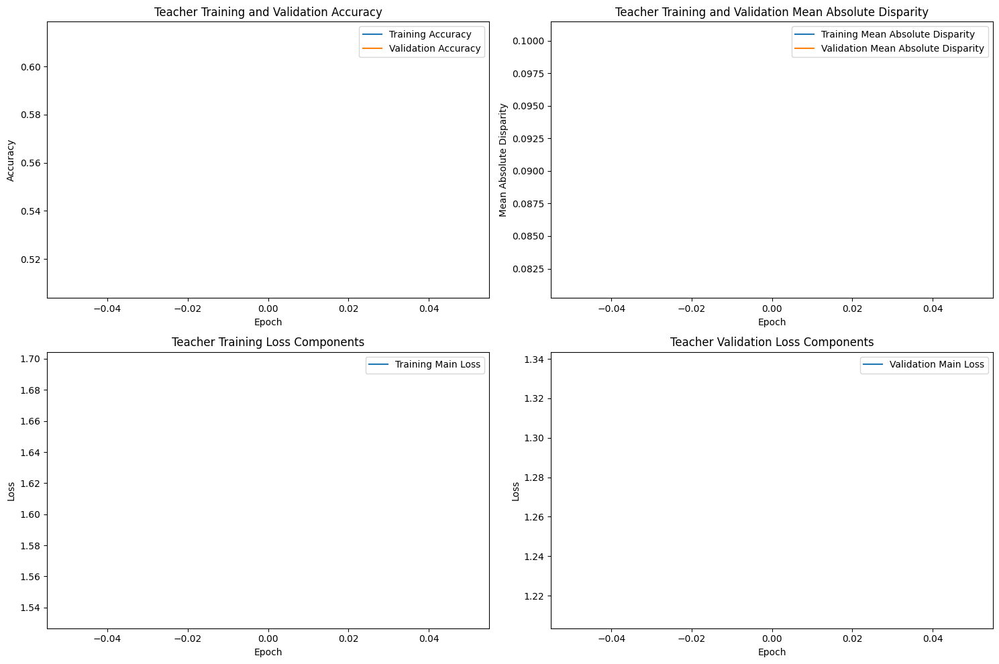

Epoch 2/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:19<00:00,  2.79it/s]



TEACHER - Lambda 0 - Epoch 2 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.685301, VALIDATION Accuracy: 0.6285
TRAINING Disparity: 0.083991, VALIDATION Disparity: 0.0995
TRAINING Main Loss: 1.008273, VALIDATION Main Loss: 1.2865
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.06659170414792603
Class Celebration: Val Disparity = 0.035752298016448913
Class Parade: Val Disparity = 0.026143790849673332
Class Waiter_Or_Waitress: Val Disparity = -0.0021008403361344463
Class Individual_Sports: Val Disparity = -0.14496479951025387
Class Surgeons: Val Disparity = -0.031020408163265234
Class Spa: Val Disparity = 0.1607142857142858
Class Law_Enforcement: Val Disparity = 0.14015151515151525
Class Business: Val Disparity = 0.2474973047897736
Class Dresses: Val Disparity = -0.21449275362318843
Class Water_Activities: Val Disparity = 0.022485207100591653
Class Picnic: Val Disparity = -0.03827751196172252
Class Rescue: Val Di

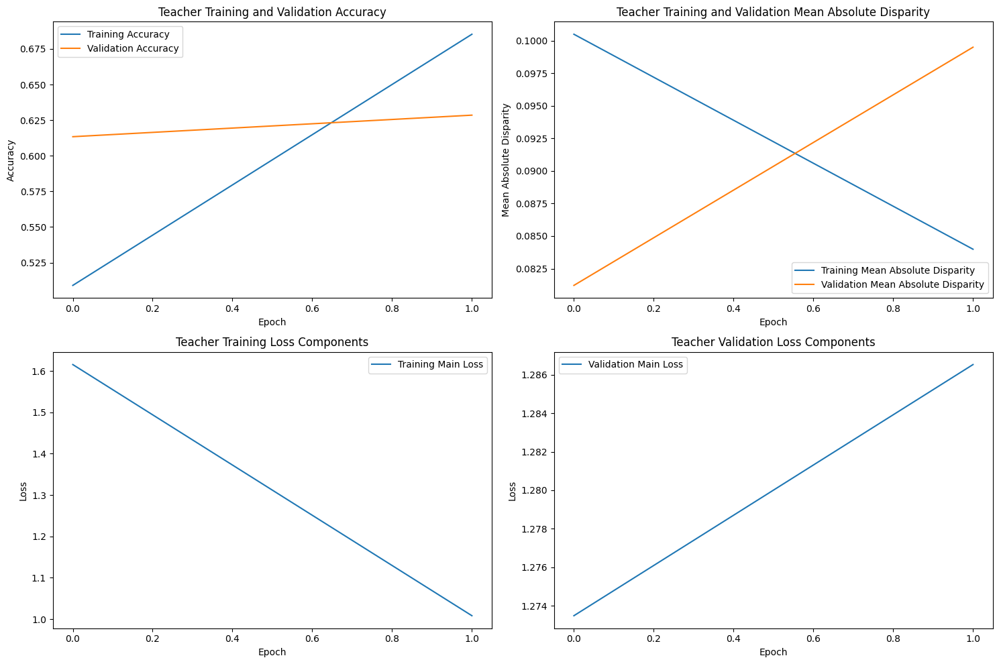

Epoch 3/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:19<00:00,  2.83it/s]



TEACHER - Lambda 0 - Epoch 3 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.788522, VALIDATION Accuracy: 0.6146
TRAINING Disparity: 0.074023, VALIDATION Disparity: 0.0933
TRAINING Main Loss: 0.666214, VALIDATION Main Loss: 1.4091
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.06659170414792603
Class Celebration: Val Disparity = 0.035752298016448913
Class Parade: Val Disparity = 0.026143790849673332
Class Waiter_Or_Waitress: Val Disparity = -0.0021008403361344463
Class Individual_Sports: Val Disparity = -0.14496479951025387
Class Surgeons: Val Disparity = -0.031020408163265234
Class Spa: Val Disparity = 0.1607142857142858
Class Law_Enforcement: Val Disparity = 0.14015151515151525
Class Business: Val Disparity = 0.2474973047897736
Class Dresses: Val Disparity = -0.21449275362318843
Class Water_Activities: Val Disparity = 0.022485207100591653
Class Picnic: Val Disparity = -0.03827751196172252
Class Rescue: Val Di

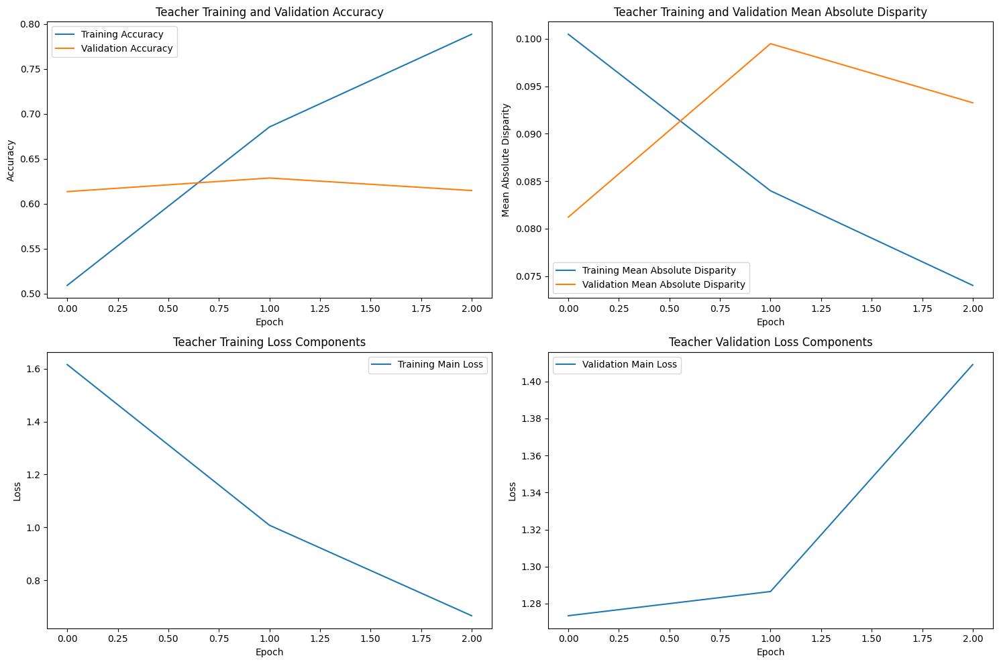

Epoch 4/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:19<00:00,  2.87it/s]



TEACHER - Lambda 0 - Epoch 4 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.856559, VALIDATION Accuracy: 0.6006
TRAINING Disparity: 0.053264, VALIDATION Disparity: 0.1208
TRAINING Main Loss: 0.442281, VALIDATION Main Loss: 1.6044
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.06659170414792603
Class Celebration: Val Disparity = 0.035752298016448913
Class Parade: Val Disparity = 0.026143790849673332
Class Waiter_Or_Waitress: Val Disparity = -0.0021008403361344463
Class Individual_Sports: Val Disparity = -0.14496479951025387
Class Surgeons: Val Disparity = -0.031020408163265234
Class Spa: Val Disparity = 0.1607142857142858
Class Law_Enforcement: Val Disparity = 0.14015151515151525
Class Business: Val Disparity = 0.2474973047897736
Class Dresses: Val Disparity = -0.21449275362318843
Class Water_Activities: Val Disparity = 0.022485207100591653
Class Picnic: Val Disparity = -0.03827751196172252
Class Rescue: Val Di

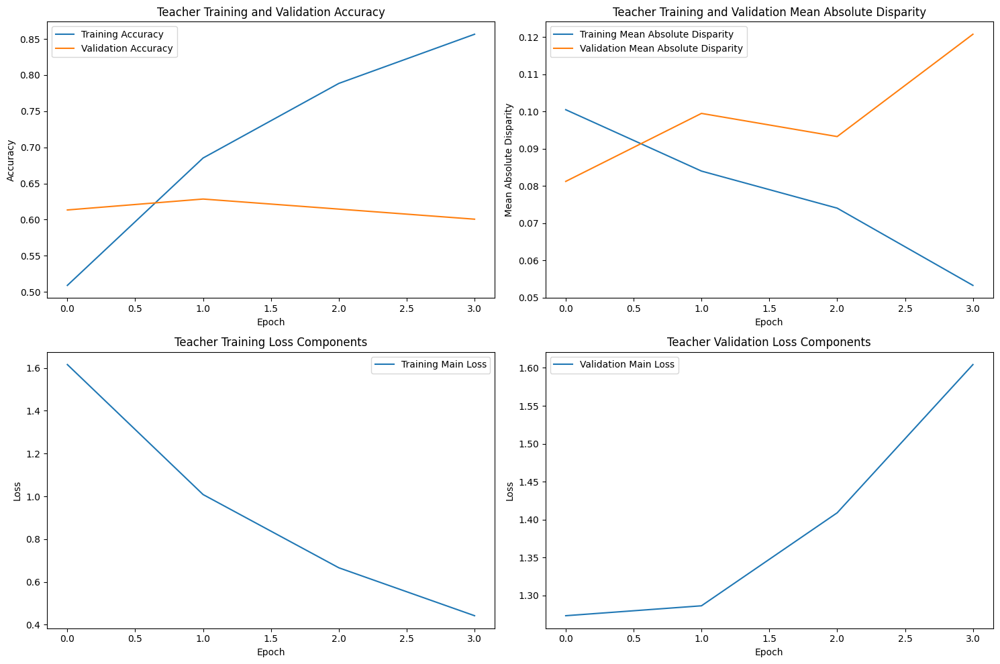

Epoch 5/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:20<00:00,  2.63it/s]



TEACHER - Lambda 0 - Epoch 5 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.895602, VALIDATION Accuracy: 0.6311
TRAINING Disparity: 0.019627, VALIDATION Disparity: 0.0856
TRAINING Main Loss: 0.315178, VALIDATION Main Loss: 1.6525
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.06659170414792603
Class Celebration: Val Disparity = 0.035752298016448913
Class Parade: Val Disparity = 0.026143790849673332
Class Waiter_Or_Waitress: Val Disparity = -0.0021008403361344463
Class Individual_Sports: Val Disparity = -0.14496479951025387
Class Surgeons: Val Disparity = -0.031020408163265234
Class Spa: Val Disparity = 0.1607142857142858
Class Law_Enforcement: Val Disparity = 0.14015151515151525
Class Business: Val Disparity = 0.2474973047897736
Class Dresses: Val Disparity = -0.21449275362318843
Class Water_Activities: Val Disparity = 0.022485207100591653
Class Picnic: Val Disparity = -0.03827751196172252
Class Rescue: Val Di

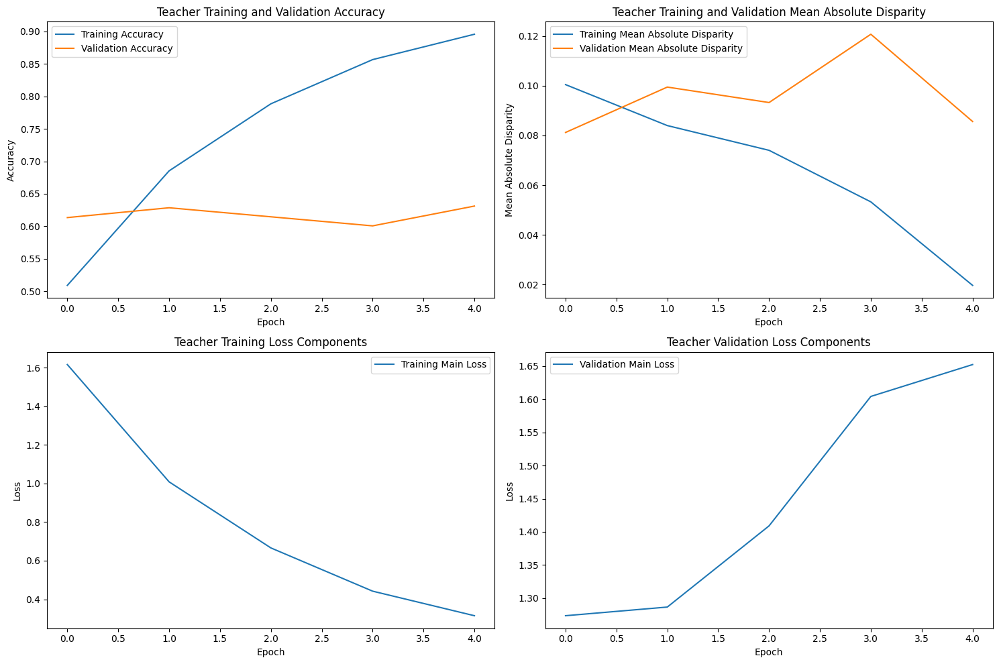

Epoch 6/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:19<00:00,  2.85it/s]



TEACHER - Lambda 0 - Epoch 6 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.935725, VALIDATION Accuracy: 0.6242
TRAINING Disparity: 0.025356, VALIDATION Disparity: 0.1022
TRAINING Main Loss: 0.194649, VALIDATION Main Loss: 1.7054
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.06659170414792603
Class Celebration: Val Disparity = 0.035752298016448913
Class Parade: Val Disparity = 0.026143790849673332
Class Waiter_Or_Waitress: Val Disparity = -0.0021008403361344463
Class Individual_Sports: Val Disparity = -0.14496479951025387
Class Surgeons: Val Disparity = -0.031020408163265234
Class Spa: Val Disparity = 0.1607142857142858
Class Law_Enforcement: Val Disparity = 0.14015151515151525
Class Business: Val Disparity = 0.2474973047897736
Class Dresses: Val Disparity = -0.21449275362318843
Class Water_Activities: Val Disparity = 0.022485207100591653
Class Picnic: Val Disparity = -0.03827751196172252
Class Rescue: Val Di

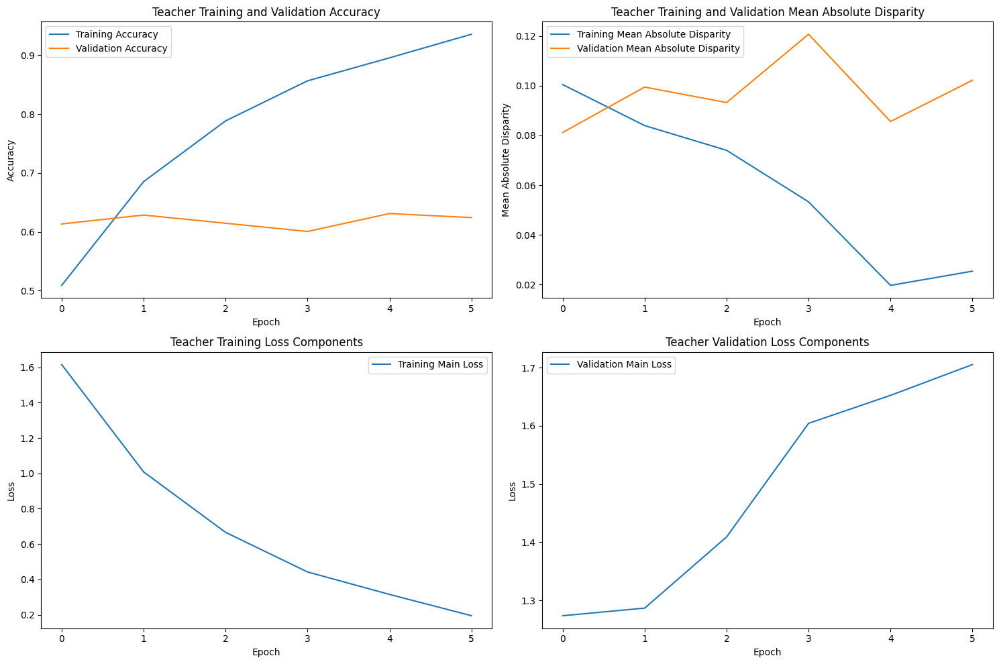

Epoch 7/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:19<00:00,  2.80it/s]



TEACHER - Lambda 0 - Epoch 7 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.941184, VALIDATION Accuracy: 0.6123
TRAINING Disparity: 0.022313, VALIDATION Disparity: 0.0999
TRAINING Main Loss: 0.175990, VALIDATION Main Loss: 1.9568
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.06659170414792603
Class Celebration: Val Disparity = 0.035752298016448913
Class Parade: Val Disparity = 0.026143790849673332
Class Waiter_Or_Waitress: Val Disparity = -0.0021008403361344463
Class Individual_Sports: Val Disparity = -0.14496479951025387
Class Surgeons: Val Disparity = -0.031020408163265234
Class Spa: Val Disparity = 0.1607142857142858
Class Law_Enforcement: Val Disparity = 0.14015151515151525
Class Business: Val Disparity = 0.2474973047897736
Class Dresses: Val Disparity = -0.21449275362318843
Class Water_Activities: Val Disparity = 0.022485207100591653
Class Picnic: Val Disparity = -0.03827751196172252
Class Rescue: Val Di

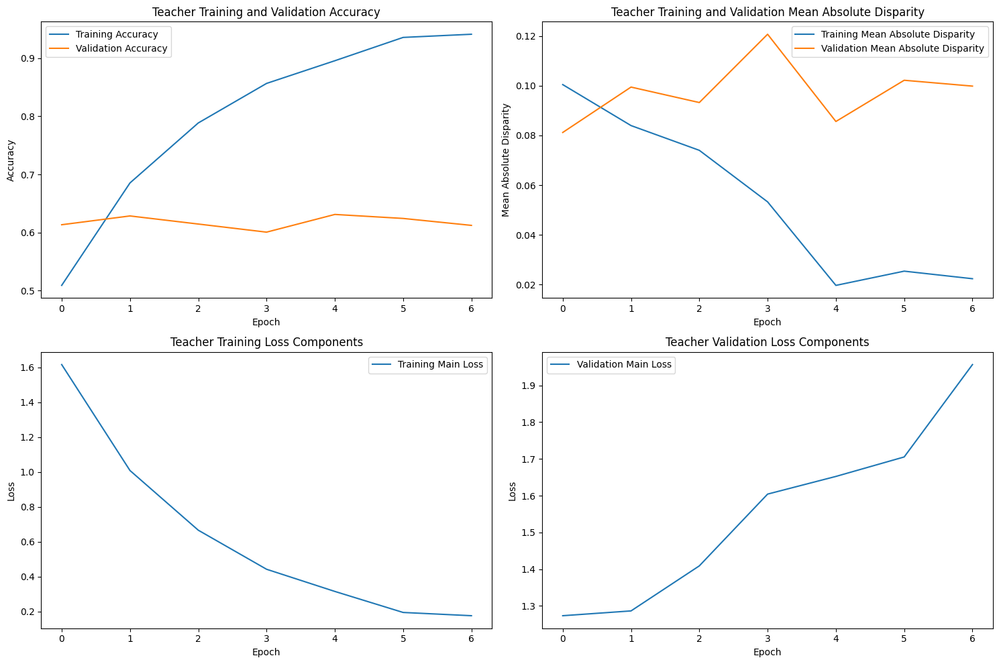

Epoch 8/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:19<00:00,  2.81it/s]



TEACHER - Lambda 0 - Epoch 8 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.941917, VALIDATION Accuracy: 0.6319
TRAINING Disparity: 0.027148, VALIDATION Disparity: 0.0879
TRAINING Main Loss: 0.178361, VALIDATION Main Loss: 1.8805
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.06659170414792603
Class Celebration: Val Disparity = 0.035752298016448913
Class Parade: Val Disparity = 0.026143790849673332
Class Waiter_Or_Waitress: Val Disparity = -0.0021008403361344463
Class Individual_Sports: Val Disparity = -0.14496479951025387
Class Surgeons: Val Disparity = -0.031020408163265234
Class Spa: Val Disparity = 0.1607142857142858
Class Law_Enforcement: Val Disparity = 0.14015151515151525
Class Business: Val Disparity = 0.2474973047897736
Class Dresses: Val Disparity = -0.21449275362318843
Class Water_Activities: Val Disparity = 0.022485207100591653
Class Picnic: Val Disparity = -0.03827751196172252
Class Rescue: Val Di

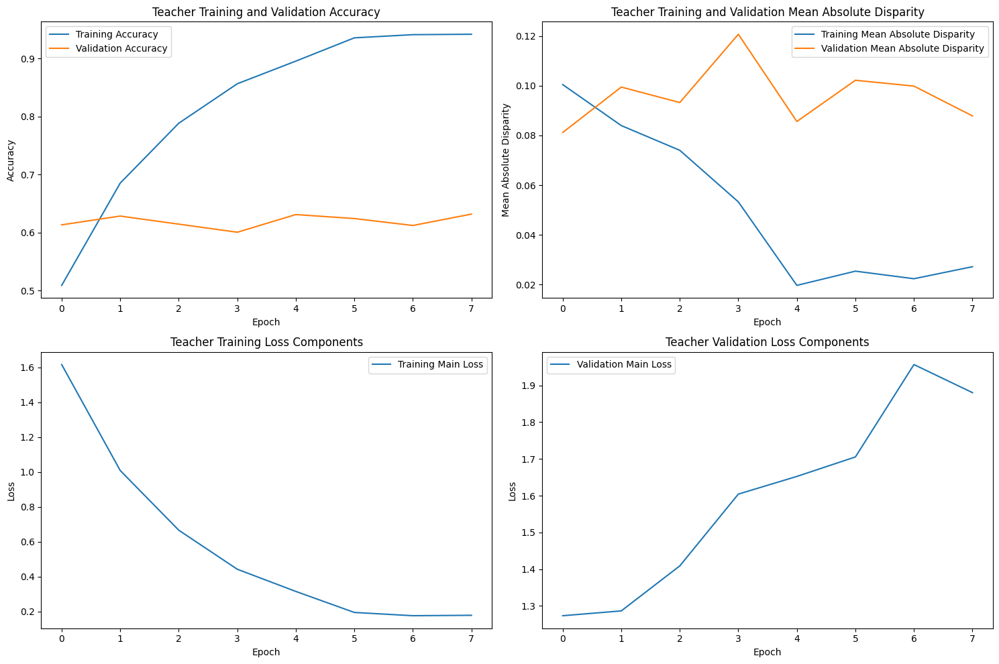

Epoch 9/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:19<00:00,  2.88it/s]



TEACHER - Lambda 0 - Epoch 9 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.953974, VALIDATION Accuracy: 0.6049
TRAINING Disparity: 0.018253, VALIDATION Disparity: 0.0813
TRAINING Main Loss: 0.137795, VALIDATION Main Loss: 2.0697
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.06659170414792603
Class Celebration: Val Disparity = 0.035752298016448913
Class Parade: Val Disparity = 0.026143790849673332
Class Waiter_Or_Waitress: Val Disparity = -0.0021008403361344463
Class Individual_Sports: Val Disparity = -0.14496479951025387
Class Surgeons: Val Disparity = -0.031020408163265234
Class Spa: Val Disparity = 0.1607142857142858
Class Law_Enforcement: Val Disparity = 0.14015151515151525
Class Business: Val Disparity = 0.2474973047897736
Class Dresses: Val Disparity = -0.21449275362318843
Class Water_Activities: Val Disparity = 0.022485207100591653
Class Picnic: Val Disparity = -0.03827751196172252
Class Rescue: Val Di

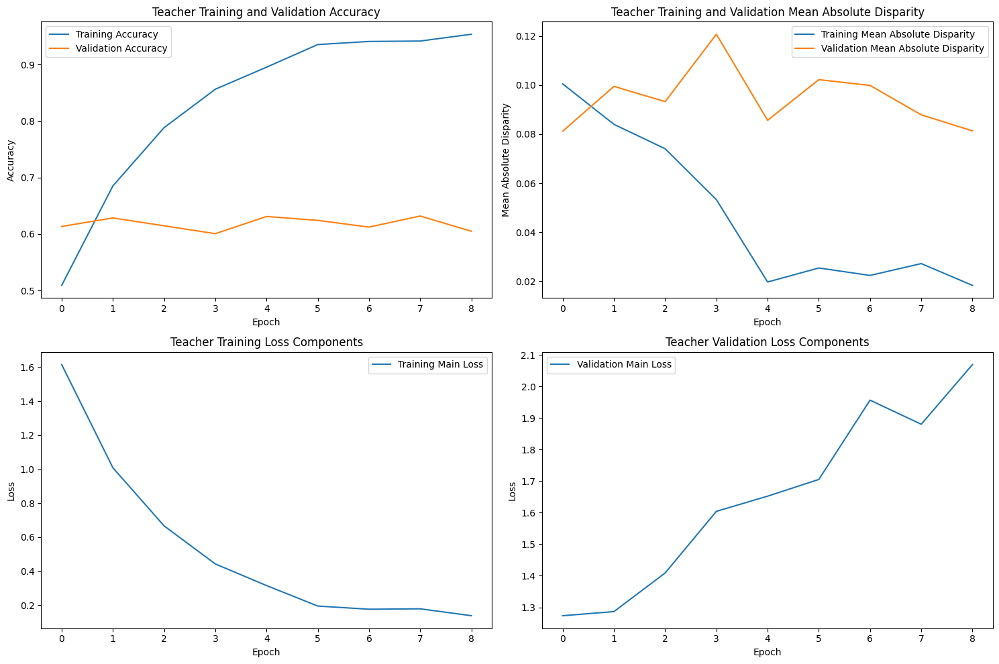

Epoch 10/10, Validation: 100%|███████████████████████████████████████████████████████████████| 55/55 [00:18<00:00,  2.91it/s]



TEACHER - Lambda 0 - Epoch 10 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.950984, VALIDATION Accuracy: 0.6032
TRAINING Disparity: 0.025711, VALIDATION Disparity: 0.1080
TRAINING Main Loss: 0.156750, VALIDATION Main Loss: 1.9382
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.06659170414792603
Class Celebration: Val Disparity = 0.035752298016448913
Class Parade: Val Disparity = 0.026143790849673332
Class Waiter_Or_Waitress: Val Disparity = -0.0021008403361344463
Class Individual_Sports: Val Disparity = -0.14496479951025387
Class Surgeons: Val Disparity = -0.031020408163265234
Class Spa: Val Disparity = 0.1607142857142858
Class Law_Enforcement: Val Disparity = 0.14015151515151525
Class Business: Val Disparity = 0.2474973047897736
Class Dresses: Val Disparity = -0.21449275362318843
Class Water_Activities: Val Disparity = 0.022485207100591653
Class Picnic: Val Disparity = -0.03827751196172252
Class Rescue: Val D

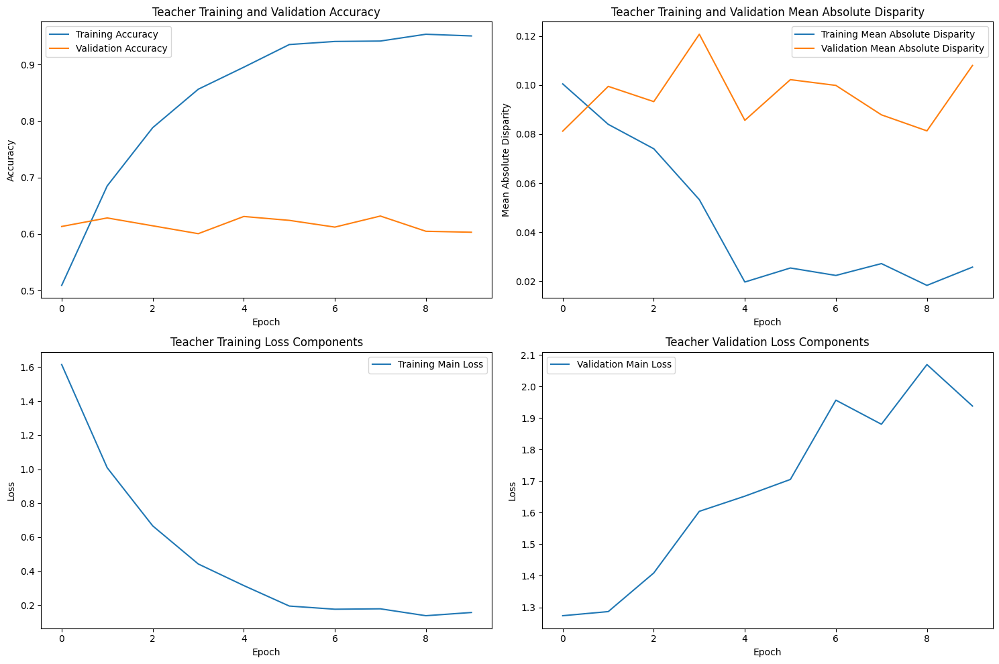

Finished Training TEACHER with lambda value of 0. Best epoch number: 1


In [18]:
# TEACHER
# Create dict to store best model states
teacher_model_states_best = {}

# Loop through the lambda_factor_list
for lambda_factor in teacher_lambda_factor_list:
    # Load EfficientNet B3 model for Teacher
    teacher = models.efficientnet_b3(pretrained=True)
    
    # Determine the number of output features from the feature extractor part of EfficientNet B3
    num_ftrs = teacher.classifier[1].in_features
    
    # Modify the classifier layer of the EfficientNet model to match your number of classes
    teacher.classifier[1] = nn.Linear(num_ftrs, num_classes)
    
    # Redefine your main model optimizer if needed
    teacher_optimizer = optim.Adam(teacher.parameters(), lr=teacher_learning_rate)
    teacher_loss_fn = nn.CrossEntropyLoss()

    # Train the model
    best_model_state = train_teacher(teacher, teacher_optimizer, teacher_loss_fn,
                                     teacher_patience, teacher_epochs, device, 
                                     base_save_dir=base_save_dir, teacher_name = teacher_name)
    teacher_model_states_best[lambda_factor] = best_model_state

# Save the collective best model states to a file
teacher_collective_save_path = os.path.join(base_save_dir, 'teacher_model_states_best.pth')
torch.save(teacher_model_states_best, teacher_collective_save_path)


Training Student with Lambda Value of 0


Epoch 1/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.52it/s]



STUDENT - Lambda 0 - Epoch 1 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.502373, VALIDATION Accuracy: 0.5904
TRAINING Disparity: 0.073783, VALIDATION Disparity: 0.1095
TRAINING Combined Loss: 2.619522, VALIDATION Combined Loss: 2.3289
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04297851074462755
Class Celebration: Val Disparity = 0.10038703434929852
Class Parade: Val Disparity = 0.011204481792717158
Class Waiter_Or_Waitress: Val Disparity = 0.04831932773109249
Class Individual_Sports: Val Disparity = -0.08680746862565036
Class Surgeons: Val Disparity = 0.14857142857142858
Class Spa: Val Disparity = 0.13095238095238093
Class Law_Enforcement: Val Disparity = 0.16747835497835495
Class Business: Val Disparity = 0.18404435545972586
Class Dresses: Val Disparity = -0.4086956521739131
Class Water_Activities: Val Disparity = -0.021696252465483123
Class Picnic: Val Disparity = -0.23444976076555035
Class Rescue: Va

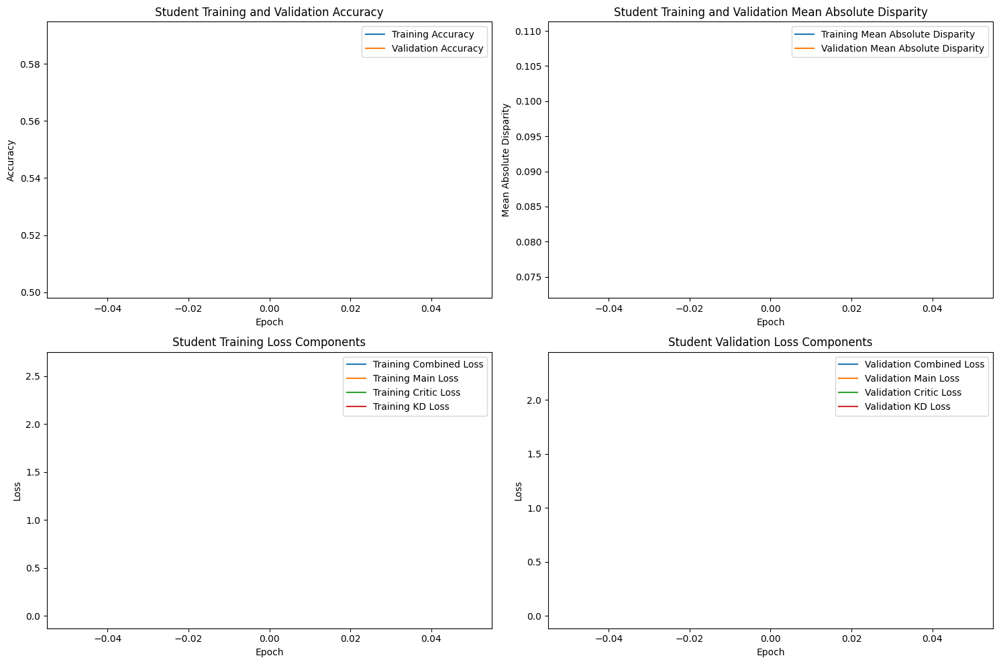

Epoch 2/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.56it/s]



STUDENT - Lambda 0 - Epoch 2 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.645409, VALIDATION Accuracy: 0.5807
TRAINING Disparity: 0.088325, VALIDATION Disparity: 0.0945
TRAINING Combined Loss: 2.346866, VALIDATION Combined Loss: 2.5513
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04297851074462755
Class Celebration: Val Disparity = 0.10038703434929852
Class Parade: Val Disparity = 0.011204481792717158
Class Waiter_Or_Waitress: Val Disparity = 0.04831932773109249
Class Individual_Sports: Val Disparity = -0.08680746862565036
Class Surgeons: Val Disparity = 0.14857142857142858
Class Spa: Val Disparity = 0.13095238095238093
Class Law_Enforcement: Val Disparity = 0.16747835497835495
Class Business: Val Disparity = 0.18404435545972586
Class Dresses: Val Disparity = -0.4086956521739131
Class Water_Activities: Val Disparity = -0.021696252465483123
Class Picnic: Val Disparity = -0.23444976076555035
Class Rescue: Va

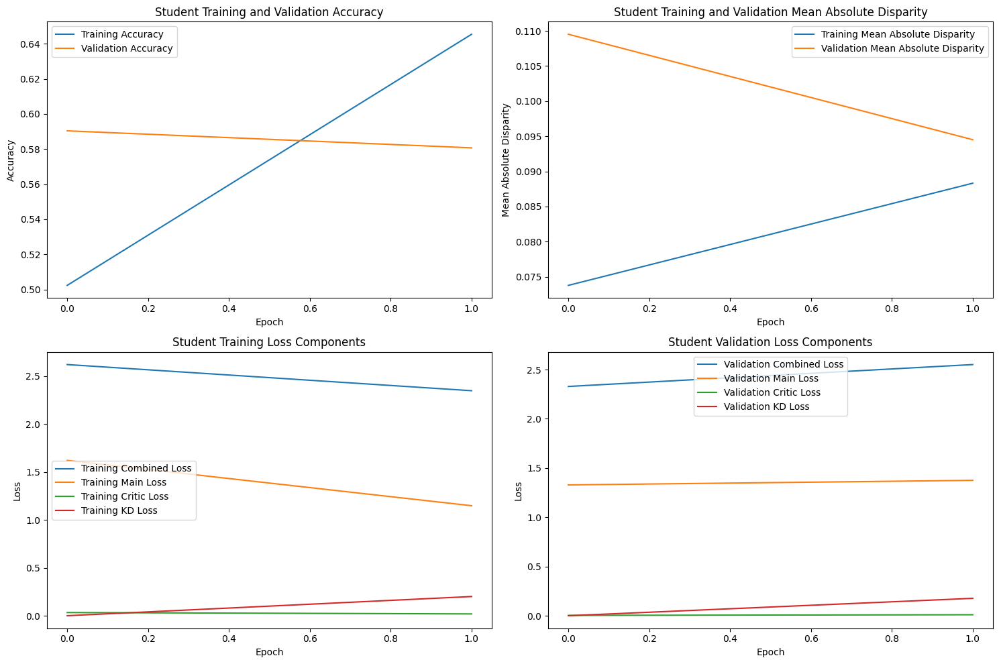

Epoch 3/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.56it/s]



STUDENT - Lambda 0 - Epoch 3 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.707465, VALIDATION Accuracy: 0.6001
TRAINING Disparity: 0.079435, VALIDATION Disparity: 0.1066
TRAINING Combined Loss: 2.334238, VALIDATION Combined Loss: 2.6883
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04297851074462755
Class Celebration: Val Disparity = 0.10038703434929852
Class Parade: Val Disparity = 0.011204481792717158
Class Waiter_Or_Waitress: Val Disparity = 0.04831932773109249
Class Individual_Sports: Val Disparity = -0.08680746862565036
Class Surgeons: Val Disparity = 0.14857142857142858
Class Spa: Val Disparity = 0.13095238095238093
Class Law_Enforcement: Val Disparity = 0.16747835497835495
Class Business: Val Disparity = 0.18404435545972586
Class Dresses: Val Disparity = -0.4086956521739131
Class Water_Activities: Val Disparity = -0.021696252465483123
Class Picnic: Val Disparity = -0.23444976076555035
Class Rescue: Va

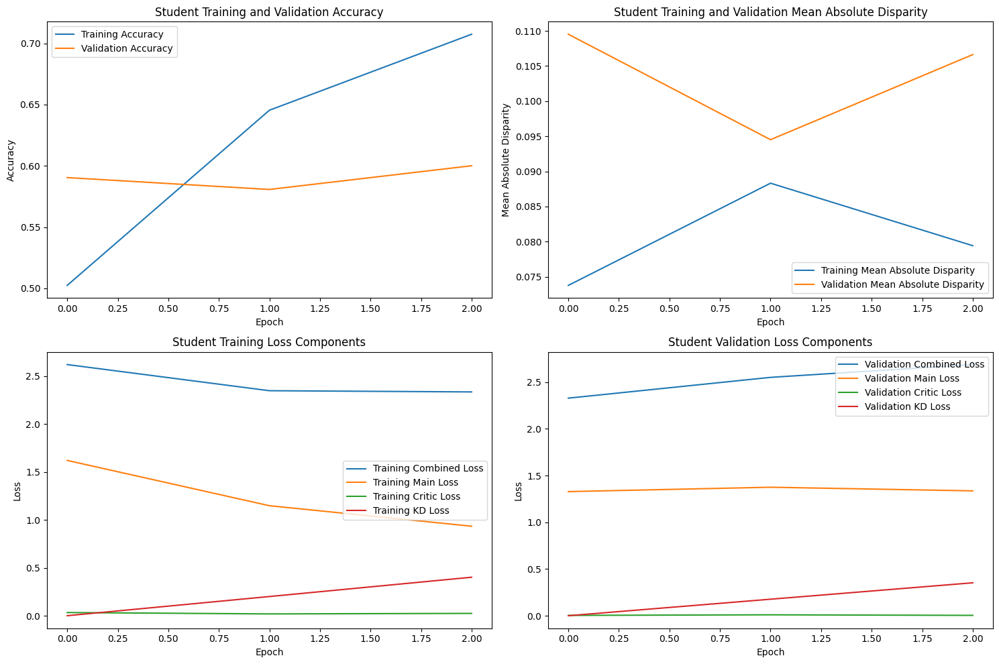

Epoch 4/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.51it/s]



STUDENT - Lambda 0 - Epoch 4 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.752276, VALIDATION Accuracy: 0.5740
TRAINING Disparity: 0.067439, VALIDATION Disparity: 0.1054
TRAINING Combined Loss: 2.381483, VALIDATION Combined Loss: 3.0562
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04297851074462755
Class Celebration: Val Disparity = 0.10038703434929852
Class Parade: Val Disparity = 0.011204481792717158
Class Waiter_Or_Waitress: Val Disparity = 0.04831932773109249
Class Individual_Sports: Val Disparity = -0.08680746862565036
Class Surgeons: Val Disparity = 0.14857142857142858
Class Spa: Val Disparity = 0.13095238095238093
Class Law_Enforcement: Val Disparity = 0.16747835497835495
Class Business: Val Disparity = 0.18404435545972586
Class Dresses: Val Disparity = -0.4086956521739131
Class Water_Activities: Val Disparity = -0.021696252465483123
Class Picnic: Val Disparity = -0.23444976076555035
Class Rescue: Va

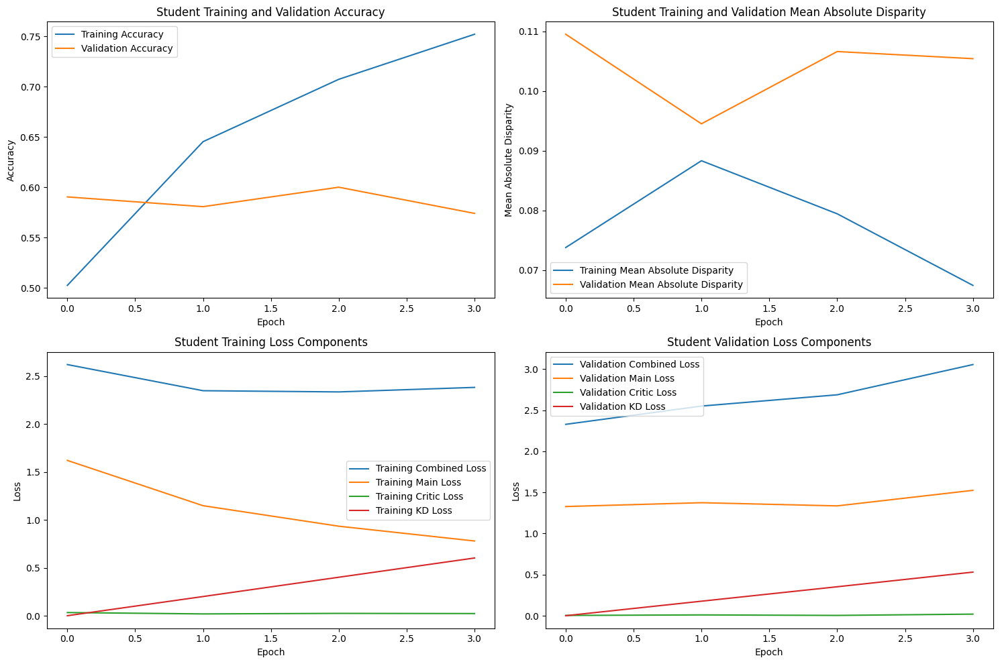

Epoch 5/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.52it/s]



STUDENT - Lambda 0 - Epoch 5 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.798939, VALIDATION Accuracy: 0.5779
TRAINING Disparity: 0.061757, VALIDATION Disparity: 0.0928
TRAINING Combined Loss: 2.428777, VALIDATION Combined Loss: 3.2437
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04297851074462755
Class Celebration: Val Disparity = 0.10038703434929852
Class Parade: Val Disparity = 0.011204481792717158
Class Waiter_Or_Waitress: Val Disparity = 0.04831932773109249
Class Individual_Sports: Val Disparity = -0.08680746862565036
Class Surgeons: Val Disparity = 0.14857142857142858
Class Spa: Val Disparity = 0.13095238095238093
Class Law_Enforcement: Val Disparity = 0.16747835497835495
Class Business: Val Disparity = 0.18404435545972586
Class Dresses: Val Disparity = -0.4086956521739131
Class Water_Activities: Val Disparity = -0.021696252465483123
Class Picnic: Val Disparity = -0.23444976076555035
Class Rescue: Va

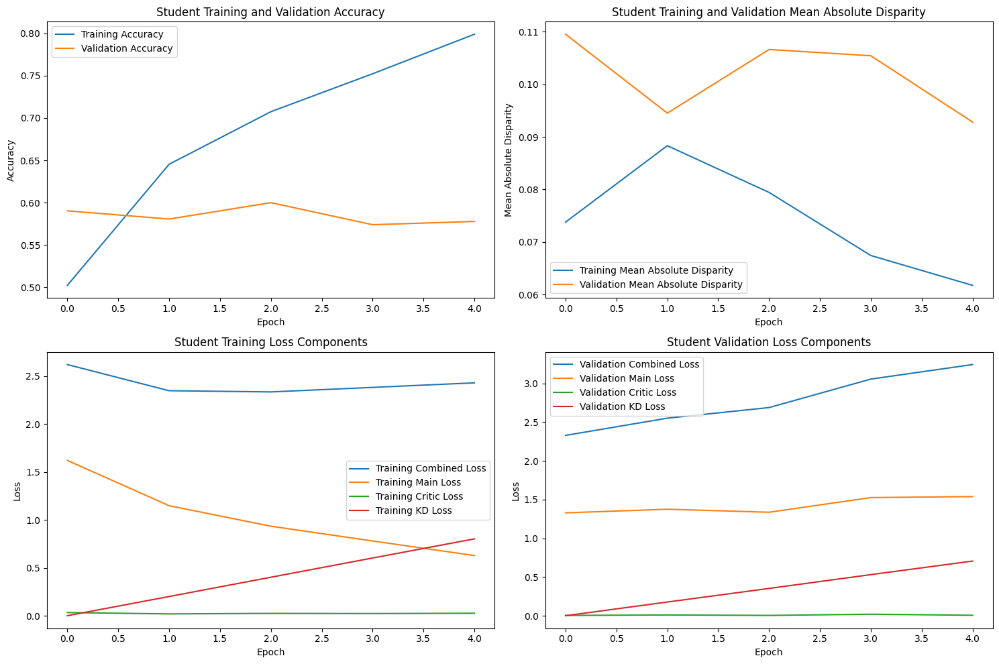

Epoch 6/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.58it/s]



STUDENT - Lambda 0 - Epoch 6 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.812365, VALIDATION Accuracy: 0.5410
TRAINING Disparity: 0.042195, VALIDATION Disparity: 0.0954
TRAINING Combined Loss: 2.574596, VALIDATION Combined Loss: 3.6348
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04297851074462755
Class Celebration: Val Disparity = 0.10038703434929852
Class Parade: Val Disparity = 0.011204481792717158
Class Waiter_Or_Waitress: Val Disparity = 0.04831932773109249
Class Individual_Sports: Val Disparity = -0.08680746862565036
Class Surgeons: Val Disparity = 0.14857142857142858
Class Spa: Val Disparity = 0.13095238095238093
Class Law_Enforcement: Val Disparity = 0.16747835497835495
Class Business: Val Disparity = 0.18404435545972586
Class Dresses: Val Disparity = -0.4086956521739131
Class Water_Activities: Val Disparity = -0.021696252465483123
Class Picnic: Val Disparity = -0.23444976076555035
Class Rescue: Va

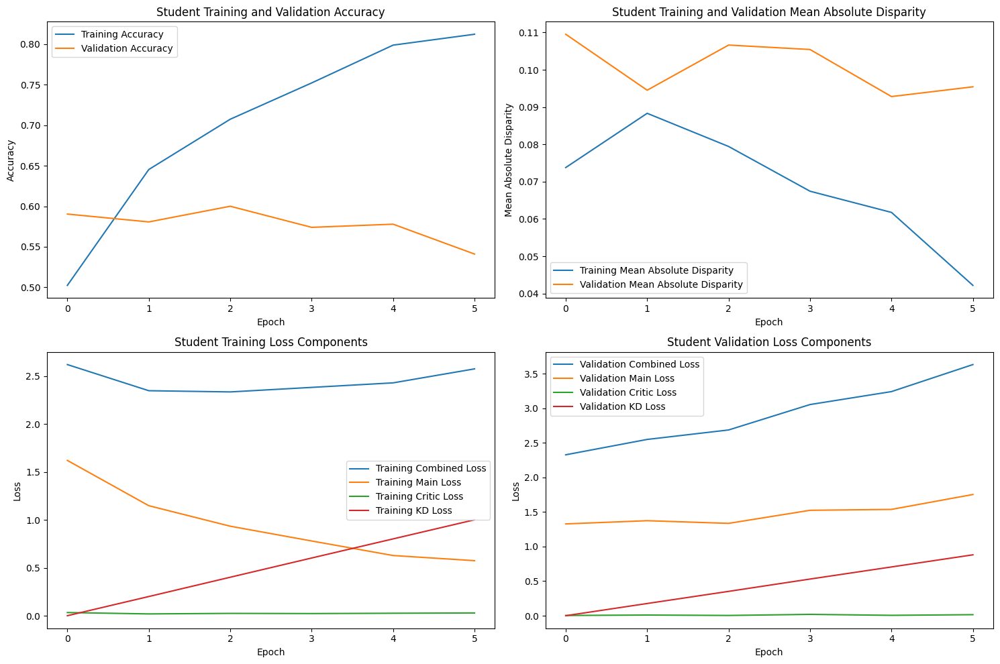

Epoch 7/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.56it/s]



STUDENT - Lambda 0 - Epoch 7 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.849016, VALIDATION Accuracy: 0.5595
TRAINING Disparity: 0.052393, VALIDATION Disparity: 0.1077
TRAINING Combined Loss: 2.665048, VALIDATION Combined Loss: 3.8949
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04297851074462755
Class Celebration: Val Disparity = 0.10038703434929852
Class Parade: Val Disparity = 0.011204481792717158
Class Waiter_Or_Waitress: Val Disparity = 0.04831932773109249
Class Individual_Sports: Val Disparity = -0.08680746862565036
Class Surgeons: Val Disparity = 0.14857142857142858
Class Spa: Val Disparity = 0.13095238095238093
Class Law_Enforcement: Val Disparity = 0.16747835497835495
Class Business: Val Disparity = 0.18404435545972586
Class Dresses: Val Disparity = -0.4086956521739131
Class Water_Activities: Val Disparity = -0.021696252465483123
Class Picnic: Val Disparity = -0.23444976076555035
Class Rescue: Va

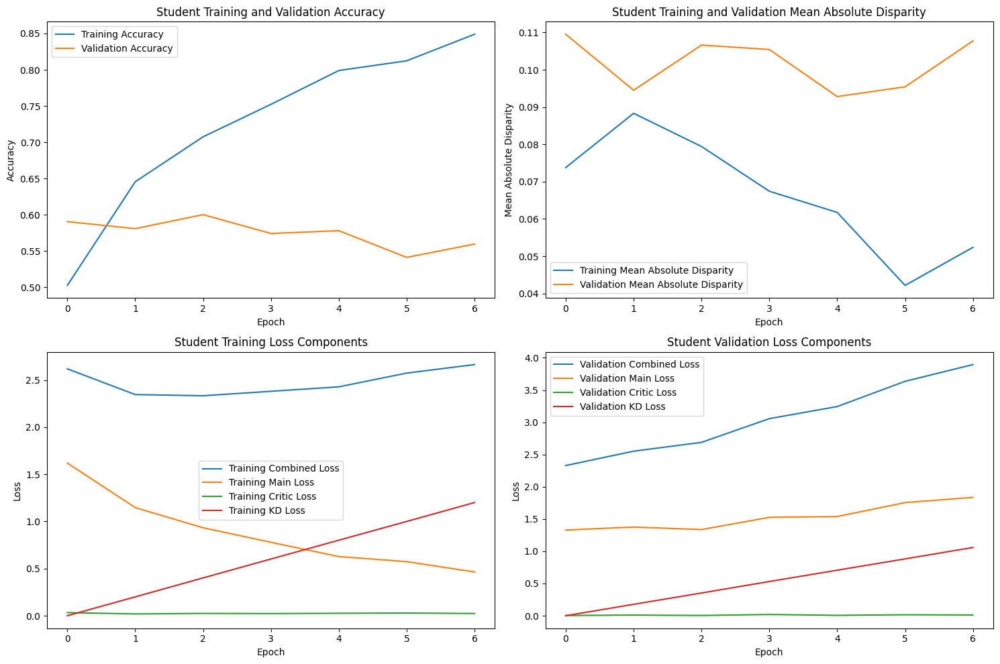

Epoch 8/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.56it/s]



STUDENT - Lambda 0 - Epoch 8 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.944406, VALIDATION Accuracy: 0.6236
TRAINING Disparity: 0.030031, VALIDATION Disparity: 0.1022
TRAINING Combined Loss: 2.584046, VALIDATION Combined Loss: 3.7810
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04297851074462755
Class Celebration: Val Disparity = 0.10038703434929852
Class Parade: Val Disparity = 0.011204481792717158
Class Waiter_Or_Waitress: Val Disparity = 0.04831932773109249
Class Individual_Sports: Val Disparity = -0.08680746862565036
Class Surgeons: Val Disparity = 0.14857142857142858
Class Spa: Val Disparity = 0.13095238095238093
Class Law_Enforcement: Val Disparity = 0.16747835497835495
Class Business: Val Disparity = 0.18404435545972586
Class Dresses: Val Disparity = -0.4086956521739131
Class Water_Activities: Val Disparity = -0.021696252465483123
Class Picnic: Val Disparity = -0.23444976076555035
Class Rescue: Va

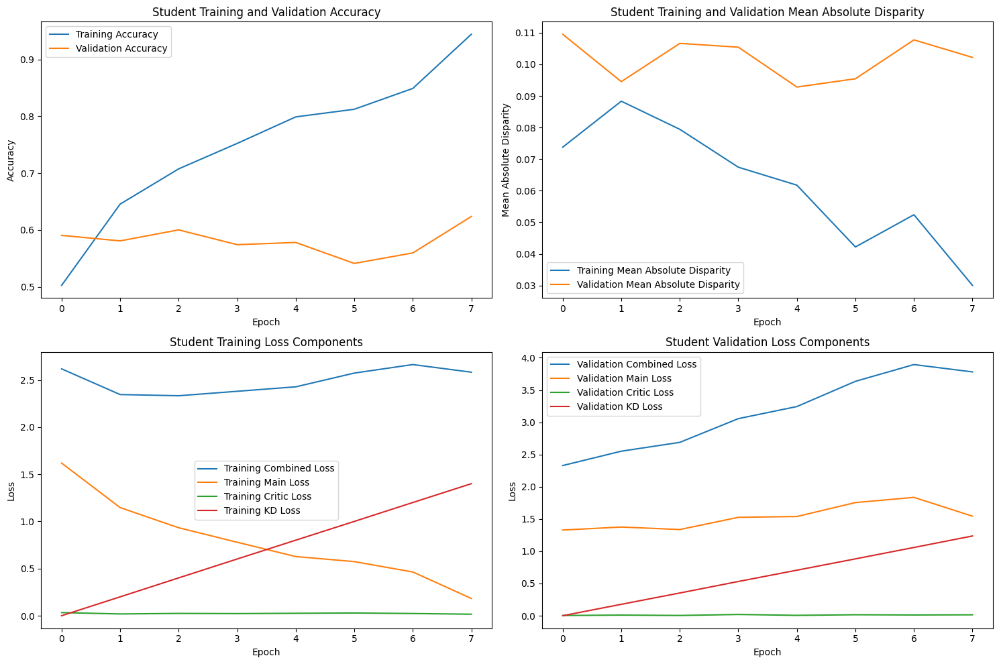

Epoch 9/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.54it/s]



STUDENT - Lambda 0 - Epoch 9 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.985995, VALIDATION Accuracy: 0.6242
TRAINING Disparity: 0.013823, VALIDATION Disparity: 0.1043
TRAINING Combined Loss: 2.672154, VALIDATION Combined Loss: 4.0088
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04297851074462755
Class Celebration: Val Disparity = 0.10038703434929852
Class Parade: Val Disparity = 0.011204481792717158
Class Waiter_Or_Waitress: Val Disparity = 0.04831932773109249
Class Individual_Sports: Val Disparity = -0.08680746862565036
Class Surgeons: Val Disparity = 0.14857142857142858
Class Spa: Val Disparity = 0.13095238095238093
Class Law_Enforcement: Val Disparity = 0.16747835497835495
Class Business: Val Disparity = 0.18404435545972586
Class Dresses: Val Disparity = -0.4086956521739131
Class Water_Activities: Val Disparity = -0.021696252465483123
Class Picnic: Val Disparity = -0.23444976076555035
Class Rescue: Va

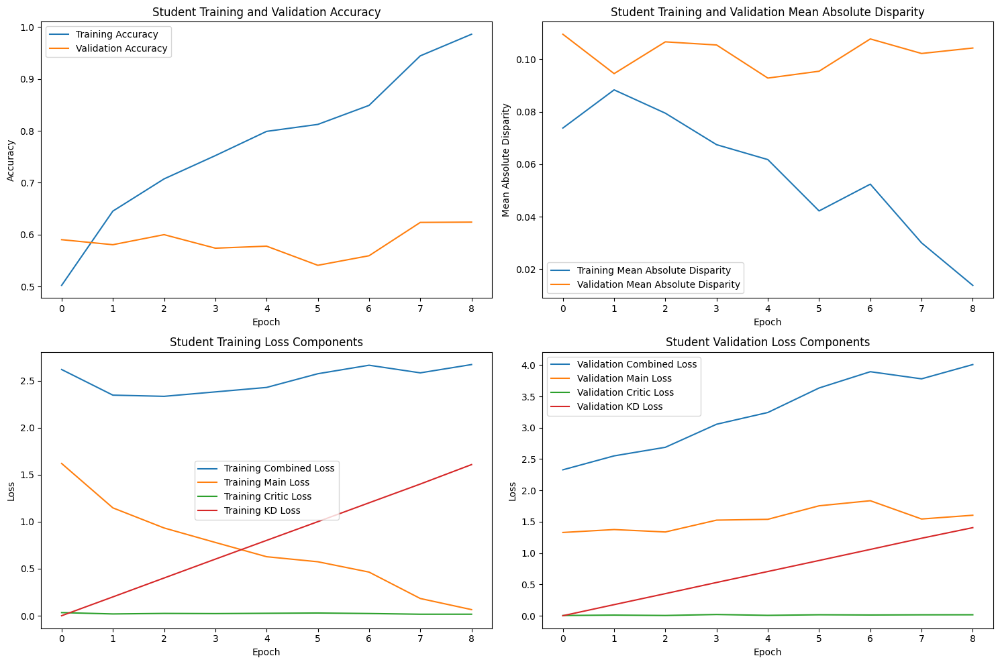

Epoch 10/10, Validation: 100%|███████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.51it/s]



STUDENT - Lambda 0 - Epoch 10 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.992805, VALIDATION Accuracy: 0.6239
TRAINING Disparity: 0.007884, VALIDATION Disparity: 0.1005
TRAINING Combined Loss: 2.845490, VALIDATION Combined Loss: 4.2433
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04297851074462755
Class Celebration: Val Disparity = 0.10038703434929852
Class Parade: Val Disparity = 0.011204481792717158
Class Waiter_Or_Waitress: Val Disparity = 0.04831932773109249
Class Individual_Sports: Val Disparity = -0.08680746862565036
Class Surgeons: Val Disparity = 0.14857142857142858
Class Spa: Val Disparity = 0.13095238095238093
Class Law_Enforcement: Val Disparity = 0.16747835497835495
Class Business: Val Disparity = 0.18404435545972586
Class Dresses: Val Disparity = -0.4086956521739131
Class Water_Activities: Val Disparity = -0.021696252465483123
Class Picnic: Val Disparity = -0.23444976076555035
Class Rescue: V

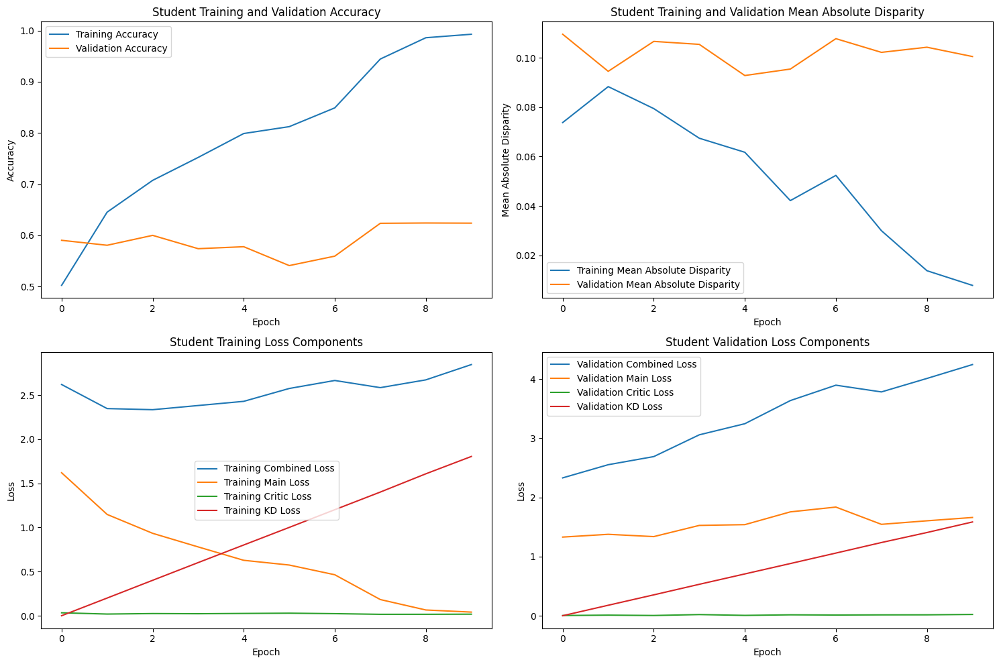

Finished Training STUDENT with lambda value of 0. Best epoch number: 1
Training Student with Lambda Value of 5


Epoch 1/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.53it/s]



STUDENT - Lambda 5 - Epoch 1 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.290992, VALIDATION Accuracy: 0.3679
TRAINING Disparity: 0.025147, VALIDATION Disparity: 0.0536
TRAINING Combined Loss: 4.350627, VALIDATION Combined Loss: 3.1373
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.017366316841579077
Class Celebration: Val Disparity = -0.033817126269956435
Class Parade: Val Disparity = -0.0438842203548086
Class Waiter_Or_Waitress: Val Disparity = 0.1701680672268907
Class Individual_Sports: Val Disparity = -0.1109886746250382
Class Surgeons: Val Disparity = -0.016326530612244927
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.12743506493506496
Class Business: Val Disparity = 0.055444324657323296
Class Dresses: Val Disparity = 0.027536231884057988
Class Water_Activities: Val Disparity = -0.05187376725838255
Class Picnic: Val Disparity = 0.0023923444976076125
Class Rescue: Val Disparity 

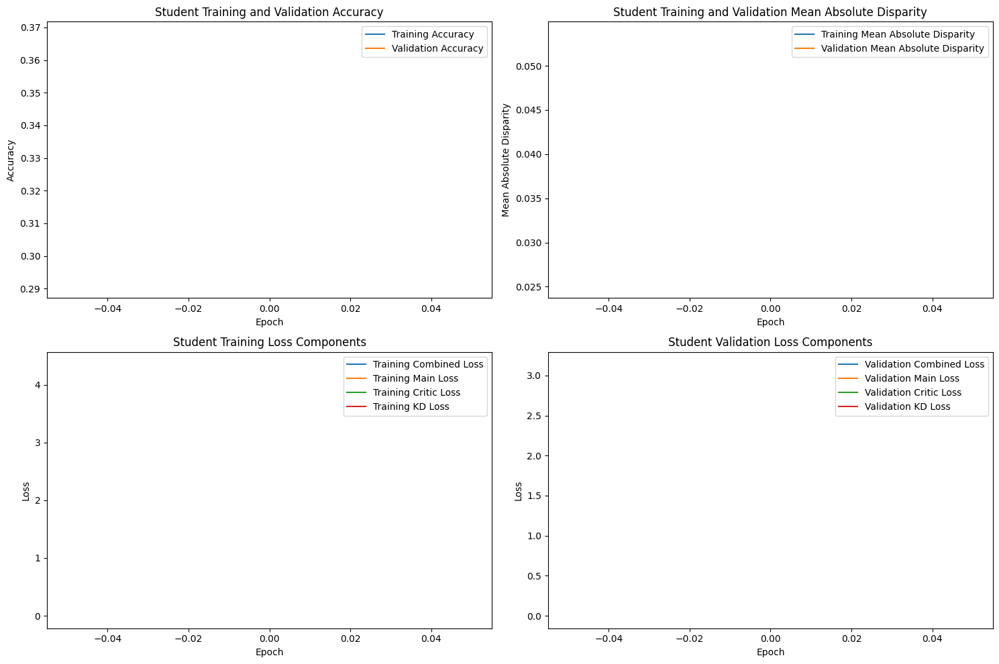

Epoch 2/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.55it/s]



STUDENT - Lambda 5 - Epoch 2 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.426871, VALIDATION Accuracy: 0.4554
TRAINING Disparity: 0.057209, VALIDATION Disparity: 0.0843
TRAINING Combined Loss: 3.177480, VALIDATION Combined Loss: 3.0987
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.10532233883058473
Class Celebration: Val Disparity = 0.09487179487179487
Class Parade: Val Disparity = -0.0009337068160596429
Class Waiter_Or_Waitress: Val Disparity = 0.14810924369747897
Class Individual_Sports: Val Disparity = -0.12222222222222223
Class Surgeons: Val Disparity = 0.004081632653061218
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.1547619047619047
Class Business: Val Disparity = 0.07561989835207139
Class Dresses: Val Disparity = -0.20811594202898565
Class Water_Activities: Val Disparity = 0.11597633136094676
Class Picnic: Val Disparity = 0.040669856459330134
Class Rescue: Val Disparity = -

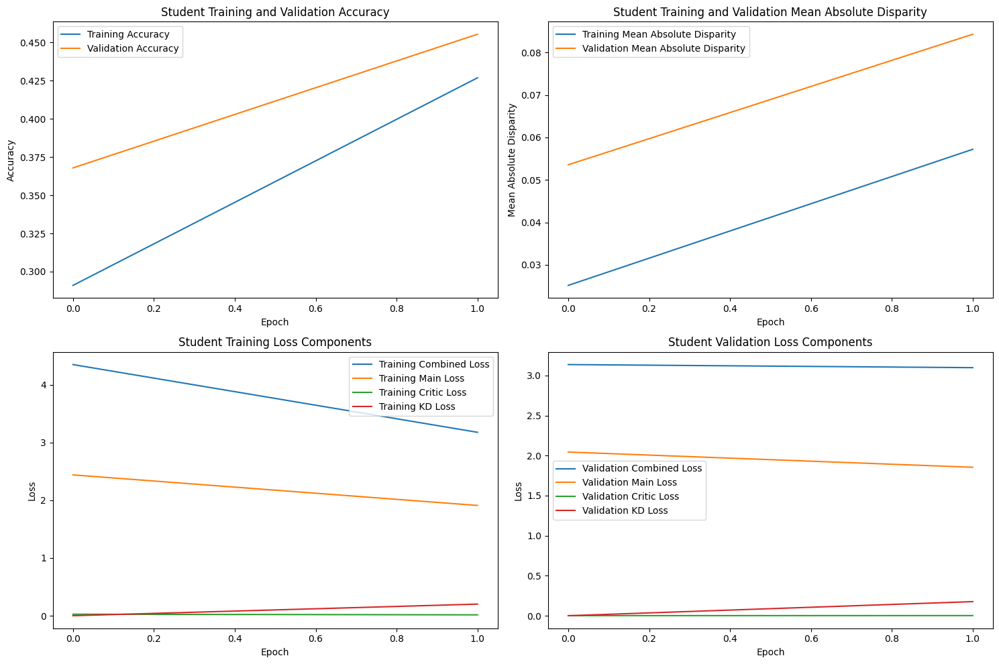

Epoch 3/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.49it/s]



STUDENT - Lambda 5 - Epoch 3 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.469348, VALIDATION Accuracy: 0.4753
TRAINING Disparity: 0.067732, VALIDATION Disparity: 0.1129
TRAINING Combined Loss: 3.432944, VALIDATION Combined Loss: 3.3426
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.10532233883058473
Class Celebration: Val Disparity = 0.09487179487179487
Class Parade: Val Disparity = -0.0009337068160596429
Class Waiter_Or_Waitress: Val Disparity = 0.14810924369747897
Class Individual_Sports: Val Disparity = -0.12222222222222223
Class Surgeons: Val Disparity = 0.004081632653061218
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.1547619047619047
Class Business: Val Disparity = 0.07561989835207139
Class Dresses: Val Disparity = -0.20811594202898565
Class Water_Activities: Val Disparity = 0.11597633136094676
Class Picnic: Val Disparity = 0.040669856459330134
Class Rescue: Val Disparity = -

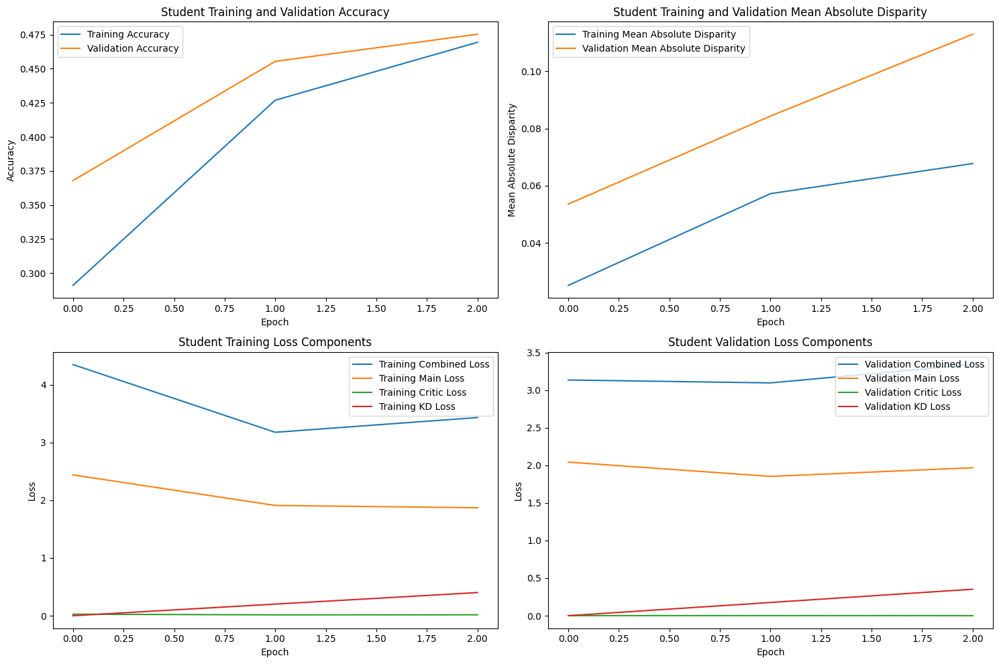

Epoch 4/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.53it/s]



STUDENT - Lambda 5 - Epoch 4 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.517380, VALIDATION Accuracy: 0.4892
TRAINING Disparity: 0.075334, VALIDATION Disparity: 0.1154
TRAINING Combined Loss: 3.484706, VALIDATION Combined Loss: 3.9362
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.10532233883058473
Class Celebration: Val Disparity = 0.09487179487179487
Class Parade: Val Disparity = -0.0009337068160596429
Class Waiter_Or_Waitress: Val Disparity = 0.14810924369747897
Class Individual_Sports: Val Disparity = -0.12222222222222223
Class Surgeons: Val Disparity = 0.004081632653061218
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.1547619047619047
Class Business: Val Disparity = 0.07561989835207139
Class Dresses: Val Disparity = -0.20811594202898565
Class Water_Activities: Val Disparity = 0.11597633136094676
Class Picnic: Val Disparity = 0.040669856459330134
Class Rescue: Val Disparity = -

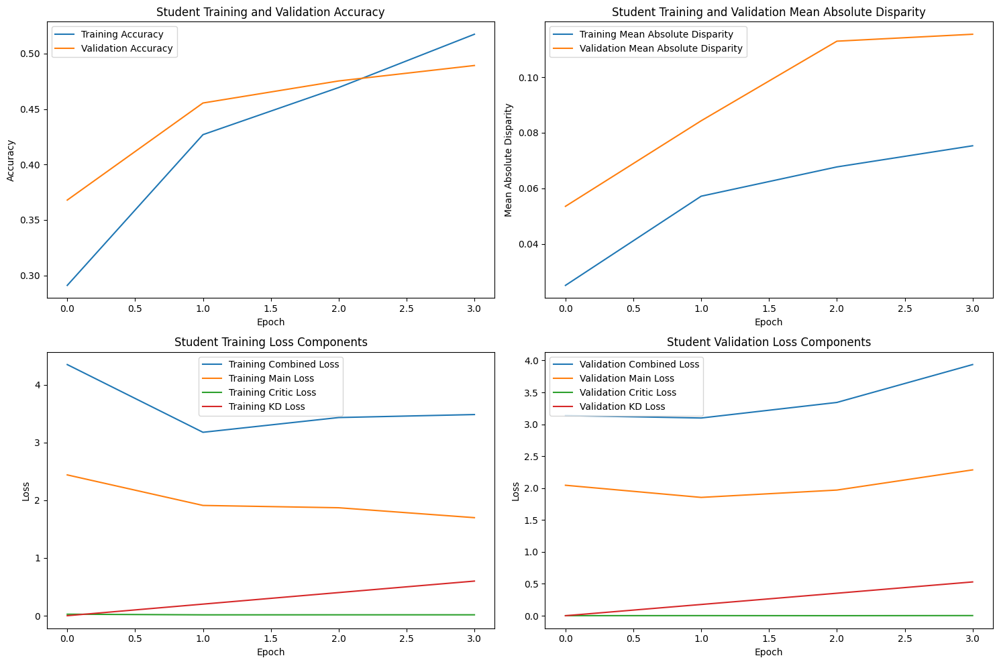

Epoch 5/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.52it/s]



STUDENT - Lambda 5 - Epoch 5 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.519753, VALIDATION Accuracy: 0.5119
TRAINING Disparity: 0.091786, VALIDATION Disparity: 0.0907
TRAINING Combined Loss: 3.873033, VALIDATION Combined Loss: 3.9949
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.10532233883058473
Class Celebration: Val Disparity = 0.09487179487179487
Class Parade: Val Disparity = -0.0009337068160596429
Class Waiter_Or_Waitress: Val Disparity = 0.14810924369747897
Class Individual_Sports: Val Disparity = -0.12222222222222223
Class Surgeons: Val Disparity = 0.004081632653061218
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.1547619047619047
Class Business: Val Disparity = 0.07561989835207139
Class Dresses: Val Disparity = -0.20811594202898565
Class Water_Activities: Val Disparity = 0.11597633136094676
Class Picnic: Val Disparity = 0.040669856459330134
Class Rescue: Val Disparity = -

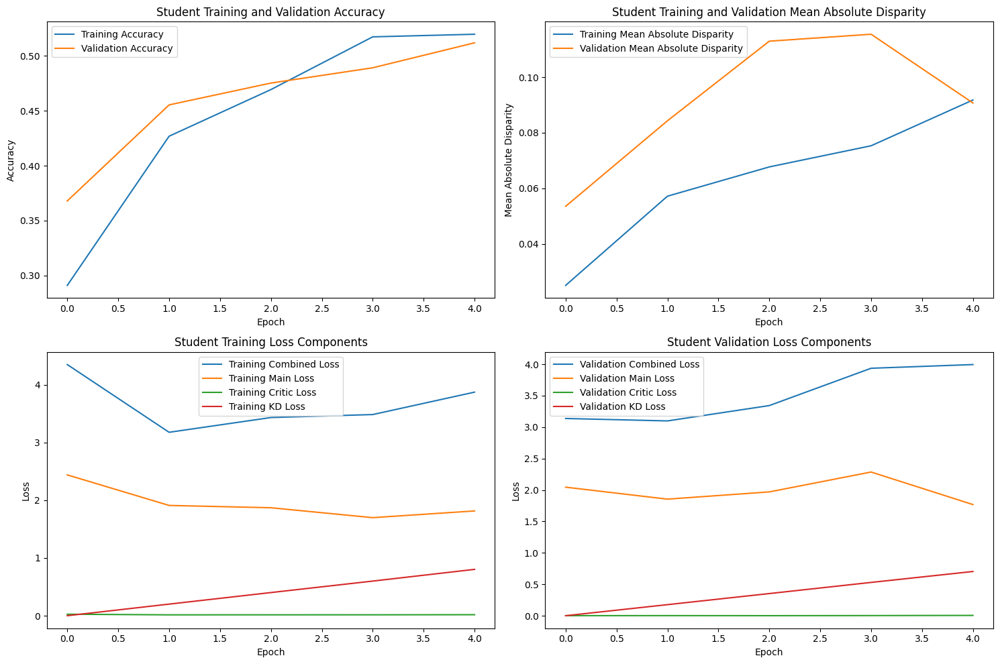

Epoch 6/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.50it/s]



STUDENT - Lambda 5 - Epoch 6 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.548727, VALIDATION Accuracy: 0.5168
TRAINING Disparity: 0.075680, VALIDATION Disparity: 0.1305
TRAINING Combined Loss: 4.049791, VALIDATION Combined Loss: 3.7424
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.10532233883058473
Class Celebration: Val Disparity = 0.09487179487179487
Class Parade: Val Disparity = -0.0009337068160596429
Class Waiter_Or_Waitress: Val Disparity = 0.14810924369747897
Class Individual_Sports: Val Disparity = -0.12222222222222223
Class Surgeons: Val Disparity = 0.004081632653061218
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.1547619047619047
Class Business: Val Disparity = 0.07561989835207139
Class Dresses: Val Disparity = -0.20811594202898565
Class Water_Activities: Val Disparity = 0.11597633136094676
Class Picnic: Val Disparity = 0.040669856459330134
Class Rescue: Val Disparity = -

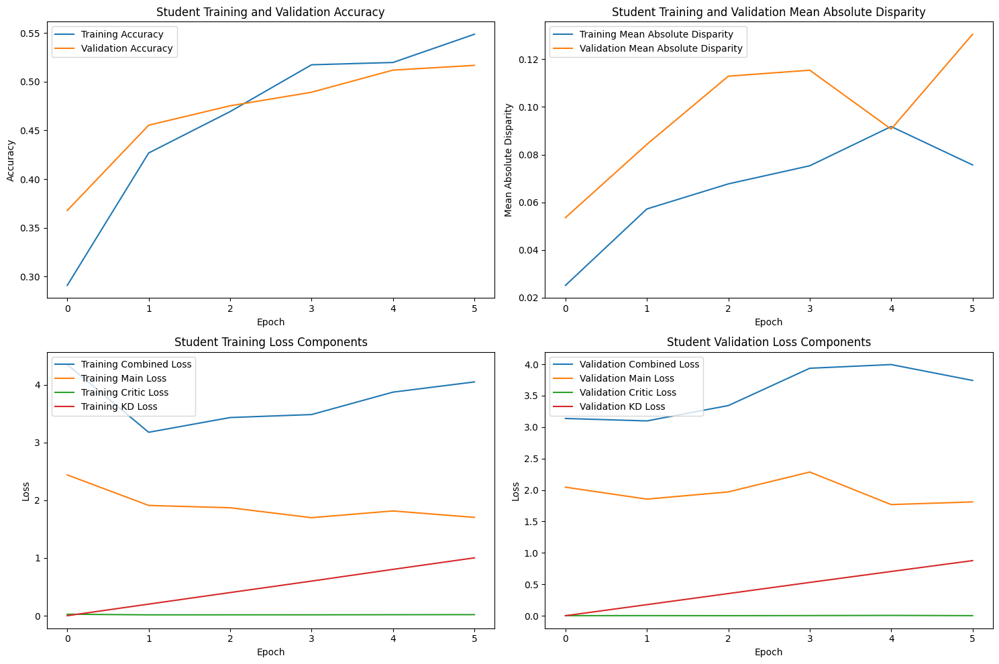

Epoch 7/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.54it/s]



STUDENT - Lambda 5 - Epoch 7 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.550251, VALIDATION Accuracy: 0.4753
TRAINING Disparity: 0.084329, VALIDATION Disparity: 0.0794
TRAINING Combined Loss: 4.152633, VALIDATION Combined Loss: 4.2886
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.10532233883058473
Class Celebration: Val Disparity = 0.09487179487179487
Class Parade: Val Disparity = -0.0009337068160596429
Class Waiter_Or_Waitress: Val Disparity = 0.14810924369747897
Class Individual_Sports: Val Disparity = -0.12222222222222223
Class Surgeons: Val Disparity = 0.004081632653061218
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.1547619047619047
Class Business: Val Disparity = 0.07561989835207139
Class Dresses: Val Disparity = -0.20811594202898565
Class Water_Activities: Val Disparity = 0.11597633136094676
Class Picnic: Val Disparity = 0.040669856459330134
Class Rescue: Val Disparity = -

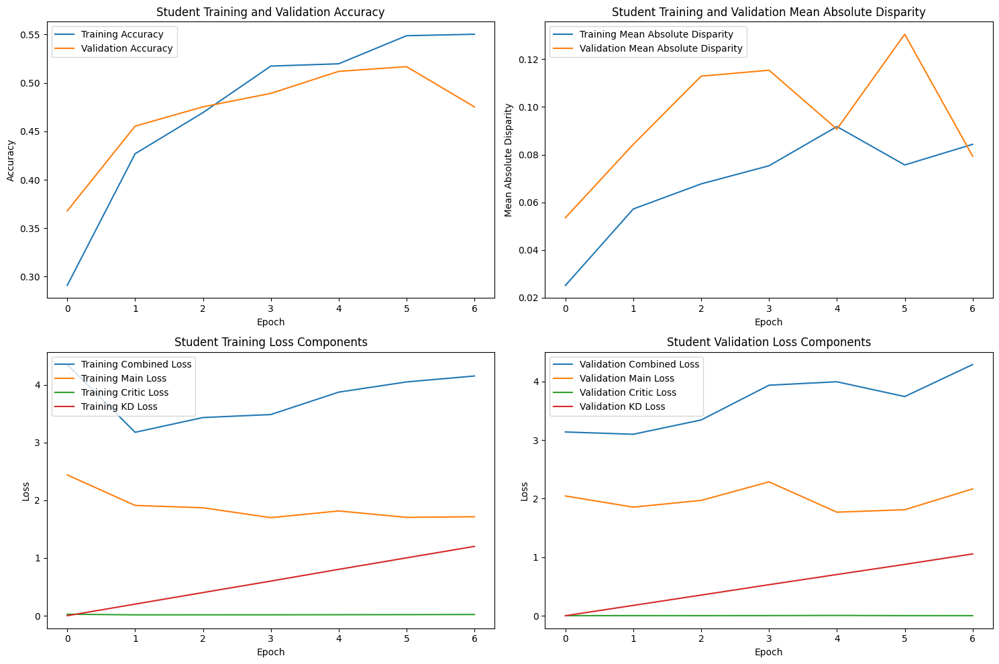

Epoch 8/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.51it/s]



STUDENT - Lambda 5 - Epoch 8 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.510378, VALIDATION Accuracy: 0.4940
TRAINING Disparity: 0.081622, VALIDATION Disparity: 0.1000
TRAINING Combined Loss: 4.765403, VALIDATION Combined Loss: 4.5910
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.10532233883058473
Class Celebration: Val Disparity = 0.09487179487179487
Class Parade: Val Disparity = -0.0009337068160596429
Class Waiter_Or_Waitress: Val Disparity = 0.14810924369747897
Class Individual_Sports: Val Disparity = -0.12222222222222223
Class Surgeons: Val Disparity = 0.004081632653061218
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.1547619047619047
Class Business: Val Disparity = 0.07561989835207139
Class Dresses: Val Disparity = -0.20811594202898565
Class Water_Activities: Val Disparity = 0.11597633136094676
Class Picnic: Val Disparity = 0.040669856459330134
Class Rescue: Val Disparity = -

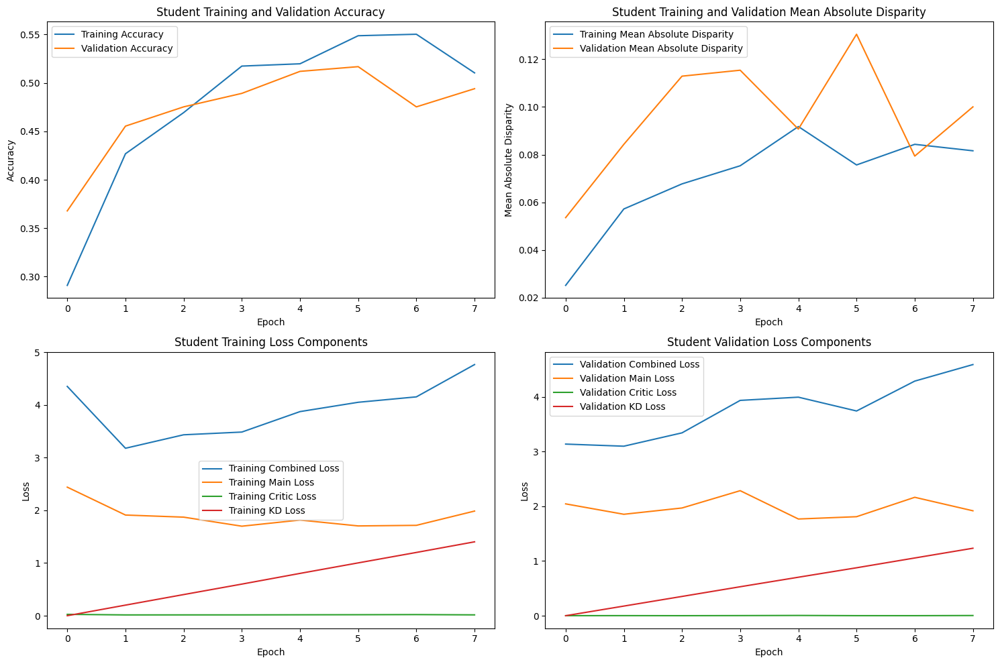

Epoch 9/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.53it/s]



STUDENT - Lambda 5 - Epoch 9 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.568171, VALIDATION Accuracy: 0.5085
TRAINING Disparity: 0.079008, VALIDATION Disparity: 0.1091
TRAINING Combined Loss: 4.504693, VALIDATION Combined Loss: 4.7191
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.10532233883058473
Class Celebration: Val Disparity = 0.09487179487179487
Class Parade: Val Disparity = -0.0009337068160596429
Class Waiter_Or_Waitress: Val Disparity = 0.14810924369747897
Class Individual_Sports: Val Disparity = -0.12222222222222223
Class Surgeons: Val Disparity = 0.004081632653061218
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.1547619047619047
Class Business: Val Disparity = 0.07561989835207139
Class Dresses: Val Disparity = -0.20811594202898565
Class Water_Activities: Val Disparity = 0.11597633136094676
Class Picnic: Val Disparity = 0.040669856459330134
Class Rescue: Val Disparity = -

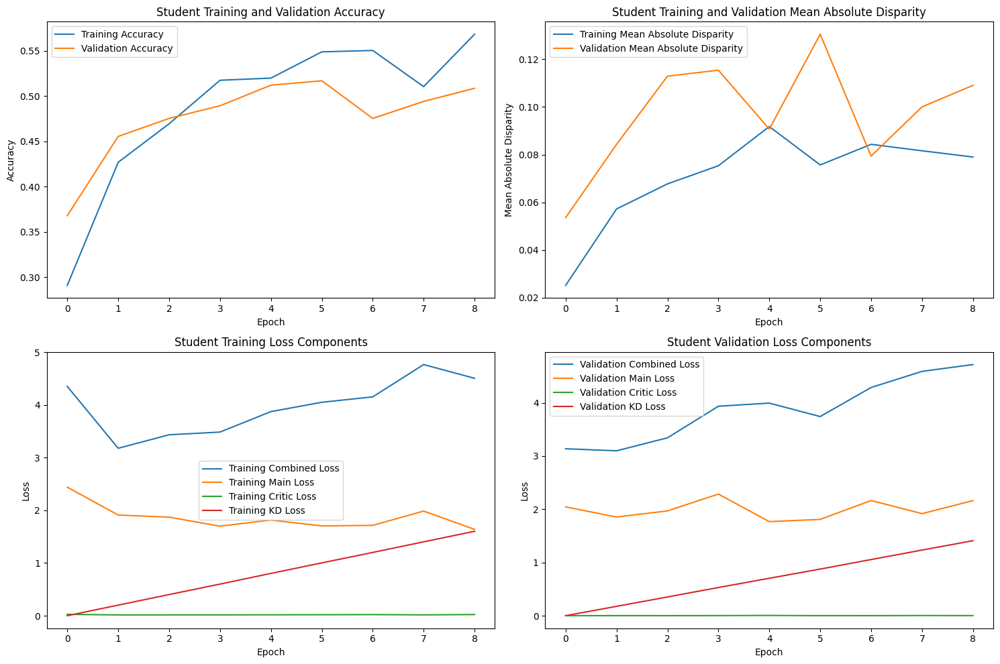

Epoch 10/10, Validation: 100%|███████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.49it/s]



STUDENT - Lambda 5 - Epoch 10 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.565953, VALIDATION Accuracy: 0.4739
TRAINING Disparity: 0.077048, VALIDATION Disparity: 0.0864
TRAINING Combined Loss: 5.059388, VALIDATION Combined Loss: 5.5061
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.10532233883058473
Class Celebration: Val Disparity = 0.09487179487179487
Class Parade: Val Disparity = -0.0009337068160596429
Class Waiter_Or_Waitress: Val Disparity = 0.14810924369747897
Class Individual_Sports: Val Disparity = -0.12222222222222223
Class Surgeons: Val Disparity = 0.004081632653061218
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.1547619047619047
Class Business: Val Disparity = 0.07561989835207139
Class Dresses: Val Disparity = -0.20811594202898565
Class Water_Activities: Val Disparity = 0.11597633136094676
Class Picnic: Val Disparity = 0.040669856459330134
Class Rescue: Val Disparity = 

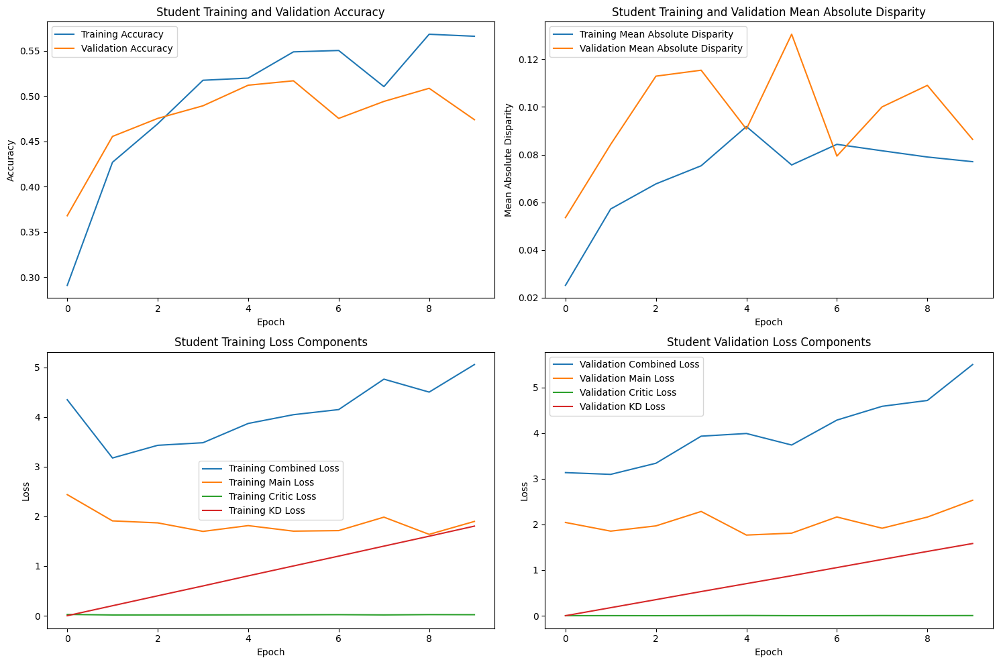

Finished Training STUDENT with lambda value of 5. Best epoch number: 2
Training Student with Lambda Value of 10


Epoch 1/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.54it/s]



STUDENT - Lambda 10 - Epoch 1 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.232292, VALIDATION Accuracy: 0.2960
TRAINING Disparity: 0.020378, VALIDATION Disparity: 0.0464
TRAINING Combined Loss: 4.935792, VALIDATION Combined Loss: 3.3735
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.06990254872563717
Class Celebration: Val Disparity = -0.0585873246250605
Class Parade: Val Disparity = -0.017740429505135435
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.02693602693602698
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.07873376623376627
Class Business: Val Disparity = 0.006468504543354389
Class Dresses: Val Disparity = -0.11652173913043479
Class Water_Activities: Val Disparity = -0.014990138067061134
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class Pe

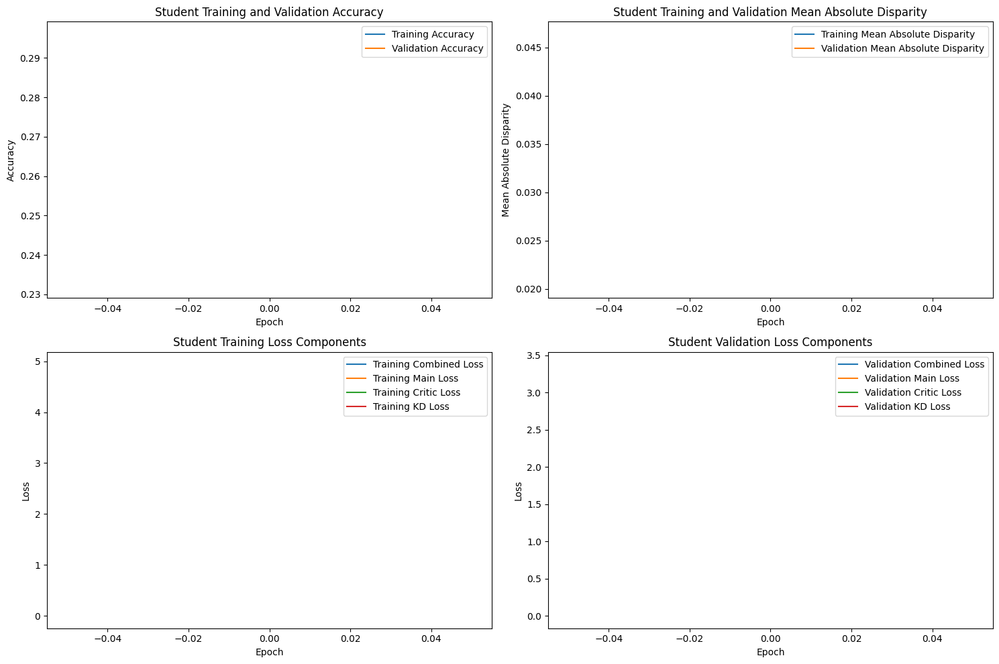

Epoch 2/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.51it/s]



STUDENT - Lambda 10 - Epoch 2 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.330440, VALIDATION Accuracy: 0.3796
TRAINING Disparity: 0.041462, VALIDATION Disparity: 0.0774
TRAINING Combined Loss: 3.480177, VALIDATION Combined Loss: 3.3031
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.10388555722138926
Class Celebration: Val Disparity = 0.026705370101596543
Class Parade: Val Disparity = 0.027077497665732975
Class Waiter_Or_Waitress: Val Disparity = 0.04096638655462184
Class Individual_Sports: Val Disparity = -0.06810529537802268
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.15638528138528146
Class Business: Val Disparity = 0.13845679963037122
Class Dresses: Val Disparity = -0.2159420289855072
Class Water_Activities: Val Disparity = -0.07554240631163711
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity 

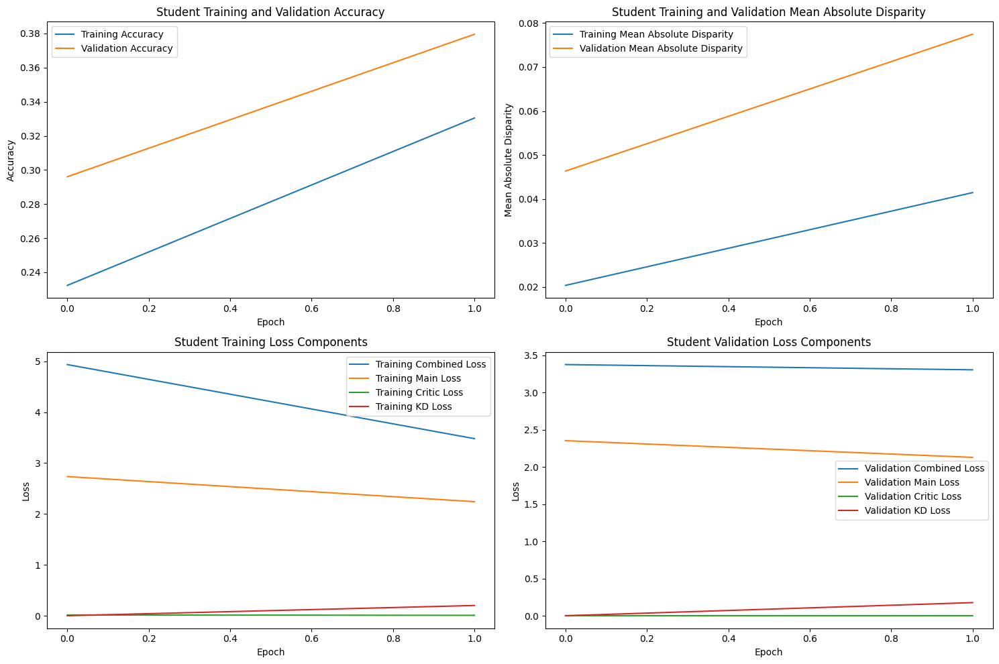

Epoch 3/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.53it/s]



STUDENT - Lambda 10 - Epoch 3 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.392130, VALIDATION Accuracy: 0.4373
TRAINING Disparity: 0.049732, VALIDATION Disparity: 0.0934
TRAINING Combined Loss: 3.757820, VALIDATION Combined Loss: 3.3409
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.10388555722138926
Class Celebration: Val Disparity = 0.026705370101596543
Class Parade: Val Disparity = 0.027077497665732975
Class Waiter_Or_Waitress: Val Disparity = 0.04096638655462184
Class Individual_Sports: Val Disparity = -0.06810529537802268
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.15638528138528146
Class Business: Val Disparity = 0.13845679963037122
Class Dresses: Val Disparity = -0.2159420289855072
Class Water_Activities: Val Disparity = -0.07554240631163711
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity 

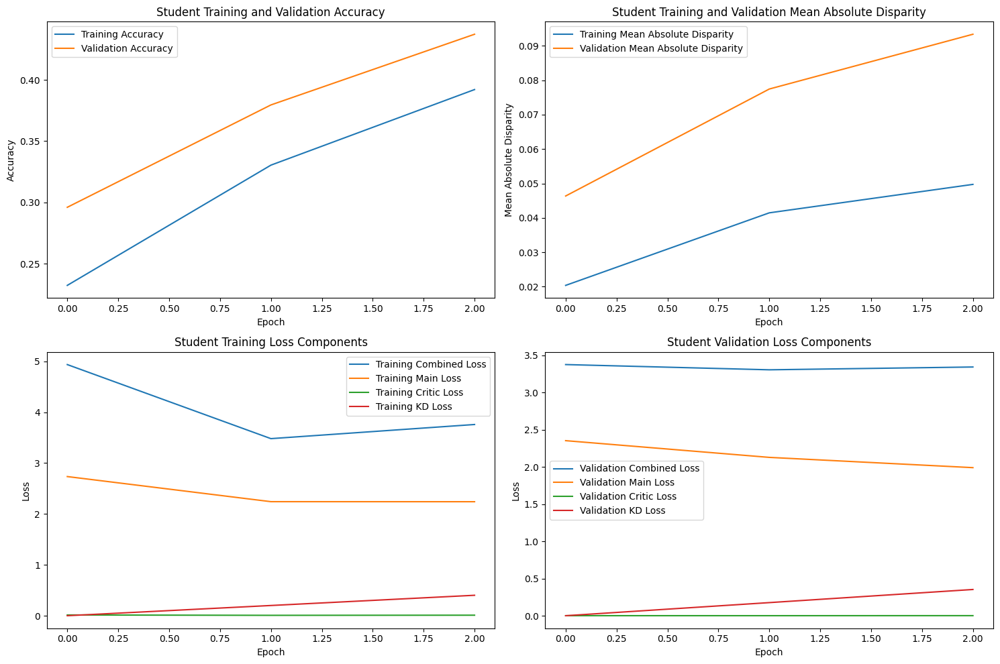

Epoch 4/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.52it/s]



STUDENT - Lambda 10 - Epoch 4 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.444194, VALIDATION Accuracy: 0.4378
TRAINING Disparity: 0.059911, VALIDATION Disparity: 0.0721
TRAINING Combined Loss: 3.808512, VALIDATION Combined Loss: 3.6514
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.10388555722138926
Class Celebration: Val Disparity = 0.026705370101596543
Class Parade: Val Disparity = 0.027077497665732975
Class Waiter_Or_Waitress: Val Disparity = 0.04096638655462184
Class Individual_Sports: Val Disparity = -0.06810529537802268
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.15638528138528146
Class Business: Val Disparity = 0.13845679963037122
Class Dresses: Val Disparity = -0.2159420289855072
Class Water_Activities: Val Disparity = -0.07554240631163711
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity 

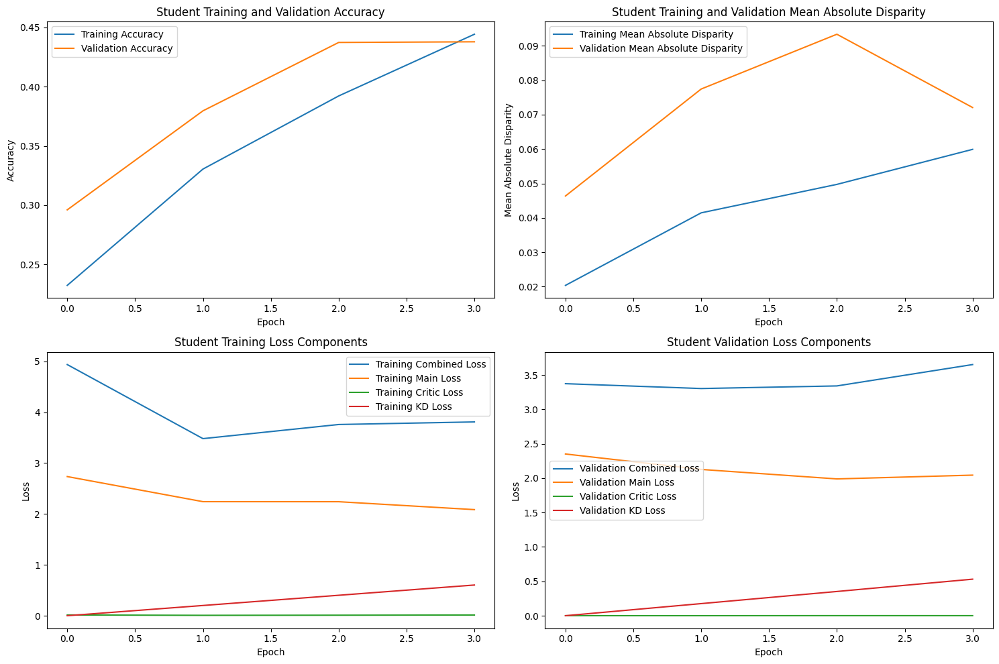

Epoch 5/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.52it/s]



STUDENT - Lambda 10 - Epoch 5 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.451080, VALIDATION Accuracy: 0.3972
TRAINING Disparity: 0.072372, VALIDATION Disparity: 0.0605
TRAINING Combined Loss: 4.443271, VALIDATION Combined Loss: 4.7339
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.10388555722138926
Class Celebration: Val Disparity = 0.026705370101596543
Class Parade: Val Disparity = 0.027077497665732975
Class Waiter_Or_Waitress: Val Disparity = 0.04096638655462184
Class Individual_Sports: Val Disparity = -0.06810529537802268
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.15638528138528146
Class Business: Val Disparity = 0.13845679963037122
Class Dresses: Val Disparity = -0.2159420289855072
Class Water_Activities: Val Disparity = -0.07554240631163711
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity 

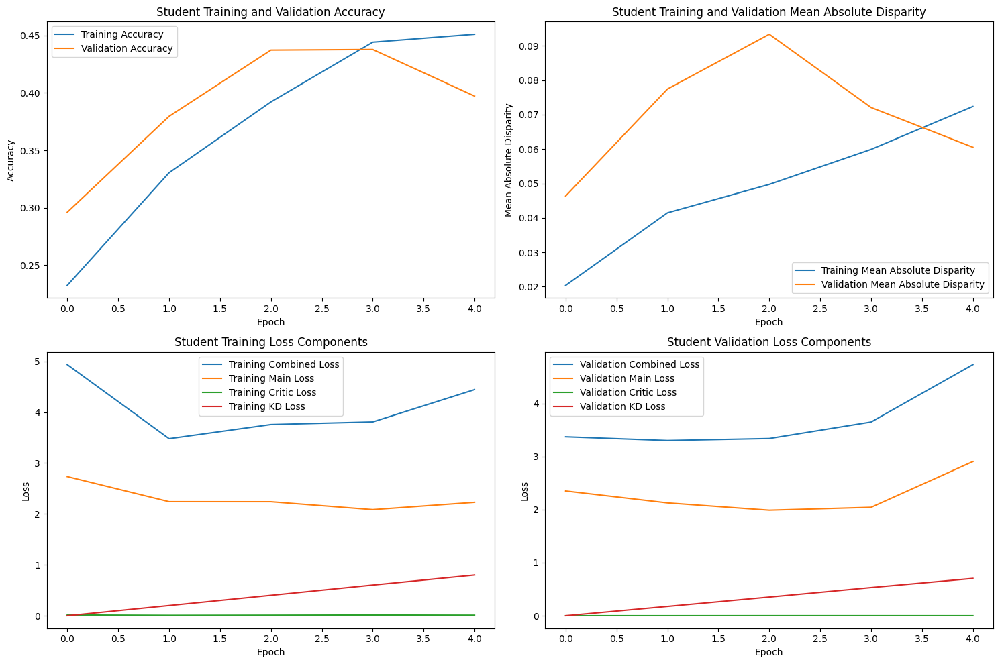

Epoch 6/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.48it/s]



STUDENT - Lambda 10 - Epoch 6 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.440432, VALIDATION Accuracy: 0.4003
TRAINING Disparity: 0.060971, VALIDATION Disparity: 0.0867
TRAINING Combined Loss: 5.025056, VALIDATION Combined Loss: 6.5777
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.10388555722138926
Class Celebration: Val Disparity = 0.026705370101596543
Class Parade: Val Disparity = 0.027077497665732975
Class Waiter_Or_Waitress: Val Disparity = 0.04096638655462184
Class Individual_Sports: Val Disparity = -0.06810529537802268
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.15638528138528146
Class Business: Val Disparity = 0.13845679963037122
Class Dresses: Val Disparity = -0.2159420289855072
Class Water_Activities: Val Disparity = -0.07554240631163711
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity 

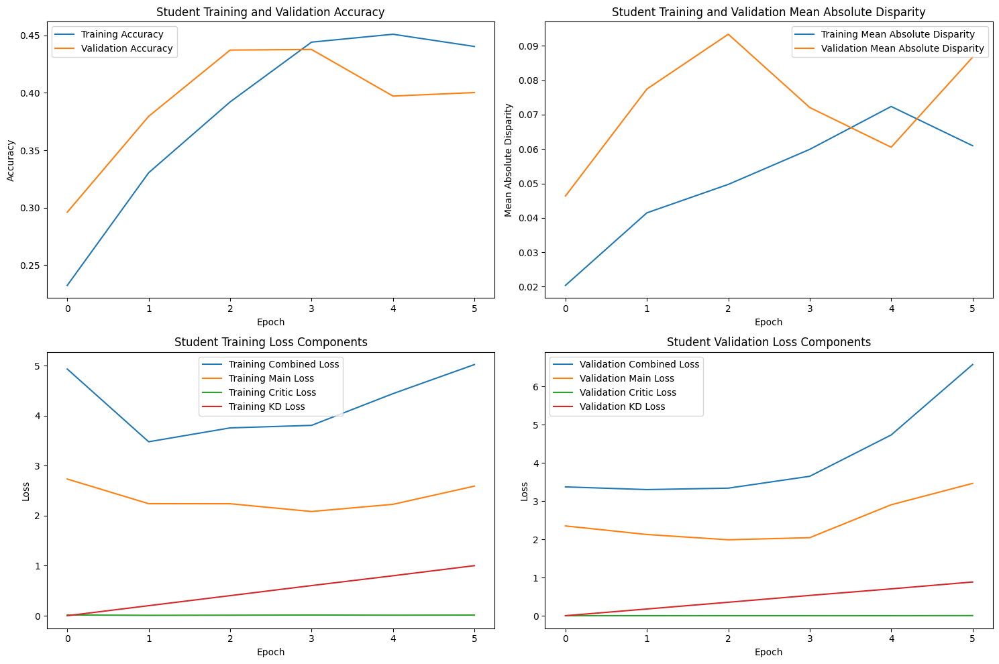

Epoch 7/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.46it/s]



STUDENT - Lambda 10 - Epoch 7 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.435436, VALIDATION Accuracy: 0.4543
TRAINING Disparity: 0.047848, VALIDATION Disparity: 0.0904
TRAINING Combined Loss: 5.556579, VALIDATION Combined Loss: 4.9309
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.10388555722138926
Class Celebration: Val Disparity = 0.026705370101596543
Class Parade: Val Disparity = 0.027077497665732975
Class Waiter_Or_Waitress: Val Disparity = 0.04096638655462184
Class Individual_Sports: Val Disparity = -0.06810529537802268
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.15638528138528146
Class Business: Val Disparity = 0.13845679963037122
Class Dresses: Val Disparity = -0.2159420289855072
Class Water_Activities: Val Disparity = -0.07554240631163711
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity 

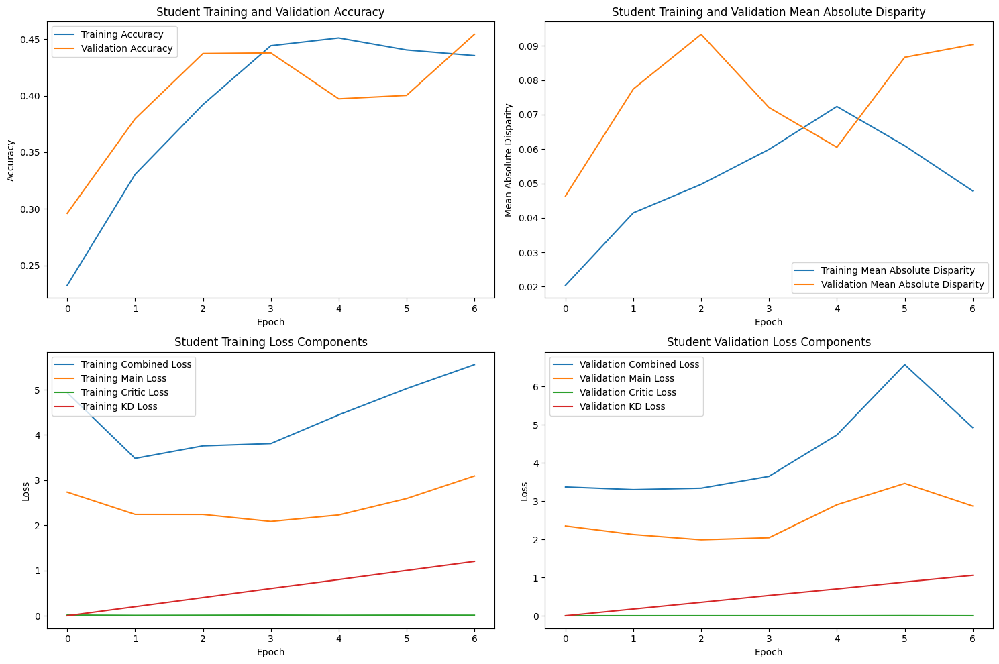

Epoch 8/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.49it/s]



STUDENT - Lambda 10 - Epoch 8 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.503935, VALIDATION Accuracy: 0.4690
TRAINING Disparity: 0.064599, VALIDATION Disparity: 0.0950
TRAINING Combined Loss: 4.738800, VALIDATION Combined Loss: 5.5026
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.10388555722138926
Class Celebration: Val Disparity = 0.026705370101596543
Class Parade: Val Disparity = 0.027077497665732975
Class Waiter_Or_Waitress: Val Disparity = 0.04096638655462184
Class Individual_Sports: Val Disparity = -0.06810529537802268
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.15638528138528146
Class Business: Val Disparity = 0.13845679963037122
Class Dresses: Val Disparity = -0.2159420289855072
Class Water_Activities: Val Disparity = -0.07554240631163711
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity 

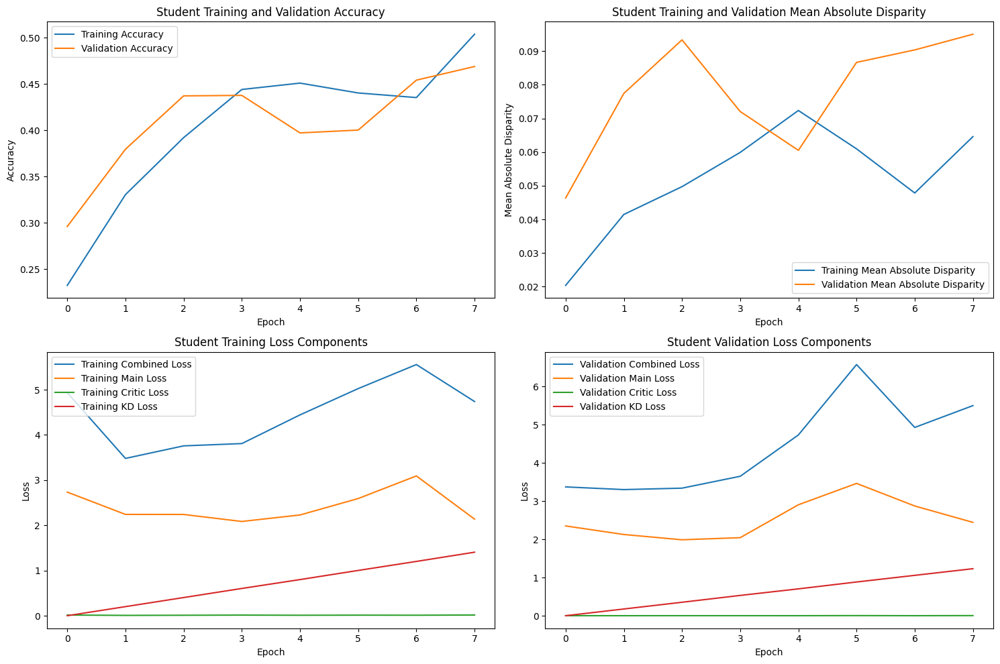

Epoch 9/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.48it/s]



STUDENT - Lambda 10 - Epoch 9 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.517959, VALIDATION Accuracy: 0.4813
TRAINING Disparity: 0.080565, VALIDATION Disparity: 0.1058
TRAINING Combined Loss: 4.998115, VALIDATION Combined Loss: 4.7013
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.10388555722138926
Class Celebration: Val Disparity = 0.026705370101596543
Class Parade: Val Disparity = 0.027077497665732975
Class Waiter_Or_Waitress: Val Disparity = 0.04096638655462184
Class Individual_Sports: Val Disparity = -0.06810529537802268
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.15638528138528146
Class Business: Val Disparity = 0.13845679963037122
Class Dresses: Val Disparity = -0.2159420289855072
Class Water_Activities: Val Disparity = -0.07554240631163711
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity 

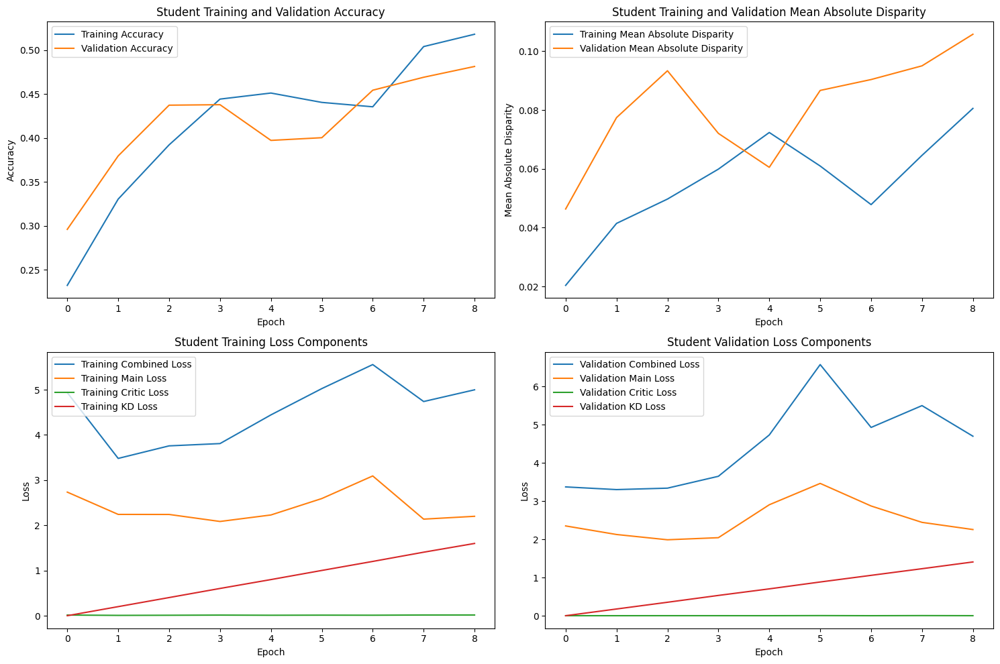

Epoch 10/10, Validation: 100%|███████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.45it/s]



STUDENT - Lambda 10 - Epoch 10 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.584761, VALIDATION Accuracy: 0.5381
TRAINING Disparity: 0.083238, VALIDATION Disparity: 0.1191
TRAINING Combined Loss: 5.111632, VALIDATION Combined Loss: 4.8905
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.10388555722138926
Class Celebration: Val Disparity = 0.026705370101596543
Class Parade: Val Disparity = 0.027077497665732975
Class Waiter_Or_Waitress: Val Disparity = 0.04096638655462184
Class Individual_Sports: Val Disparity = -0.06810529537802268
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.15638528138528146
Class Business: Val Disparity = 0.13845679963037122
Class Dresses: Val Disparity = -0.2159420289855072
Class Water_Activities: Val Disparity = -0.07554240631163711
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity

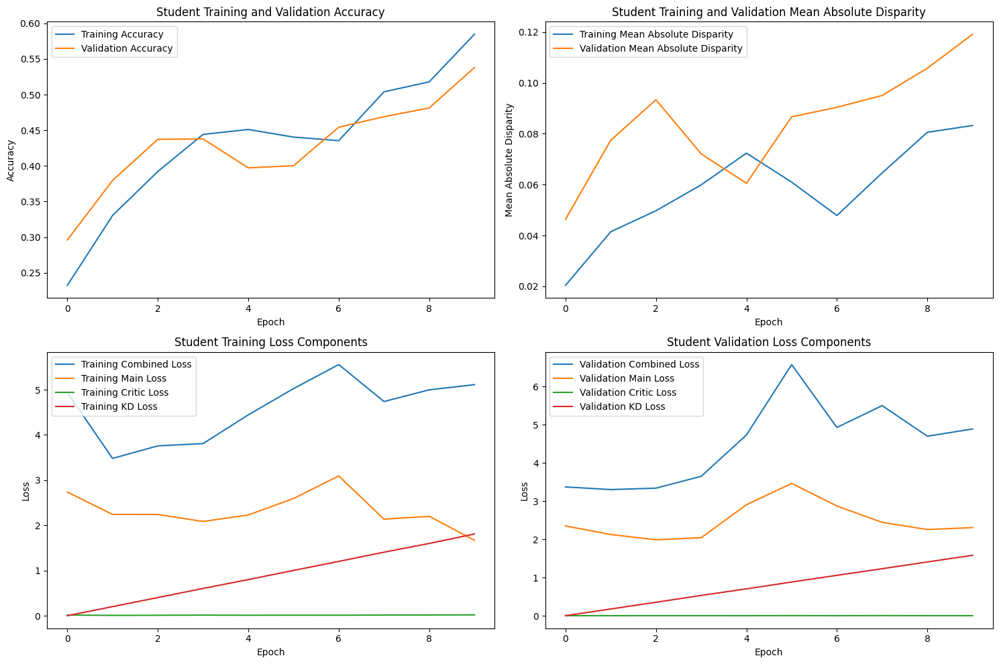

Finished Training STUDENT with lambda value of 10. Best epoch number: 2
Training Student with Lambda Value of 15


Epoch 1/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.49it/s]



STUDENT - Lambda 15 - Epoch 1 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.220255, VALIDATION Accuracy: 0.2048
TRAINING Disparity: 0.020959, VALIDATION Disparity: 0.0491
TRAINING Combined Loss: 7.053676, VALIDATION Combined Loss: 3.9433
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.02480009995002508
Class Celebration: Val Disparity = 0.030575713594581534
Class Parade: Val Disparity = 0.14752567693744173
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = -0.0670951943679216
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = -0.009467455621301746
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class Performance_And_Entertainment: Val Disparity = 0.0152

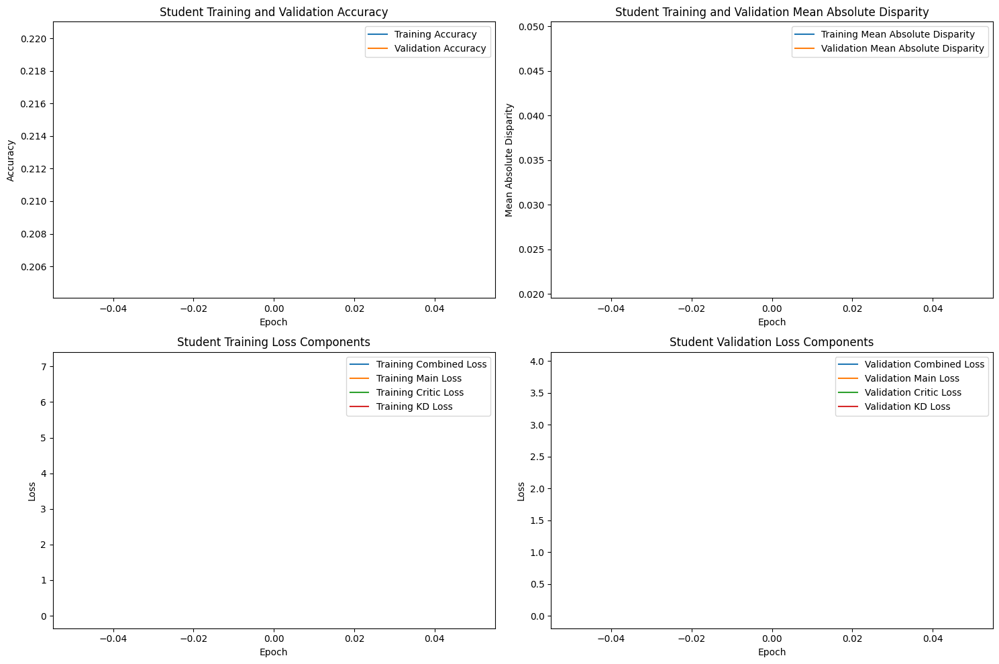

Epoch 2/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.47it/s]



STUDENT - Lambda 15 - Epoch 2 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.277353, VALIDATION Accuracy: 0.2961
TRAINING Disparity: 0.030349, VALIDATION Disparity: 0.0637
TRAINING Combined Loss: 3.657675, VALIDATION Combined Loss: 3.6941
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.15117441279360333
Class Celebration: Val Disparity = 0.009675858732462517
Class Parade: Val Disparity = -0.055088702147525814
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = -0.038261401897765446
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.06222943722943724
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = -0.06370808678500983
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.024434389140271497
Class Performance_And_E

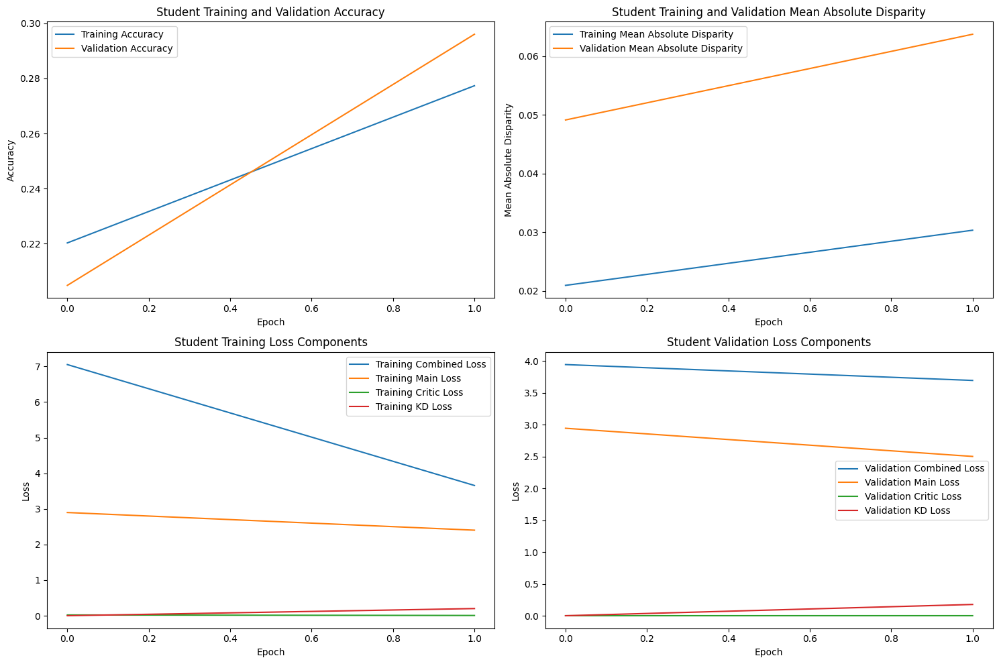

Epoch 3/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.51it/s]



STUDENT - Lambda 15 - Epoch 3 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.303993, VALIDATION Accuracy: 0.3435
TRAINING Disparity: 0.027297, VALIDATION Disparity: 0.0921
TRAINING Combined Loss: 3.881813, VALIDATION Combined Loss: 3.6437
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.07221389305347325
Class Celebration: Val Disparity = -0.02046444121915819
Class Parade: Val Disparity = -0.039215686274509665
Class Waiter_Or_Waitress: Val Disparity = 0.037815126050420166
Class Individual_Sports: Val Disparity = -0.18264462809917364
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.3176406926406926
Class Business: Val Disparity = -0.05020791621746497
Class Dresses: Val Disparity = 0.020289855072463767
Class Water_Activities: Val Disparity = -0.1642998027613412
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparit

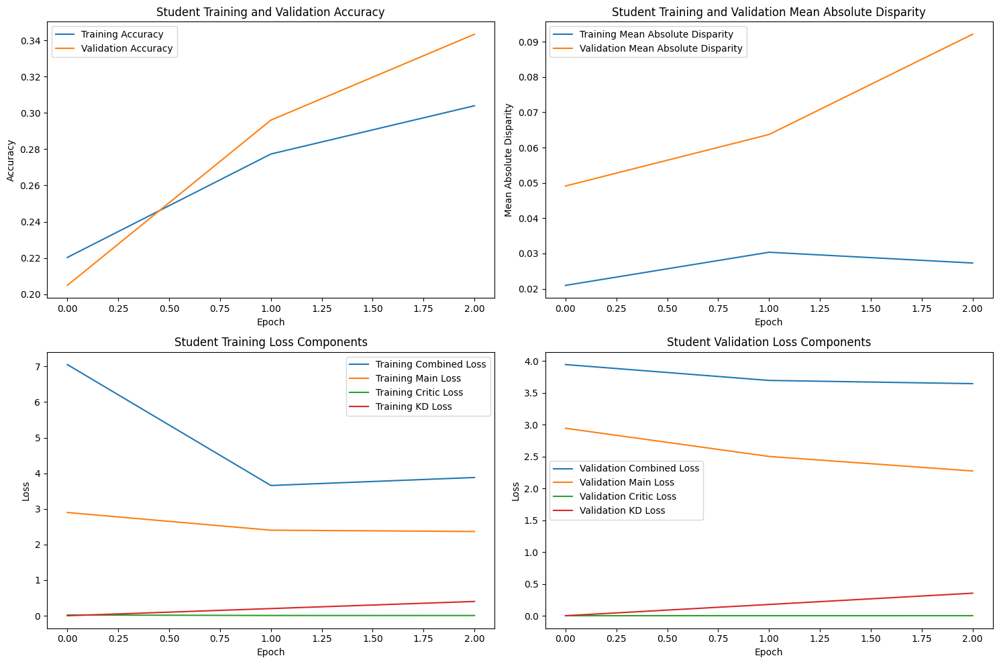

Epoch 4/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.49it/s]



STUDENT - Lambda 15 - Epoch 4 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.337789, VALIDATION Accuracy: 0.2739
TRAINING Disparity: 0.045411, VALIDATION Disparity: 0.0431
TRAINING Combined Loss: 4.215167, VALIDATION Combined Loss: 4.3288
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.07221389305347325
Class Celebration: Val Disparity = -0.02046444121915819
Class Parade: Val Disparity = -0.039215686274509665
Class Waiter_Or_Waitress: Val Disparity = 0.037815126050420166
Class Individual_Sports: Val Disparity = -0.18264462809917364
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.3176406926406926
Class Business: Val Disparity = -0.05020791621746497
Class Dresses: Val Disparity = 0.020289855072463767
Class Water_Activities: Val Disparity = -0.1642998027613412
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparit

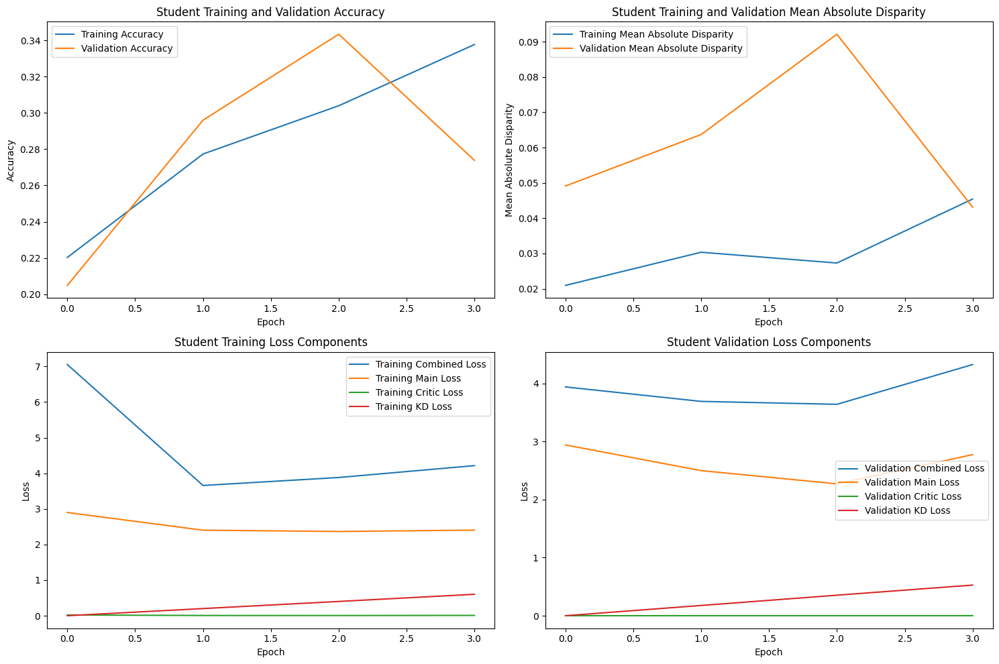

Epoch 5/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.52it/s]



STUDENT - Lambda 15 - Epoch 5 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.366281, VALIDATION Accuracy: 0.3811
TRAINING Disparity: 0.044955, VALIDATION Disparity: 0.0791
TRAINING Combined Loss: 4.263639, VALIDATION Combined Loss: 4.0063
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.07221389305347325
Class Celebration: Val Disparity = -0.02046444121915819
Class Parade: Val Disparity = -0.039215686274509665
Class Waiter_Or_Waitress: Val Disparity = 0.037815126050420166
Class Individual_Sports: Val Disparity = -0.18264462809917364
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.3176406926406926
Class Business: Val Disparity = -0.05020791621746497
Class Dresses: Val Disparity = 0.020289855072463767
Class Water_Activities: Val Disparity = -0.1642998027613412
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparit

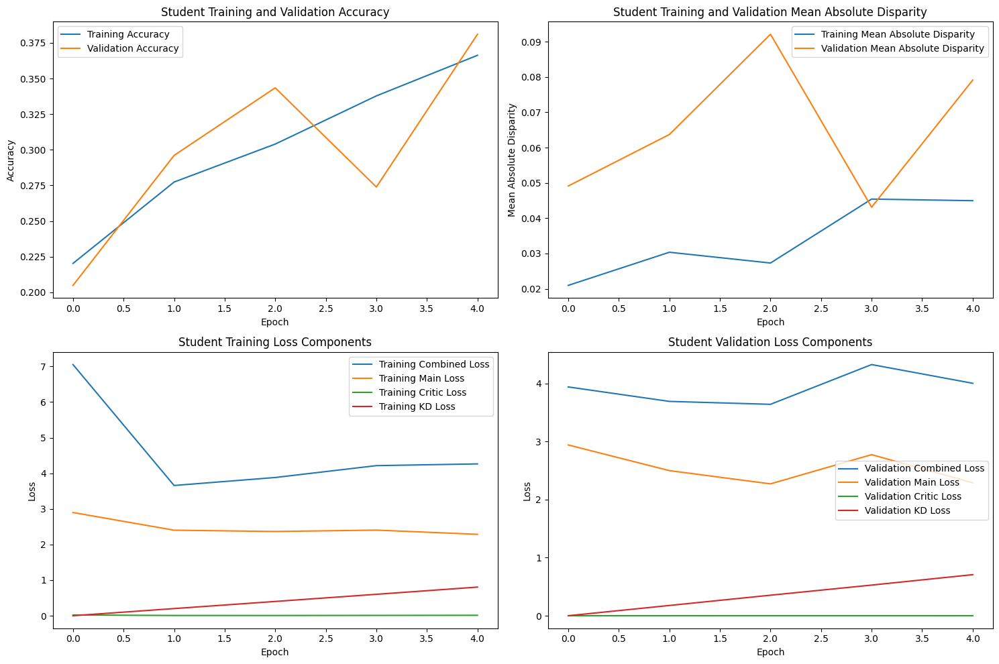

Epoch 6/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.50it/s]



STUDENT - Lambda 15 - Epoch 6 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.387982, VALIDATION Accuracy: 0.4034
TRAINING Disparity: 0.051048, VALIDATION Disparity: 0.0928
TRAINING Combined Loss: 4.325979, VALIDATION Combined Loss: 4.3005
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.07221389305347325
Class Celebration: Val Disparity = -0.02046444121915819
Class Parade: Val Disparity = -0.039215686274509665
Class Waiter_Or_Waitress: Val Disparity = 0.037815126050420166
Class Individual_Sports: Val Disparity = -0.18264462809917364
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.3176406926406926
Class Business: Val Disparity = -0.05020791621746497
Class Dresses: Val Disparity = 0.020289855072463767
Class Water_Activities: Val Disparity = -0.1642998027613412
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparit

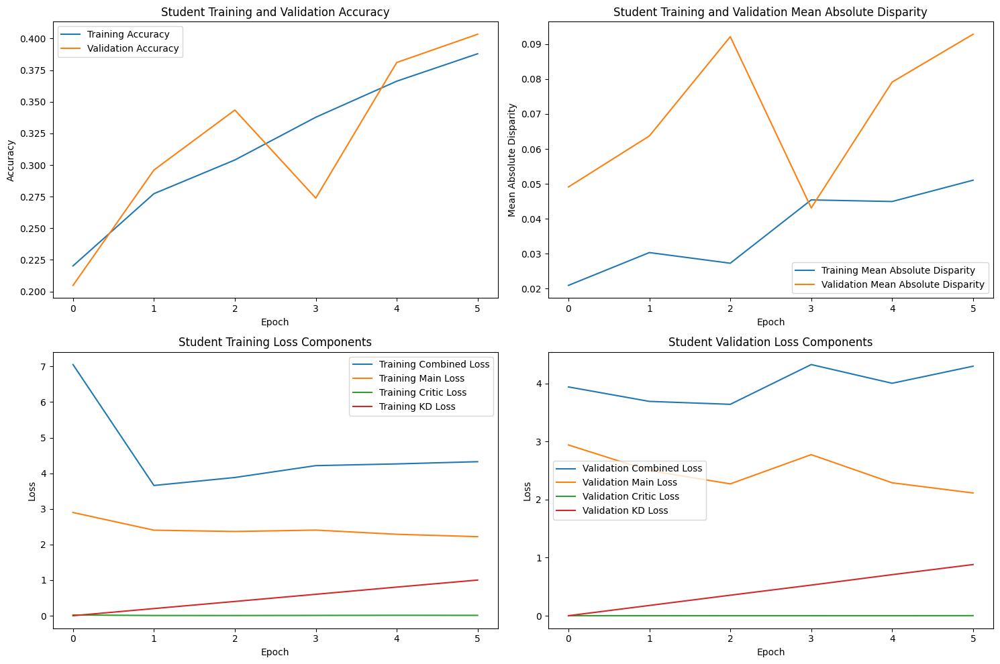

Epoch 7/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.46it/s]



STUDENT - Lambda 15 - Epoch 7 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.389448, VALIDATION Accuracy: 0.3673
TRAINING Disparity: 0.054554, VALIDATION Disparity: 0.0601
TRAINING Combined Loss: 4.798058, VALIDATION Combined Loss: 4.9166
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.07221389305347325
Class Celebration: Val Disparity = -0.02046444121915819
Class Parade: Val Disparity = -0.039215686274509665
Class Waiter_Or_Waitress: Val Disparity = 0.037815126050420166
Class Individual_Sports: Val Disparity = -0.18264462809917364
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.3176406926406926
Class Business: Val Disparity = -0.05020791621746497
Class Dresses: Val Disparity = 0.020289855072463767
Class Water_Activities: Val Disparity = -0.1642998027613412
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparit

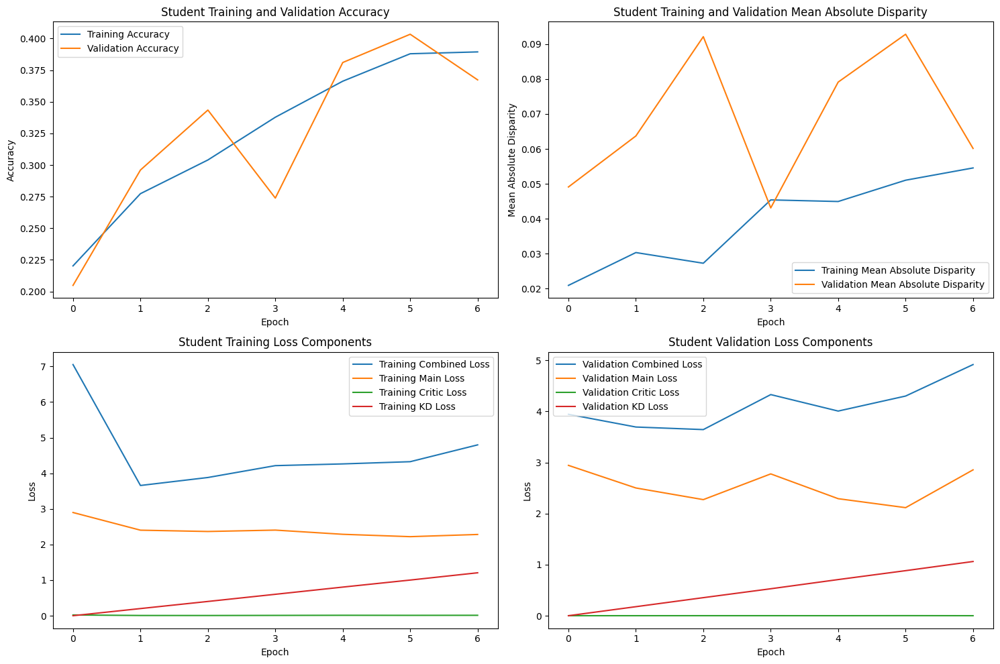

Epoch 8/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.50it/s]



STUDENT - Lambda 15 - Epoch 8 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.412095, VALIDATION Accuracy: 0.4063
TRAINING Disparity: 0.064310, VALIDATION Disparity: 0.0821
TRAINING Combined Loss: 4.958040, VALIDATION Combined Loss: 4.6703
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.07221389305347325
Class Celebration: Val Disparity = -0.02046444121915819
Class Parade: Val Disparity = -0.039215686274509665
Class Waiter_Or_Waitress: Val Disparity = 0.037815126050420166
Class Individual_Sports: Val Disparity = -0.18264462809917364
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.3176406926406926
Class Business: Val Disparity = -0.05020791621746497
Class Dresses: Val Disparity = 0.020289855072463767
Class Water_Activities: Val Disparity = -0.1642998027613412
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparit

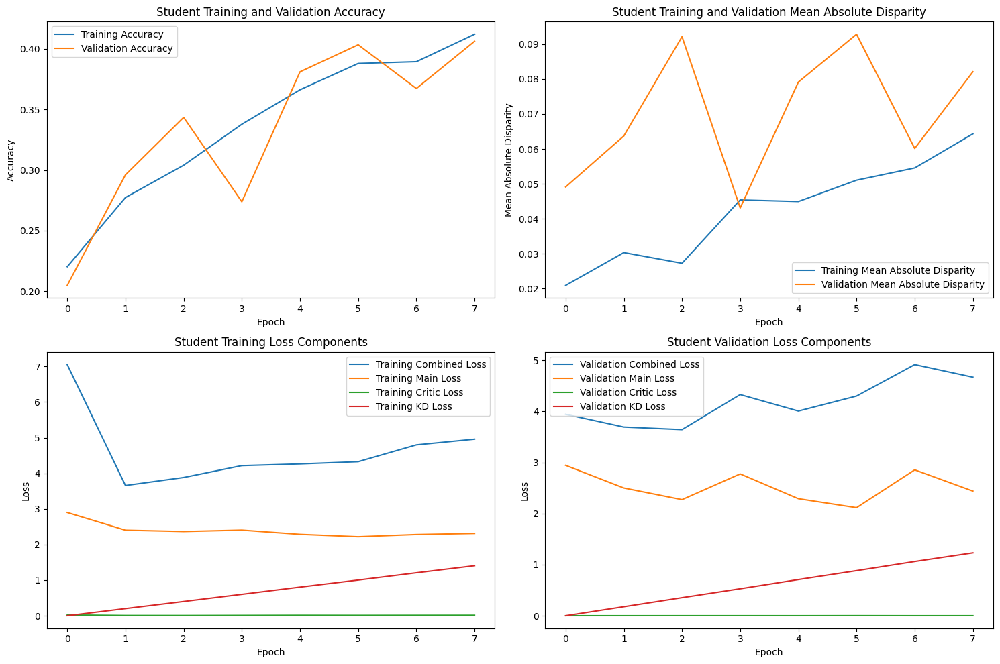

Epoch 9/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.47it/s]



STUDENT - Lambda 15 - Epoch 9 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.408526, VALIDATION Accuracy: 0.4310
TRAINING Disparity: 0.064062, VALIDATION Disparity: 0.0650
TRAINING Combined Loss: 5.224613, VALIDATION Combined Loss: 5.1114
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.07221389305347325
Class Celebration: Val Disparity = -0.02046444121915819
Class Parade: Val Disparity = -0.039215686274509665
Class Waiter_Or_Waitress: Val Disparity = 0.037815126050420166
Class Individual_Sports: Val Disparity = -0.18264462809917364
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.3176406926406926
Class Business: Val Disparity = -0.05020791621746497
Class Dresses: Val Disparity = 0.020289855072463767
Class Water_Activities: Val Disparity = -0.1642998027613412
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparit

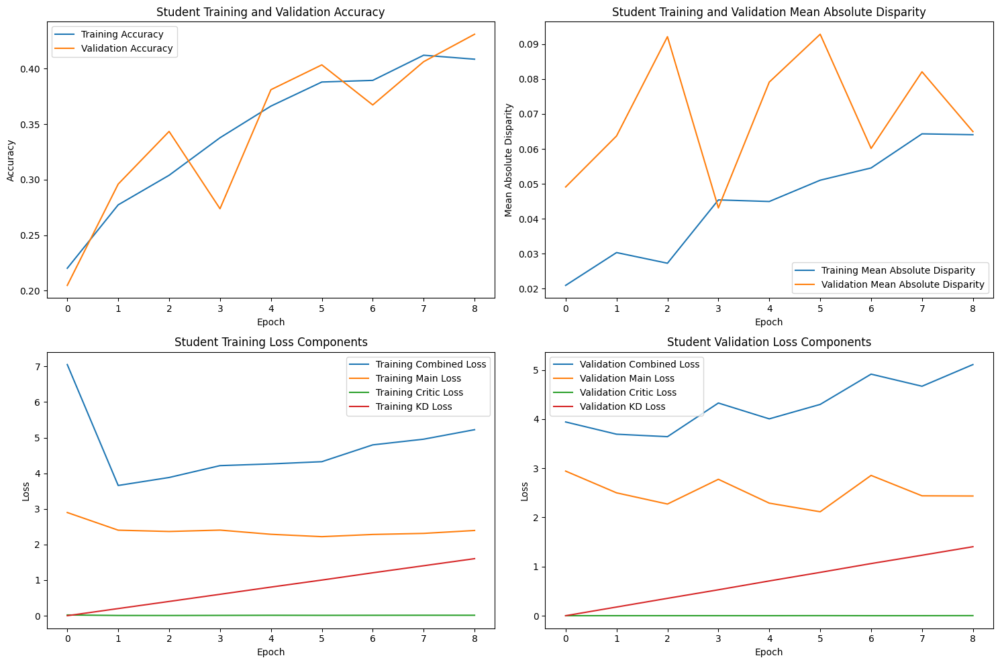

Epoch 10/10, Validation: 100%|███████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.47it/s]



STUDENT - Lambda 15 - Epoch 10 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.429591, VALIDATION Accuracy: 0.4554
TRAINING Disparity: 0.058062, VALIDATION Disparity: 0.0921
TRAINING Combined Loss: 5.375400, VALIDATION Combined Loss: 4.8003
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.07221389305347325
Class Celebration: Val Disparity = -0.02046444121915819
Class Parade: Val Disparity = -0.039215686274509665
Class Waiter_Or_Waitress: Val Disparity = 0.037815126050420166
Class Individual_Sports: Val Disparity = -0.18264462809917364
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.3176406926406926
Class Business: Val Disparity = -0.05020791621746497
Class Dresses: Val Disparity = 0.020289855072463767
Class Water_Activities: Val Disparity = -0.1642998027613412
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Dispari

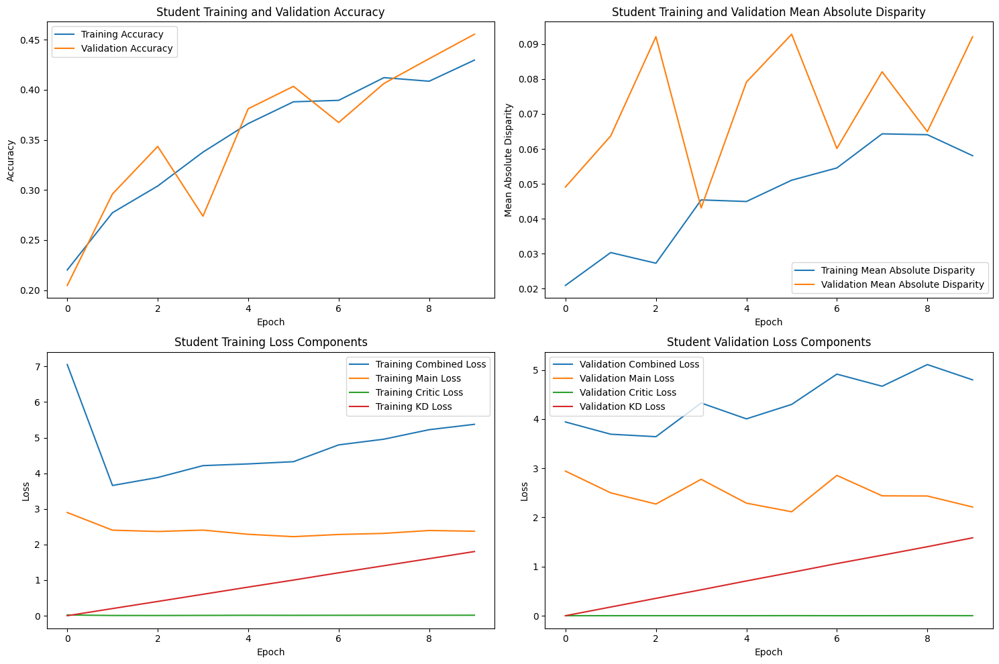

Finished Training STUDENT with lambda value of 15. Best epoch number: 3
Training Student with Lambda Value of 20


Epoch 1/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.49it/s]



STUDENT - Lambda 20 - Epoch 1 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.124074, VALIDATION Accuracy: 0.1000
TRAINING Disparity: 0.026878, VALIDATION Disparity: 0.0297
TRAINING Combined Loss: 7.884243, VALIDATION Combined Loss: 4.0464
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.01805347326336832
Class Celebration: Val Disparity = -0.0022254475084663716
Class Parade: Val Disparity = 0.0
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = -0.037006427915518836
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = -0.040584415584415584
Class Business: Val Disparity = 0.03295857076851994
Class Dresses: Val Disparity = 0.07855072463768126
Class Water_Activities: Val Disparity = 0.0
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.007692307692307693
Class Performance_And_

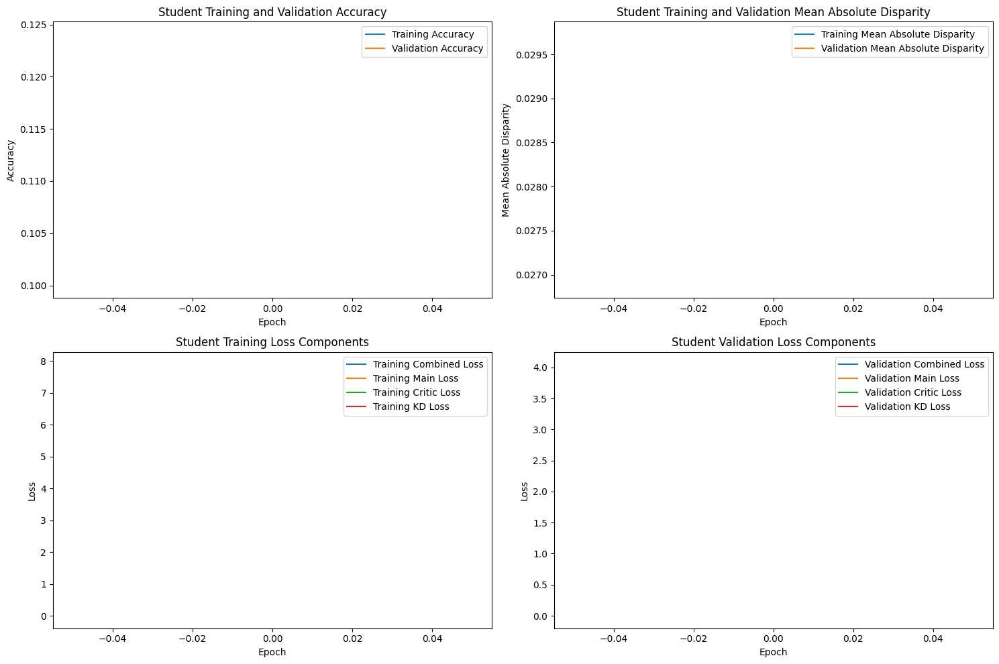

Epoch 2/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.47it/s]



STUDENT - Lambda 20 - Epoch 2 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.177083, VALIDATION Accuracy: 0.1966
TRAINING Disparity: 0.010211, VALIDATION Disparity: 0.0182
TRAINING Combined Loss: 4.070574, VALIDATION Combined Loss: 3.8506
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04316591704147932
Class Celebration: Val Disparity = 0.005128205128205128
Class Parade: Val Disparity = 0.0
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = -0.039210284664830106
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = -0.006666666666666665
Class Water_Activities: Val Disparity = 0.0
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.007692307692307693
Class Performance_And_Entertainment: Val Disparity = 0.0

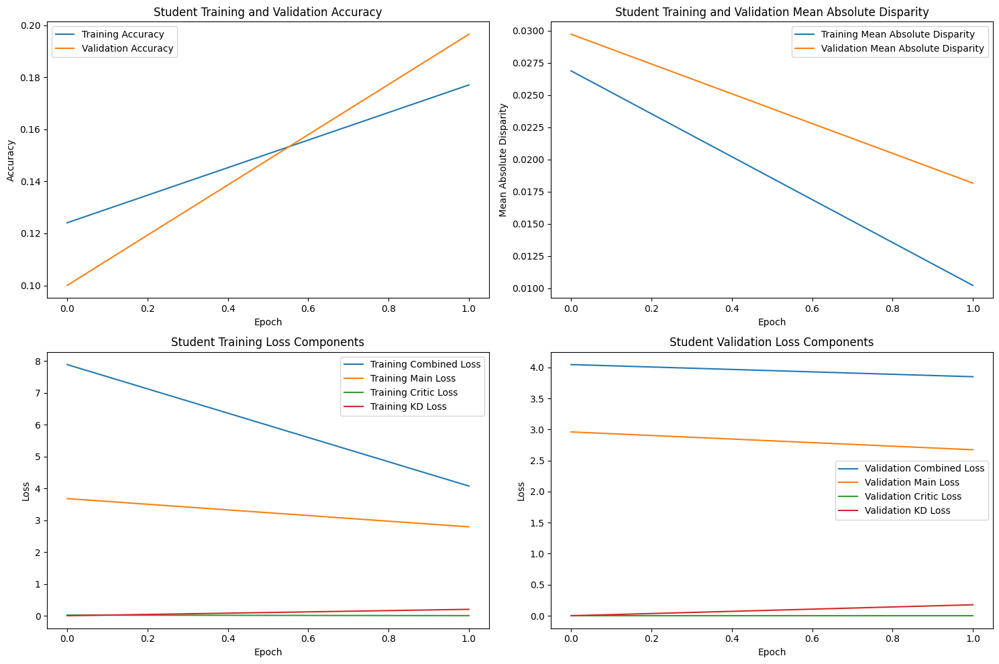

Epoch 3/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.47it/s]



STUDENT - Lambda 20 - Epoch 3 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.199633, VALIDATION Accuracy: 0.2062
TRAINING Disparity: 0.013266, VALIDATION Disparity: 0.0251
TRAINING Combined Loss: 3.951575, VALIDATION Combined Loss: 3.8264
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.014930034982508666
Class Celebration: Val Disparity = 0.0016448959845186302
Class Parade: Val Disparity = 0.050420168067226906
Class Waiter_Or_Waitress: Val Disparity = 0.023109243697479
Class Individual_Sports: Val Disparity = 0.004224058769513317
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.019867549668874173
Class Dresses: Val Disparity = -0.03333333333333333
Class Water_Activities: Val Disparity = 0.02958579881656805
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = -0.021719457

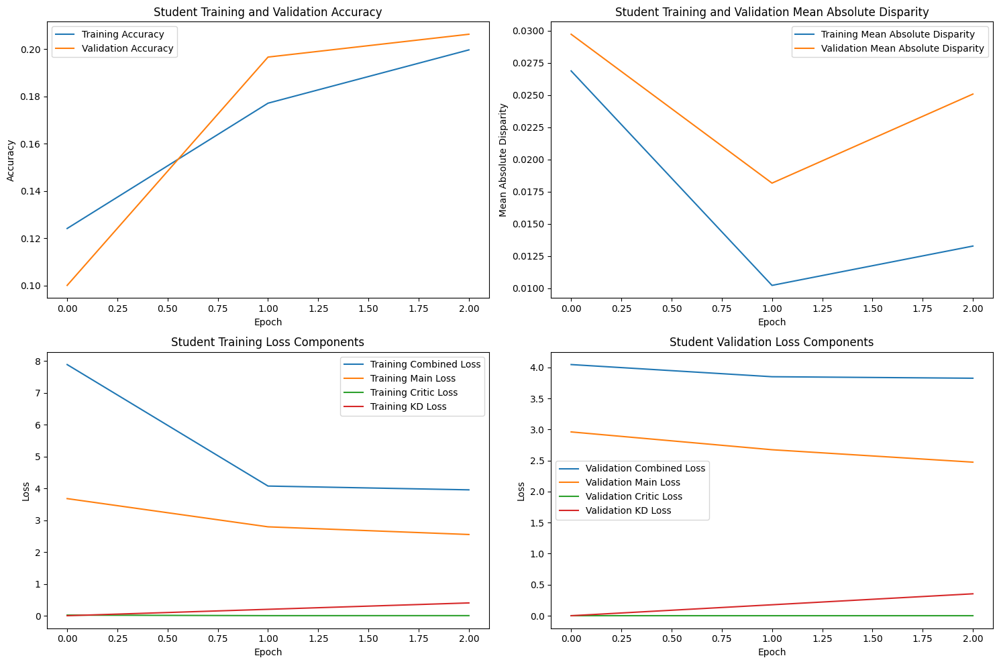

Epoch 4/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.53it/s]



STUDENT - Lambda 20 - Epoch 4 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.206173, VALIDATION Accuracy: 0.1991
TRAINING Disparity: 0.016156, VALIDATION Disparity: 0.0298
TRAINING Combined Loss: 4.240827, VALIDATION Combined Loss: 4.2461
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.014930034982508666
Class Celebration: Val Disparity = 0.0016448959845186302
Class Parade: Val Disparity = 0.050420168067226906
Class Waiter_Or_Waitress: Val Disparity = 0.023109243697479
Class Individual_Sports: Val Disparity = 0.004224058769513317
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.019867549668874173
Class Dresses: Val Disparity = -0.03333333333333333
Class Water_Activities: Val Disparity = 0.02958579881656805
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = -0.021719457

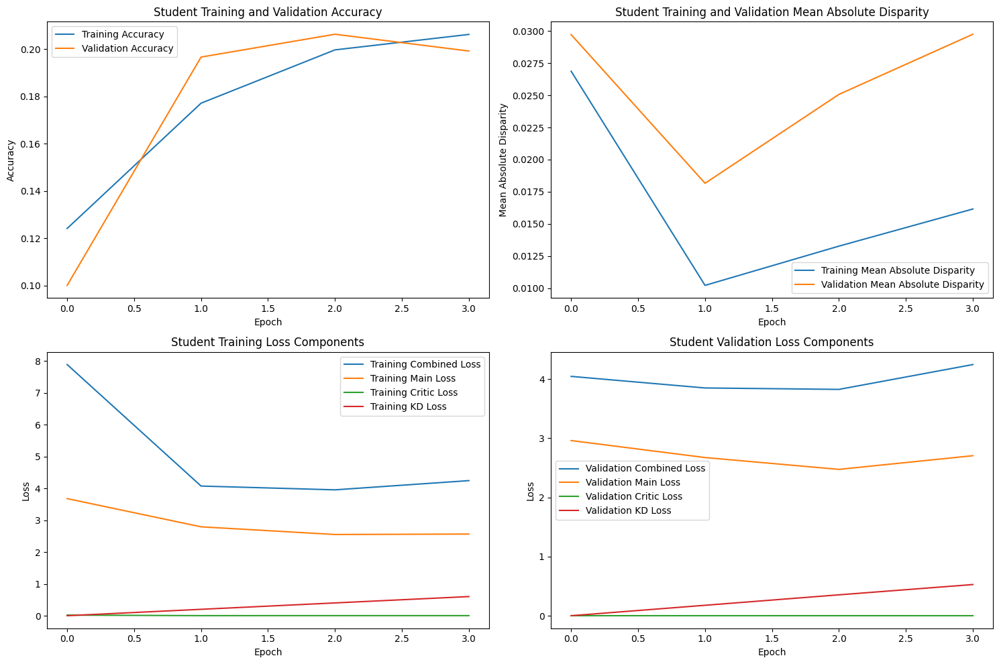

Epoch 5/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.47it/s]



STUDENT - Lambda 20 - Epoch 5 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.216049, VALIDATION Accuracy: 0.2224
TRAINING Disparity: 0.019490, VALIDATION Disparity: 0.0167
TRAINING Combined Loss: 4.364944, VALIDATION Combined Loss: 4.0965
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.014930034982508666
Class Celebration: Val Disparity = 0.0016448959845186302
Class Parade: Val Disparity = 0.050420168067226906
Class Waiter_Or_Waitress: Val Disparity = 0.023109243697479
Class Individual_Sports: Val Disparity = 0.004224058769513317
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.019867549668874173
Class Dresses: Val Disparity = -0.03333333333333333
Class Water_Activities: Val Disparity = 0.02958579881656805
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = -0.021719457

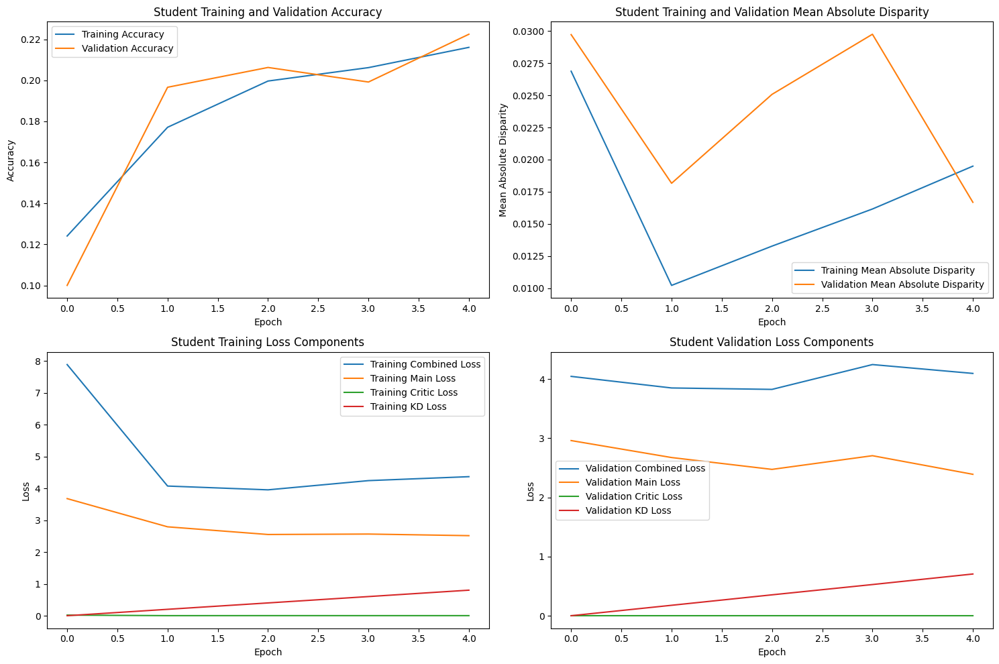

Epoch 6/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.47it/s]



STUDENT - Lambda 20 - Epoch 6 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.230440, VALIDATION Accuracy: 0.2560
TRAINING Disparity: 0.015644, VALIDATION Disparity: 0.0466
TRAINING Combined Loss: 4.450843, VALIDATION Combined Loss: 4.2953
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.014930034982508666
Class Celebration: Val Disparity = 0.0016448959845186302
Class Parade: Val Disparity = 0.050420168067226906
Class Waiter_Or_Waitress: Val Disparity = 0.023109243697479
Class Individual_Sports: Val Disparity = 0.004224058769513317
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.019867549668874173
Class Dresses: Val Disparity = -0.03333333333333333
Class Water_Activities: Val Disparity = 0.02958579881656805
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = -0.021719457

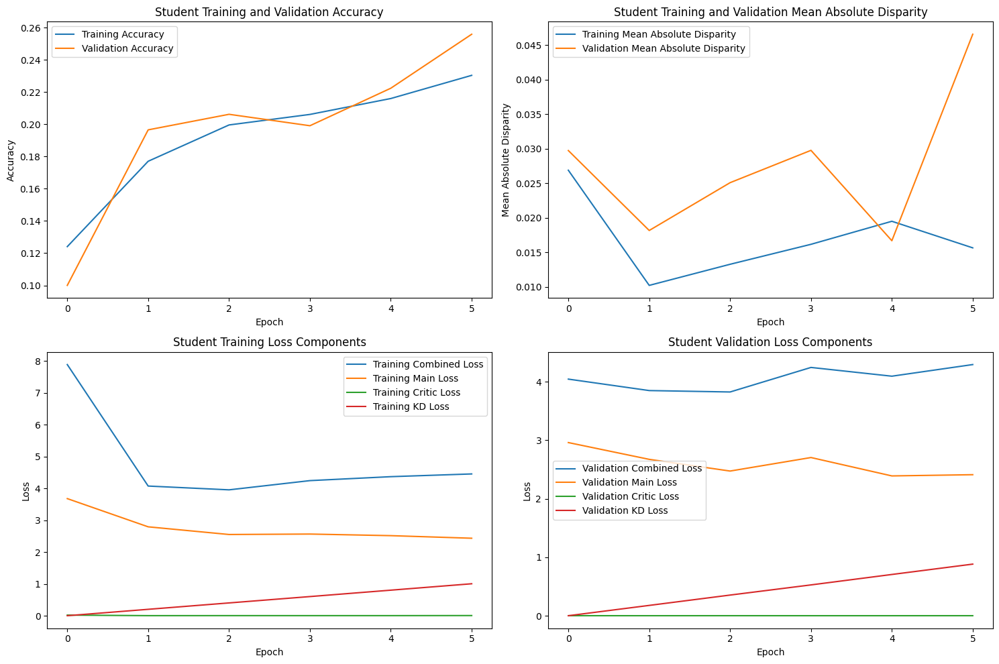

Epoch 7/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.51it/s]



STUDENT - Lambda 20 - Epoch 7 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.253588, VALIDATION Accuracy: 0.2784
TRAINING Disparity: 0.017316, VALIDATION Disparity: 0.0473
TRAINING Combined Loss: 4.634057, VALIDATION Combined Loss: 4.4273
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.014930034982508666
Class Celebration: Val Disparity = 0.0016448959845186302
Class Parade: Val Disparity = 0.050420168067226906
Class Waiter_Or_Waitress: Val Disparity = 0.023109243697479
Class Individual_Sports: Val Disparity = 0.004224058769513317
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.019867549668874173
Class Dresses: Val Disparity = -0.03333333333333333
Class Water_Activities: Val Disparity = 0.02958579881656805
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = -0.021719457

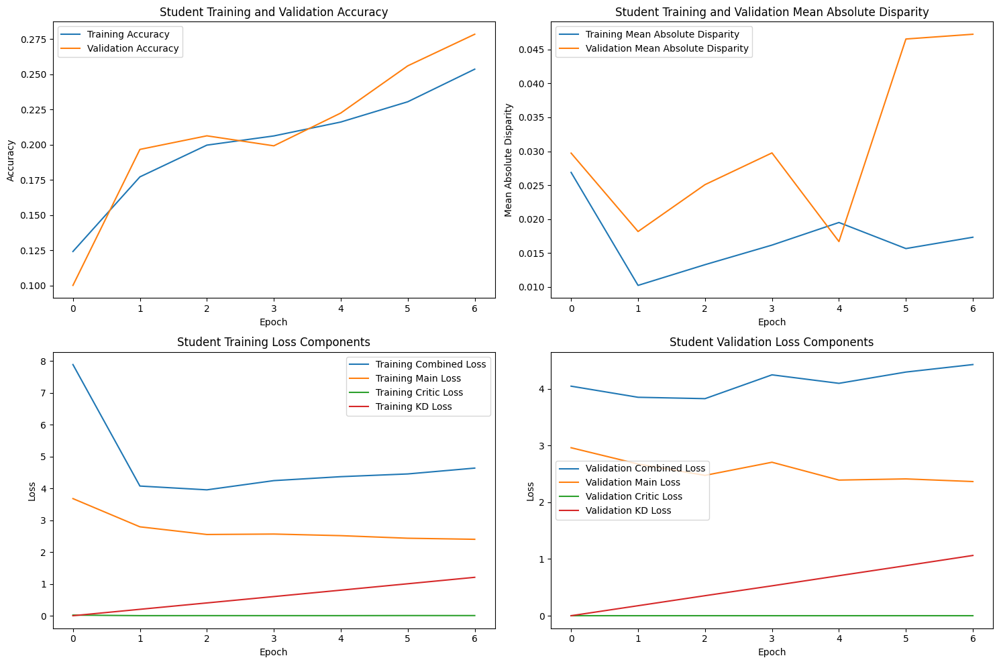

Epoch 8/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.47it/s]



STUDENT - Lambda 20 - Epoch 8 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.259028, VALIDATION Accuracy: 0.2682
TRAINING Disparity: 0.028450, VALIDATION Disparity: 0.0332
TRAINING Combined Loss: 4.985095, VALIDATION Combined Loss: 4.8803
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.014930034982508666
Class Celebration: Val Disparity = 0.0016448959845186302
Class Parade: Val Disparity = 0.050420168067226906
Class Waiter_Or_Waitress: Val Disparity = 0.023109243697479
Class Individual_Sports: Val Disparity = 0.004224058769513317
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.019867549668874173
Class Dresses: Val Disparity = -0.03333333333333333
Class Water_Activities: Val Disparity = 0.02958579881656805
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = -0.021719457

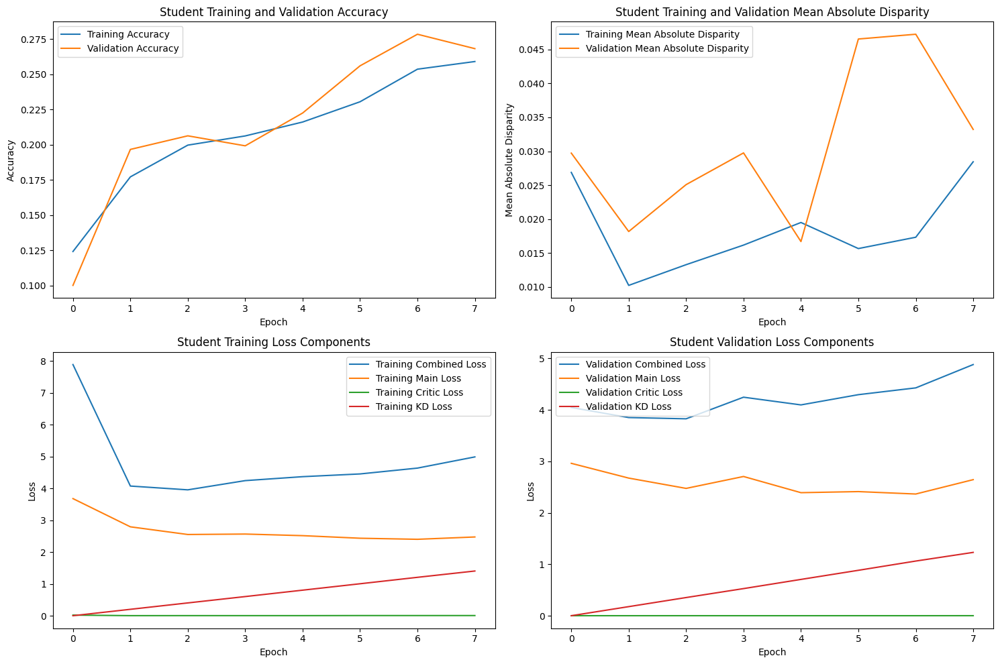

Epoch 9/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.53it/s]



STUDENT - Lambda 20 - Epoch 9 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.269850, VALIDATION Accuracy: 0.2966
TRAINING Disparity: 0.016750, VALIDATION Disparity: 0.0706
TRAINING Combined Loss: 5.110015, VALIDATION Combined Loss: 4.7308
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.014930034982508666
Class Celebration: Val Disparity = 0.0016448959845186302
Class Parade: Val Disparity = 0.050420168067226906
Class Waiter_Or_Waitress: Val Disparity = 0.023109243697479
Class Individual_Sports: Val Disparity = 0.004224058769513317
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.019867549668874173
Class Dresses: Val Disparity = -0.03333333333333333
Class Water_Activities: Val Disparity = 0.02958579881656805
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = -0.021719457

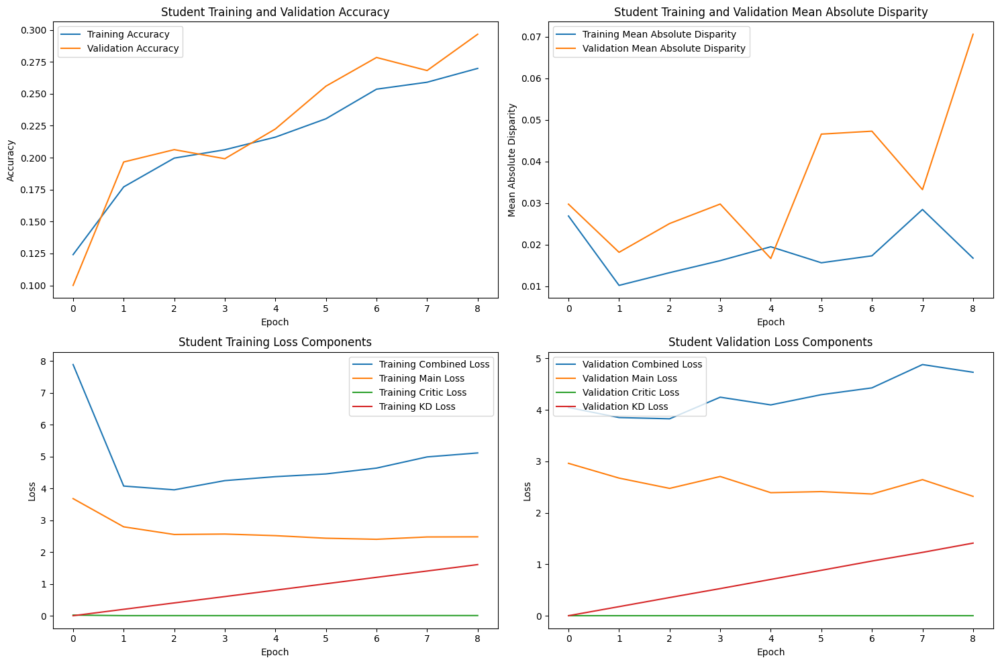

Epoch 10/10, Validation: 100%|███████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.49it/s]



STUDENT - Lambda 20 - Epoch 10 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.279842, VALIDATION Accuracy: 0.2838
TRAINING Disparity: 0.016309, VALIDATION Disparity: 0.0631
TRAINING Combined Loss: 5.351534, VALIDATION Combined Loss: 5.1925
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.014930034982508666
Class Celebration: Val Disparity = 0.0016448959845186302
Class Parade: Val Disparity = 0.050420168067226906
Class Waiter_Or_Waitress: Val Disparity = 0.023109243697479
Class Individual_Sports: Val Disparity = 0.004224058769513317
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.019867549668874173
Class Dresses: Val Disparity = -0.03333333333333333
Class Water_Activities: Val Disparity = 0.02958579881656805
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = -0.02171945

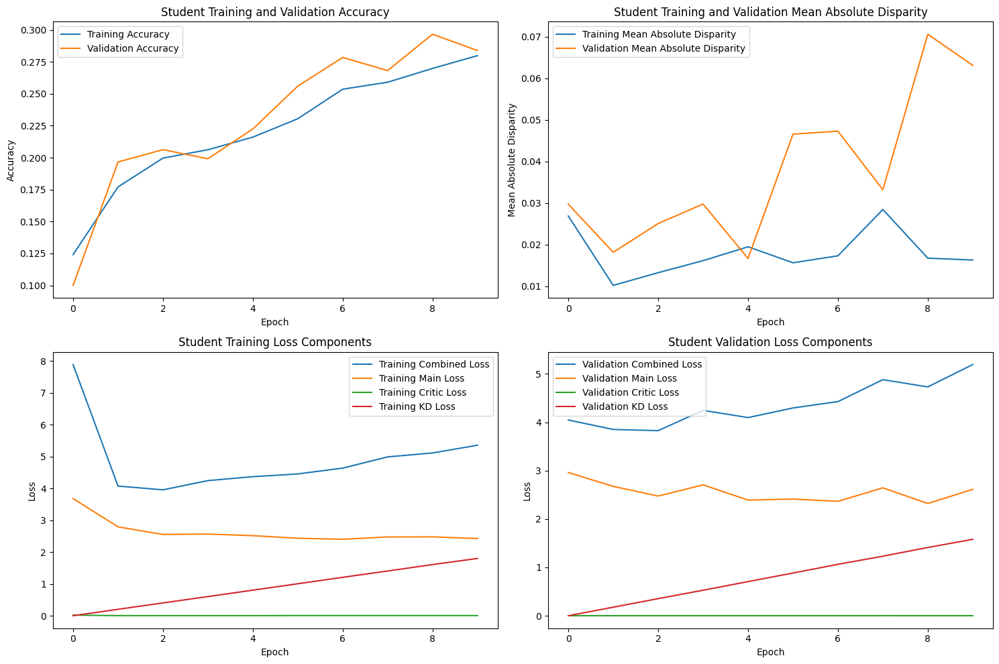

Finished Training STUDENT with lambda value of 20. Best epoch number: 3
Training Student with Lambda Value of 25


Epoch 1/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.46it/s]



STUDENT - Lambda 25 - Epoch 1 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.210725, VALIDATION Accuracy: 0.2071
TRAINING Disparity: 0.020045, VALIDATION Disparity: 0.0659
TRAINING Combined Loss: 8.555113, VALIDATION Combined Loss: 5.1571
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.010807096451774134
Class Celebration: Val Disparity = 0.041848089017900346
Class Parade: Val Disparity = 0.06629318394024272
Class Waiter_Or_Waitress: Val Disparity = 0.19117647058823534
Class Individual_Sports: Val Disparity = 0.006795224977043213
Class Surgeons: Val Disparity = 0.02040816326530612
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.06709956709956713
Class Business: Val Disparity = -0.03372863083320499
Class Dresses: Val Disparity = 0.12086956521739131
Class Water_Activities: Val Disparity = -0.17021696252465462
Class Picnic: Val Disparity = 0.03827751196172248
Class Rescue: Val Disparity = -

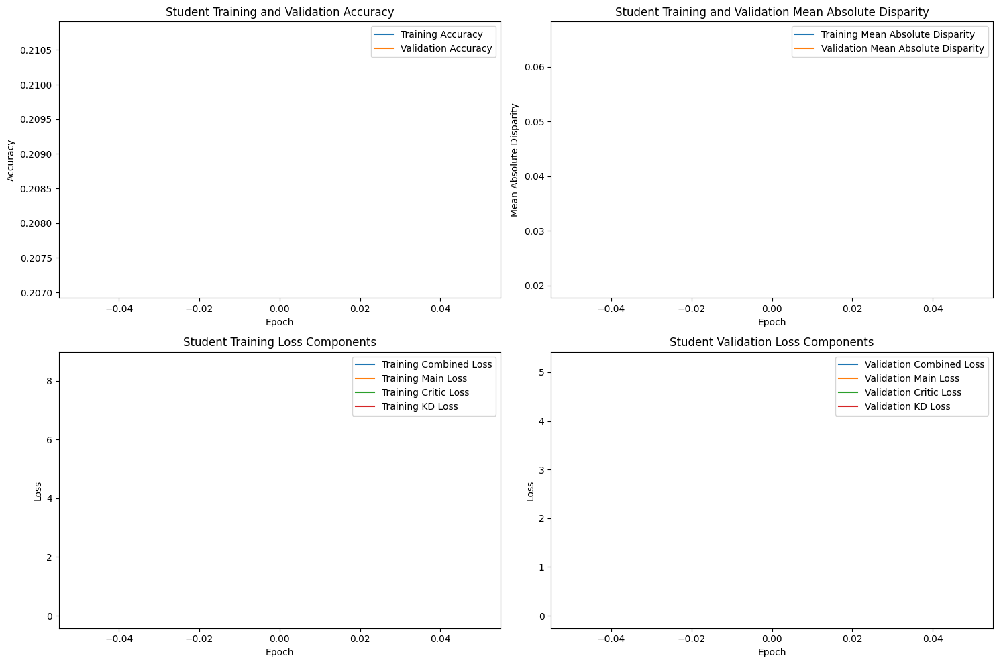

Epoch 2/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.51it/s]



STUDENT - Lambda 25 - Epoch 2 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.237963, VALIDATION Accuracy: 0.2560
TRAINING Disparity: 0.029282, VALIDATION Disparity: 0.0586
TRAINING Combined Loss: 4.363309, VALIDATION Combined Loss: 4.0009
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.07652423788105933
Class Celebration: Val Disparity = 0.049443638122883396
Class Parade: Val Disparity = -0.010270774976657349
Class Waiter_Or_Waitress: Val Disparity = 0.08298319327731091
Class Individual_Sports: Val Disparity = -0.0674931129476583
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0500541125541126
Class Business: Val Disparity = -0.016787309410133976
Class Dresses: Val Disparity = 0.03043478260869567
Class Water_Activities: Val Disparity = -0.17889546351084812
Class Picnic: Val Disparity = -0.1722488038277512
Class Rescue: Val Disparity = 0.00917431192660

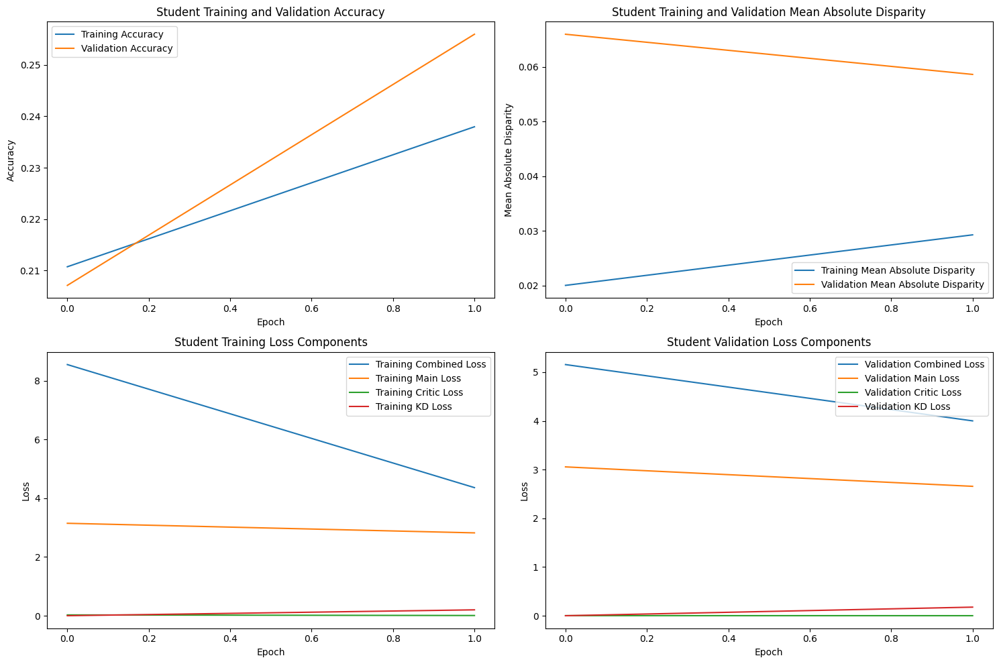

Epoch 3/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.47it/s]



STUDENT - Lambda 25 - Epoch 3 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.269657, VALIDATION Accuracy: 0.3082
TRAINING Disparity: 0.045677, VALIDATION Disparity: 0.0620
TRAINING Combined Loss: 4.077422, VALIDATION Combined Loss: 3.9565
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.09482758620689657
Class Celebration: Val Disparity = -0.09612965650701505
Class Parade: Val Disparity = -0.08870214752567696
Class Waiter_Or_Waitress: Val Disparity = 0.07668067226890757
Class Individual_Sports: Val Disparity = -0.03201714110805015
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.12012987012987009
Class Business: Val Disparity = 0.02926228245803178
Class Dresses: Val Disparity = -0.08985507246376812
Class Water_Activities: Val Disparity = 0.0808678500986193
Class Picnic: Val Disparity = 0.062200956937799035
Class Rescue: Val Disparity = 0.0183486238532110

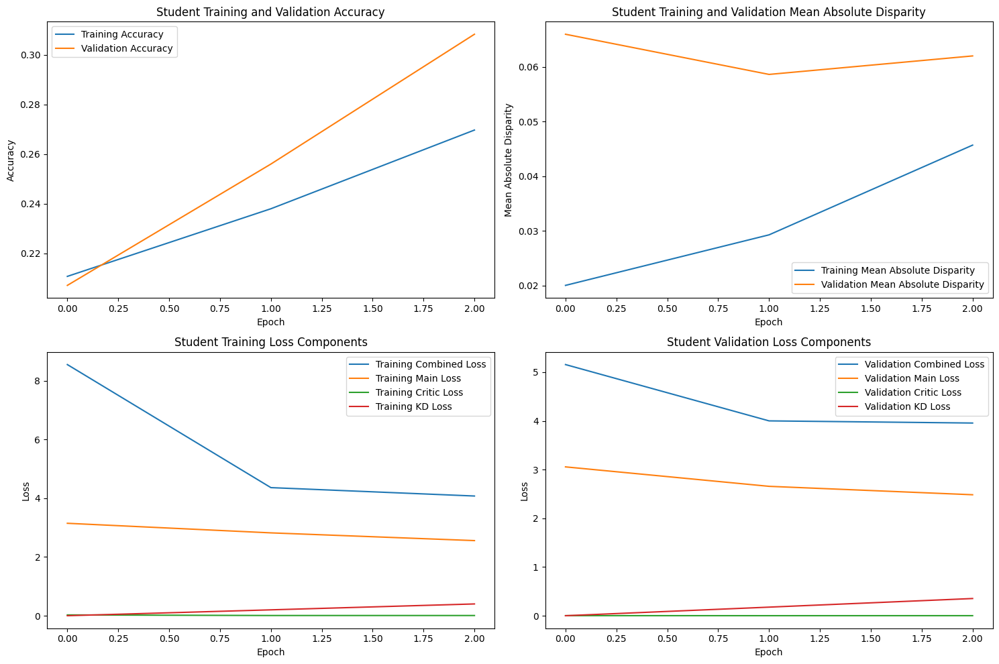

Epoch 4/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.44it/s]



STUDENT - Lambda 25 - Epoch 4 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.272762, VALIDATION Accuracy: 0.2830
TRAINING Disparity: 0.037630, VALIDATION Disparity: 0.0528
TRAINING Combined Loss: 4.793807, VALIDATION Combined Loss: 4.3949
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.09482758620689657
Class Celebration: Val Disparity = -0.09612965650701505
Class Parade: Val Disparity = -0.08870214752567696
Class Waiter_Or_Waitress: Val Disparity = 0.07668067226890757
Class Individual_Sports: Val Disparity = -0.03201714110805015
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.12012987012987009
Class Business: Val Disparity = 0.02926228245803178
Class Dresses: Val Disparity = -0.08985507246376812
Class Water_Activities: Val Disparity = 0.0808678500986193
Class Picnic: Val Disparity = 0.062200956937799035
Class Rescue: Val Disparity = 0.0183486238532110

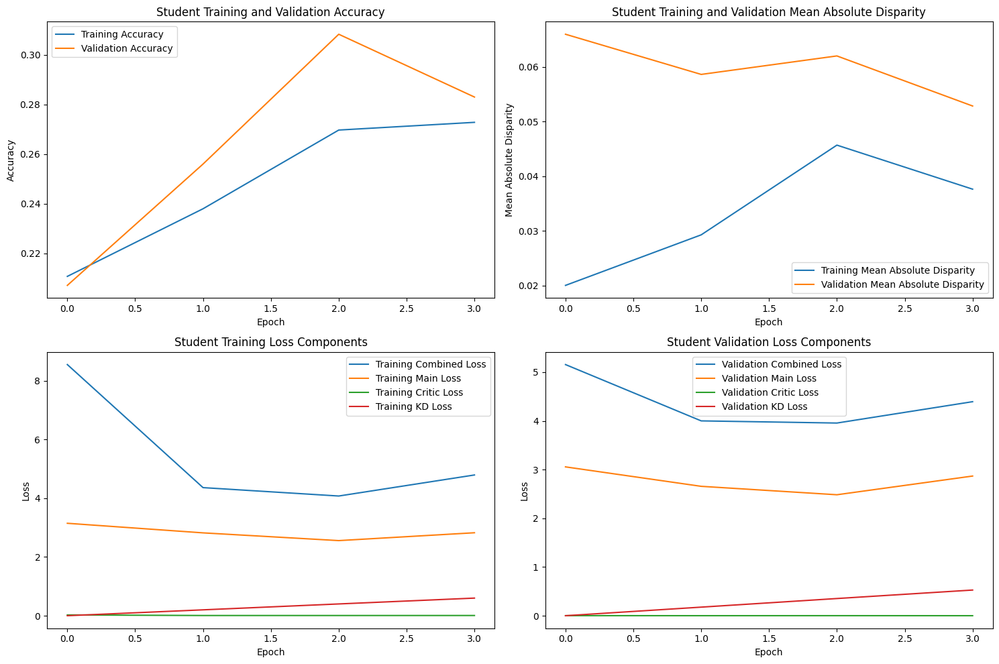

Epoch 5/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.47it/s]



STUDENT - Lambda 25 - Epoch 5 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.297338, VALIDATION Accuracy: 0.3190
TRAINING Disparity: 0.032298, VALIDATION Disparity: 0.0561
TRAINING Combined Loss: 4.711690, VALIDATION Combined Loss: 4.4776
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.09482758620689657
Class Celebration: Val Disparity = -0.09612965650701505
Class Parade: Val Disparity = -0.08870214752567696
Class Waiter_Or_Waitress: Val Disparity = 0.07668067226890757
Class Individual_Sports: Val Disparity = -0.03201714110805015
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.12012987012987009
Class Business: Val Disparity = 0.02926228245803178
Class Dresses: Val Disparity = -0.08985507246376812
Class Water_Activities: Val Disparity = 0.0808678500986193
Class Picnic: Val Disparity = 0.062200956937799035
Class Rescue: Val Disparity = 0.0183486238532110

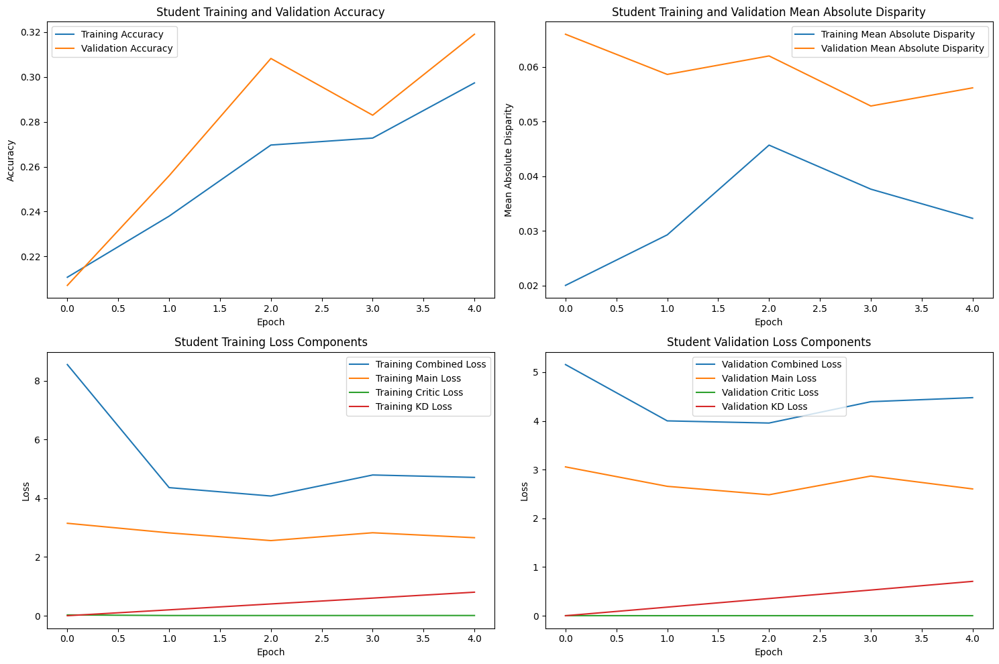

Epoch 6/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.47it/s]



STUDENT - Lambda 25 - Epoch 6 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.289718, VALIDATION Accuracy: 0.3088
TRAINING Disparity: 0.029331, VALIDATION Disparity: 0.0639
TRAINING Combined Loss: 5.125052, VALIDATION Combined Loss: 4.4646
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.09482758620689657
Class Celebration: Val Disparity = -0.09612965650701505
Class Parade: Val Disparity = -0.08870214752567696
Class Waiter_Or_Waitress: Val Disparity = 0.07668067226890757
Class Individual_Sports: Val Disparity = -0.03201714110805015
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.12012987012987009
Class Business: Val Disparity = 0.02926228245803178
Class Dresses: Val Disparity = -0.08985507246376812
Class Water_Activities: Val Disparity = 0.0808678500986193
Class Picnic: Val Disparity = 0.062200956937799035
Class Rescue: Val Disparity = 0.0183486238532110

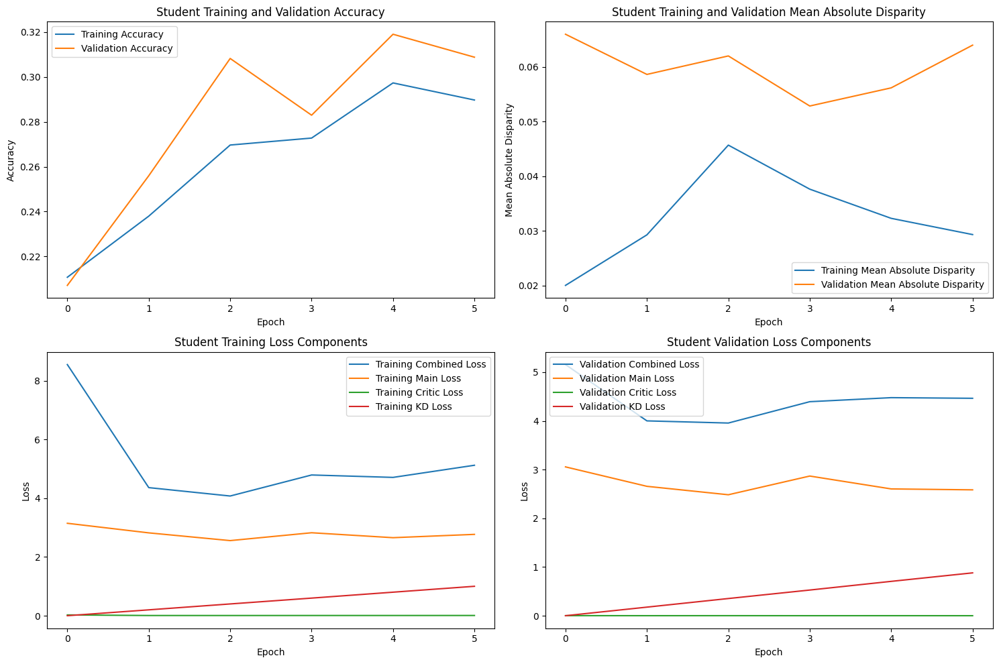

Epoch 7/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.50it/s]



STUDENT - Lambda 25 - Epoch 7 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.302431, VALIDATION Accuracy: 0.3185
TRAINING Disparity: 0.039879, VALIDATION Disparity: 0.0778
TRAINING Combined Loss: 5.003968, VALIDATION Combined Loss: 4.5863
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.09482758620689657
Class Celebration: Val Disparity = -0.09612965650701505
Class Parade: Val Disparity = -0.08870214752567696
Class Waiter_Or_Waitress: Val Disparity = 0.07668067226890757
Class Individual_Sports: Val Disparity = -0.03201714110805015
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.12012987012987009
Class Business: Val Disparity = 0.02926228245803178
Class Dresses: Val Disparity = -0.08985507246376812
Class Water_Activities: Val Disparity = 0.0808678500986193
Class Picnic: Val Disparity = 0.062200956937799035
Class Rescue: Val Disparity = 0.0183486238532110

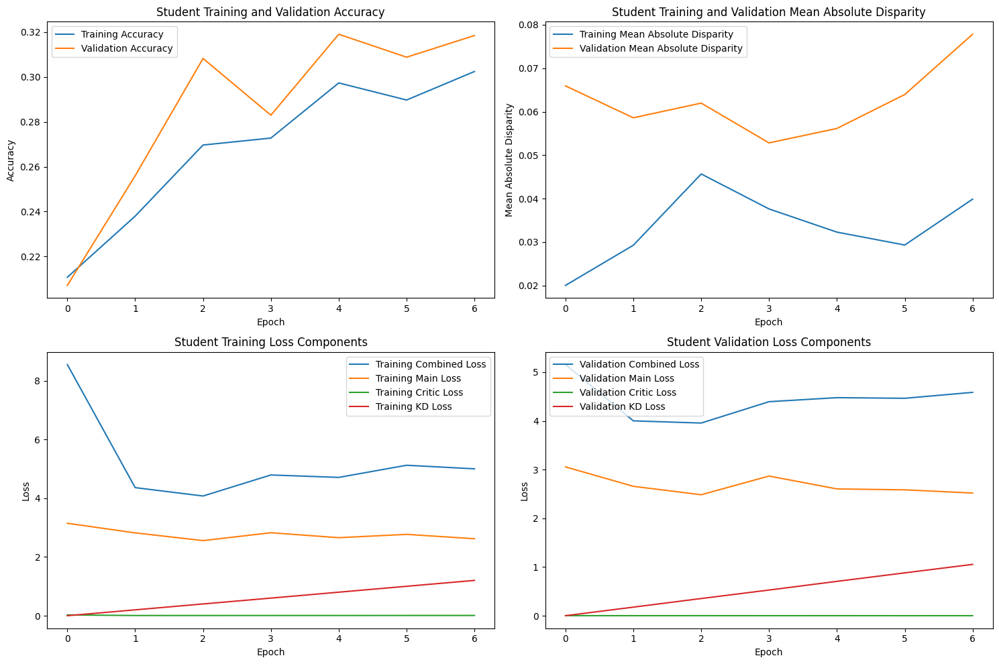

Epoch 8/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.50it/s]



STUDENT - Lambda 25 - Epoch 8 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.293113, VALIDATION Accuracy: 0.3324
TRAINING Disparity: 0.034506, VALIDATION Disparity: 0.0824
TRAINING Combined Loss: 5.492439, VALIDATION Combined Loss: 4.7034
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.09482758620689657
Class Celebration: Val Disparity = -0.09612965650701505
Class Parade: Val Disparity = -0.08870214752567696
Class Waiter_Or_Waitress: Val Disparity = 0.07668067226890757
Class Individual_Sports: Val Disparity = -0.03201714110805015
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.12012987012987009
Class Business: Val Disparity = 0.02926228245803178
Class Dresses: Val Disparity = -0.08985507246376812
Class Water_Activities: Val Disparity = 0.0808678500986193
Class Picnic: Val Disparity = 0.062200956937799035
Class Rescue: Val Disparity = 0.0183486238532110

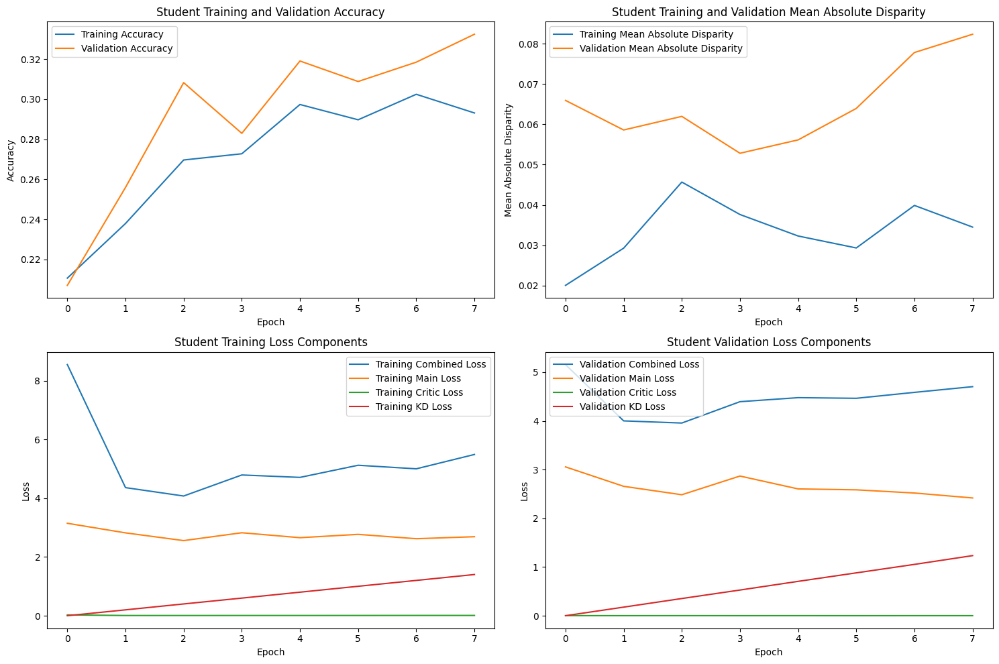

Epoch 9/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.44it/s]



STUDENT - Lambda 25 - Epoch 9 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.339024, VALIDATION Accuracy: 0.3099
TRAINING Disparity: 0.044696, VALIDATION Disparity: 0.0500
TRAINING Combined Loss: 5.018616, VALIDATION Combined Loss: 5.2832
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.09482758620689657
Class Celebration: Val Disparity = -0.09612965650701505
Class Parade: Val Disparity = -0.08870214752567696
Class Waiter_Or_Waitress: Val Disparity = 0.07668067226890757
Class Individual_Sports: Val Disparity = -0.03201714110805015
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.12012987012987009
Class Business: Val Disparity = 0.02926228245803178
Class Dresses: Val Disparity = -0.08985507246376812
Class Water_Activities: Val Disparity = 0.0808678500986193
Class Picnic: Val Disparity = 0.062200956937799035
Class Rescue: Val Disparity = 0.0183486238532110

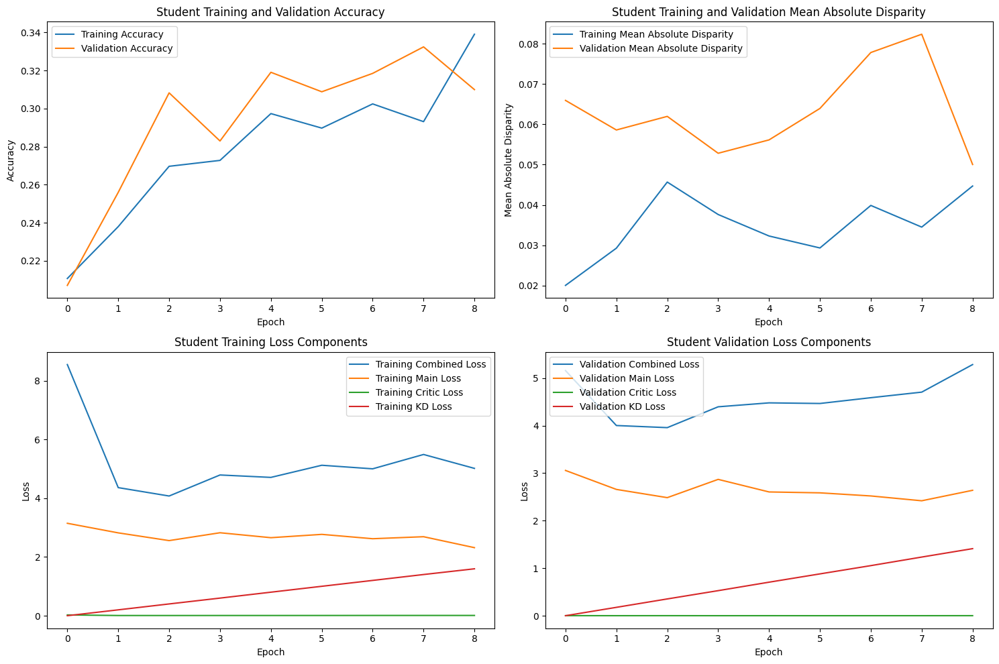

Epoch 10/10, Validation: 100%|███████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.49it/s]



STUDENT - Lambda 25 - Epoch 10 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.301215, VALIDATION Accuracy: 0.3492
TRAINING Disparity: 0.031901, VALIDATION Disparity: 0.0633
TRAINING Combined Loss: 6.074548, VALIDATION Combined Loss: 4.9514
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.09482758620689657
Class Celebration: Val Disparity = -0.09612965650701505
Class Parade: Val Disparity = -0.08870214752567696
Class Waiter_Or_Waitress: Val Disparity = 0.07668067226890757
Class Individual_Sports: Val Disparity = -0.03201714110805015
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.12012987012987009
Class Business: Val Disparity = 0.02926228245803178
Class Dresses: Val Disparity = -0.08985507246376812
Class Water_Activities: Val Disparity = 0.0808678500986193
Class Picnic: Val Disparity = 0.062200956937799035
Class Rescue: Val Disparity = 0.018348623853211

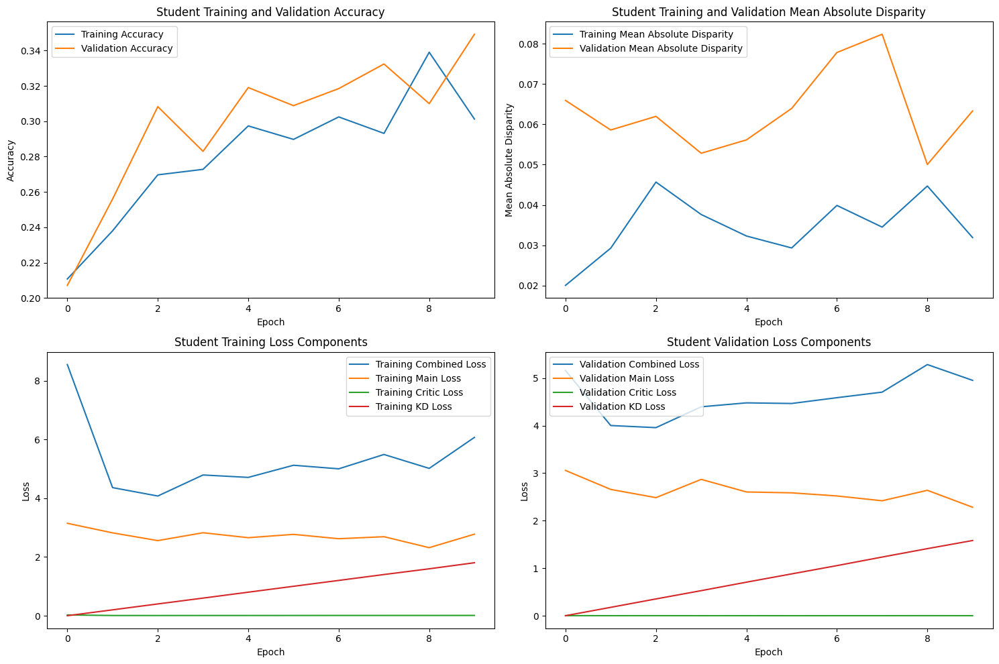

Finished Training STUDENT with lambda value of 25. Best epoch number: 3
Training Student with Lambda Value of 30


Epoch 1/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.45it/s]



STUDENT - Lambda 30 - Epoch 1 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.150714, VALIDATION Accuracy: 0.0889
TRAINING Disparity: 0.026617, VALIDATION Disparity: 0.0262
TRAINING Combined Loss: 10.728665, VALIDATION Combined Loss: 5.1199
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.012118940529735153
Class Celebration: Val Disparity = -0.006144170295113702
Class Parade: Val Disparity = -0.0018674136321195113
Class Waiter_Or_Waitress: Val Disparity = -0.01785714285714286
Class Individual_Sports: Val Disparity = 0.014753596571778382
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = -0.023809523809523808
Class Law_Enforcement: Val Disparity = 0.006493506493506494
Class Business: Val Disparity = 0.009856768827968584
Class Dresses: Val Disparity = 0.0034782608695652084
Class Water_Activities: Val Disparity = -0.058382642998027534
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.018

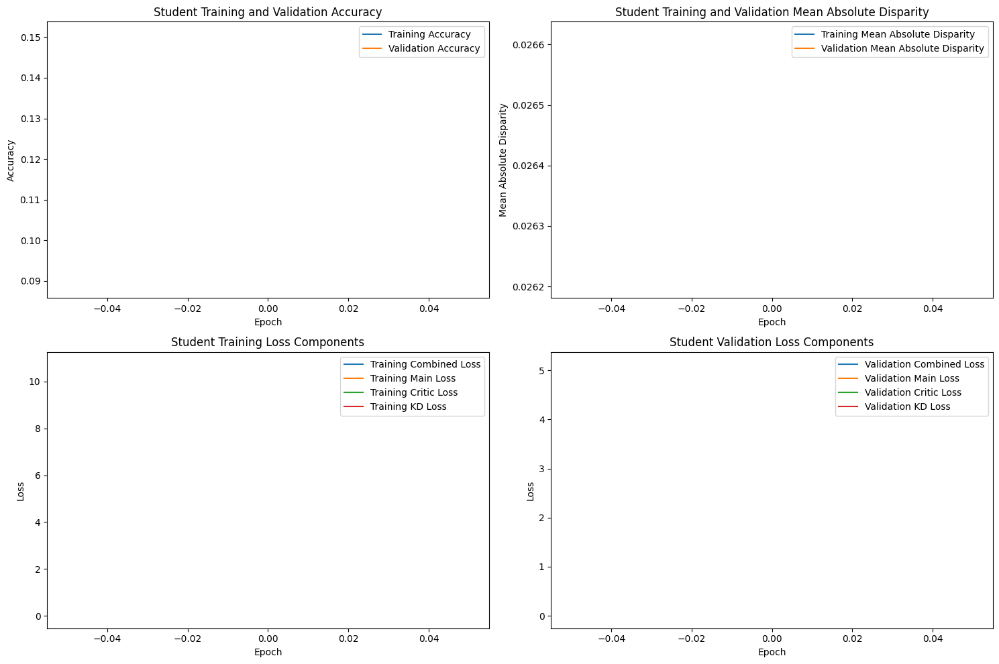

Epoch 2/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.48it/s]



STUDENT - Lambda 30 - Epoch 2 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.158738, VALIDATION Accuracy: 0.1750
TRAINING Disparity: 0.019398, VALIDATION Disparity: 0.0466
TRAINING Combined Loss: 4.193873, VALIDATION Combined Loss: 4.2215
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.025362318840579712
Class Celebration: Val Disparity = -0.0043057571359458174
Class Parade: Val Disparity = 0.04014939309056958
Class Waiter_Or_Waitress: Val Disparity = -0.0031512605042016834
Class Individual_Sports: Val Disparity = 0.010866238138965478
Class Surgeons: Val Disparity = 0.02040816326530612
Class Spa: Val Disparity = 0.10119047619047619
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = -0.05328815647620515
Class Dresses: Val Disparity = -0.18666666666666665
Class Water_Activities: Val Disparity = -0.037475345167652885
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class 

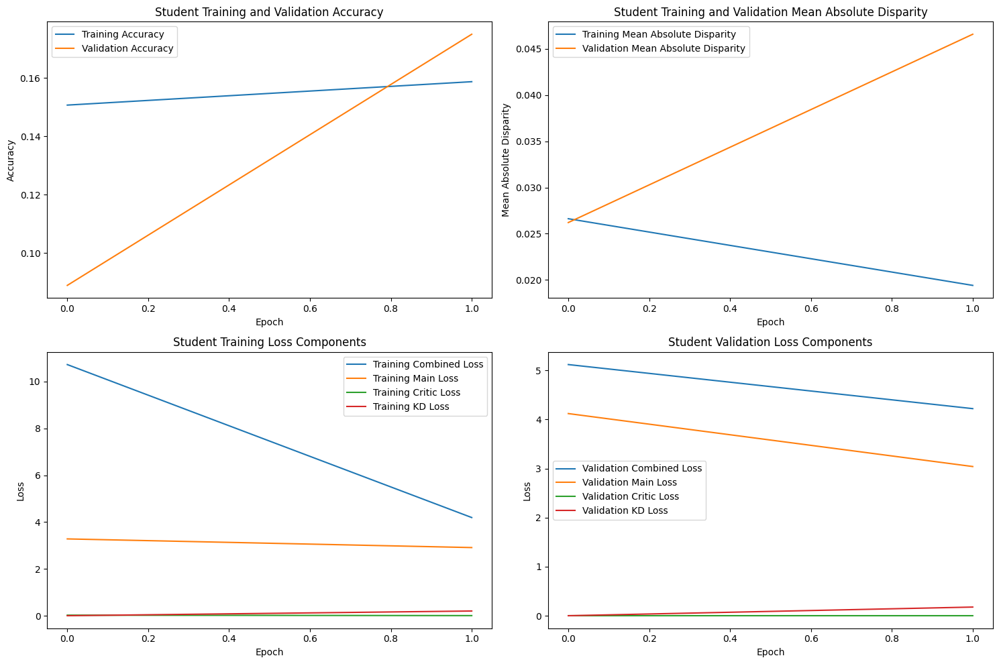

Epoch 3/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.46it/s]



STUDENT - Lambda 30 - Epoch 3 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.192323, VALIDATION Accuracy: 0.2321
TRAINING Disparity: 0.015866, VALIDATION Disparity: 0.0314
TRAINING Combined Loss: 4.275217, VALIDATION Combined Loss: 4.1537
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.0407296351824088
Class Celebration: Val Disparity = 0.01006289308176099
Class Parade: Val Disparity = 0.040149393090569585
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = -0.03281297826752372
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.007575757575757583
Class Business: Val Disparity = -0.01663329739719698
Class Dresses: Val Disparity = -0.02
Class Water_Activities: Val Disparity = -0.13412228796844183
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.055045871559633024
Class Cheering: Val Disparity = 0.00769230

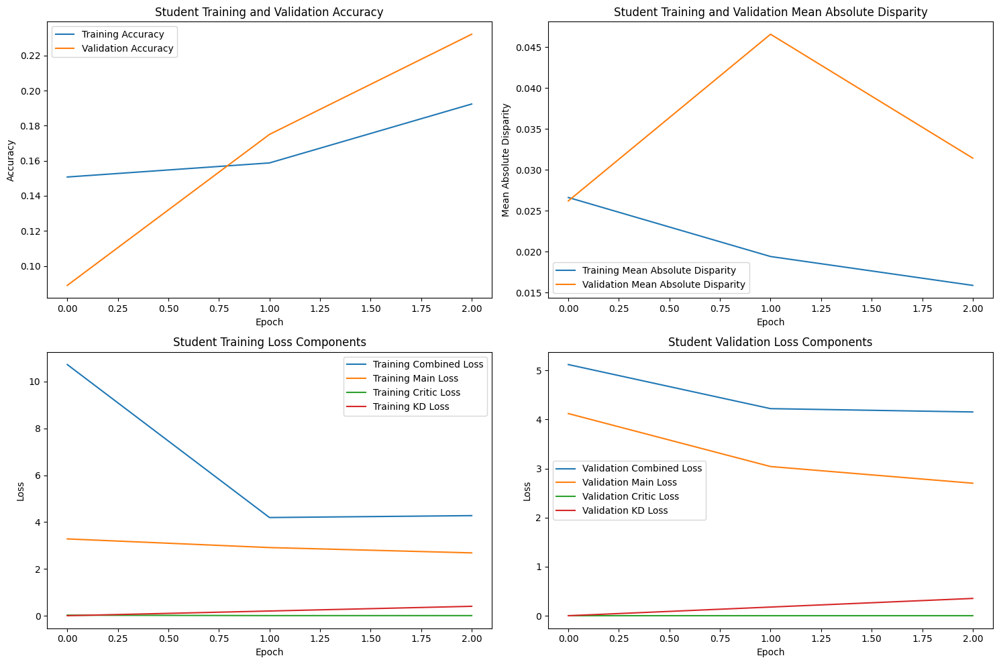

Epoch 4/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.44it/s]



STUDENT - Lambda 30 - Epoch 4 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.241956, VALIDATION Accuracy: 0.2429
TRAINING Disparity: 0.015955, VALIDATION Disparity: 0.0397
TRAINING Combined Loss: 4.189217, VALIDATION Combined Loss: 4.1918
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.0407296351824088
Class Celebration: Val Disparity = 0.01006289308176099
Class Parade: Val Disparity = 0.040149393090569585
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = -0.03281297826752372
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.007575757575757583
Class Business: Val Disparity = -0.01663329739719698
Class Dresses: Val Disparity = -0.02
Class Water_Activities: Val Disparity = -0.13412228796844183
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.055045871559633024
Class Cheering: Val Disparity = 0.00769230

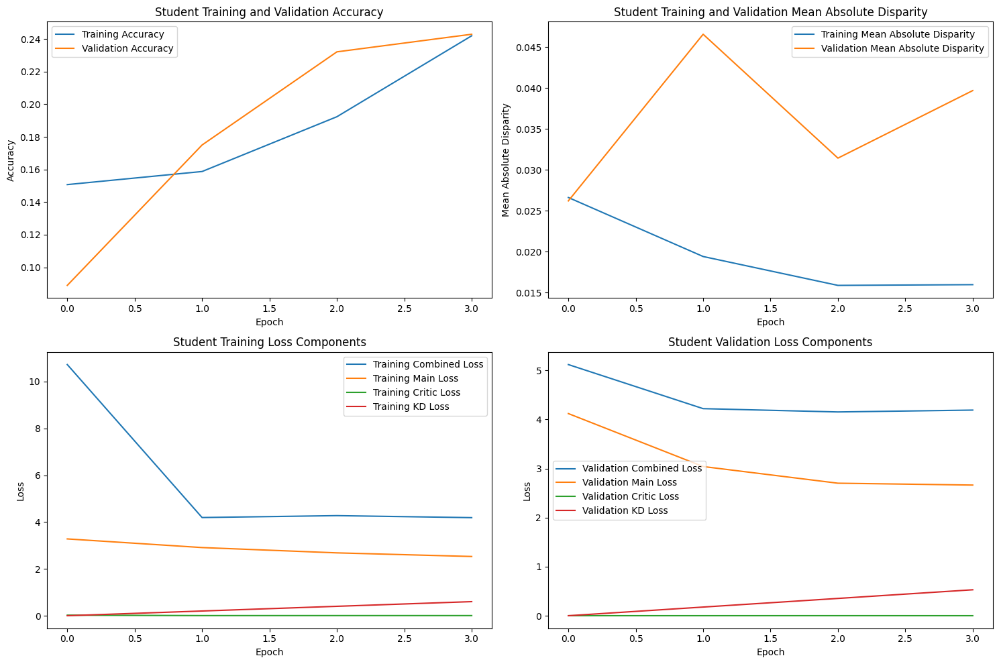

Epoch 5/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.50it/s]



STUDENT - Lambda 30 - Epoch 5 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.255652, VALIDATION Accuracy: 0.2864
TRAINING Disparity: 0.022814, VALIDATION Disparity: 0.0461
TRAINING Combined Loss: 4.249608, VALIDATION Combined Loss: 4.0254
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.05234882558720633
Class Celebration: Val Disparity = -0.03338171262699563
Class Parade: Val Disparity = 0.02427637721755377
Class Waiter_Or_Waitress: Val Disparity = 0.06617647058823531
Class Individual_Sports: Val Disparity = -0.024058769513314926
Class Surgeons: Val Disparity = 0.021224489795918365
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.16829004329004332
Class Business: Val Disparity = -0.016633297397196982
Class Dresses: Val Disparity = -0.019999999999999997
Class Water_Activities: Val Disparity = -0.10197238658777125
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Che

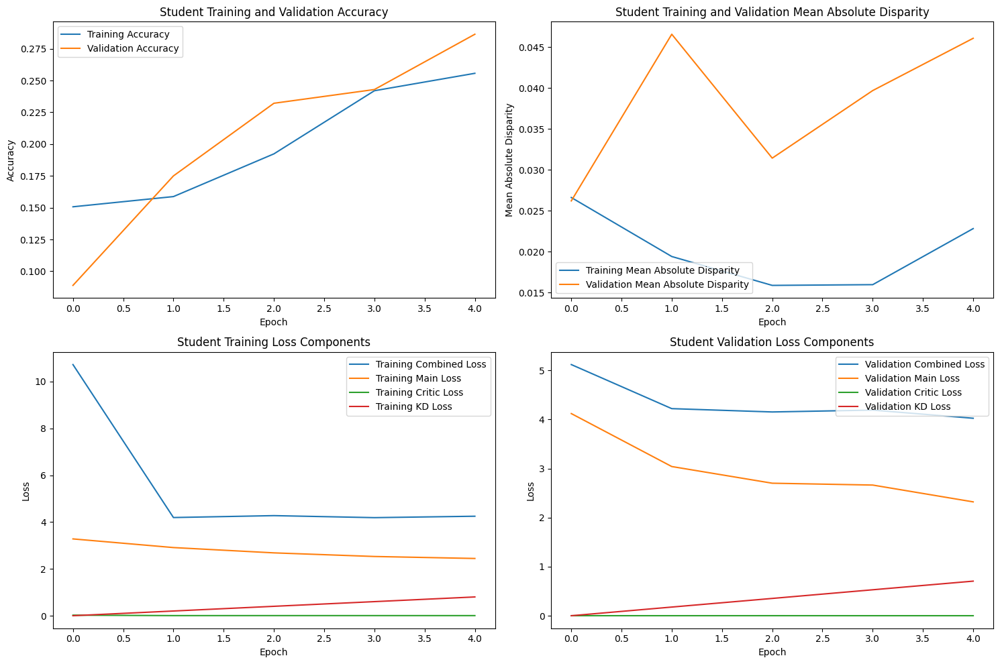

Epoch 6/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.46it/s]



STUDENT - Lambda 30 - Epoch 6 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.267110, VALIDATION Accuracy: 0.2983
TRAINING Disparity: 0.024121, VALIDATION Disparity: 0.0330
TRAINING Combined Loss: 4.610794, VALIDATION Combined Loss: 4.5769
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.05234882558720633
Class Celebration: Val Disparity = -0.03338171262699563
Class Parade: Val Disparity = 0.02427637721755377
Class Waiter_Or_Waitress: Val Disparity = 0.06617647058823531
Class Individual_Sports: Val Disparity = -0.024058769513314926
Class Surgeons: Val Disparity = 0.021224489795918365
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.16829004329004332
Class Business: Val Disparity = -0.016633297397196982
Class Dresses: Val Disparity = -0.019999999999999997
Class Water_Activities: Val Disparity = -0.10197238658777125
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Che

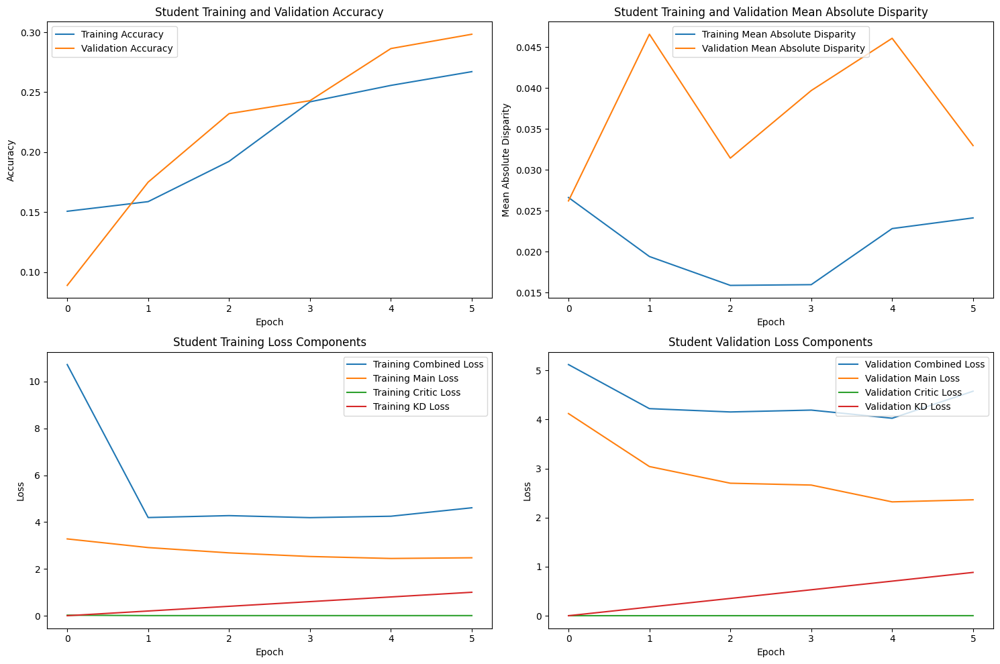

Epoch 7/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.44it/s]



STUDENT - Lambda 30 - Epoch 7 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.290085, VALIDATION Accuracy: 0.3506
TRAINING Disparity: 0.030645, VALIDATION Disparity: 0.0658
TRAINING Combined Loss: 4.931543, VALIDATION Combined Loss: 4.3638
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.05234882558720633
Class Celebration: Val Disparity = -0.03338171262699563
Class Parade: Val Disparity = 0.02427637721755377
Class Waiter_Or_Waitress: Val Disparity = 0.06617647058823531
Class Individual_Sports: Val Disparity = -0.024058769513314926
Class Surgeons: Val Disparity = 0.021224489795918365
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.16829004329004332
Class Business: Val Disparity = -0.016633297397196982
Class Dresses: Val Disparity = -0.019999999999999997
Class Water_Activities: Val Disparity = -0.10197238658777125
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Che

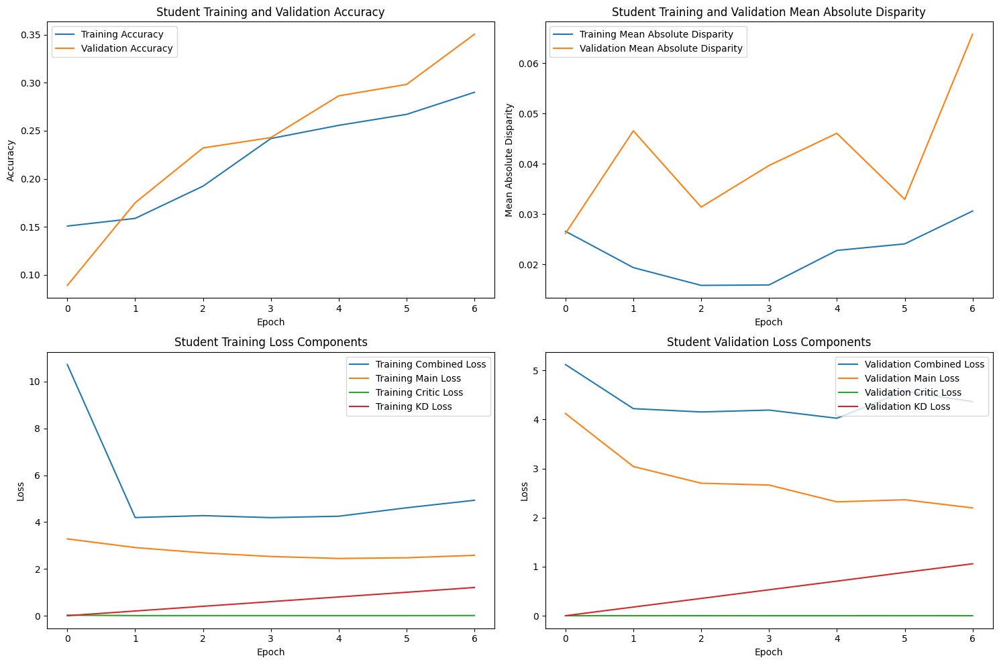

Epoch 8/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.47it/s]



STUDENT - Lambda 30 - Epoch 8 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.301968, VALIDATION Accuracy: 0.3236
TRAINING Disparity: 0.034307, VALIDATION Disparity: 0.0699
TRAINING Combined Loss: 4.924765, VALIDATION Combined Loss: 4.5844
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.05234882558720633
Class Celebration: Val Disparity = -0.03338171262699563
Class Parade: Val Disparity = 0.02427637721755377
Class Waiter_Or_Waitress: Val Disparity = 0.06617647058823531
Class Individual_Sports: Val Disparity = -0.024058769513314926
Class Surgeons: Val Disparity = 0.021224489795918365
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.16829004329004332
Class Business: Val Disparity = -0.016633297397196982
Class Dresses: Val Disparity = -0.019999999999999997
Class Water_Activities: Val Disparity = -0.10197238658777125
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Che

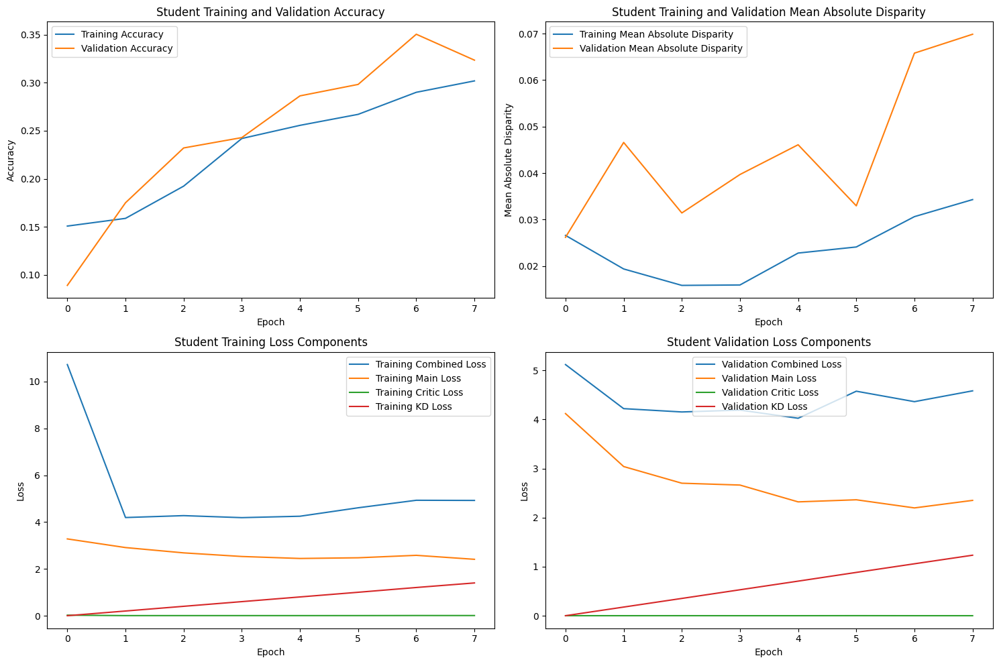

Epoch 9/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.45it/s]



STUDENT - Lambda 30 - Epoch 9 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.327643, VALIDATION Accuracy: 0.2935
TRAINING Disparity: 0.029498, VALIDATION Disparity: 0.0604
TRAINING Combined Loss: 5.009124, VALIDATION Combined Loss: 6.4165
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.05234882558720633
Class Celebration: Val Disparity = -0.03338171262699563
Class Parade: Val Disparity = 0.02427637721755377
Class Waiter_Or_Waitress: Val Disparity = 0.06617647058823531
Class Individual_Sports: Val Disparity = -0.024058769513314926
Class Surgeons: Val Disparity = 0.021224489795918365
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.16829004329004332
Class Business: Val Disparity = -0.016633297397196982
Class Dresses: Val Disparity = -0.019999999999999997
Class Water_Activities: Val Disparity = -0.10197238658777125
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Che

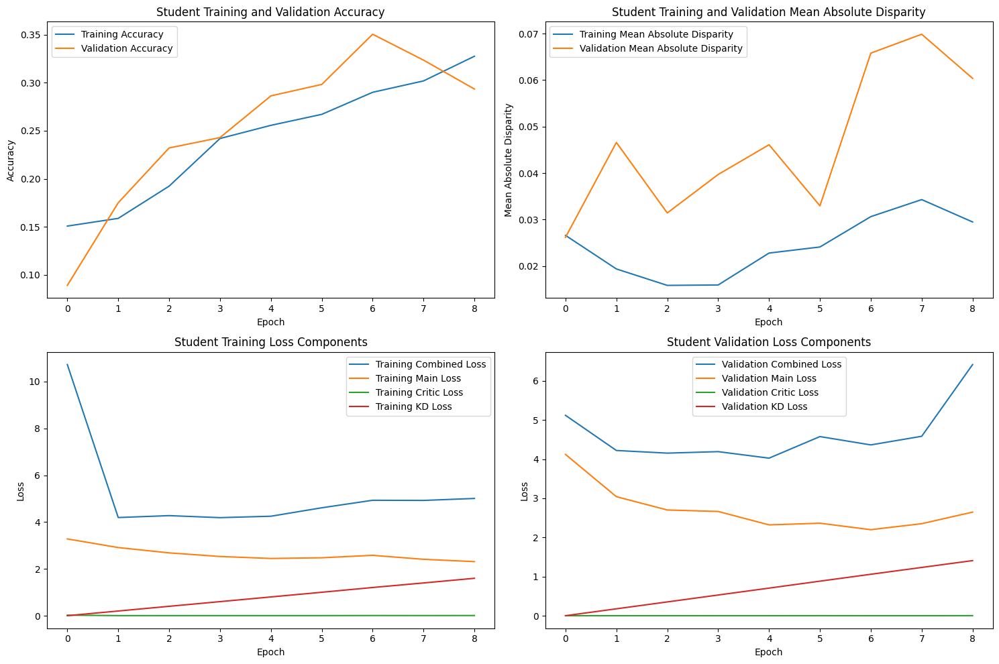

Epoch 10/10, Validation: 100%|███████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.45it/s]



STUDENT - Lambda 30 - Epoch 10 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.299074, VALIDATION Accuracy: 0.3432
TRAINING Disparity: 0.035117, VALIDATION Disparity: 0.0793
TRAINING Combined Loss: 5.511416, VALIDATION Combined Loss: 4.7346
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.05234882558720633
Class Celebration: Val Disparity = -0.03338171262699563
Class Parade: Val Disparity = 0.02427637721755377
Class Waiter_Or_Waitress: Val Disparity = 0.06617647058823531
Class Individual_Sports: Val Disparity = -0.024058769513314926
Class Surgeons: Val Disparity = 0.021224489795918365
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.16829004329004332
Class Business: Val Disparity = -0.016633297397196982
Class Dresses: Val Disparity = -0.019999999999999997
Class Water_Activities: Val Disparity = -0.10197238658777125
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Ch

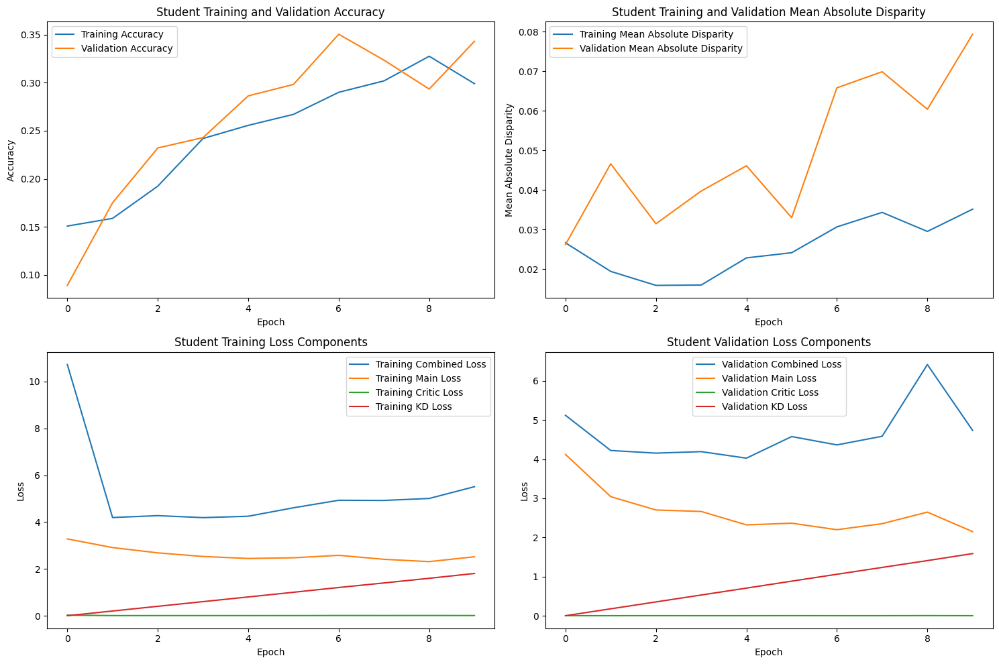

Finished Training STUDENT with lambda value of 30. Best epoch number: 5
Training Student with Lambda Value of 40


Epoch 1/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.43it/s]



STUDENT - Lambda 40 - Epoch 1 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.151736, VALIDATION Accuracy: 0.0736
TRAINING Disparity: 0.021918, VALIDATION Disparity: 0.0209
TRAINING Combined Loss: 13.857988, VALIDATION Combined Loss: 7.1768
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.0364817591204398
Class Celebration: Val Disparity = -0.008176100628930816
Class Parade: Val Disparity = 0.0
Class Waiter_Or_Waitress: Val Disparity = 0.02100840336134452
Class Individual_Sports: Val Disparity = 0.0025099479644934697
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.059523809523809534
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.033112582781456956
Class Dresses: Val Disparity = -0.006666666666666665
Class Water_Activities: Val Disparity = 0.0
Class Picnic: Val Disparity = 0.01913875598086124
Class Rescue: Val Disparity = 0.027522935779816515
Class Cheering: Val Dispa

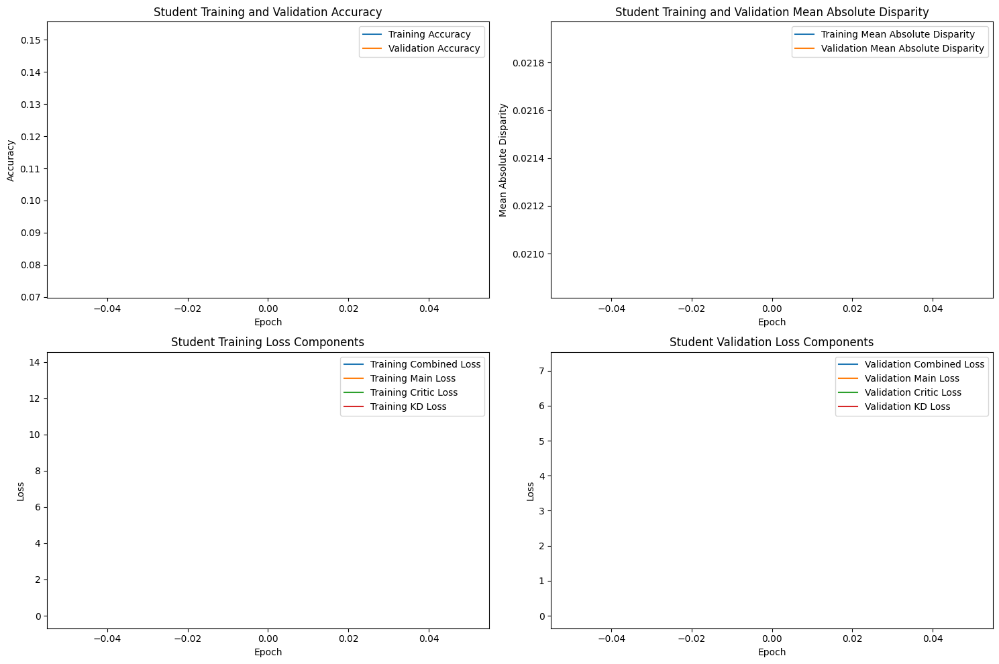

Epoch 2/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.46it/s]



STUDENT - Lambda 40 - Epoch 2 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.080652, VALIDATION Accuracy: 0.0972
TRAINING Disparity: 0.026769, VALIDATION Disparity: 0.0457
TRAINING Combined Loss: 5.662860, VALIDATION Combined Loss: 4.9579
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.041229385307346295
Class Celebration: Val Disparity = -0.02951136913401063
Class Parade: Val Disparity = 0.0
Class Waiter_Or_Waitress: Val Disparity = 0.023109243697478965
Class Individual_Sports: Val Disparity = -0.039210284664830106
Class Surgeons: Val Disparity = -0.08
Class Spa: Val Disparity = 0.125
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.01324503311258278
Class Dresses: Val Disparity = 0.0034782608695652154
Class Water_Activities: Val Disparity = -0.05798816568047338
Class Picnic: Val Disparity = 0.062200956937799035
Class Rescue: Val Disparity = -0.0857798165137615
Class Cheering: Val 

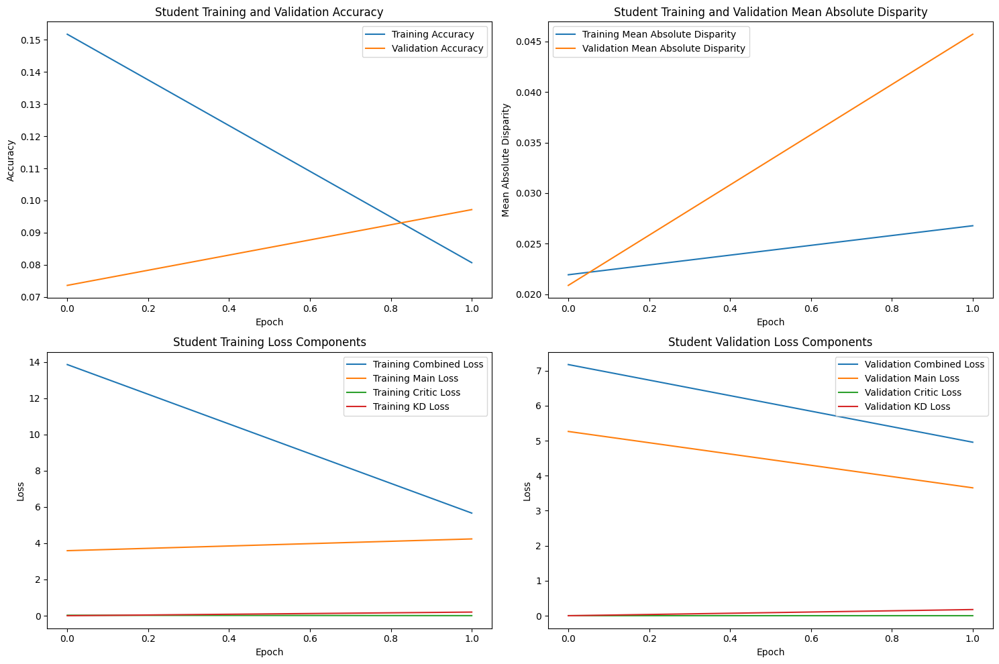

Epoch 3/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.47it/s]



STUDENT - Lambda 40 - Epoch 3 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.091763, VALIDATION Accuracy: 0.1241
TRAINING Disparity: 0.019318, VALIDATION Disparity: 0.0374
TRAINING Combined Loss: 5.201723, VALIDATION Combined Loss: 4.4727
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.020114942528735635
Class Celebration: Val Disparity = 0.029366231253023706
Class Parade: Val Disparity = 0.006535947712418299
Class Waiter_Or_Waitress: Val Disparity = -0.00840336134453784
Class Individual_Sports: Val Disparity = -0.003887358432812932
Class Surgeons: Val Disparity = -0.04
Class Spa: Val Disparity = 0.17857142857142858
Class Law_Enforcement: Val Disparity = -0.014339826839826838
Class Business: Val Disparity = 0.009856768827968584
Class Dresses: Val Disparity = -0.03333333333333333
Class Water_Activities: Val Disparity = -0.12406311637080869
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Clas

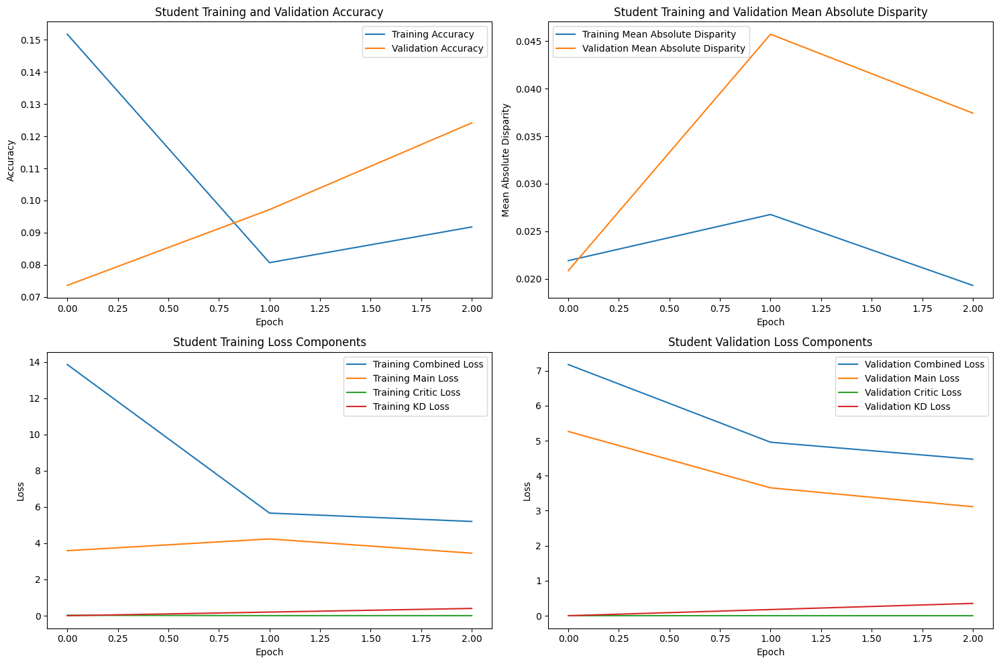

Epoch 4/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.46it/s]



STUDENT - Lambda 40 - Epoch 4 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.123630, VALIDATION Accuracy: 0.1293
TRAINING Disparity: 0.016526, VALIDATION Disparity: 0.0275
TRAINING Combined Loss: 4.956933, VALIDATION Combined Loss: 4.9129
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.020114942528735635
Class Celebration: Val Disparity = 0.029366231253023706
Class Parade: Val Disparity = 0.006535947712418299
Class Waiter_Or_Waitress: Val Disparity = -0.00840336134453784
Class Individual_Sports: Val Disparity = -0.003887358432812932
Class Surgeons: Val Disparity = -0.04
Class Spa: Val Disparity = 0.17857142857142858
Class Law_Enforcement: Val Disparity = -0.014339826839826838
Class Business: Val Disparity = 0.009856768827968584
Class Dresses: Val Disparity = -0.03333333333333333
Class Water_Activities: Val Disparity = -0.12406311637080869
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Clas

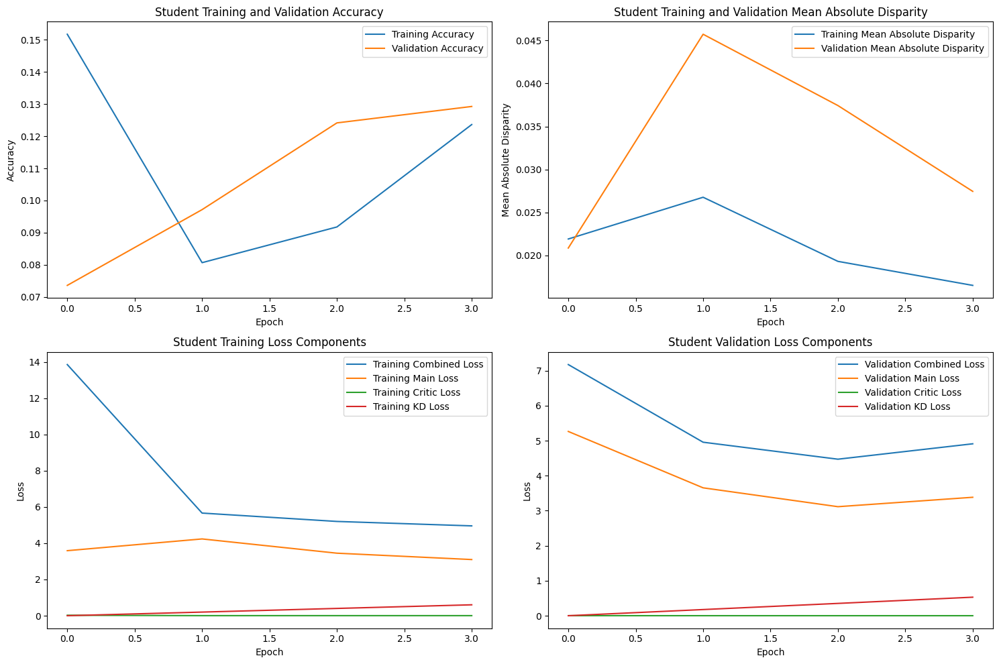

Epoch 5/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:23<00:00,  2.39it/s]



STUDENT - Lambda 40 - Epoch 5 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.159664, VALIDATION Accuracy: 0.2139
TRAINING Disparity: 0.014163, VALIDATION Disparity: 0.0398
TRAINING Combined Loss: 4.785640, VALIDATION Combined Loss: 4.3391
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.06140679660169901
Class Celebration: Val Disparity = 0.030575713594581527
Class Parade: Val Disparity = 0.05322128851540614
Class Waiter_Or_Waitress: Val Disparity = 0.029411764705882353
Class Individual_Sports: Val Disparity = -0.047229874502601826
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = -0.020833333333333332
Class Business: Val Disparity = -0.020021561681811174
Class Dresses: Val Disparity = -0.006666666666666667
Class Water_Activities: Val Disparity = -0.07633136094674553
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.009174311926605503
Class 

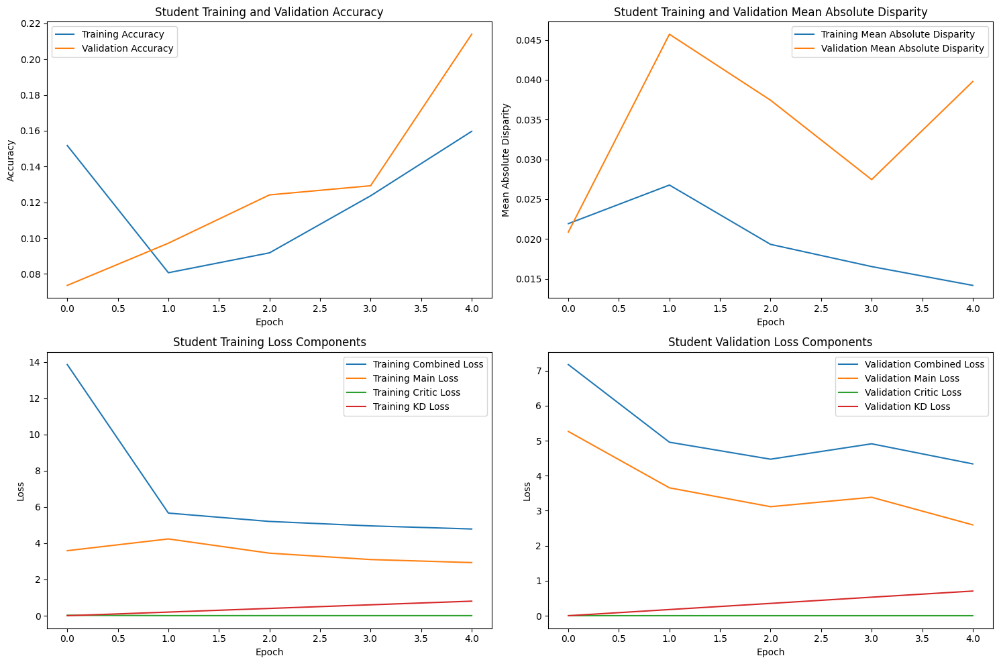

Epoch 6/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.48it/s]



STUDENT - Lambda 40 - Epoch 6 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.177990, VALIDATION Accuracy: 0.1974
TRAINING Disparity: 0.012022, VALIDATION Disparity: 0.0393
TRAINING Combined Loss: 4.983583, VALIDATION Combined Loss: 4.7063
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.06140679660169901
Class Celebration: Val Disparity = 0.030575713594581527
Class Parade: Val Disparity = 0.05322128851540614
Class Waiter_Or_Waitress: Val Disparity = 0.029411764705882353
Class Individual_Sports: Val Disparity = -0.047229874502601826
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = -0.020833333333333332
Class Business: Val Disparity = -0.020021561681811174
Class Dresses: Val Disparity = -0.006666666666666667
Class Water_Activities: Val Disparity = -0.07633136094674553
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.009174311926605503
Class 

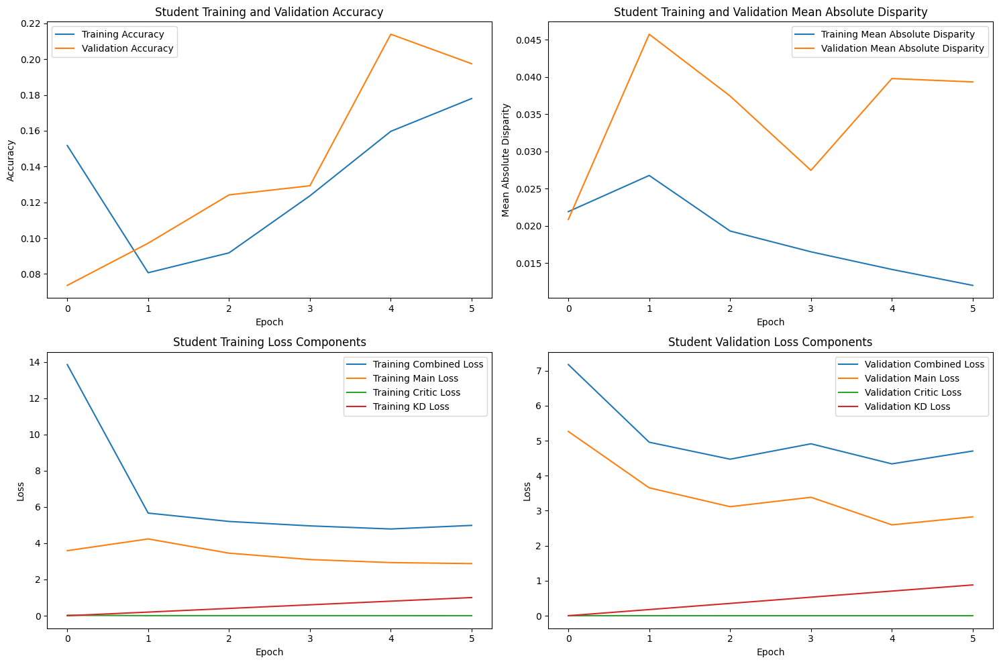

Epoch 7/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.46it/s]



STUDENT - Lambda 40 - Epoch 7 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.201698, VALIDATION Accuracy: 0.2134
TRAINING Disparity: 0.023517, VALIDATION Disparity: 0.0242
TRAINING Combined Loss: 4.905433, VALIDATION Combined Loss: 4.6006
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.06140679660169901
Class Celebration: Val Disparity = 0.030575713594581527
Class Parade: Val Disparity = 0.05322128851540614
Class Waiter_Or_Waitress: Val Disparity = 0.029411764705882353
Class Individual_Sports: Val Disparity = -0.047229874502601826
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = -0.020833333333333332
Class Business: Val Disparity = -0.020021561681811174
Class Dresses: Val Disparity = -0.006666666666666667
Class Water_Activities: Val Disparity = -0.07633136094674553
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.009174311926605503
Class 

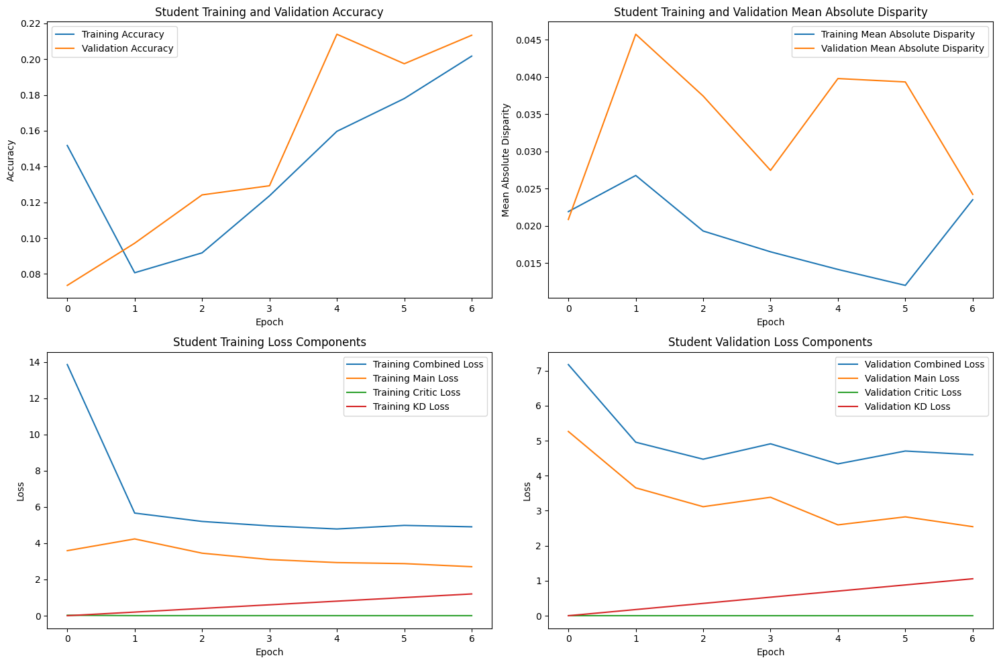

Epoch 8/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.43it/s]



STUDENT - Lambda 40 - Epoch 8 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.204591, VALIDATION Accuracy: 0.2162
TRAINING Disparity: 0.017464, VALIDATION Disparity: 0.0274
TRAINING Combined Loss: 4.955814, VALIDATION Combined Loss: 4.7169
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.06140679660169901
Class Celebration: Val Disparity = 0.030575713594581527
Class Parade: Val Disparity = 0.05322128851540614
Class Waiter_Or_Waitress: Val Disparity = 0.029411764705882353
Class Individual_Sports: Val Disparity = -0.047229874502601826
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = -0.020833333333333332
Class Business: Val Disparity = -0.020021561681811174
Class Dresses: Val Disparity = -0.006666666666666667
Class Water_Activities: Val Disparity = -0.07633136094674553
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.009174311926605503
Class 

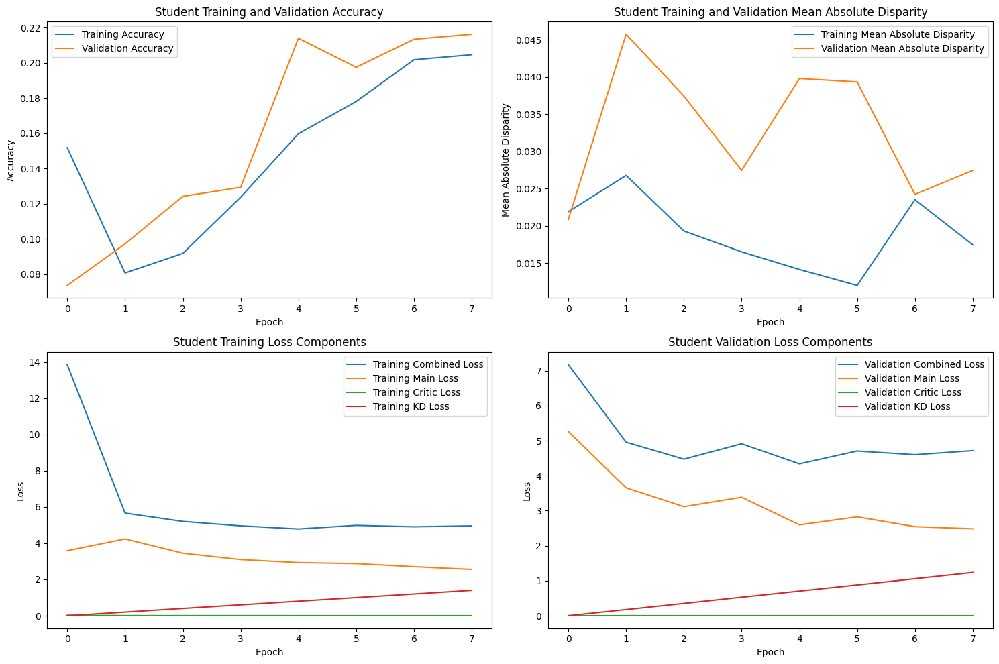

Epoch 9/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.42it/s]



STUDENT - Lambda 40 - Epoch 9 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.209838, VALIDATION Accuracy: 0.2196
TRAINING Disparity: 0.019580, VALIDATION Disparity: 0.0291
TRAINING Combined Loss: 5.300912, VALIDATION Combined Loss: 4.9720
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.06140679660169901
Class Celebration: Val Disparity = 0.030575713594581527
Class Parade: Val Disparity = 0.05322128851540614
Class Waiter_Or_Waitress: Val Disparity = 0.029411764705882353
Class Individual_Sports: Val Disparity = -0.047229874502601826
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = -0.020833333333333332
Class Business: Val Disparity = -0.020021561681811174
Class Dresses: Val Disparity = -0.006666666666666667
Class Water_Activities: Val Disparity = -0.07633136094674553
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.009174311926605503
Class 

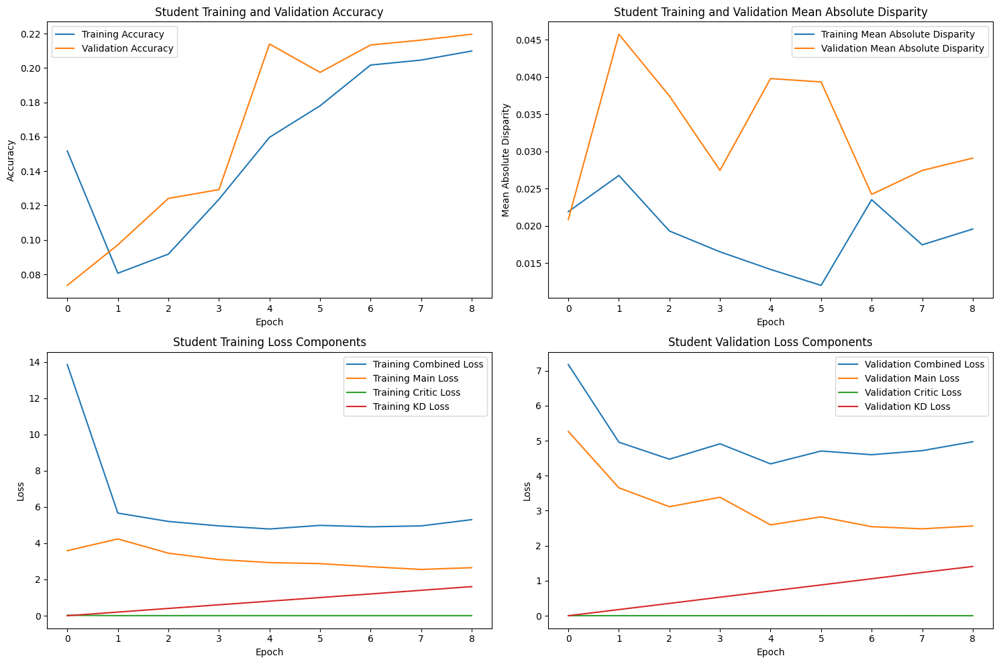

Epoch 10/10, Validation: 100%|███████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.49it/s]



STUDENT - Lambda 40 - Epoch 10 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.223997, VALIDATION Accuracy: 0.2301
TRAINING Disparity: 0.017058, VALIDATION Disparity: 0.0421
TRAINING Combined Loss: 5.340148, VALIDATION Combined Loss: 5.0225
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.06140679660169901
Class Celebration: Val Disparity = 0.030575713594581527
Class Parade: Val Disparity = 0.05322128851540614
Class Waiter_Or_Waitress: Val Disparity = 0.029411764705882353
Class Individual_Sports: Val Disparity = -0.047229874502601826
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = -0.020833333333333332
Class Business: Val Disparity = -0.020021561681811174
Class Dresses: Val Disparity = -0.006666666666666667
Class Water_Activities: Val Disparity = -0.07633136094674553
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.009174311926605503
Class

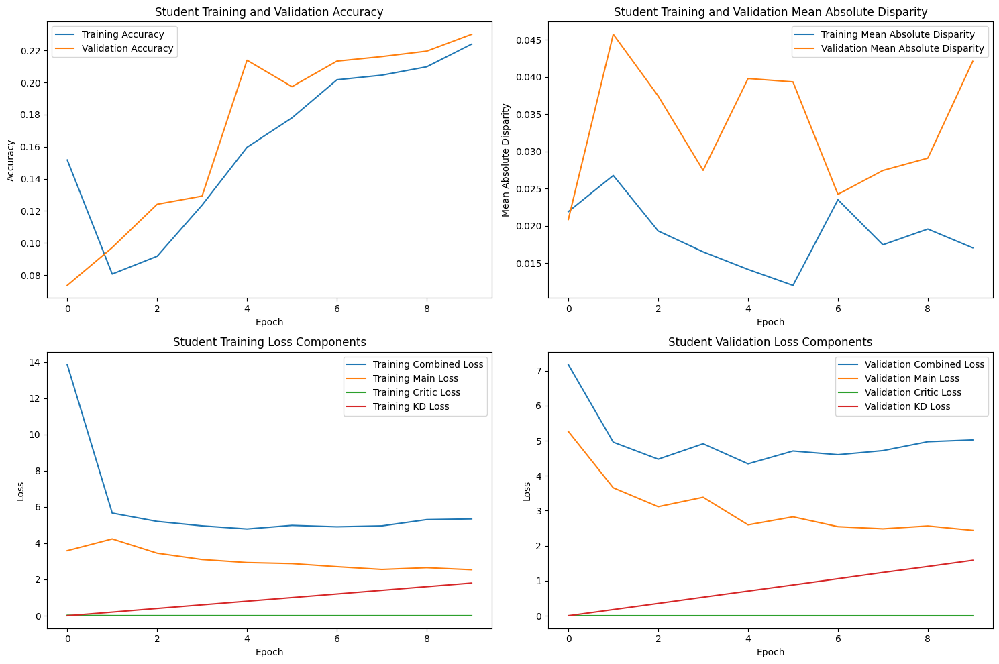

Finished Training STUDENT with lambda value of 40. Best epoch number: 5
Training Student with Lambda Value of 80


Epoch 1/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.46it/s]



STUDENT - Lambda 80 - Epoch 1 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.161246, VALIDATION Accuracy: 0.1236
TRAINING Disparity: 0.023302, VALIDATION Disparity: 0.0218
TRAINING Combined Loss: 18.110421, VALIDATION Combined Loss: 5.4528
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.02267616191904054
Class Celebration: Val Disparity = 0.01417513304305755
Class Parade: Val Disparity = 0.027077497665732957
Class Waiter_Or_Waitress: Val Disparity = -0.0189075630252101
Class Individual_Sports: Val Disparity = 0.0007040097949188966
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = -0.03342060680733095
Class Dresses: Val Disparity = 0.0571014492753623
Class Water_Activities: Val Disparity = 0.0
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = -0.006334841628959271
Class P

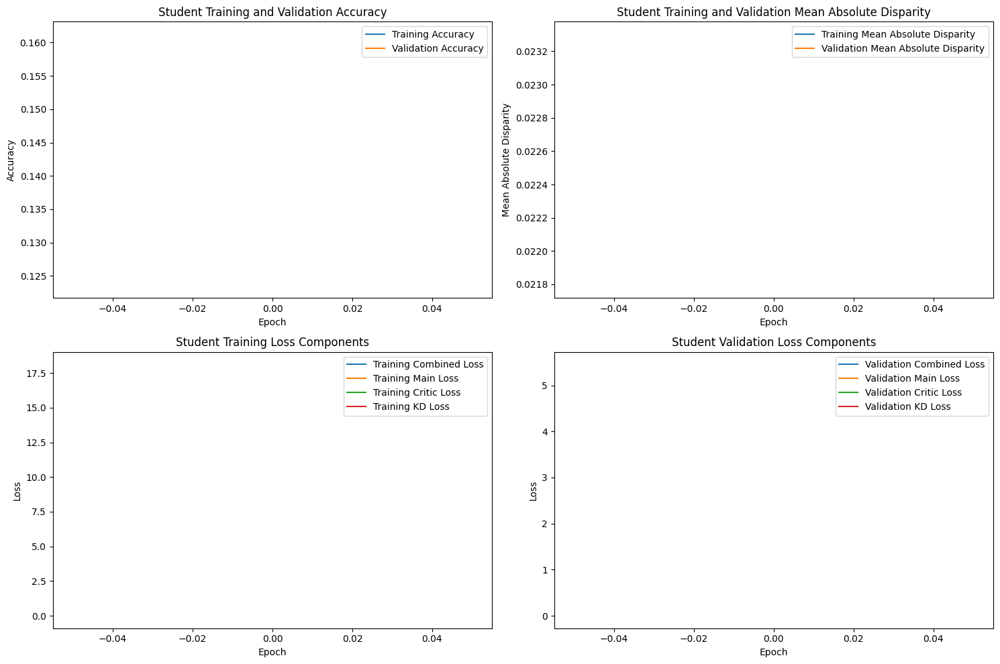

Epoch 2/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.40it/s]



STUDENT - Lambda 80 - Epoch 2 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.178299, VALIDATION Accuracy: 0.1946
TRAINING Disparity: 0.015658, VALIDATION Disparity: 0.0202
TRAINING Combined Loss: 4.753723, VALIDATION Combined Loss: 4.4904
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.018865567216391543
Class Celebration: Val Disparity = 0.0006289308176100489
Class Parade: Val Disparity = -0.005602240896358551
Class Waiter_Or_Waitress: Val Disparity = 0.029411764705882356
Class Individual_Sports: Val Disparity = -0.032353841444750536
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.05952380952380955
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = -0.006666666666666665
Class Water_Activities: Val Disparity = 0.0
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.007692307692307693
Cla

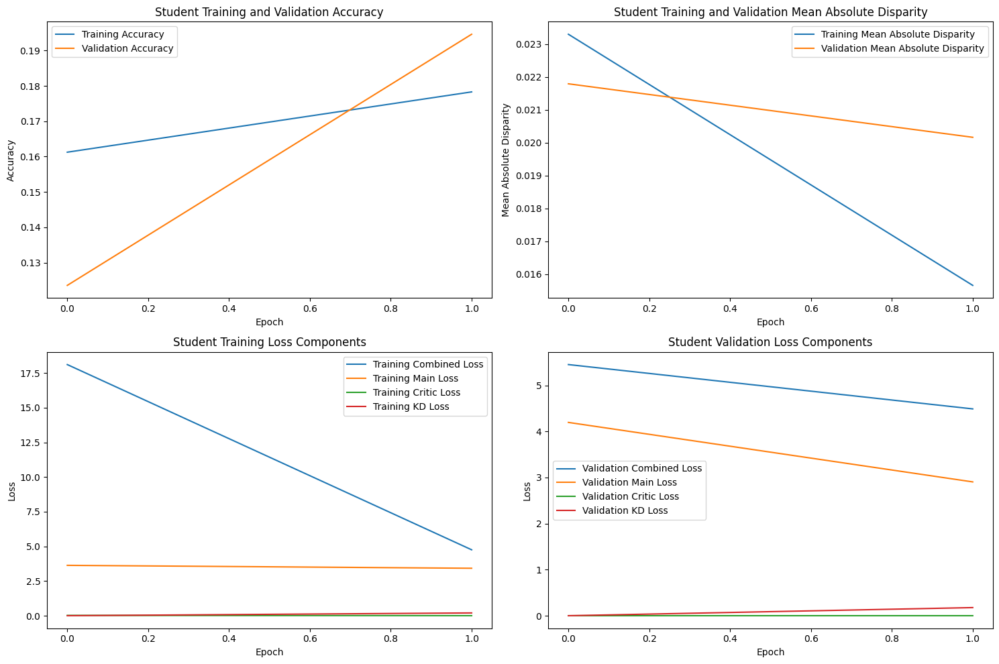

Epoch 3/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.42it/s]



STUDENT - Lambda 80 - Epoch 3 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.187365, VALIDATION Accuracy: 0.2051
TRAINING Disparity: 0.010528, VALIDATION Disparity: 0.0525
TRAINING Combined Loss: 4.907168, VALIDATION Combined Loss: 4.4505
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04566466766616695
Class Celebration: Val Disparity = -0.08776003870343492
Class Parade: Val Disparity = -0.0009337068160597539
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = -0.03336394245485158
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.16829004329004332
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.0
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.007692307692307692
Class Performance_And_Entertainment: Val

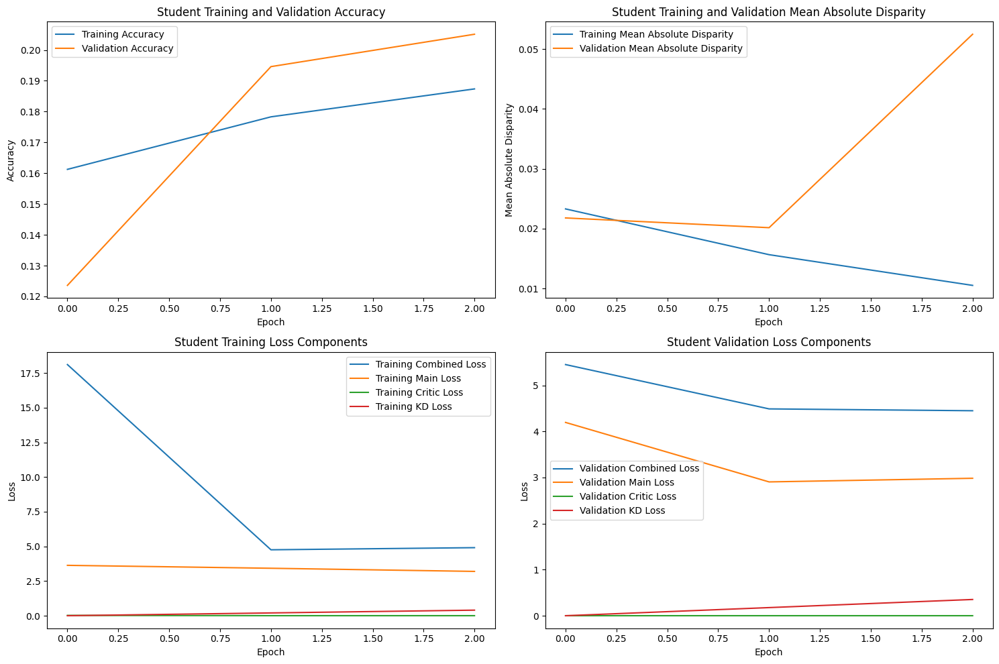

Epoch 4/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:21<00:00,  2.51it/s]



STUDENT - Lambda 80 - Epoch 4 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.206192, VALIDATION Accuracy: 0.2026
TRAINING Disparity: 0.012367, VALIDATION Disparity: 0.0219
TRAINING Combined Loss: 4.651137, VALIDATION Combined Loss: 6.1547
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04566466766616695
Class Celebration: Val Disparity = -0.08776003870343492
Class Parade: Val Disparity = -0.0009337068160597539
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = -0.03336394245485158
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.16829004329004332
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.0
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.007692307692307692
Class Performance_And_Entertainment: Val

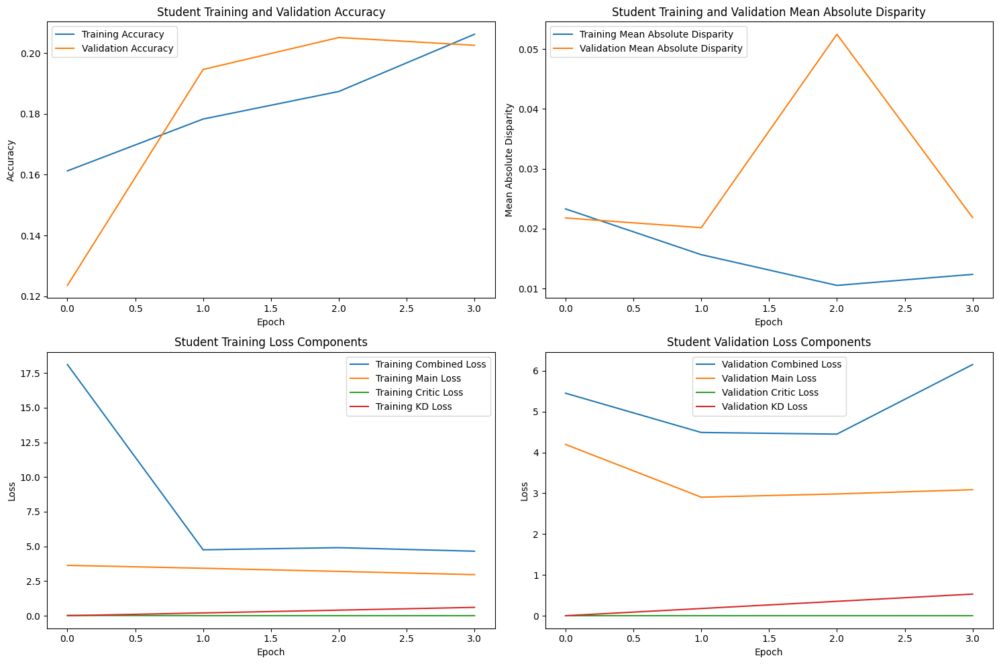

Epoch 5/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.40it/s]



STUDENT - Lambda 80 - Epoch 5 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.206964, VALIDATION Accuracy: 0.2182
TRAINING Disparity: 0.008581, VALIDATION Disparity: 0.0327
TRAINING Combined Loss: 4.917853, VALIDATION Combined Loss: 4.5280
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.04566466766616695
Class Celebration: Val Disparity = -0.08776003870343492
Class Parade: Val Disparity = -0.0009337068160597539
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = -0.03336394245485158
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.16829004329004332
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.0
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.007692307692307692
Class Performance_And_Entertainment: Val

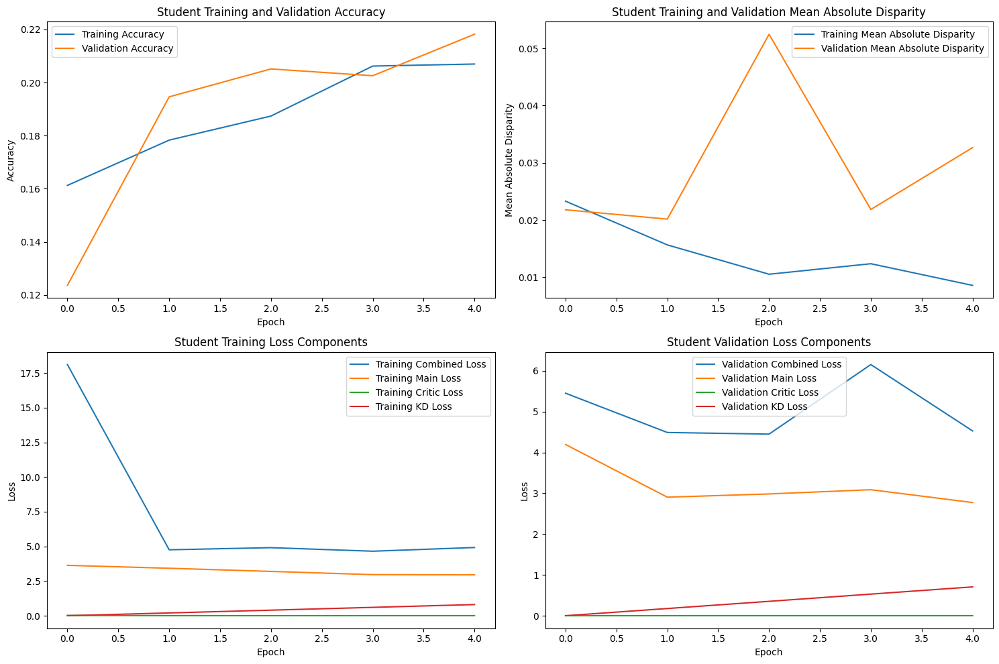

Epoch 6/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.43it/s]



STUDENT - Lambda 80 - Epoch 6 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.217052, VALIDATION Accuracy: 0.2293
TRAINING Disparity: 0.012564, VALIDATION Disparity: 0.0523
TRAINING Combined Loss: 4.762637, VALIDATION Combined Loss: 4.4209
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.08558220889555213
Class Celebration: Val Disparity = 0.0022738268021286756
Class Parade: Val Disparity = 0.04481792717086838
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.029721456994184298
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.16693722943722947
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = -0.10749506903353058
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = -0.0070135746606334835
Class Performance_And_E

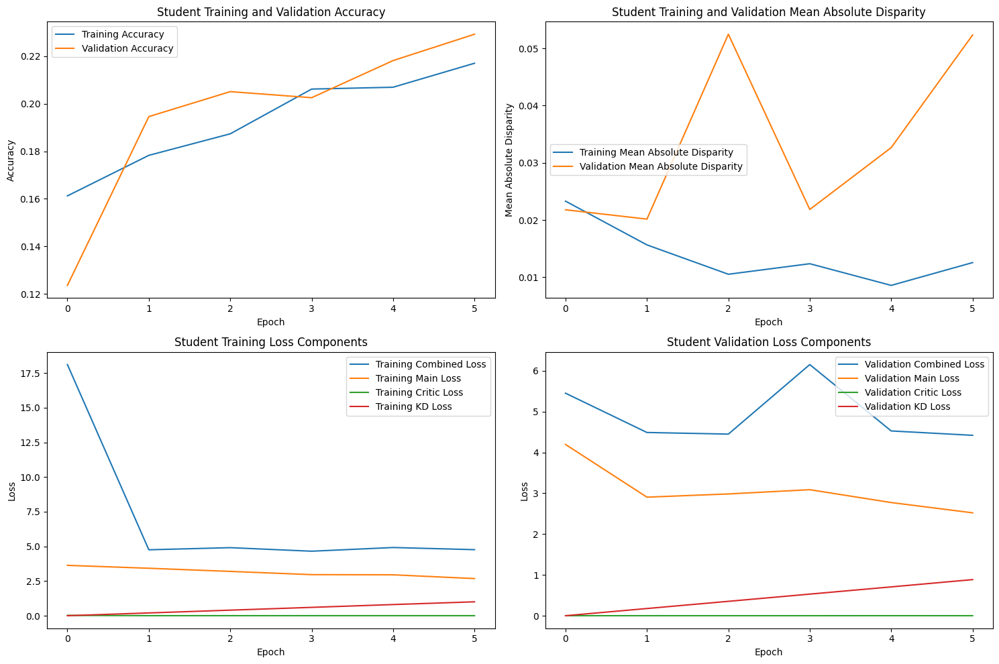

Epoch 7/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.41it/s]



STUDENT - Lambda 80 - Epoch 7 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.211053, VALIDATION Accuracy: 0.2298
TRAINING Disparity: 0.007975, VALIDATION Disparity: 0.0477
TRAINING Combined Loss: 5.055338, VALIDATION Combined Loss: 4.5280
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.08558220889555213
Class Celebration: Val Disparity = 0.0022738268021286756
Class Parade: Val Disparity = 0.04481792717086838
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.029721456994184298
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.16693722943722947
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = -0.10749506903353058
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = -0.0070135746606334835
Class Performance_And_E

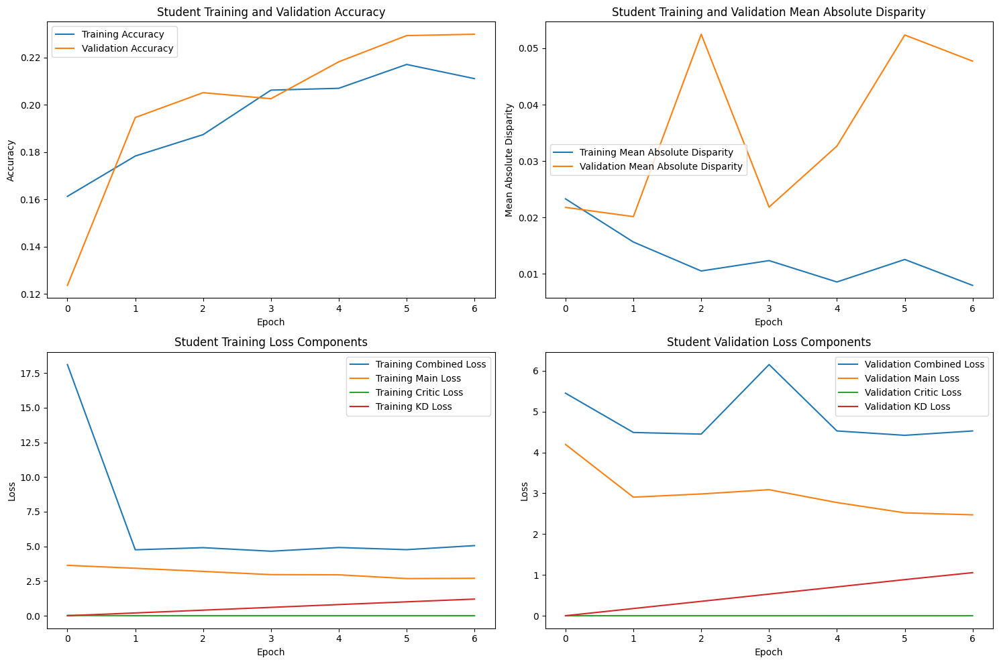

Epoch 8/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.45it/s]



STUDENT - Lambda 80 - Epoch 8 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.226524, VALIDATION Accuracy: 0.2486
TRAINING Disparity: 0.012160, VALIDATION Disparity: 0.0350
TRAINING Combined Loss: 4.903607, VALIDATION Combined Loss: 4.6774
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.08558220889555213
Class Celebration: Val Disparity = 0.0022738268021286756
Class Parade: Val Disparity = 0.04481792717086838
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.029721456994184298
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.16693722943722947
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = -0.10749506903353058
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = -0.0070135746606334835
Class Performance_And_E

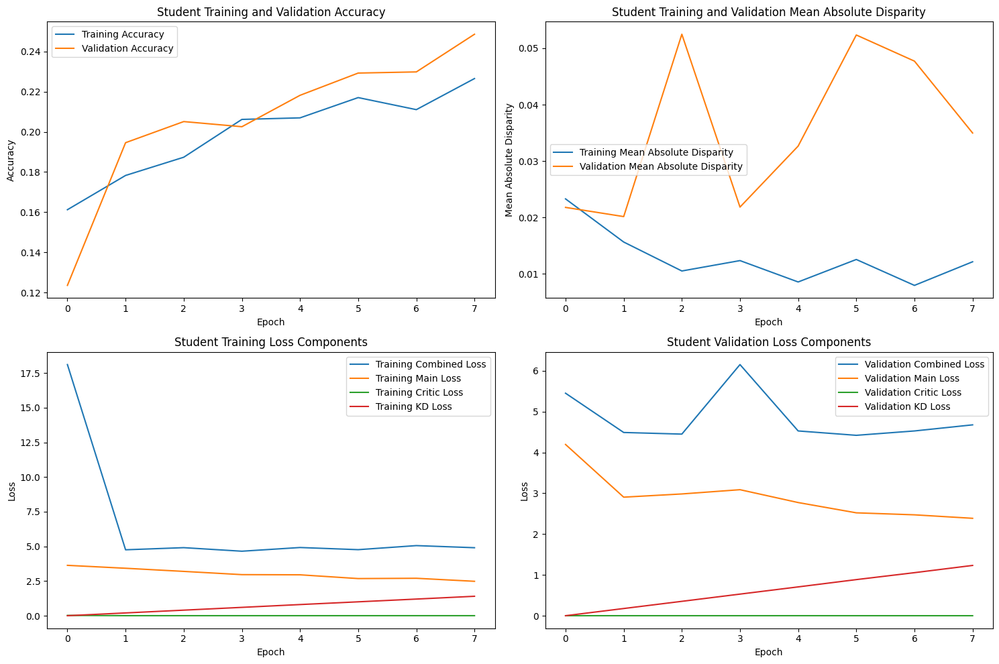

Epoch 9/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.44it/s]



STUDENT - Lambda 80 - Epoch 9 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.233758, VALIDATION Accuracy: 0.2381
TRAINING Disparity: 0.017273, VALIDATION Disparity: 0.0275
TRAINING Combined Loss: 5.255089, VALIDATION Combined Loss: 4.9217
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.08558220889555213
Class Celebration: Val Disparity = 0.0022738268021286756
Class Parade: Val Disparity = 0.04481792717086838
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.029721456994184298
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.16693722943722947
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = -0.10749506903353058
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = -0.0070135746606334835
Class Performance_And_E

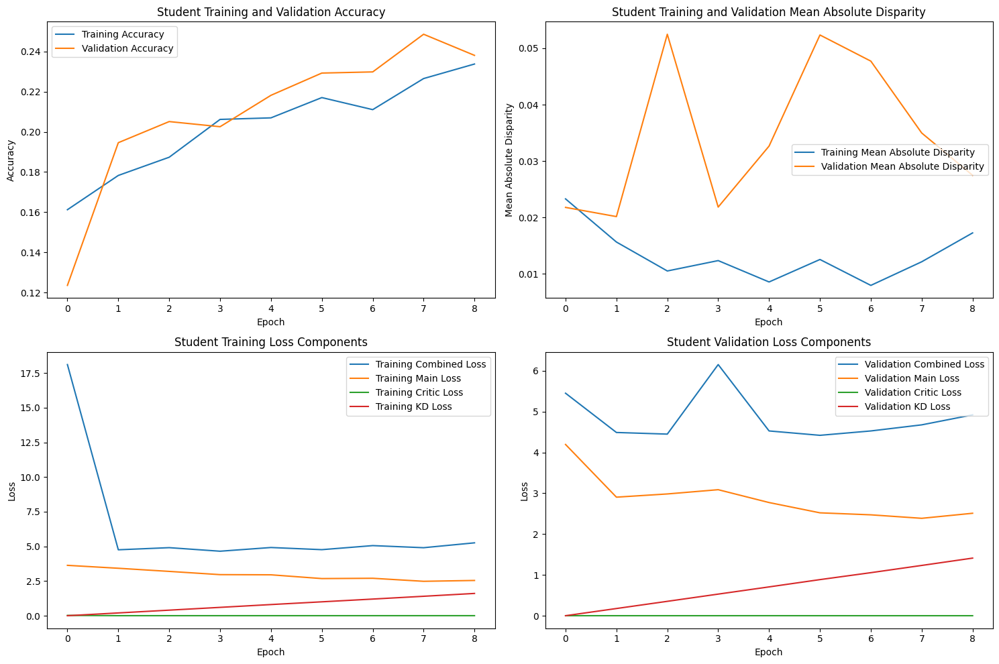

Epoch 10/10, Validation: 100%|███████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.42it/s]



STUDENT - Lambda 80 - Epoch 10 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.246393, VALIDATION Accuracy: 0.2580
TRAINING Disparity: 0.022588, VALIDATION Disparity: 0.0411
TRAINING Combined Loss: 5.208785, VALIDATION Combined Loss: 4.9627
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.08558220889555213
Class Celebration: Val Disparity = 0.0022738268021286756
Class Parade: Val Disparity = 0.04481792717086838
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.029721456994184298
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.16693722943722947
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = -0.10749506903353058
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = -0.0070135746606334835
Class Performance_And_

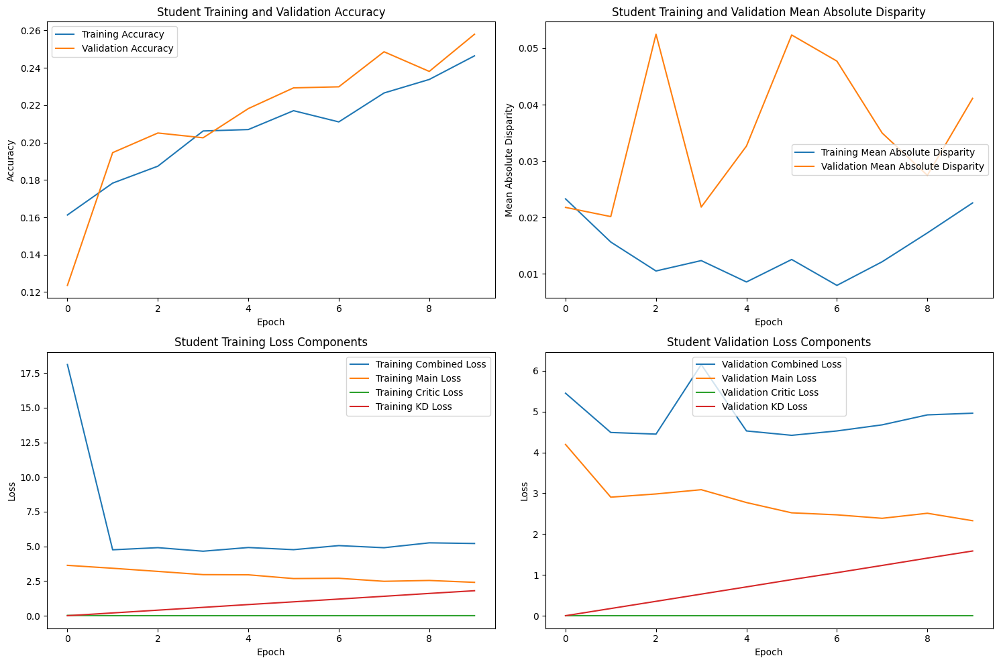

Finished Training STUDENT with lambda value of 80. Best epoch number: 6
Training Student with Lambda Value of 100


Epoch 1/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.46it/s]



STUDENT - Lambda 100 - Epoch 1 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.161323, VALIDATION Accuracy: 0.1179
TRAINING Disparity: 0.015772, VALIDATION Disparity: 0.0405
TRAINING Combined Loss: 20.783746, VALIDATION Combined Loss: 6.4263
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.01199400299850073
Class Celebration: Val Disparity = -0.003483309143686504
Class Parade: Val Disparity = -0.02707749766573295
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = -0.038567493112947715
Class Surgeons: Val Disparity = -0.116734693877551
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.013091021099645779
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = -0.07041420118343195
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.027522935779816512
Class Cheering: Val Disparity = 0.0027149

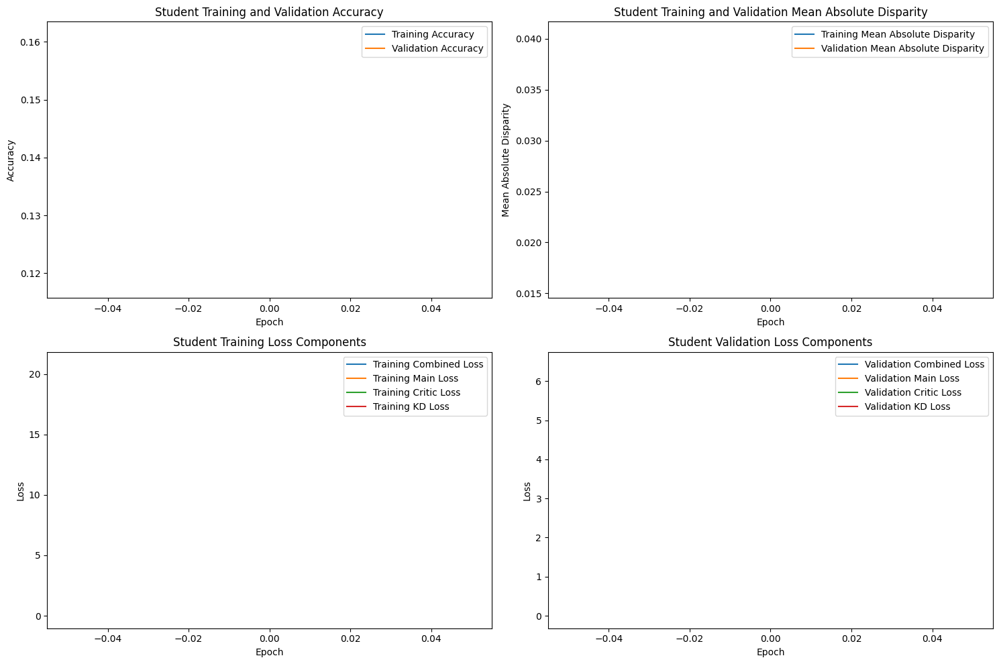

Epoch 2/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:23<00:00,  2.38it/s]



STUDENT - Lambda 100 - Epoch 2 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.145023, VALIDATION Accuracy: 0.1298
TRAINING Disparity: 0.017583, VALIDATION Disparity: 0.0369
TRAINING Combined Loss: 5.423659, VALIDATION Combined Loss: 5.2561
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.041854072963518174
Class Celebration: Val Disparity = 0.01683599419448477
Class Parade: Val Disparity = -0.026143790849673193
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = -0.06890113253749613
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.0
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.01926605504587156
Class Cheering: Val Disparity = -0.03642533936651583
Class Performance_And_Entertainment: Va

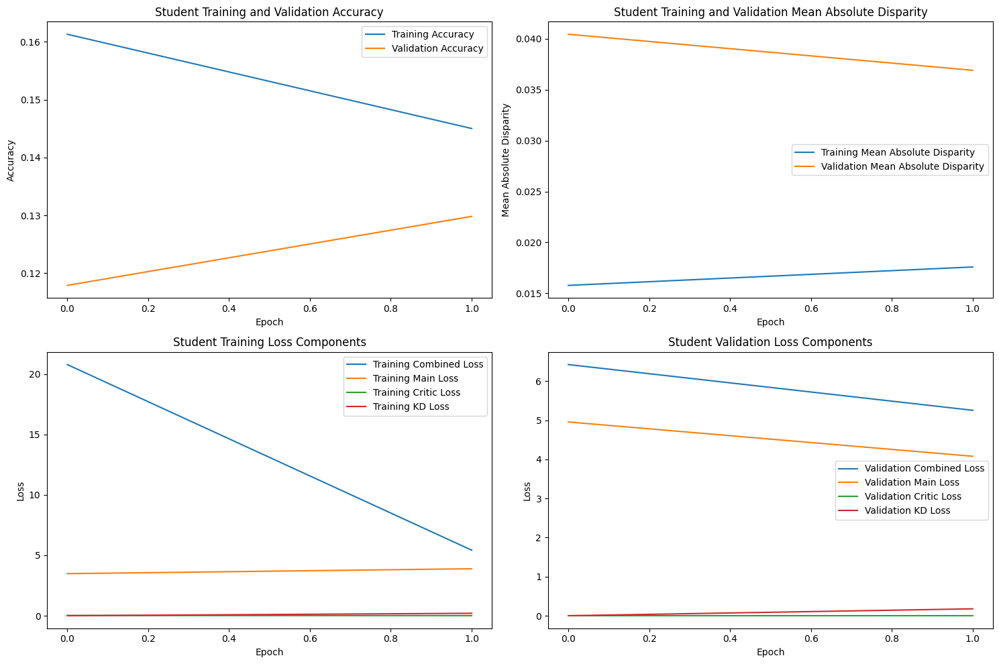

Epoch 3/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.44it/s]



STUDENT - Lambda 100 - Epoch 3 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.173476, VALIDATION Accuracy: 0.2020
TRAINING Disparity: 0.008644, VALIDATION Disparity: 0.0270
TRAINING Combined Loss: 5.158090, VALIDATION Combined Loss: 5.4322
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.041854072963518174
Class Celebration: Val Disparity = 0.01683599419448477
Class Parade: Val Disparity = -0.026143790849673193
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = -0.06890113253749613
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.0
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.01926605504587156
Class Cheering: Val Disparity = -0.03642533936651583
Class Performance_And_Entertainment: Va

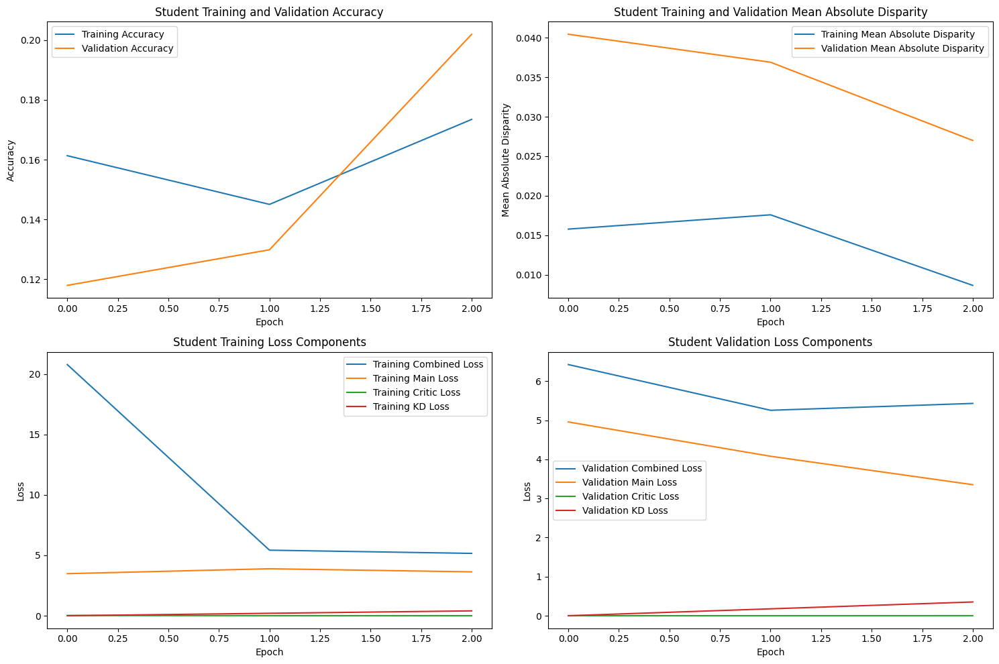

Epoch 4/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.42it/s]



STUDENT - Lambda 100 - Epoch 4 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.145100, VALIDATION Accuracy: 0.1713
TRAINING Disparity: 0.015861, VALIDATION Disparity: 0.0149
TRAINING Combined Loss: 6.168537, VALIDATION Combined Loss: 5.0006
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.0015617191404296848
Class Celebration: Val Disparity = 0.02215771649733914
Class Parade: Val Disparity = -0.01400560224089636
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = -0.004132231404958677
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.0
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.03256880733944955
Class Cheering: Val Disparity = 0.0
Class Performance_And_Entertainment: Val Disparity = 0.

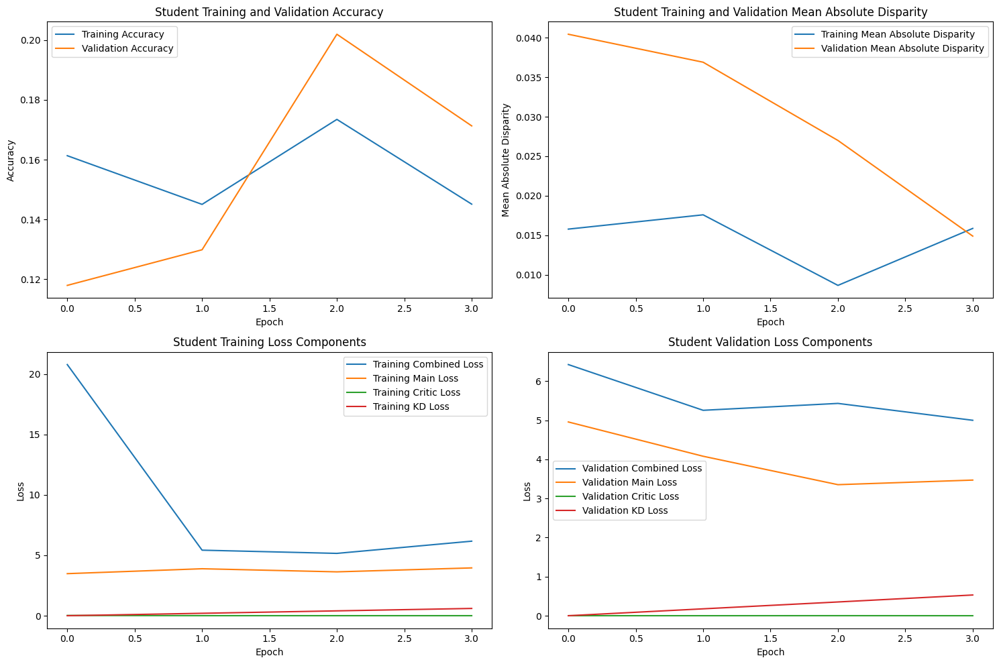

Epoch 5/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.43it/s]



STUDENT - Lambda 100 - Epoch 5 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.176080, VALIDATION Accuracy: 0.1864
TRAINING Disparity: 0.011303, VALIDATION Disparity: 0.0158
TRAINING Combined Loss: 5.007335, VALIDATION Combined Loss: 4.7334
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.010807096451774134
Class Celebration: Val Disparity = 0.0
Class Parade: Val Disparity = -0.0326797385620915
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.006550352004897463
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = -0.013333333333333334
Class Water_Activities: Val Disparity = 0.0
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class Performance_And_Entertainment: Val Disparity = 0.0
Class Family: V

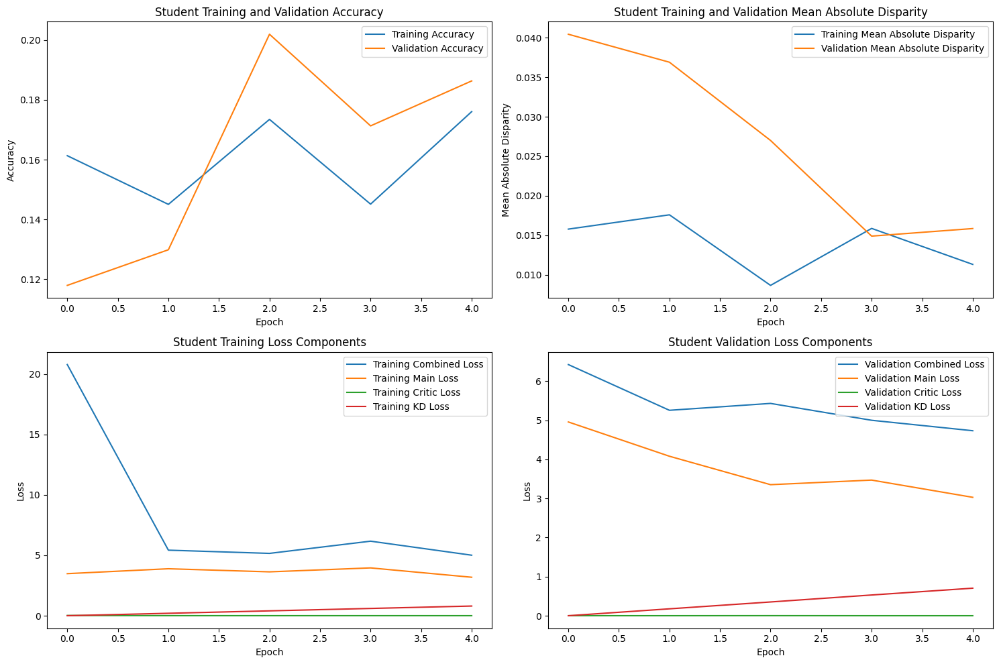

Epoch 6/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.42it/s]



STUDENT - Lambda 100 - Epoch 6 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.189545, VALIDATION Accuracy: 0.1793
TRAINING Disparity: 0.008748, VALIDATION Disparity: 0.0366
TRAINING Combined Loss: 5.141554, VALIDATION Combined Loss: 5.3173
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.010807096451774134
Class Celebration: Val Disparity = 0.0
Class Parade: Val Disparity = -0.0326797385620915
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.006550352004897463
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = -0.013333333333333334
Class Water_Activities: Val Disparity = 0.0
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class Performance_And_Entertainment: Val Disparity = 0.0
Class Family: V

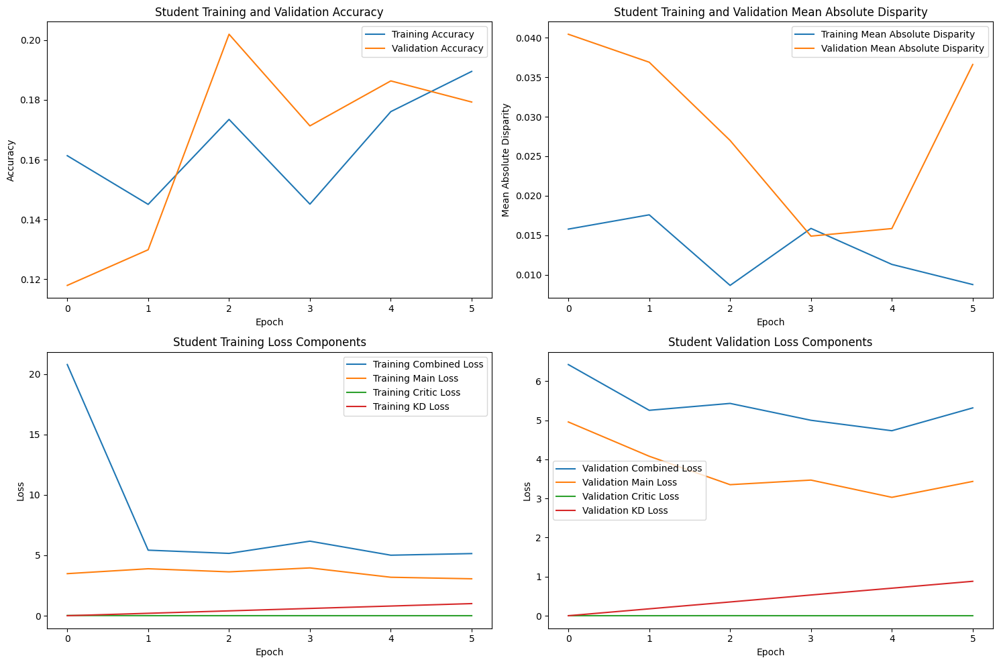

Epoch 7/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.43it/s]



STUDENT - Lambda 100 - Epoch 7 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.188214, VALIDATION Accuracy: 0.1903
TRAINING Disparity: 0.013166, VALIDATION Disparity: 0.0115
TRAINING Combined Loss: 5.232239, VALIDATION Combined Loss: 4.7903
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.010807096451774134
Class Celebration: Val Disparity = 0.0
Class Parade: Val Disparity = -0.0326797385620915
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.006550352004897463
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = -0.013333333333333334
Class Water_Activities: Val Disparity = 0.0
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class Performance_And_Entertainment: Val Disparity = 0.0
Class Family: V

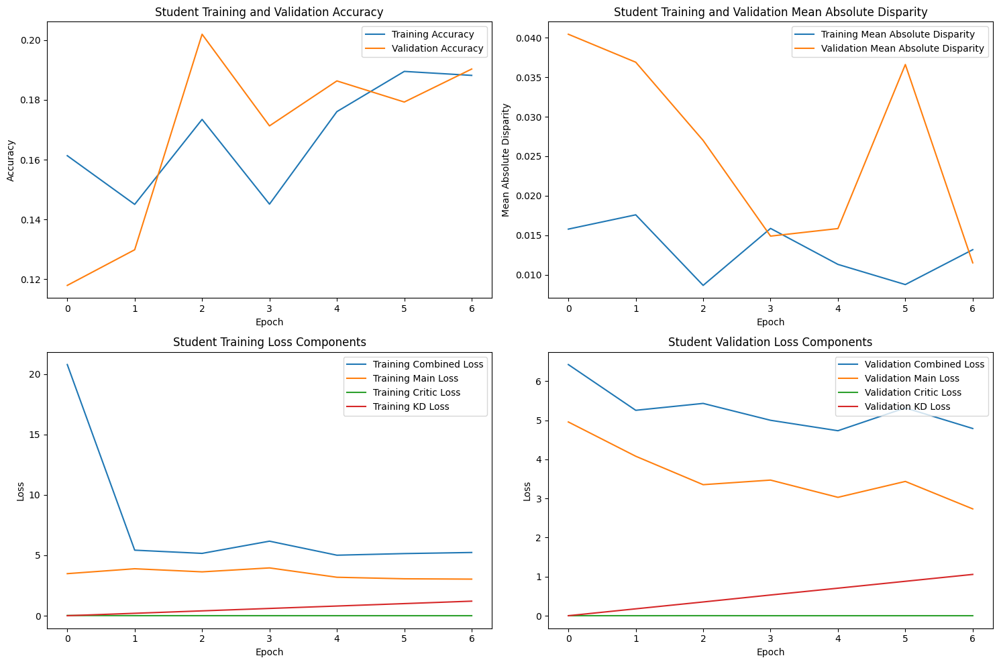

Epoch 8/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:23<00:00,  2.37it/s]



STUDENT - Lambda 100 - Epoch 8 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.182581, VALIDATION Accuracy: 0.1895
TRAINING Disparity: 0.010810, VALIDATION Disparity: 0.0308
TRAINING Combined Loss: 5.730670, VALIDATION Combined Loss: 5.2822
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.010807096451774134
Class Celebration: Val Disparity = 0.0
Class Parade: Val Disparity = -0.0326797385620915
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.006550352004897463
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = -0.013333333333333334
Class Water_Activities: Val Disparity = 0.0
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class Performance_And_Entertainment: Val Disparity = 0.0
Class Family: V

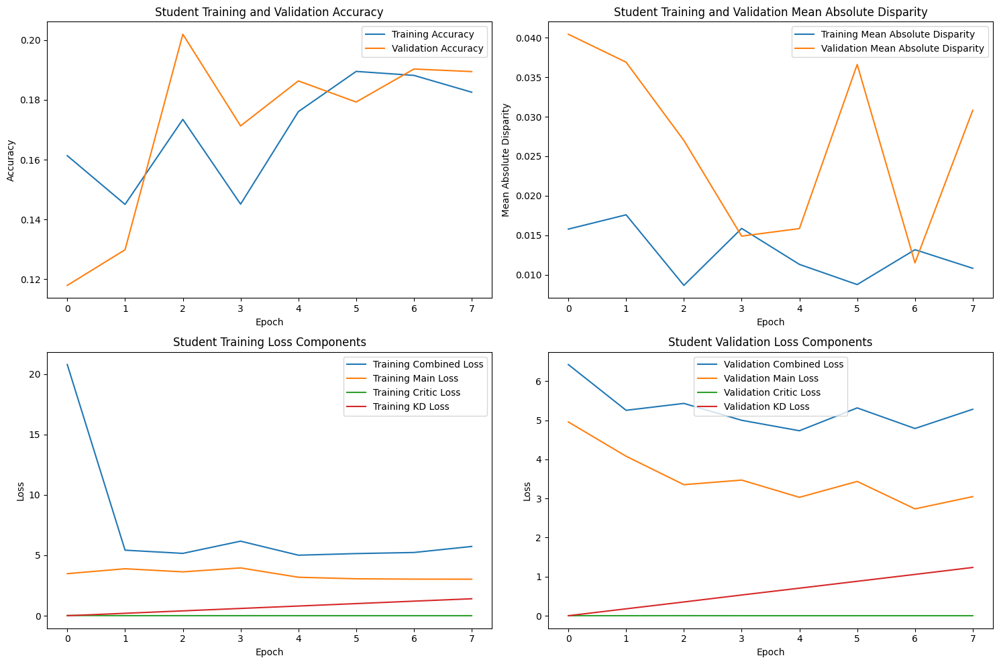

Epoch 9/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.44it/s]



STUDENT - Lambda 100 - Epoch 9 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.187172, VALIDATION Accuracy: 0.1935
TRAINING Disparity: 0.009639, VALIDATION Disparity: 0.0311
TRAINING Combined Loss: 5.614234, VALIDATION Combined Loss: 5.4471
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.010807096451774134
Class Celebration: Val Disparity = 0.0
Class Parade: Val Disparity = -0.0326797385620915
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.006550352004897463
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = -0.013333333333333334
Class Water_Activities: Val Disparity = 0.0
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class Performance_And_Entertainment: Val Disparity = 0.0
Class Family: V

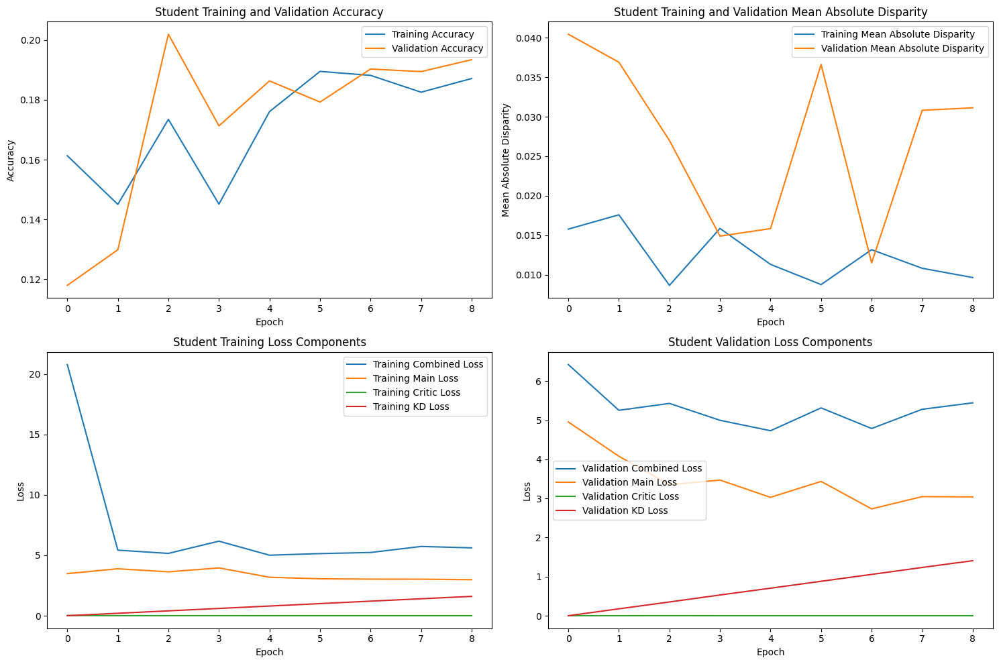

Epoch 10/10, Validation: 100%|███████████████████████████████████████████████████████████████| 55/55 [00:23<00:00,  2.35it/s]



STUDENT - Lambda 100 - Epoch 10 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.167149, VALIDATION Accuracy: 0.1920
TRAINING Disparity: 0.014996, VALIDATION Disparity: 0.0395
TRAINING Combined Loss: 7.794307, VALIDATION Combined Loss: 5.5243
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.010807096451774134
Class Celebration: Val Disparity = 0.0
Class Parade: Val Disparity = -0.0326797385620915
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.006550352004897463
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = -0.013333333333333334
Class Water_Activities: Val Disparity = 0.0
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class Performance_And_Entertainment: Val Disparity = 0.0
Class Family: 

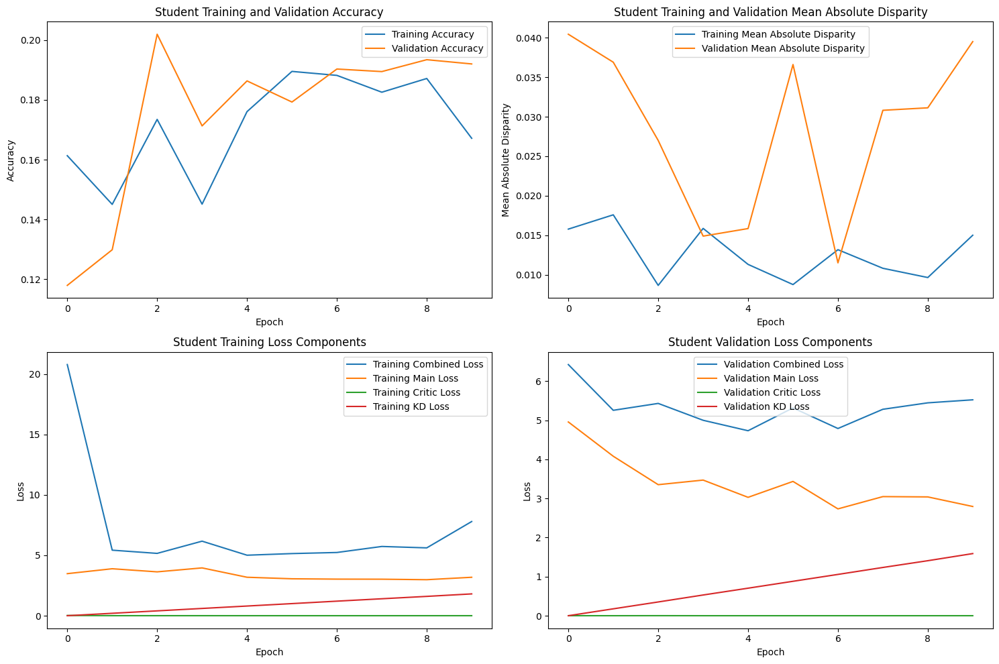

Finished Training STUDENT with lambda value of 100. Best epoch number: 5
Training Student with Lambda Value of 150


Epoch 1/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:23<00:00,  2.36it/s]



STUDENT - Lambda 150 - Epoch 1 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.151466, VALIDATION Accuracy: 0.0662
TRAINING Disparity: 0.020360, VALIDATION Disparity: 0.0457
TRAINING Combined Loss: 35.969963, VALIDATION Combined Loss: 6.9904
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.025112443778110935
Class Celebration: Val Disparity = -0.06110304789550074
Class Parade: Val Disparity = -0.014005602240896357
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.08570554025099478
Class Surgeons: Val Disparity = 0.12816326530612243
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.04620360388110273
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.023668639053254437
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.01926605504587156
Class Cheering: Val Disparity = 0.0
Class 

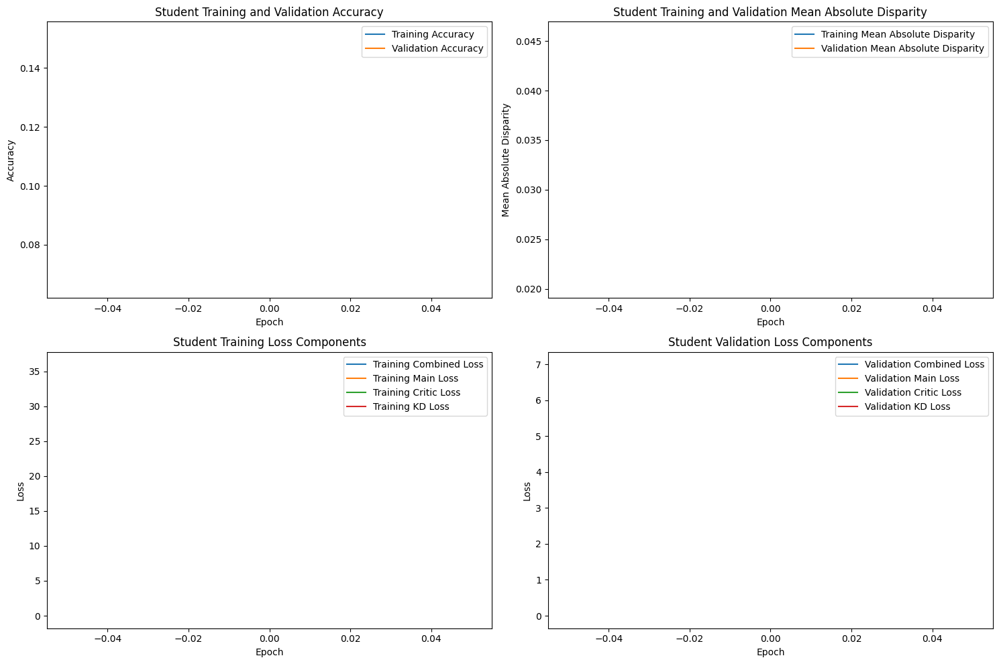

Epoch 2/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:23<00:00,  2.34it/s]



STUDENT - Lambda 150 - Epoch 2 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.073129, VALIDATION Accuracy: 0.1114
TRAINING Disparity: 0.026998, VALIDATION Disparity: 0.0428
TRAINING Combined Loss: 7.466691, VALIDATION Combined Loss: 5.1601
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.05515992003997994
Class Celebration: Val Disparity = -0.0655539429124335
Class Parade: Val Disparity = 0.03921568627450981
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.003275176002448728
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = -0.06992145387340212
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.0
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.02339449541284403
Class Cheering: Val Disparity = 0.0
Class Performance_And_Entertainment: Val Di

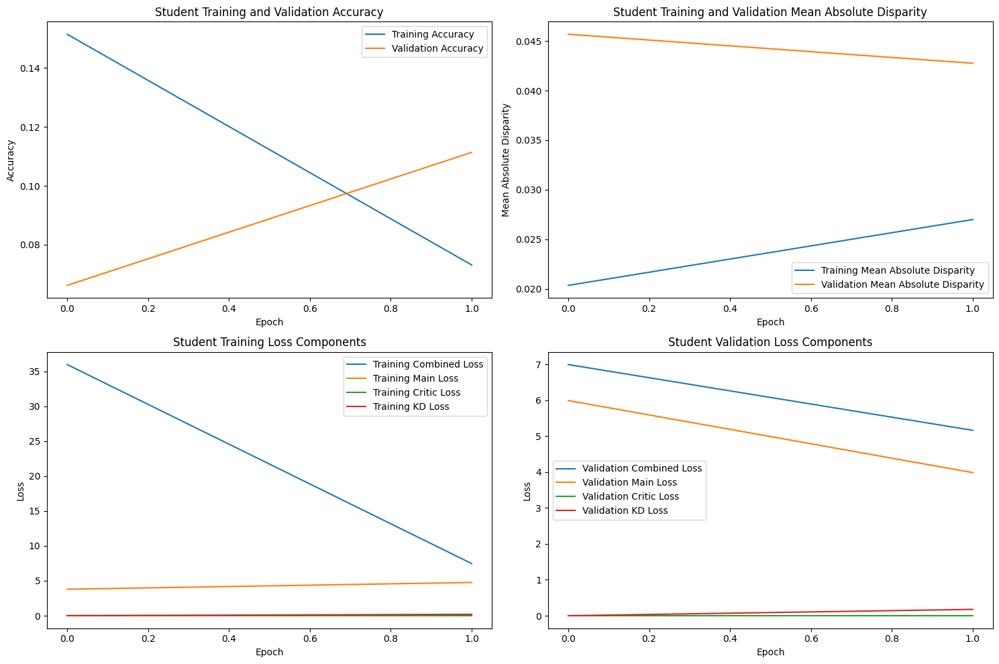

Epoch 3/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:23<00:00,  2.35it/s]



STUDENT - Lambda 150 - Epoch 3 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.115046, VALIDATION Accuracy: 0.1429
TRAINING Disparity: 0.018280, VALIDATION Disparity: 0.0592
TRAINING Combined Loss: 6.096049, VALIDATION Combined Loss: 5.5588
--------------------------------------------------

Class Team_Sports: Val Disparity = 0.05515992003997994
Class Celebration: Val Disparity = -0.0655539429124335
Class Parade: Val Disparity = 0.03921568627450981
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.003275176002448728
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = -0.06992145387340212
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.0
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.02339449541284403
Class Cheering: Val Disparity = 0.0
Class Performance_And_Entertainment: Val Di

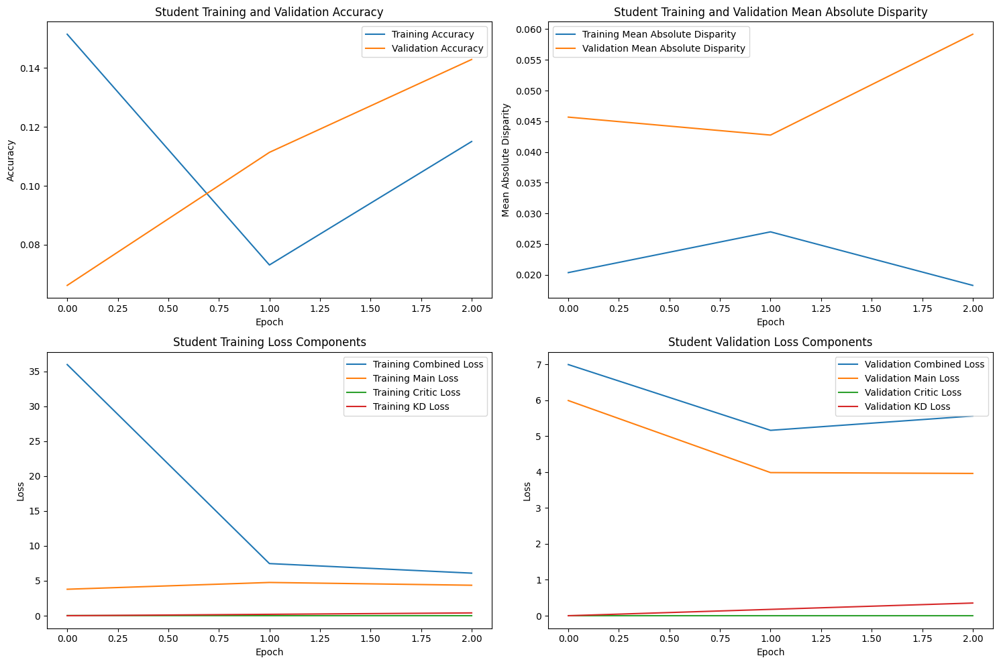

Epoch 4/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:23<00:00,  2.36it/s]



STUDENT - Lambda 150 - Epoch 4 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.137635, VALIDATION Accuracy: 0.1710
TRAINING Disparity: 0.028848, VALIDATION Disparity: 0.0261
TRAINING Combined Loss: 5.612340, VALIDATION Combined Loss: 5.1034
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.048788105947026206
Class Celebration: Val Disparity = -0.03850991775520074
Class Parade: Val Disparity = -0.057889822595704965
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.014814814814814814
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = -0.0033882642846141953
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.0
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.009174311926605503
Class Cheering: Val Disparity = 0.0
Class Performance_And_Entertainment

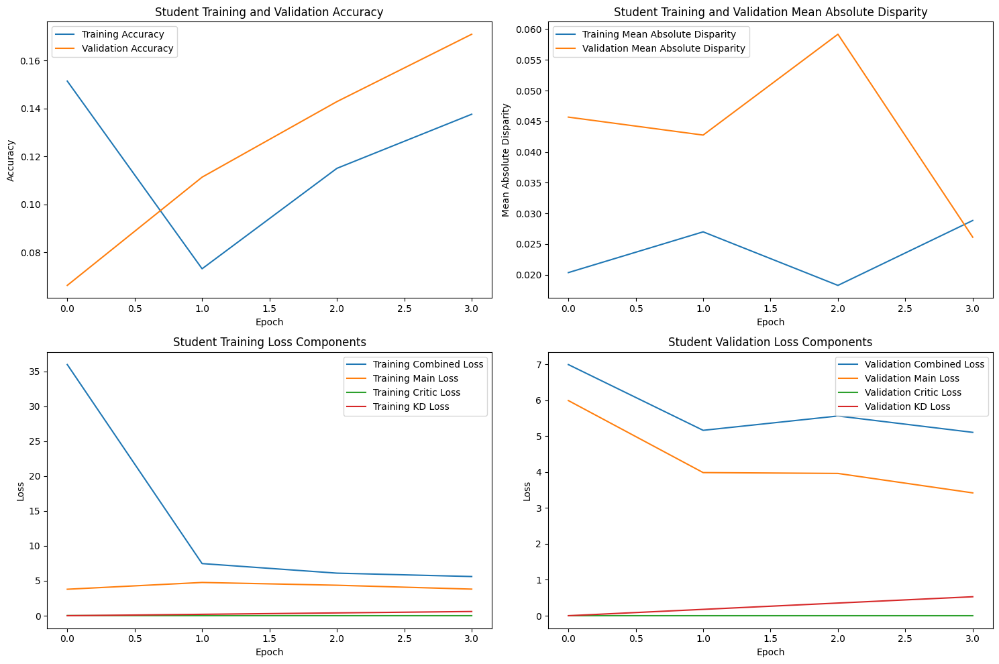

Epoch 5/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:23<00:00,  2.38it/s]



STUDENT - Lambda 150 - Epoch 5 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.166146, VALIDATION Accuracy: 0.1892
TRAINING Disparity: 0.015060, VALIDATION Disparity: 0.0386
TRAINING Combined Loss: 5.226251, VALIDATION Combined Loss: 5.3612
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.048788105947026206
Class Celebration: Val Disparity = -0.03850991775520074
Class Parade: Val Disparity = -0.057889822595704965
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.014814814814814814
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = -0.0033882642846141953
Class Dresses: Val Disparity = 0.0
Class Water_Activities: Val Disparity = 0.0
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.009174311926605503
Class Cheering: Val Disparity = 0.0
Class Performance_And_Entertainment

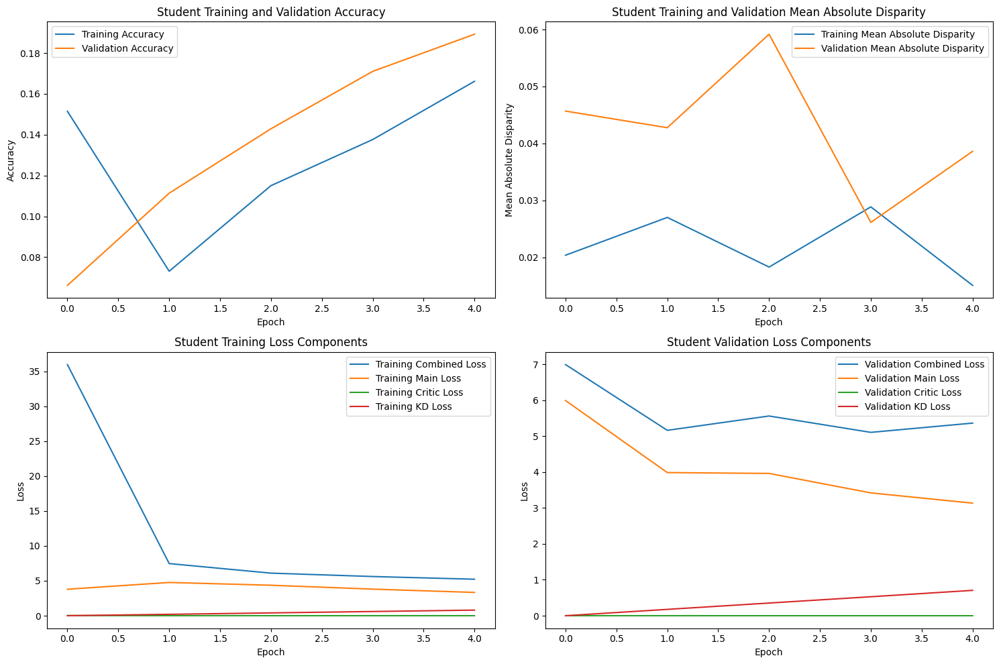

Epoch 6/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:22<00:00,  2.41it/s]



STUDENT - Lambda 150 - Epoch 6 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.182137, VALIDATION Accuracy: 0.1898
TRAINING Disparity: 0.014380, VALIDATION Disparity: 0.0197
TRAINING Combined Loss: 4.939124, VALIDATION Combined Loss: 4.9508
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.004185407296351751
Class Celebration: Val Disparity = 0.01107885824866957
Class Parade: Val Disparity = -0.07096171802054152
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.010682583409856141
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = -0.013333333333333334
Class Water_Activities: Val Disparity = 0.019921104536489154
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class Performance_And_Entertainment: V

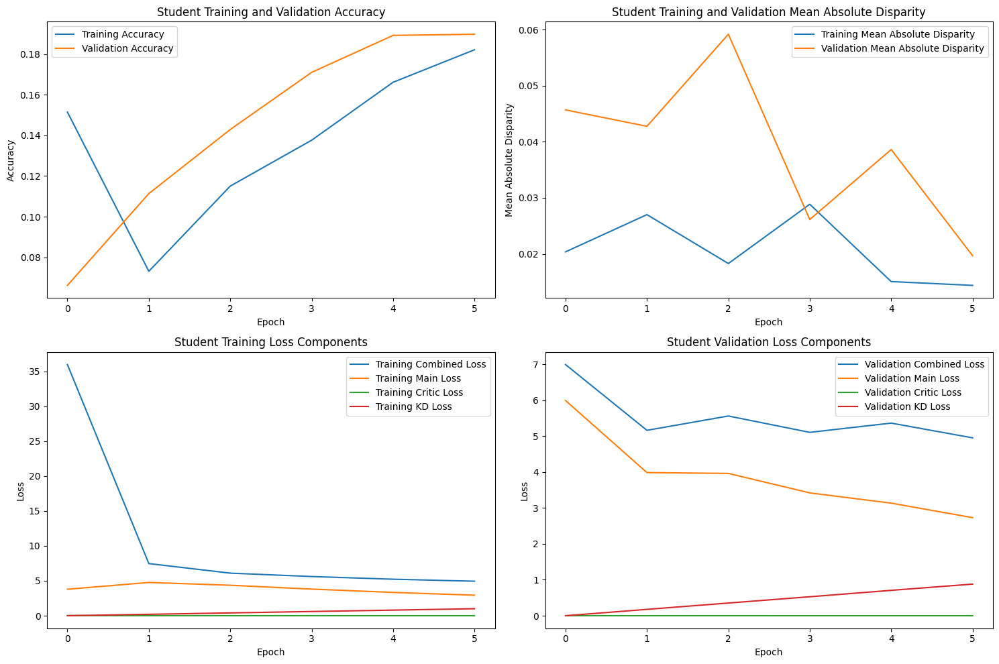

Epoch 7/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:23<00:00,  2.31it/s]



STUDENT - Lambda 150 - Epoch 7 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.192785, VALIDATION Accuracy: 0.1855
TRAINING Disparity: 0.016767, VALIDATION Disparity: 0.0250
TRAINING Combined Loss: 5.020556, VALIDATION Combined Loss: 5.1918
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.004185407296351751
Class Celebration: Val Disparity = 0.01107885824866957
Class Parade: Val Disparity = -0.07096171802054152
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.010682583409856141
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = -0.013333333333333334
Class Water_Activities: Val Disparity = 0.019921104536489154
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class Performance_And_Entertainment: V

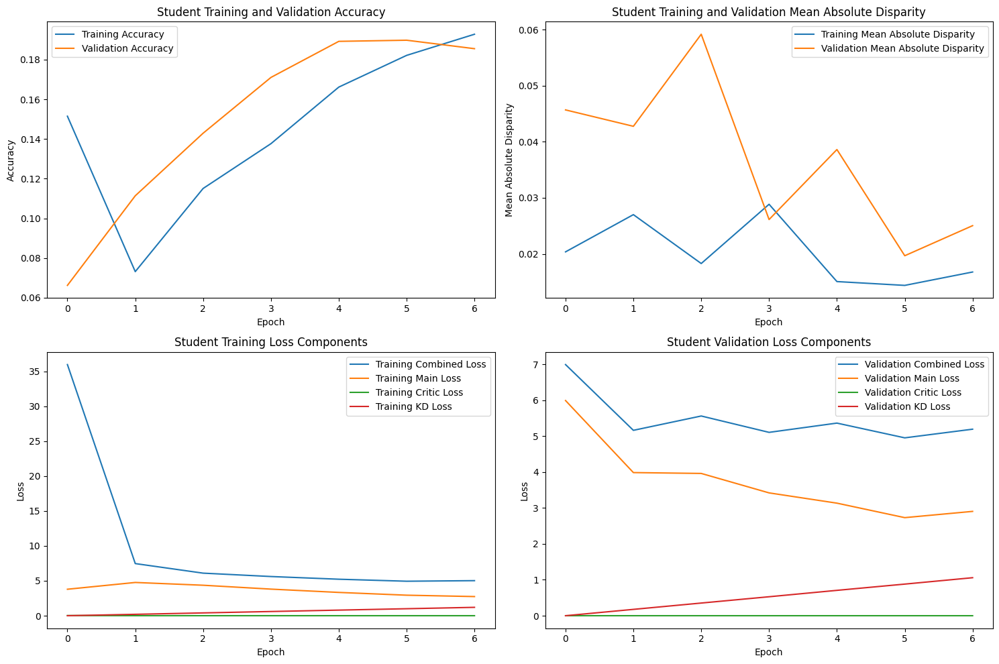

Epoch 8/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:23<00:00,  2.33it/s]



STUDENT - Lambda 150 - Epoch 8 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.192477, VALIDATION Accuracy: 0.2011
TRAINING Disparity: 0.009843, VALIDATION Disparity: 0.0303
TRAINING Combined Loss: 5.111248, VALIDATION Combined Loss: 5.1932
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.004185407296351751
Class Celebration: Val Disparity = 0.01107885824866957
Class Parade: Val Disparity = -0.07096171802054152
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.010682583409856141
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = -0.013333333333333334
Class Water_Activities: Val Disparity = 0.019921104536489154
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class Performance_And_Entertainment: V

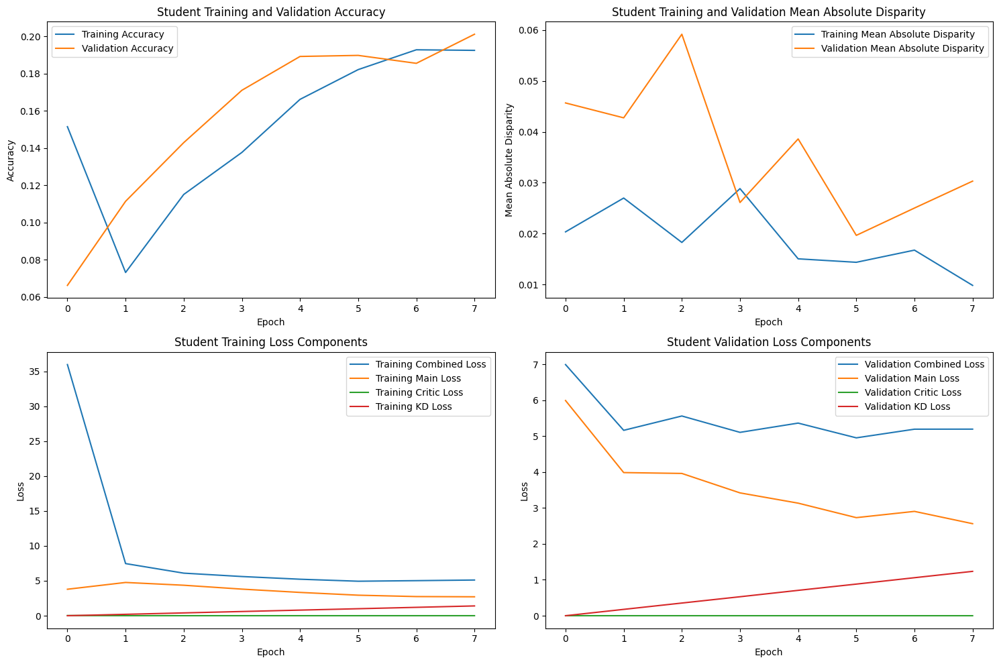

Epoch 9/10, Validation: 100%|████████████████████████████████████████████████████████████████| 55/55 [00:23<00:00,  2.32it/s]



STUDENT - Lambda 150 - Epoch 9 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.196238, VALIDATION Accuracy: 0.1974
TRAINING Disparity: 0.015944, VALIDATION Disparity: 0.0258
TRAINING Combined Loss: 5.520732, VALIDATION Combined Loss: 5.3305
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.004185407296351751
Class Celebration: Val Disparity = 0.01107885824866957
Class Parade: Val Disparity = -0.07096171802054152
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.010682583409856141
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = -0.013333333333333334
Class Water_Activities: Val Disparity = 0.019921104536489154
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class Performance_And_Entertainment: V

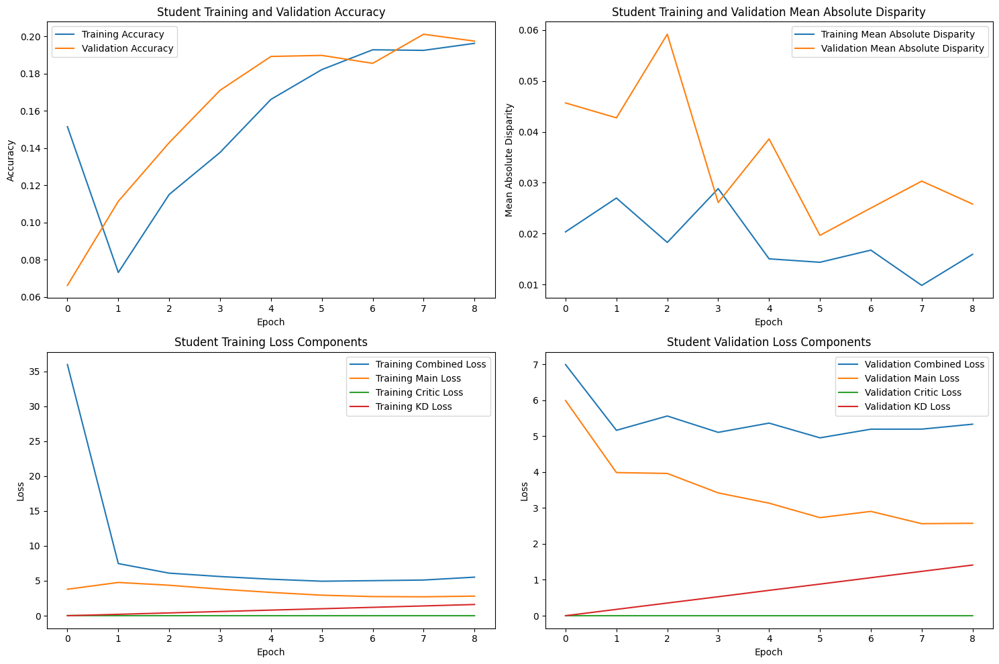

Epoch 10/10, Validation: 100%|███████████████████████████████████████████████████████████████| 55/55 [00:23<00:00,  2.37it/s]



STUDENT - Lambda 150 - Epoch 10 Metrics:
--------------------------------------------------
TRAINING Accuracy: 0.206501, VALIDATION Accuracy: 0.2108
TRAINING Disparity: 0.019687, VALIDATION Disparity: 0.0378
TRAINING Combined Loss: 5.272873, VALIDATION Combined Loss: 5.0531
--------------------------------------------------

Class Team_Sports: Val Disparity = -0.004185407296351751
Class Celebration: Val Disparity = 0.01107885824866957
Class Parade: Val Disparity = -0.07096171802054152
Class Waiter_Or_Waitress: Val Disparity = 0.0
Class Individual_Sports: Val Disparity = 0.010682583409856141
Class Surgeons: Val Disparity = 0.0
Class Spa: Val Disparity = 0.0
Class Law_Enforcement: Val Disparity = 0.0
Class Business: Val Disparity = 0.0
Class Dresses: Val Disparity = -0.013333333333333334
Class Water_Activities: Val Disparity = 0.019921104536489154
Class Picnic: Val Disparity = 0.0
Class Rescue: Val Disparity = 0.0
Class Cheering: Val Disparity = 0.0
Class Performance_And_Entertainment: 

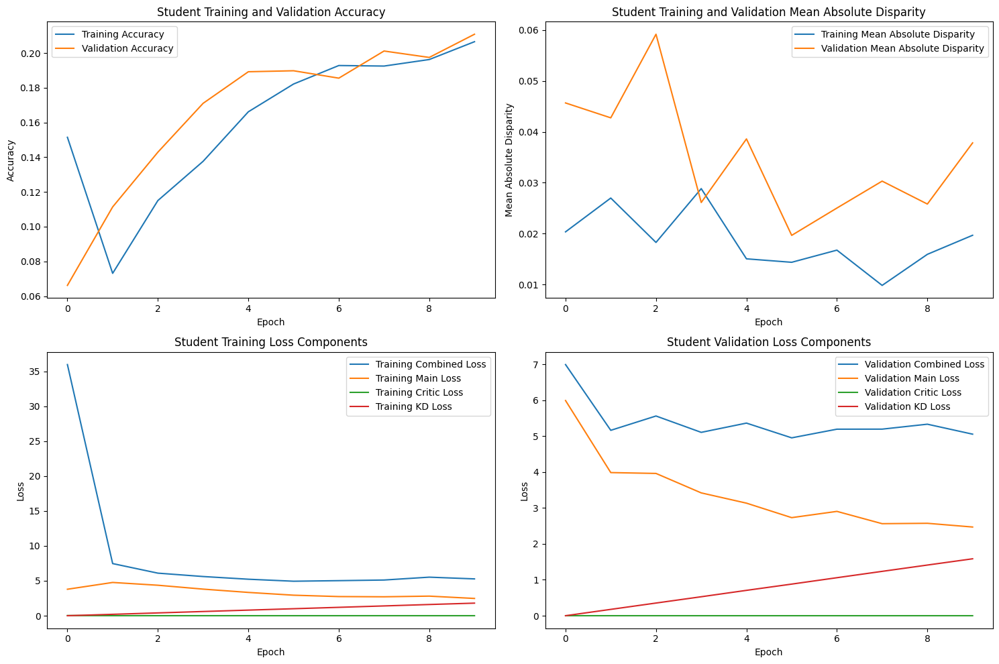

Finished Training STUDENT with lambda value of 150. Best epoch number: 6


In [19]:
# # STUDENT
# Create dict to store best model states
student_model_states_best = {}

# Specify the lambda_factor for the teacher model to load
lambda_factor = 0

# Set extra parameters
momentum = 0.9 # SGD momentum
t=4.0 #temperature
warm_up=20.0 #loss weight warm up epochs
weight_decay = 5e-4 


# Define the path to the saved model file for this lambda_factor
lambda_dir = os.path.join(base_save_dir, f'TEACHER_lambda_{lambda_factor}')
teacher_path = os.path.join(lambda_dir, f'TEACHER_best_model_lambda_{lambda_factor}.pth')

# Initialize the EfficientNet model without pre-trained weights
teacher = models.efficientnet_b3(pretrained=False)

# Adjust the classifier layer to match your number of classes
num_ftrs = teacher.classifier[1].in_features
teacher.classifier[1] = nn.Linear(num_ftrs, num_classes)

# Load the model state
teacher_best_model_state = torch.load(teacher_path)
teacher.load_state_dict(teacher_best_model_state['teacher_state_dict'])


# Loop through the lambda_factor_list
for lambda_factor in student_lambda_factor_list:
    # Load EfficientNet B0 model for Student
    student = models.efficientnet_b0(pretrained=True)
    
    # Determine the number of output features from the feature extractor part of EfficientNet B0
    num_ftrs = student.classifier[1].in_features  # This is the correct number of input features for your adversarial classifier
    
    # Modify the classifier layer of the EfficientNet model to match your number of classes
    student.classifier[1] = nn.Linear(num_ftrs, num_classes)

    # Extract the class embeddings from the teacher
    for param in teacher.parameters():
        param.requires_grad = False

    ## get teacher class mean embeddings    
    with open(f"./class_means/WIDER_embedding_fea/efficientnetb3_lmda_0.json", 'r') as f:
        T_EMB = json.load(f)
    f.close()
    

    # Initialize the Critic model
    critic = Critic(input_size=num_classes)
    critic_optimizer = optim.Adam(critic.parameters(), lr=student_learning_rate, weight_decay=weight_decay)
    critic_scheduler = lr_scheduler.ReduceLROnPlateau(critic_optimizer, mode='min', factor=0.2, patience=5, min_lr=0.0001)
    critic_loss_fn = torch.nn.MSELoss()
    
    student_optimizer = optim.Adam(student.parameters(), lr=student_learning_rate, weight_decay=weight_decay)
    student_scheduler = lr_scheduler.ReduceLROnPlateau(student_optimizer, mode='min', factor=0.2, patience=5, min_lr=0.00001)
    student_loss_fn = nn.CrossEntropyLoss()

    # Train the model
    student_best_model_state = train_student(student, teacher, student_optimizer, student_loss_fn, critic, 
                                             critic_optimizer, critic_loss_fn,
                                             lambda_factor, momentum, t, warm_up, weight_decay, T_EMB, 
                                             num_classes, epsilon, margin, student_patience, student_epochs, 
                                             device, base_save_dir=base_save_dir, 
                                             student_scheduler=student_scheduler, critic_scheduler=critic_scheduler)
    student_model_states_best[lambda_factor] = student_best_model_state

# Save the collective best model states to a file
student_collective_save_path = os.path.join(base_save_dir, 'student_model_states_best.pth')
torch.save(student_model_states_best, student_collective_save_path)

In [20]:
# # load models
# collective_save_path = os.path.join(base_save_dir, 'student_model_states_best.pth')

# # Load the saved model states
# teacher_model_states_best = torch.load(collective_save_path)

# # Example: Accessing the best_val_accuracy for a specific lambda value
# lambda_value = 50
# if lambda_value in teacher_model_states_best:
#     best_model_state = teacher_model_states_best[lambda_value]
#     best_val_accuracy = best_model_state['best_val_accuracy']
#     print(f"Best validation accuracy for lambda {lambda_value}: {best_val_accuracy}")
# else:
#     print(f"No model state found for lambda {lambda_value}")

### PLOTTING

In [21]:
def compare_performance_metrics(teacher, student, dataloader):
    teacher.eval()
    student.eval()
    
    all_labels = []
    all_teacher_preds = []
    all_student_preds = []

    for batch in dataloader:
        inputs = batch['img'].to(device)
        labels = batch['label'].to(device)
        
        with torch.no_grad():
            teacher_outputs = teacher(inputs)
            student_outputs = student(inputs)
            
        teacher_preds = torch.argmax(teacher_outputs, dim=1).cpu().numpy()
        student_preds = torch.argmax(student_outputs, dim=1).cpu().numpy()
        
        all_labels.append(labels.cpu().numpy())
        all_teacher_preds.append(teacher_preds)
        all_student_preds.append(student_preds)

    all_labels = np.concatenate(all_labels)
    all_teacher_preds = np.concatenate(all_teacher_preds)
    all_student_preds = np.concatenate(all_student_preds)
    
    metrics = {
        'accuracy': (accuracy_score(all_labels, all_teacher_preds), accuracy_score(all_labels, all_student_preds)),
        'precision': (precision_score(all_labels, all_teacher_preds, average='weighted', zero_division=0), precision_score(all_labels, all_student_preds, average='weighted', zero_division=0)),
        'recall': (recall_score(all_labels, all_teacher_preds, average='weighted'), recall_score(all_labels, all_student_preds, average='weighted')),
        'f1': (f1_score(all_labels, all_teacher_preds, average='weighted'), f1_score(all_labels, all_student_preds, average='weighted'))
    }

    return {
        'metrics': metrics,
        'all_labels': all_labels,
        'all_teacher_preds': all_teacher_preds,
        'all_student_preds': all_student_preds
    }

def compare_model_size(teacher, student):
    teacher_params = sum(p.numel() for p in teacher.parameters())
    student_params = sum(p.numel() for p in student.parameters())
    return teacher_params, student_params

def compare_inference_time(teacher, student, dataloader):
    dataiter = iter(dataloader)
    data = next(dataiter)
    inputs = data['img']
    inputs = inputs.to(device)

    teacher_time, student_time = 0, 0

    if teacher is not None:
        teacher = teacher.to(device)
        start_time = time.time()
        with torch.no_grad():
            teacher_outputs = teacher(inputs)
        teacher_time = time.time() - start_time

    if student is not None:
        student = student.to(device)
        start_time = time.time()
        with torch.no_grad():
            student_outputs = student(inputs)
        student_time = time.time() - start_time
    
    return teacher_time, student_time

In [22]:
lambda_results = {}

# Loop through each lambda value
for lmda_teacher in teacher_lambda_factor_list:
    for lmda_student in student_lambda_factor_list:

        # Define the path to the saved model file for this lambda_factor
        lambda_dir = os.path.join(base_save_dir, f'TEACHER_lambda_{lmda_teacher}')
        teacher_path = os.path.join(lambda_dir, f'TEACHER_best_model_lambda_{lmda_teacher}.pth')
        
        # Initialize the EfficientNet model without pre-trained weights
        teacher_model = models.efficientnet_b3(pretrained=False)
        
        # Adjust the classifier layer to match the number of classes
        num_ftrs = teacher.classifier[1].in_features
        teacher_model.classifier[1] = nn.Linear(num_ftrs, num_classes)
        
        # Load the model state
        teacher_best_model_state = torch.load(teacher_path)
        teacher_model.load_state_dict(teacher_best_model_state['teacher_state_dict'])
        teacher_model = teacher_model.to(device)
        
        # Define the path to the saved model file for this lambda_factor
        lambda_dir = os.path.join(base_save_dir, f'STUDENT_lambda_{lmda_student}')
        student_path = os.path.join(lambda_dir, f'STUDENT_best_model_lambda_{lmda_student}.pth')
        
        # Initialize the EfficientNet model without pre-trained weights
        student_model = models.efficientnet_b0(pretrained=False)
        
        # Adjust the classifier layer to match the number of classes
        num_ftrs = student_model.classifier[1].in_features
        student_model.classifier[1] = nn.Linear(num_ftrs, num_classes)
        
        # Load the model state
        student_best_model_state = torch.load(student_path)
        student_model.load_state_dict(student_best_model_state['student_state_dict'])
        student_model = student_model.to(device)
        
        # Compute performance metrics
        performance_metrics = compare_performance_metrics(teacher_model, student_model, testloader)
    
        # Compute model sizes
        teacher_params, student_params = compare_model_size(teacher_model, student_model)
    
        # Construct a unique key for the current combination of lambda values
        lambda_key = (lmda_teacher, lmda_student)

        # Update results for the current lambda value
        if lambda_key in lambda_results:
            lambda_results[lambda_key].update({
                'performance_metrics': performance_metrics,
                'teacher_params': teacher_params,
                'student_params': student_params
            })
        else:
            lambda_results[lambda_key] = {
                'performance_metrics': performance_metrics,
                'teacher_params': teacher_params,
                'student_params': student_params
            }

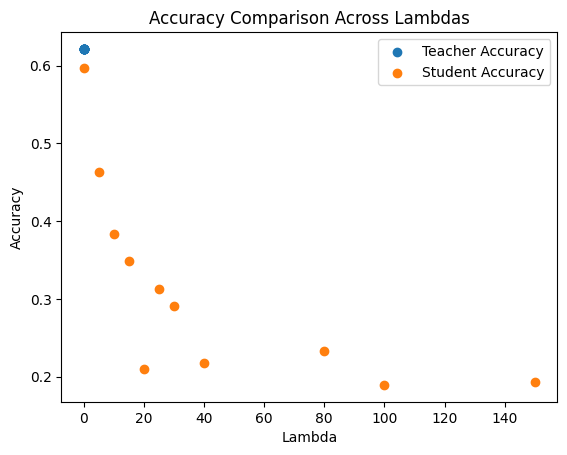

In [23]:
# Initialize lists to store accuracies
teacher_accuracies = []
student_accuracies = []
lambda_pairs = list(lambda_results.keys())

# Iterate over the keys in lambda_results
for key in lambda_pairs:
    # Check if the key is a tuple (indicating a lambda pair)
    if isinstance(key, tuple) and len(key) == 2:
        lmda_teacher, lmda_student = key
    else:
        # If the key is not a tuple, skip this iteration
        continue

    # Access the performance metrics for each pair
    teacher_accuracy = lambda_results[(lmda_teacher, lmda_student)]['performance_metrics']['metrics']['accuracy'][0]
    student_accuracy = lambda_results[(lmda_teacher, lmda_student)]['performance_metrics']['metrics']['accuracy'][1]

    # Append accuracies to the lists
    teacher_accuracies.append((lmda_teacher, teacher_accuracy))
    student_accuracies.append((lmda_student, student_accuracy))

# To plot, you might need to separate the lambda values and accuracies
teacher_lambdas, teacher_acc = zip(*teacher_accuracies)
student_lambdas, student_acc = zip(*student_accuracies)

# Plotting only with markers and no lines
plt.scatter(teacher_lambdas, teacher_acc, label='Teacher Accuracy', marker='o')
plt.scatter(student_lambdas, student_acc, label='Student Accuracy', marker='o')

# Adding labels and title
plt.xlabel('Lambda')
plt.ylabel('Accuracy')
plt.title('Accuracy Comparison Across Lambdas')
plt.legend()

# Show plot
plt.show()

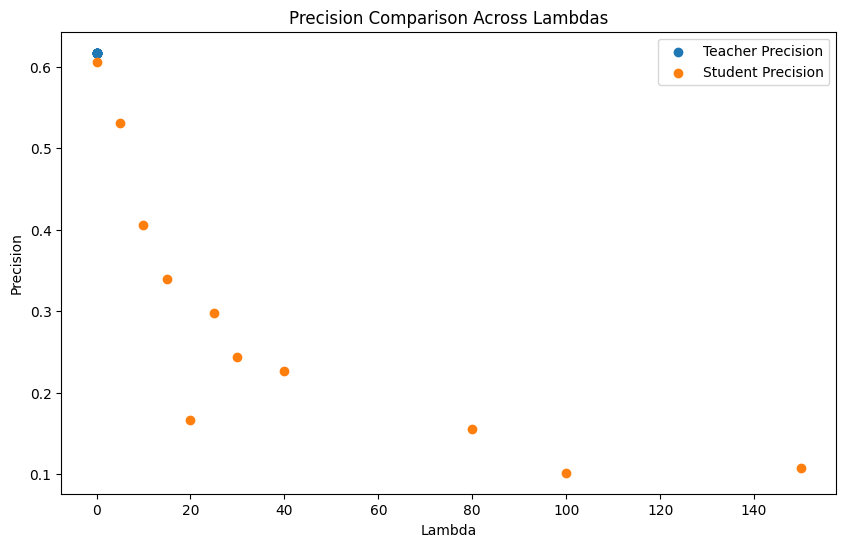

In [24]:
# Initialize lists to store precisions
teacher_precisions = []
student_precisions = []
lambda_pairs = list(lambda_results.keys())

# Iterate over the keys in lambda_results
for key in lambda_pairs:
    # Check if the key is a tuple (indicating a lambda pair)
    if isinstance(key, tuple) and len(key) == 2:
        lmda_teacher, lmda_student = key
        # Access the precision metrics for each pair
        teacher_precision = lambda_results[(lmda_teacher, lmda_student)]['performance_metrics']['metrics']['precision'][0]
        student_precision = lambda_results[(lmda_teacher, lmda_student)]['performance_metrics']['metrics']['precision'][1]
    else:
        # If the key is not a tuple, skip this iteration
        continue

    # Append precisions to the lists along with lambda values
    teacher_precisions.append((lmda_teacher, teacher_precision))
    student_precisions.append((lmda_student, student_precision))

# Extracting lambda values and precisions
teacher_lambdas, teacher_prec = zip(*teacher_precisions)
student_lambdas, student_prec = zip(*student_precisions)

# Creating a scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(teacher_lambdas, teacher_prec, label='Teacher Precision', marker='o')
plt.scatter(student_lambdas, student_prec, label='Student Precision', marker='o')

# Adding labels and title
plt.xlabel('Lambda')
plt.ylabel('Precision')
plt.title('Precision Comparison Across Lambdas')
plt.legend()

# Displaying the plot
plt.show()

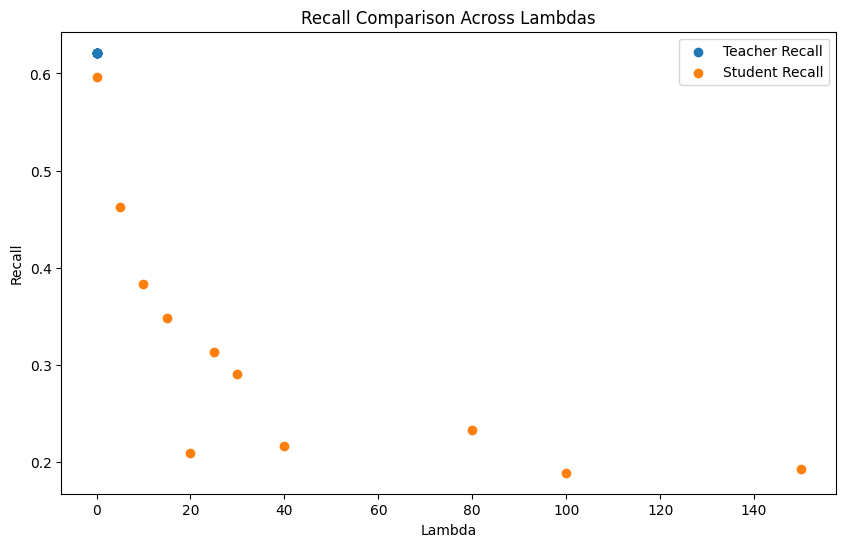

In [25]:
# Initialize lists to store recalls
teacher_recalls = []
student_recalls = []
lambda_pairs = list(lambda_results.keys())

# Iterate over the keys in lambda_results
for key in lambda_pairs:
    # Check if the key is a tuple (indicating a lambda pair)
    if isinstance(key, tuple) and len(key) == 2:
        lmda_teacher, lmda_student = key
        # Access the recall metrics for each pair
        teacher_recall = lambda_results[(lmda_teacher, lmda_student)]['performance_metrics']['metrics']['recall'][0]
        student_recall = lambda_results[(lmda_teacher, lmda_student)]['performance_metrics']['metrics']['recall'][1]
    else:
        # If the key is not a tuple, skip this iteration
        continue

    # Append recalls to the lists along with lambda values
    teacher_recalls.append((lmda_teacher, teacher_recall))
    student_recalls.append((lmda_student, student_recall))

# Extracting lambda values and recalls
teacher_lambdas, teacher_rec = zip(*teacher_recalls)
student_lambdas, student_rec = zip(*student_recalls)

# Creating a scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(teacher_lambdas, teacher_rec, label='Teacher Recall', marker='o')
plt.scatter(student_lambdas, student_rec, label='Student Recall', marker='o')

# Adding labels and title
plt.xlabel('Lambda')
plt.ylabel('Recall')
plt.title('Recall Comparison Across Lambdas')
plt.legend()

# Displaying the plot
plt.show()

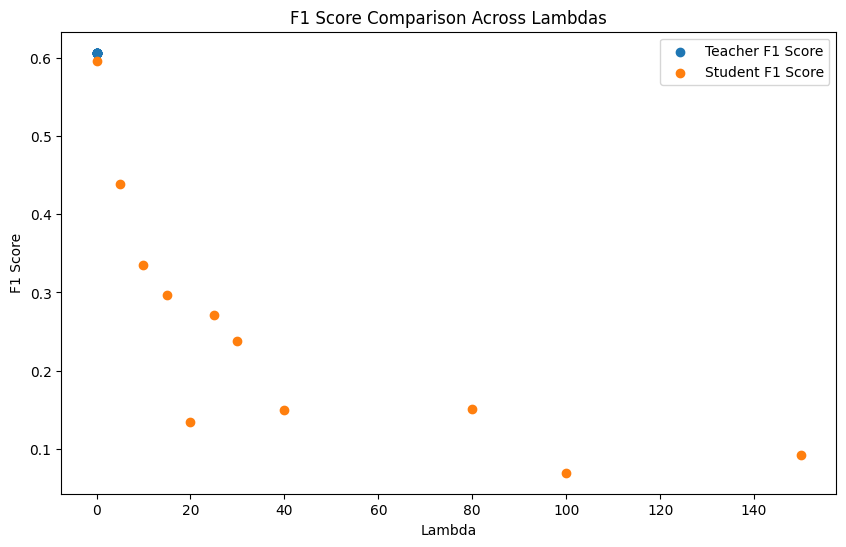

In [26]:
# Initialize lists to store F1 scores
teacher_f1s = []
student_f1s = []
lambda_pairs = list(lambda_results.keys())

# Iterate over the keys in lambda_results
for key in lambda_pairs:
    # Check if the key is a tuple (indicating a lambda pair)
    if isinstance(key, tuple) and len(key) == 2:
        lmda_teacher, lmda_student = key
        # Access the F1 scores for each pair
        teacher_f1 = lambda_results[(lmda_teacher, lmda_student)]['performance_metrics']['metrics']['f1'][0]
        student_f1 = lambda_results[(lmda_teacher, lmda_student)]['performance_metrics']['metrics']['f1'][1]
    else:
        # If the key is not a tuple, skip this iteration
        continue

    # Append F1 scores to the lists along with lambda values
    teacher_f1s.append((lmda_teacher, teacher_f1))
    student_f1s.append((lmda_student, student_f1))

# Extracting lambda values and F1 scores
teacher_lambdas, teacher_f1_scores = zip(*teacher_f1s)
student_lambdas, student_f1_scores = zip(*student_f1s)

# Creating a scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(teacher_lambdas, teacher_f1_scores, label='Teacher F1 Score', marker='o')
plt.scatter(student_lambdas, student_f1_scores, label='Student F1 Score', marker='o')

# Adding labels and title
plt.xlabel('Lambda')
plt.ylabel('F1 Score')
plt.title('F1 Score Comparison Across Lambdas')
plt.legend()

# Displaying the plot
plt.show()

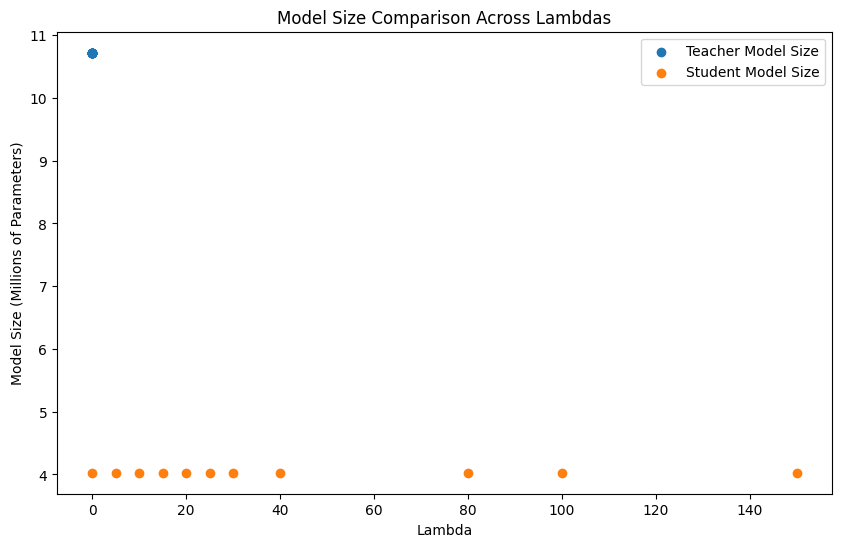

In [27]:
# Initialize lists to store model sizes
teacher_sizes = []
student_sizes = []
lambda_pairs = list(lambda_results.keys())

# Iterate over the keys in lambda_results
for key in lambda_pairs:
    # Check if the key is a tuple (indicating a lambda pair)
    if isinstance(key, tuple) and len(key) == 2:
        lmda_teacher, lmda_student = key
        # Access the model sizes for each pair
        teacher_size = lambda_results[(lmda_teacher, lmda_student)]['teacher_params'] / 1e6  # Convert to millions
        student_size = lambda_results[(lmda_teacher, lmda_student)]['student_params'] / 1e6
    else:
        # If the key is not a tuple, skip this iteration
        continue

    # Append model sizes to the lists along with lambda values
    teacher_sizes.append((lmda_teacher, teacher_size))
    student_sizes.append((lmda_student, student_size))

# Extracting lambda values and model sizes
teacher_lambdas, teacher_model_sizes = zip(*teacher_sizes)
student_lambdas, student_model_sizes = zip(*student_sizes)

# Creating a scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(teacher_lambdas, teacher_model_sizes, label='Teacher Model Size', marker='o')
plt.scatter(student_lambdas, student_model_sizes, label='Student Model Size', marker='o')

# Adding labels and title
plt.xlabel('Lambda')
plt.ylabel('Model Size (Millions of Parameters)')
plt.title('Model Size Comparison Across Lambdas')
plt.legend()

# Displaying the plot
plt.show()

In [28]:
        # Define the path to the saved model file for this lambda_factor
        lambda_dir = os.path.join(base_save_dir, f'TEACHER_lambda_{lmda_teacher}')
        teacher_path = os.path.join(lambda_dir, f'TEACHER_best_model_lambda_{lmda_teacher}.pth')
        
        # Initialize the EfficientNet model without pre-trained weights
        teacher_model = models.efficientnet_b3(pretrained=False)
        
        # Adjust the classifier layer to match the number of classes
        num_ftrs = teacher.classifier[1].in_features
        teacher_model.classifier[1] = nn.Linear(num_ftrs, num_classes)
        
        # Load the model state
        teacher_best_model_state = torch.load(teacher_path)
        teacher_model.load_state_dict(teacher_best_model_state['teacher_state_dict'])
        teacher_model = teacher_model.to(device)
        
        # Define the path to the saved model file for this lambda_factor
        lambda_dir = os.path.join(base_save_dir, f'STUDENT_lambda_{lmda_student}')
        student_path = os.path.join(lambda_dir, f'STUDENT_best_model_lambda_{lmda_student}.pth')
        
        # Initialize the EfficientNet model without pre-trained weights
        student_model = models.efficientnet_b0(pretrained=False)
        
        # Adjust the classifier layer to match the number of classes
        num_ftrs = student_model.classifier[1].in_features
        student_model.classifier[1] = nn.Linear(num_ftrs, num_classes)
        
        # Load the model state
        student_best_model_state = torch.load(student_path)
        student_model.load_state_dict(student_best_model_state['student_state_dict'])
        student_model = student_model.to(device)

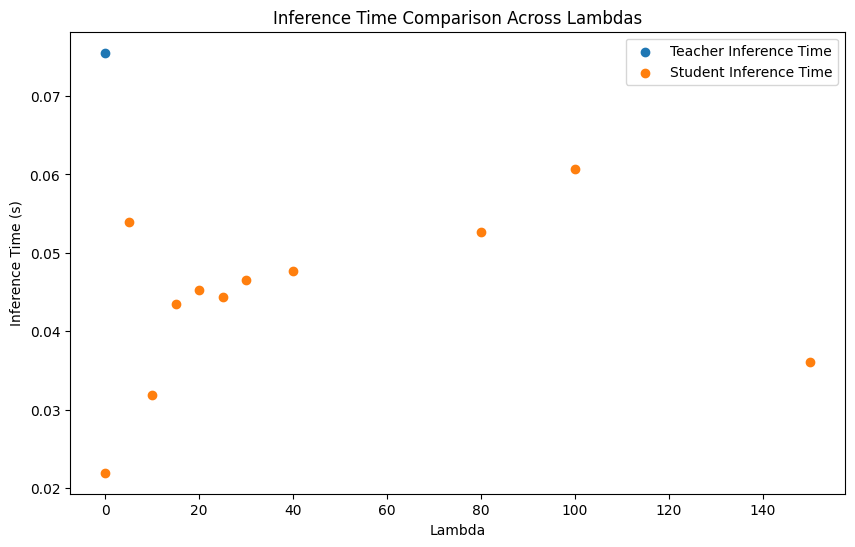

In [29]:
# Initialize dictionaries to store inference times for each lambda value
teacher_times = {}
student_times = {}

# Loop through each lambda value
for lmda_teacher in teacher_lambda_factor_list:
    # Define the path to the saved model file for this lambda_factor
    lambda_dir = os.path.join(base_save_dir, f'TEACHER_lambda_{lmda_teacher}')
    teacher_path = os.path.join(lambda_dir, f'TEACHER_best_model_lambda_{lmda_teacher}.pth')
    
    # Initialize the EfficientNet model without pre-trained weights
    teacher_model = models.efficientnet_b3(pretrained=False)
    
    # Adjust the classifier layer to match the number of classes
    num_ftrs = teacher.classifier[1].in_features
    teacher_model.classifier[1] = nn.Linear(num_ftrs, num_classes)
    
    # Load the model state
    teacher_best_model_state = torch.load(teacher_path)
    teacher_model.load_state_dict(teacher_best_model_state['teacher_state_dict'])
    teacher_model = teacher_model.to(device)

    teacher_time, _ = compare_inference_time(teacher_model, None, testloader)
    teacher_times[lmda_teacher] = teacher_time  # Store the inference time for the teacher model

for lmda_student in student_lambda_factor_list:
    # Define the path to the saved model file for this lambda_factor
    lambda_dir = os.path.join(base_save_dir, f'STUDENT_lambda_{lmda_student}')
    student_path = os.path.join(lambda_dir, f'STUDENT_best_model_lambda_{lmda_student}.pth')
    
    # Initialize the EfficientNet model without pre-trained weights
    student_model = models.efficientnet_b0(pretrained=False)
    
    # Adjust the classifier layer to match the number of classes
    num_ftrs = student_model.classifier[1].in_features
    student_model.classifier[1] = nn.Linear(num_ftrs, num_classes)
    
    # Load the model state
    student_best_model_state = torch.load(student_path)
    student_model.load_state_dict(student_best_model_state['student_state_dict'])
    student_model = student_model.to(device)

    _, student_time = compare_inference_time(None, student_model, testloader)
    student_times[lmda_student] = student_time  # Store the inference time for the student model

# Extracting lambda values and inference times
teacher_lambdas, teacher_inference_times = zip(*teacher_times.items())
student_lambdas, student_inference_times = zip(*student_times.items())

# Creating a scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(teacher_lambdas, teacher_inference_times, label='Teacher Inference Time', marker='o')
plt.scatter(student_lambdas, student_inference_times, label='Student Inference Time', marker='o')

# Adding labels and title
plt.xlabel('Lambda')
plt.ylabel('Inference Time (s)')
plt.title('Inference Time Comparison Across Lambdas')
plt.legend()

# Displaying the plot
plt.show()

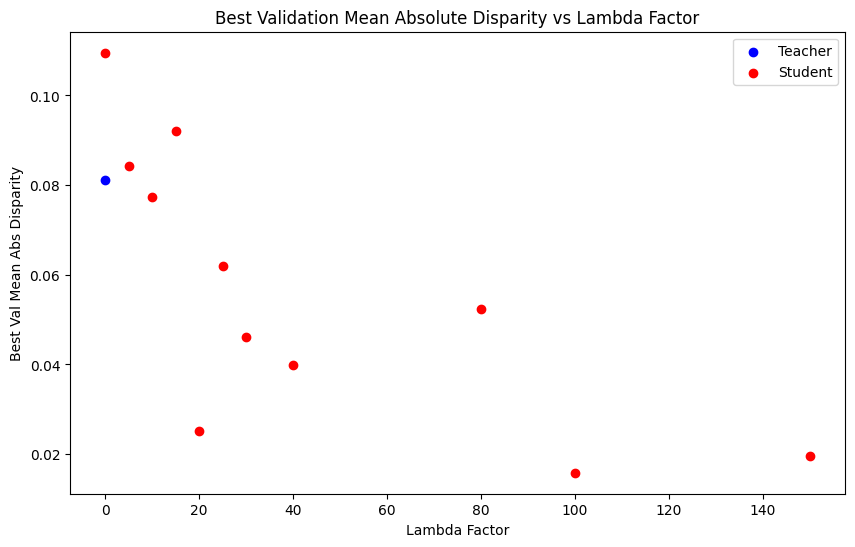

In [30]:
teacher_disparities = []
student_disparities = []

# Loop through each lambda_factor in the teacher_lambda_factor_list and extract the disparity values for the teacher
for lambda_factor in teacher_lambda_factor_list:
    # Load teacher model
    teacher_path = os.path.join(base_save_dir, f'TEACHER_lambda_{lambda_factor}', f'TEACHER_best_model_lambda_{lambda_factor}.pth')
    teacher_best_model_state = torch.load(teacher_path)
    teacher_disparities.append((lambda_factor, teacher_best_model_state['best_val_mean_abs_disparity']))

# Loop through each lambda_factor in the student_lambda_factor_list and extract the disparity values for the student
for lambda_factor in student_lambda_factor_list:
    # Load student model
    student_path = os.path.join(base_save_dir, f'STUDENT_lambda_{lambda_factor}', f'STUDENT_best_model_lambda_{lambda_factor}.pth')
    student_best_model_state = torch.load(student_path)
    student_disparities.append((lambda_factor, student_best_model_state['best_val_mean_abs_disparity']))

# Unpack the lambda factors and disparities for plotting
teacher_lambdas, teacher_disp_values = zip(*teacher_disparities)
student_lambdas, student_disp_values = zip(*student_disparities)

# Plotting
plt.figure(figsize=(10, 6))
plt.scatter(teacher_lambdas, teacher_disp_values, label='Teacher', color='blue')
plt.scatter(student_lambdas, student_disp_values, label='Student', color='red')
plt.xlabel('Lambda Factor')
plt.ylabel('Best Val Mean Abs Disparity')
plt.title('Best Validation Mean Absolute Disparity vs Lambda Factor')
plt.legend()
plt.show()


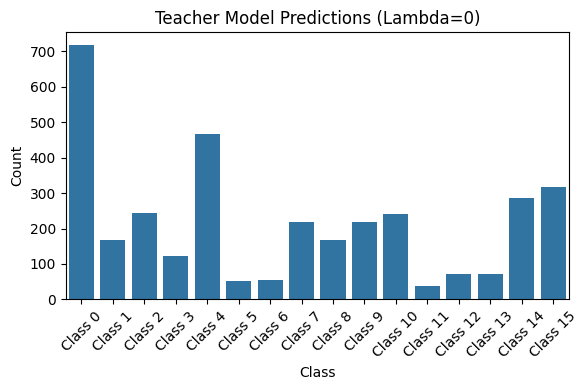

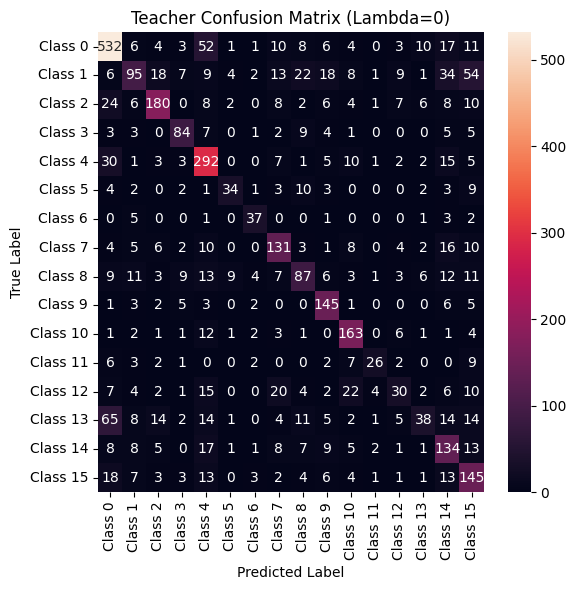

Classification Report - Teacher Model (Lambda=0)
              precision    recall  f1-score   support

     Class 0       0.74      0.80      0.77       668
     Class 1       0.56      0.32      0.40       301
     Class 2       0.74      0.66      0.70       272
     Class 3       0.68      0.68      0.68       124
     Class 4       0.63      0.77      0.69       377
     Class 5       0.64      0.46      0.54        74
     Class 6       0.66      0.74      0.70        50
     Class 7       0.60      0.65      0.62       202
     Class 8       0.51      0.45      0.48       194
     Class 9       0.66      0.84      0.74       173
    Class 10       0.67      0.82      0.74       199
    Class 11       0.68      0.43      0.53        60
    Class 12       0.41      0.23      0.30       129
    Class 13       0.52      0.19      0.28       198
    Class 14       0.47      0.61      0.53       220
    Class 15       0.46      0.65      0.54       224

    accuracy                   

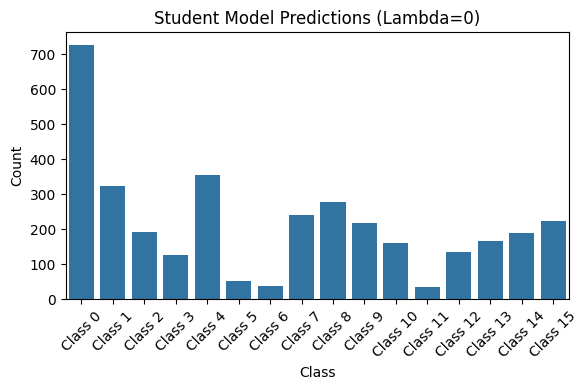

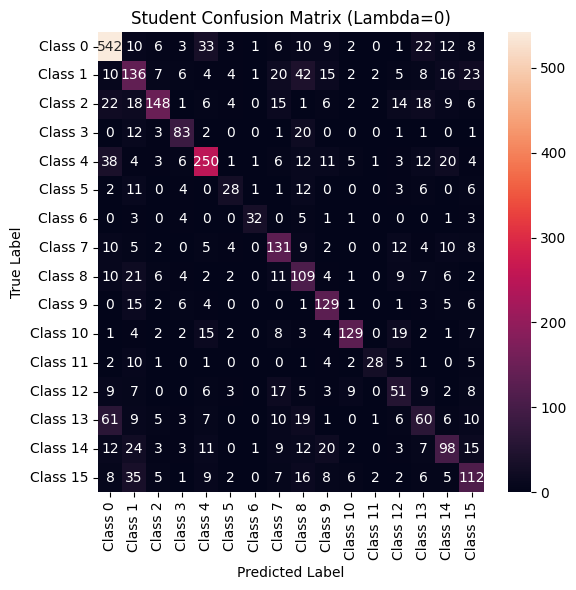

Classification Report - Student Model (Lambda=0)
              precision    recall  f1-score   support

     Class 0       0.75      0.81      0.78       668
     Class 1       0.42      0.45      0.44       301
     Class 2       0.77      0.54      0.64       272
     Class 3       0.66      0.67      0.66       124
     Class 4       0.70      0.66      0.68       377
     Class 5       0.53      0.38      0.44        74
     Class 6       0.86      0.64      0.74        50
     Class 7       0.54      0.65      0.59       202
     Class 8       0.39      0.56      0.46       194
     Class 9       0.59      0.75      0.66       173
    Class 10       0.80      0.65      0.71       199
    Class 11       0.78      0.47      0.58        60
    Class 12       0.38      0.40      0.39       129
    Class 13       0.36      0.30      0.33       198
    Class 14       0.51      0.45      0.48       220
    Class 15       0.50      0.50      0.50       224

    accuracy                   

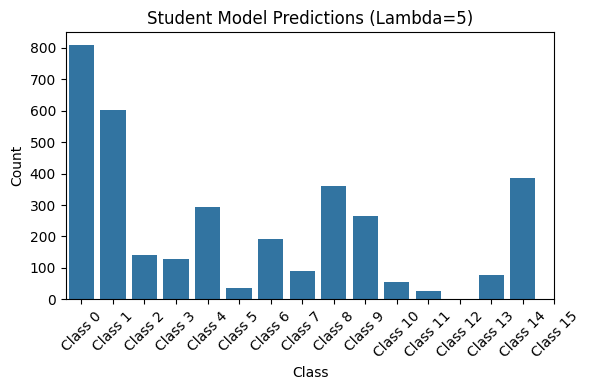

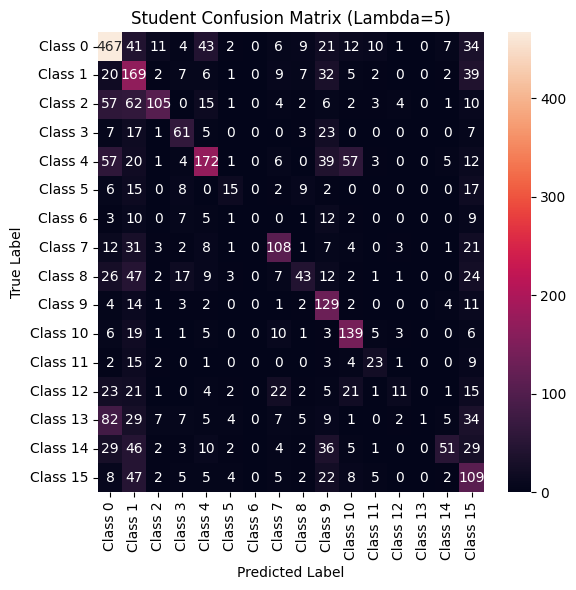

Classification Report - Student Model (Lambda=5)
              precision    recall  f1-score   support

     Class 0       0.58      0.70      0.63       668
     Class 1       0.28      0.56      0.37       301
     Class 2       0.74      0.39      0.51       272
     Class 3       0.47      0.49      0.48       124
     Class 4       0.58      0.46      0.51       377
     Class 5       0.41      0.20      0.27        74
     Class 6       0.00      0.00      0.00        50
     Class 7       0.57      0.53      0.55       202
     Class 8       0.48      0.22      0.30       194
     Class 9       0.36      0.75      0.48       173
    Class 10       0.53      0.70      0.60       199
    Class 11       0.43      0.38      0.40        60
    Class 12       0.42      0.09      0.14       129
    Class 13       1.00      0.01      0.01       198
    Class 14       0.65      0.23      0.34       220
    Class 15       0.28      0.49      0.36       224

    accuracy                   

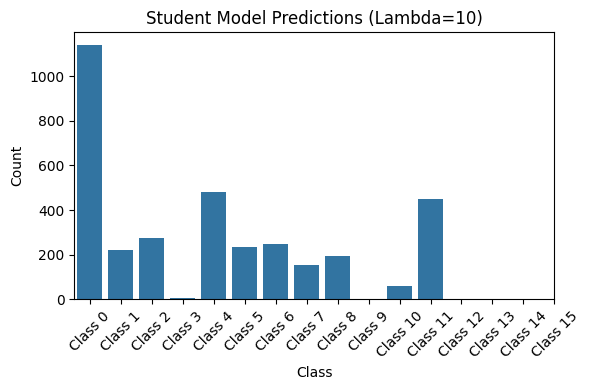

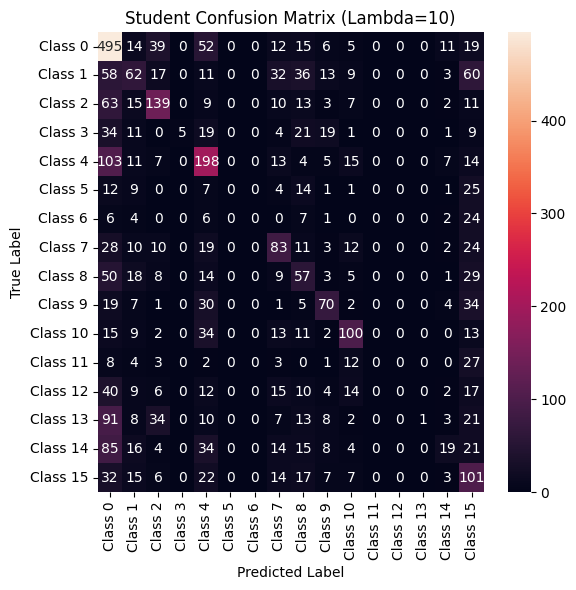

Classification Report - Student Model (Lambda=10)
              precision    recall  f1-score   support

     Class 0       0.43      0.74      0.55       668
     Class 1       0.28      0.21      0.24       301
     Class 2       0.50      0.51      0.51       272
     Class 3       1.00      0.04      0.08       124
     Class 4       0.41      0.53      0.46       377
     Class 5       0.00      0.00      0.00        74
     Class 6       0.00      0.00      0.00        50
     Class 7       0.35      0.41      0.38       202
     Class 8       0.23      0.29      0.26       194
     Class 9       0.45      0.40      0.43       173
    Class 10       0.51      0.50      0.51       199
    Class 11       0.00      0.00      0.00        60
    Class 12       0.00      0.00      0.00       129
    Class 13       1.00      0.01      0.01       198
    Class 14       0.31      0.09      0.14       220
    Class 15       0.22      0.45      0.30       224

    accuracy                  

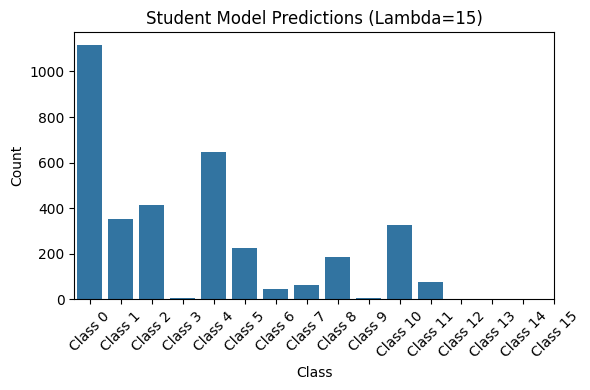

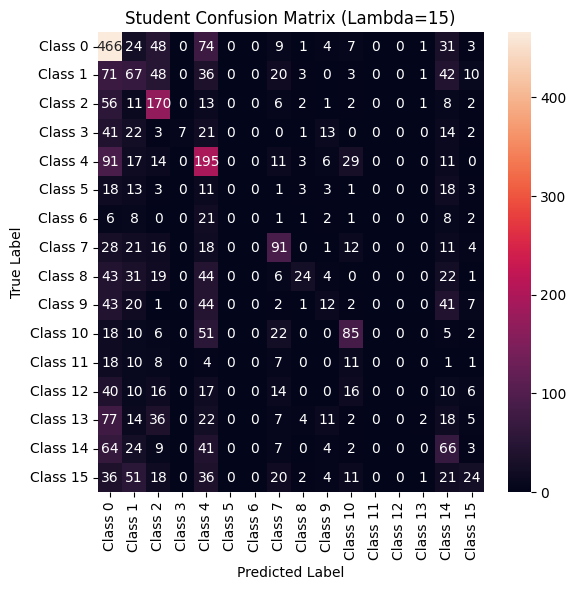

Classification Report - Student Model (Lambda=15)
              precision    recall  f1-score   support

     Class 0       0.42      0.70      0.52       668
     Class 1       0.19      0.22      0.20       301
     Class 2       0.41      0.62      0.49       272
     Class 3       1.00      0.06      0.11       124
     Class 4       0.30      0.52      0.38       377
     Class 5       0.00      0.00      0.00        74
     Class 6       0.00      0.00      0.00        50
     Class 7       0.41      0.45      0.43       202
     Class 8       0.53      0.12      0.20       194
     Class 9       0.18      0.07      0.10       173
    Class 10       0.46      0.43      0.44       199
    Class 11       0.00      0.00      0.00        60
    Class 12       0.00      0.00      0.00       129
    Class 13       0.33      0.01      0.02       198
    Class 14       0.20      0.30      0.24       220
    Class 15       0.32      0.11      0.16       224

    accuracy                  

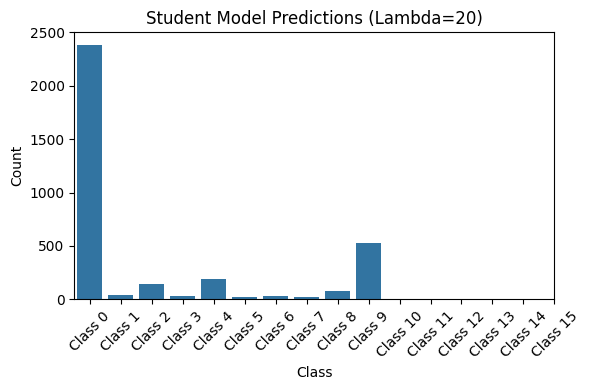

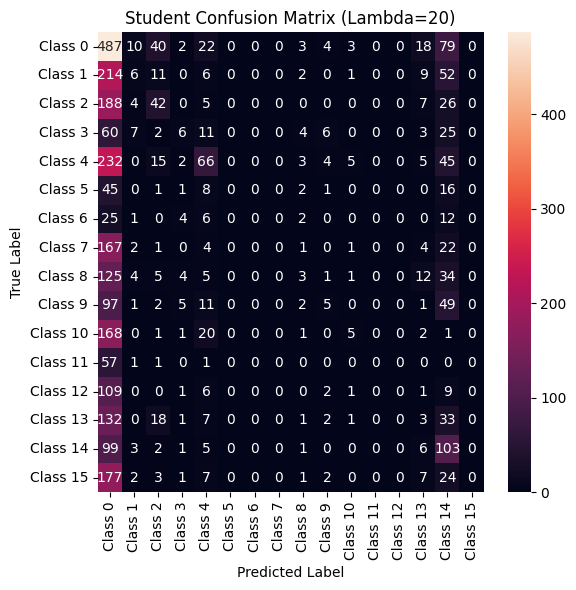

Classification Report - Student Model (Lambda=20)
              precision    recall  f1-score   support

     Class 0       0.20      0.73      0.32       668
     Class 1       0.15      0.02      0.04       301
     Class 2       0.29      0.15      0.20       272
     Class 3       0.21      0.05      0.08       124
     Class 4       0.35      0.18      0.23       377
     Class 5       0.00      0.00      0.00        74
     Class 6       0.00      0.00      0.00        50
     Class 7       0.00      0.00      0.00       202
     Class 8       0.12      0.02      0.03       194
     Class 9       0.19      0.03      0.05       173
    Class 10       0.28      0.03      0.05       199
    Class 11       0.00      0.00      0.00        60
    Class 12       0.00      0.00      0.00       129
    Class 13       0.04      0.02      0.02       198
    Class 14       0.19      0.47      0.27       220
    Class 15       0.00      0.00      0.00       224

    accuracy                  

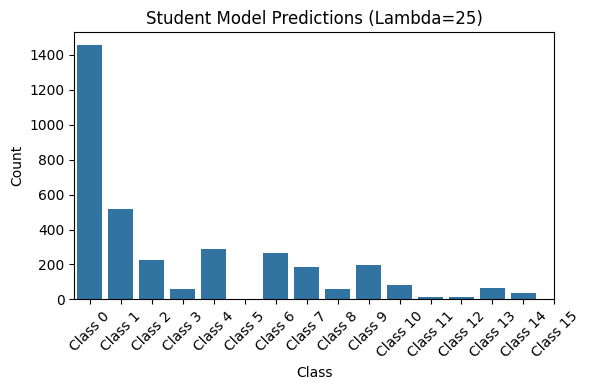

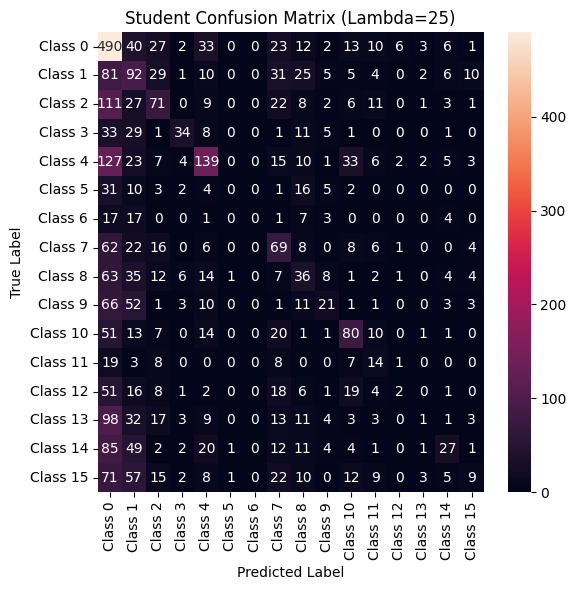

Classification Report - Student Model (Lambda=25)
              precision    recall  f1-score   support

     Class 0       0.34      0.73      0.46       668
     Class 1       0.18      0.31      0.22       301
     Class 2       0.32      0.26      0.29       272
     Class 3       0.57      0.27      0.37       124
     Class 4       0.48      0.37      0.42       377
     Class 5       0.00      0.00      0.00        74
     Class 6       0.00      0.00      0.00        50
     Class 7       0.26      0.34      0.30       202
     Class 8       0.20      0.19      0.19       194
     Class 9       0.34      0.12      0.18       173
    Class 10       0.41      0.40      0.41       199
    Class 11       0.17      0.23      0.20        60
    Class 12       0.15      0.02      0.03       129
    Class 13       0.07      0.01      0.01       198
    Class 14       0.40      0.12      0.19       220
    Class 15       0.23      0.04      0.07       224

    accuracy                  

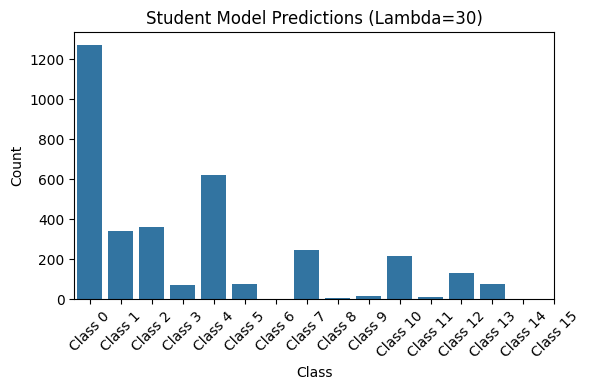

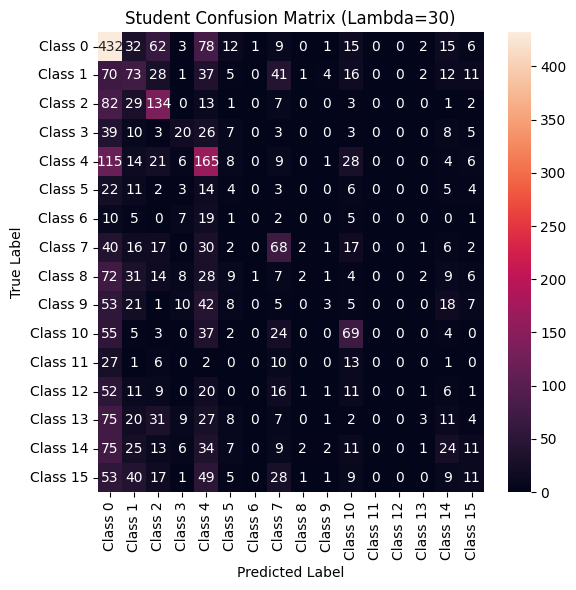

Classification Report - Student Model (Lambda=30)
              precision    recall  f1-score   support

     Class 0       0.34      0.65      0.45       668
     Class 1       0.21      0.24      0.23       301
     Class 2       0.37      0.49      0.42       272
     Class 3       0.27      0.16      0.20       124
     Class 4       0.27      0.44      0.33       377
     Class 5       0.05      0.05      0.05        74
     Class 6       0.00      0.00      0.00        50
     Class 7       0.27      0.34      0.30       202
     Class 8       0.22      0.01      0.02       194
     Class 9       0.19      0.02      0.03       173
    Class 10       0.32      0.35      0.33       199
    Class 11       0.00      0.00      0.00        60
    Class 12       0.00      0.00      0.00       129
    Class 13       0.25      0.02      0.03       198
    Class 14       0.18      0.11      0.14       220
    Class 15       0.14      0.05      0.07       224

    accuracy                  

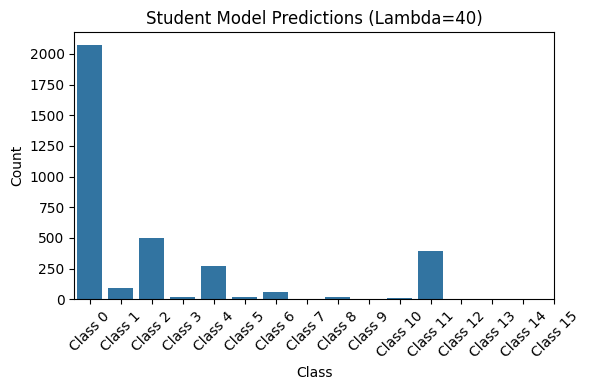

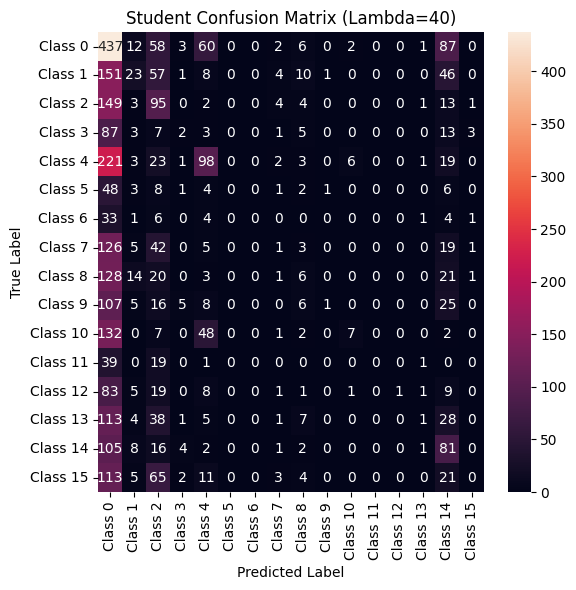

Classification Report - Student Model (Lambda=40)
              precision    recall  f1-score   support

     Class 0       0.21      0.65      0.32       668
     Class 1       0.24      0.08      0.12       301
     Class 2       0.19      0.35      0.25       272
     Class 3       0.10      0.02      0.03       124
     Class 4       0.36      0.26      0.30       377
     Class 5       0.00      0.00      0.00        74
     Class 6       0.00      0.00      0.00        50
     Class 7       0.04      0.00      0.01       202
     Class 8       0.10      0.03      0.05       194
     Class 9       0.33      0.01      0.01       173
    Class 10       0.44      0.04      0.07       199
    Class 11       0.00      0.00      0.00        60
    Class 12       1.00      0.01      0.02       129
    Class 13       0.12      0.01      0.01       198
    Class 14       0.21      0.37      0.26       220
    Class 15       0.00      0.00      0.00       224

    accuracy                  

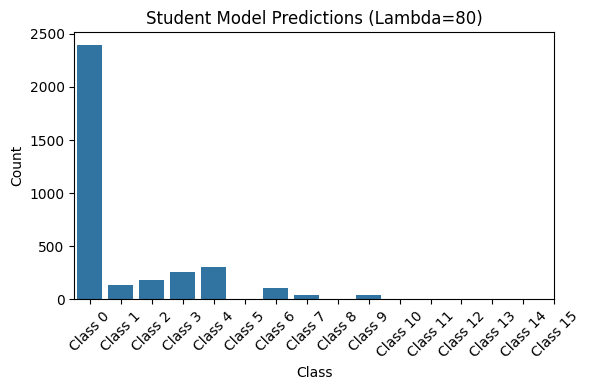

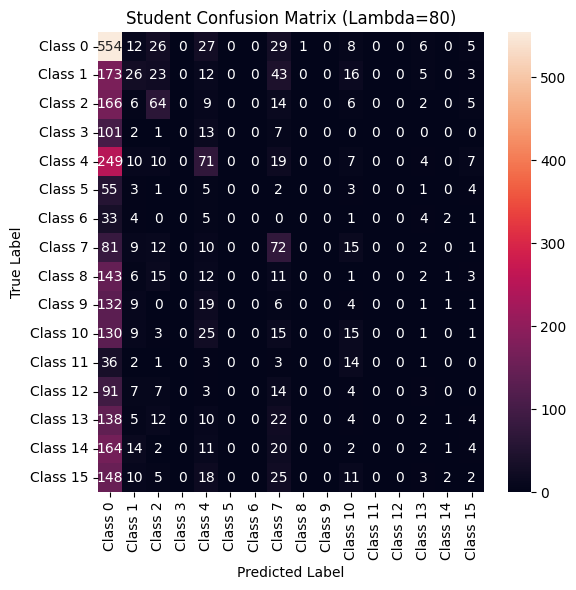

Classification Report - Student Model (Lambda=80)
              precision    recall  f1-score   support

     Class 0       0.23      0.83      0.36       668
     Class 1       0.19      0.09      0.12       301
     Class 2       0.35      0.24      0.28       272
     Class 3       0.00      0.00      0.00       124
     Class 4       0.28      0.19      0.23       377
     Class 5       0.00      0.00      0.00        74
     Class 6       0.00      0.00      0.00        50
     Class 7       0.24      0.36      0.29       202
     Class 8       0.00      0.00      0.00       194
     Class 9       0.00      0.00      0.00       173
    Class 10       0.14      0.08      0.10       199
    Class 11       0.00      0.00      0.00        60
    Class 12       0.00      0.00      0.00       129
    Class 13       0.05      0.01      0.02       198
    Class 14       0.12      0.00      0.01       220
    Class 15       0.05      0.01      0.02       224

    accuracy                  

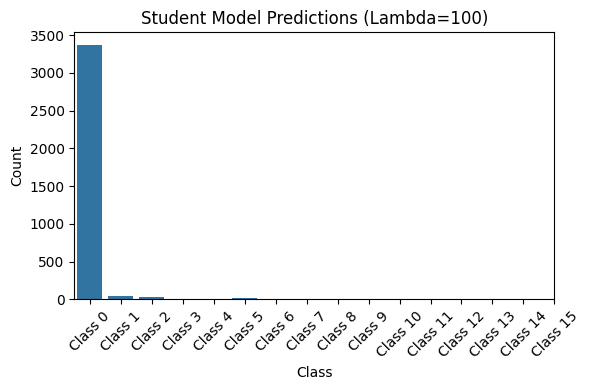

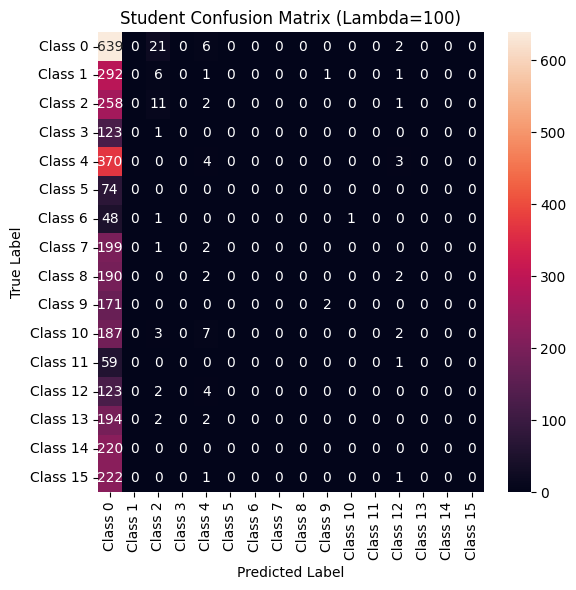

Classification Report - Student Model (Lambda=100)
              precision    recall  f1-score   support

     Class 0       0.19      0.96      0.32       668
     Class 1       0.00      0.00      0.00       301
     Class 2       0.23      0.04      0.07       272
     Class 3       0.00      0.00      0.00       124
     Class 4       0.13      0.01      0.02       377
     Class 5       0.00      0.00      0.00        74
     Class 6       0.00      0.00      0.00        50
     Class 7       0.00      0.00      0.00       202
     Class 8       0.00      0.00      0.00       194
     Class 9       0.67      0.01      0.02       173
    Class 10       0.00      0.00      0.00       199
    Class 11       0.00      0.00      0.00        60
    Class 12       0.00      0.00      0.00       129
    Class 13       0.00      0.00      0.00       198
    Class 14       0.00      0.00      0.00       220
    Class 15       0.00      0.00      0.00       224

    accuracy                 

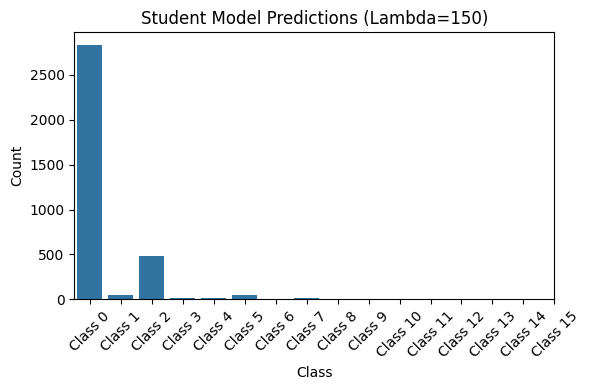

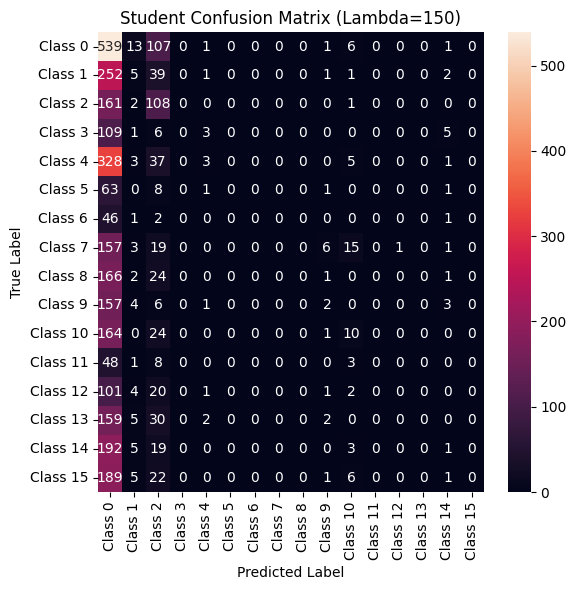

Classification Report - Student Model (Lambda=150)
              precision    recall  f1-score   support

     Class 0       0.19      0.81      0.31       668
     Class 1       0.09      0.02      0.03       301
     Class 2       0.23      0.40      0.29       272
     Class 3       0.00      0.00      0.00       124
     Class 4       0.23      0.01      0.02       377
     Class 5       0.00      0.00      0.00        74
     Class 6       0.00      0.00      0.00        50
     Class 7       0.00      0.00      0.00       202
     Class 8       0.00      0.00      0.00       194
     Class 9       0.12      0.01      0.02       173
    Class 10       0.19      0.05      0.08       199
    Class 11       0.00      0.00      0.00        60
    Class 12       0.00      0.00      0.00       129
    Class 13       0.00      0.00      0.00       198
    Class 14       0.06      0.00      0.01       220
    Class 15       0.00      0.00      0.00       224

    accuracy                 

In [31]:
def plot_distribution(predictions, class_names, title):
    plt.figure(figsize=(6, 4))
    sns.countplot(x=predictions)
    plt.title(title)
    plt.xlabel('Class')
    plt.ylabel('Count')
    plt.xticks(range(len(class_names)), class_names, rotation=45)
    plt.tight_layout()
    plt.show()

def plot_confusion_matrix(all_labels, predictions, class_names, title):
    cm = confusion_matrix(all_labels, predictions)
    plt.figure(figsize=(6, 6))
    sns.heatmap(pd.DataFrame(cm, index=class_names, columns=class_names), annot=True, fmt='g')
    plt.title(title)
    plt.ylabel('True Label')
    plt.xlabel('Predicted Label')
    plt.tight_layout()
    plt.show()

# Function to generate predictions and compute metrics
def generate_predictions_and_metrics(model, dataloader):
    model.eval()
    all_labels = []
    all_preds = []

    with torch.no_grad():
        for batch in dataloader:
            inputs = batch['img'].to(device)
            labels = batch['label'].to(device)
            
            outputs = model(inputs)
            preds = torch.argmax(outputs, dim=1).cpu().numpy()
            
            all_labels.append(labels.cpu().numpy())
            all_preds.append(preds)

    all_labels = np.concatenate(all_labels)
    all_preds = np.concatenate(all_preds)

    return all_labels, all_preds

# Loop over each lambda value for the teacher model
for lmda_teacher in teacher_lambda_factor_list:
    # Define the path to the saved model file for this lambda_factor
    lambda_dir = os.path.join(base_save_dir, f'TEACHER_lambda_{lmda_teacher}')
    teacher_path = os.path.join(lambda_dir, f'TEACHER_best_model_lambda_{lmda_teacher}.pth')
    
    # Initialize the EfficientNet model without pre-trained weights
    teacher_model = models.efficientnet_b3(pretrained=False)
    
    # Adjust the classifier layer to match the number of classes
    num_ftrs = teacher.classifier[1].in_features
    teacher_model.classifier[1] = nn.Linear(num_ftrs, num_classes)
    
    # Load the model state
    teacher_best_model_state = torch.load(teacher_path)
    teacher_model.load_state_dict(teacher_best_model_state['teacher_state_dict'])
    teacher_model = teacher_model.to(device)
    
    # Generate predictions for the teacher model
    all_labels, all_teacher_preds = generate_predictions_and_metrics(teacher_model, testloader)

    # Plot distribution and confusion matrix for the teacher model
    plot_distribution(all_teacher_preds, class_names_new, f'Teacher Model Predictions (Lambda={lmda_teacher})')
    plot_confusion_matrix(all_labels, all_teacher_preds, class_names_new, f'Teacher Confusion Matrix (Lambda={lmda_teacher})')

    # Print classification report for the teacher model
    teacher_report = classification_report(all_labels, all_teacher_preds, target_names=class_names_new, zero_division=0)
    print(f'Classification Report - Teacher Model (Lambda={lmda_teacher})')
    print(teacher_report)

# Loop over each lambda value for the student model
for lmda_student in student_lambda_factor_list:
    # Define the path to the saved model file for this lambda_factor
    lambda_dir = os.path.join(base_save_dir, f'STUDENT_lambda_{lmda_student}')
    student_path = os.path.join(lambda_dir, f'STUDENT_best_model_lambda_{lmda_student}.pth')
    
    # Initialize the EfficientNet model without pre-trained weights
    student_model = models.efficientnet_b0(pretrained=False)
    
    # Adjust the classifier layer to match the number of classes
    num_ftrs = student_model.classifier[1].in_features
    student_model.classifier[1] = nn.Linear(num_ftrs, num_classes)
    
    # Load the model state
    student_best_model_state = torch.load(student_path)
    student_model.load_state_dict(student_best_model_state['student_state_dict'])
    student_model = student_model.to(device)

    # Generate predictions for the student model
    all_labels, all_student_preds = generate_predictions_and_metrics(student_model, testloader)

    # Plot distribution and confusion matrix for the student model
    plot_distribution(all_student_preds, class_names_new, f'Student Model Predictions (Lambda={lmda_student})')
    plot_confusion_matrix(all_labels, all_student_preds, class_names_new, f'Student Confusion Matrix (Lambda={lmda_student})')

    # Print classification report for the student model
    student_report = classification_report(all_labels, all_student_preds, target_names=class_names_new, zero_division=0)
    print(f'Classification Report - Student Model (Lambda={lmda_student})')
    print(student_report)

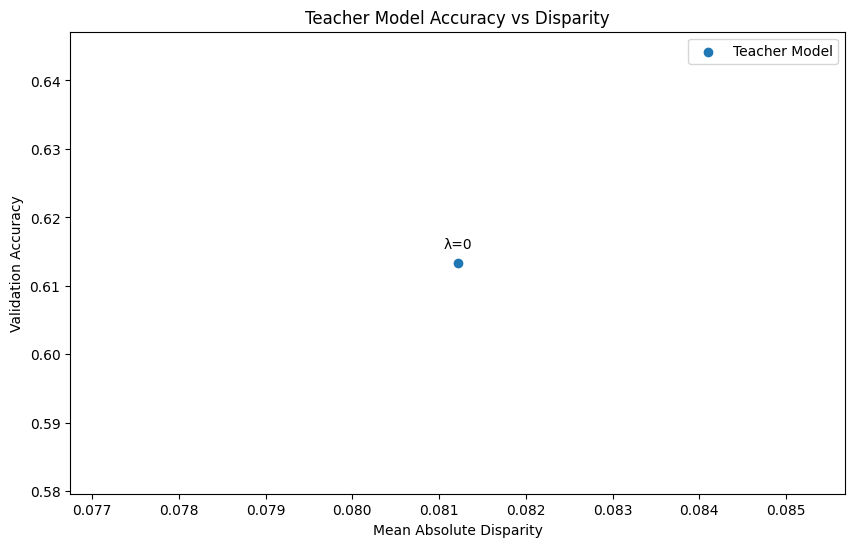

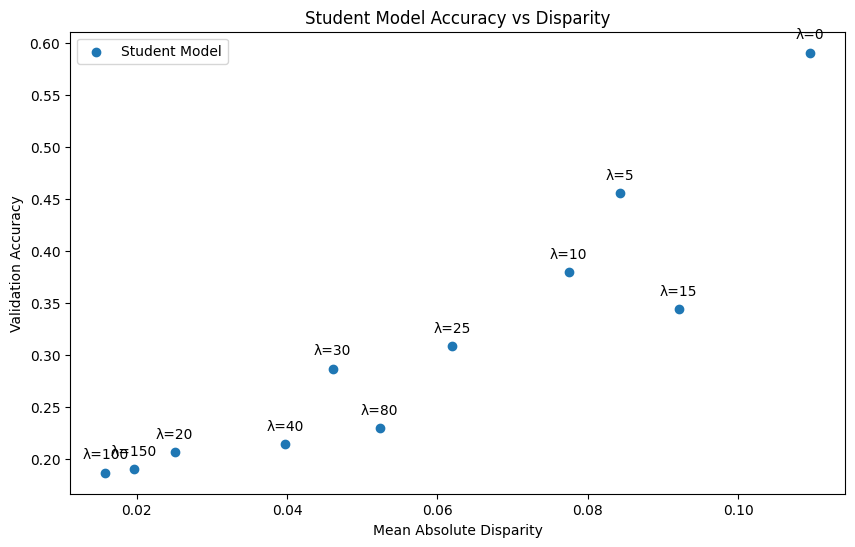

In [32]:
def plot_bias_variance_tradeoff(base_save_dir, model_type, lambda_list):
    bias_values = []
    accuracy_values = []

    for lambda_factor in lambda_list:
        model_path = os.path.join(base_save_dir, f'{model_type.upper()}_lambda_{lambda_factor}', f'{model_type.upper()}_best_model_lambda_{lambda_factor}.pth')
        if os.path.exists(model_path):
            model_state = torch.load(model_path)

            disparity = model_state['best_val_mean_abs_disparity']
            accuracy = model_state['best_val_accuracy']
            bias_values.append(disparity)
            accuracy_values.append(accuracy)

    # Plotting
    plt.figure(figsize=(10, 6))
    plt.scatter(bias_values, accuracy_values, label=f'{model_type.title()} Model')
    plt.xlabel('Mean Absolute Disparity')
    plt.ylabel('Validation Accuracy')
    plt.title(f'{model_type.title()} Model Accuracy vs Disparity')
    for i, lambda_factor in enumerate(lambda_list):
        plt.annotate(f'λ={lambda_factor}', (bias_values[i], accuracy_values[i]), textcoords="offset points", xytext=(0,10), ha='center')
    plt.legend()
    plt.show()

# Plot for Teacher
plot_bias_variance_tradeoff(base_save_dir, 'teacher', teacher_lambda_factor_list)

# Plot for Student
plot_bias_variance_tradeoff(base_save_dir, 'student', student_lambda_factor_list)

In [33]:
def compare_performance_metrics_for_demo(teacher, student, dataloader):
    teacher.eval()
    student.eval()

    detailed_info = []

    for batch in dataloader:
        inputs = batch['img'].to(device)
        labels = batch['label'].to(device)
        # Assuming gender or other attributes are part of 'target'
        attributes = batch['target'].to(device)  

        with torch.no_grad():
            teacher_outputs = teacher(inputs)
            student_outputs = student(inputs)

        teacher_preds = torch.argmax(teacher_outputs, dim=1)
        student_preds = torch.argmax(student_outputs, dim=1)

        for i in range(inputs.size(0)):
            if teacher_preds[i] != labels[i] and student_preds[i] == labels[i]:
                info = {
                    'image': inputs[i],
                    'actual_class': labels[i].item(),
                    'teacher_pred_class': teacher_preds[i].item(),
                    'student_pred_class': student_preds[i].item(),
                    'actual_attribute': attributes[i].item()
                }
                detailed_info.append(info)

    return detailed_info

In [34]:
def plot_images_with_class_filter(info_list, display_class, new_label_mapping, rows=10, cols=5):
    # Filter the info list based on the specified class, student correct and teacher incorrect predictions
    filtered_info = [info for info in info_list if info['actual_class'] == display_class and 
                     info['student_pred_class'] == display_class and 
                     info['teacher_pred_class'] != display_class]

    # Calculate the number of images to display based on the length of the filtered list
    num_images = len(filtered_info)
    if num_images == 0:
        print(f"No images to display for class {display_class}.")
        return  # Skip this class as there are no images to display

    total_plots = min(rows * cols, num_images)  # Ensure we don't exceed the number of filtered images

    # Determine the number of rows needed based on the number of images
    rows = (total_plots + cols - 1) // cols

    # Create a figure with the adjusted number of rows and columns
    fig, axes = plt.subplots(rows, cols, figsize=(15, 3 * rows))
    axes = axes.ravel()

    for i in range(total_plots):
        data = filtered_info[i]
        image = data['image']
        actual_class = new_label_mapping[data['actual_class']]  # Get class name from the mapping
        teacher_pred_class = new_label_mapping[data['teacher_pred_class']]  # Get class name from the mapping
        student_pred_class = new_label_mapping[data['student_pred_class']]  # Get class name from the mapping
        actual_attribute = round(data['actual_attribute'], 3)
    
        # Normalize the image for display
        image_display = image.cpu().numpy().transpose(1, 2, 0)
        image_display = (image_display - image_display.min()) / (image_display.max() - image_display.min())
    
        # Set the title with the class and attribute information
        title = f'Attr: {actual_attribute}\nTrue: {actual_class}\nTeacher: {teacher_pred_class}\nStudent: {student_pred_class}'
    
        axes[i].imshow(image_display)
        axes[i].set_title(title, fontsize=12, pad=4)
        axes[i].axis('off')

    # Turn off any unused axes
    for i in range(total_plots, len(axes)):
        axes[i].axis('off')

    # Adjust layout for clarity
    plt.tight_layout()
    plt.subplots_adjust(wspace=0.5, hspace=0.6)
    plt.show()


CLASS 0: Team_Sports


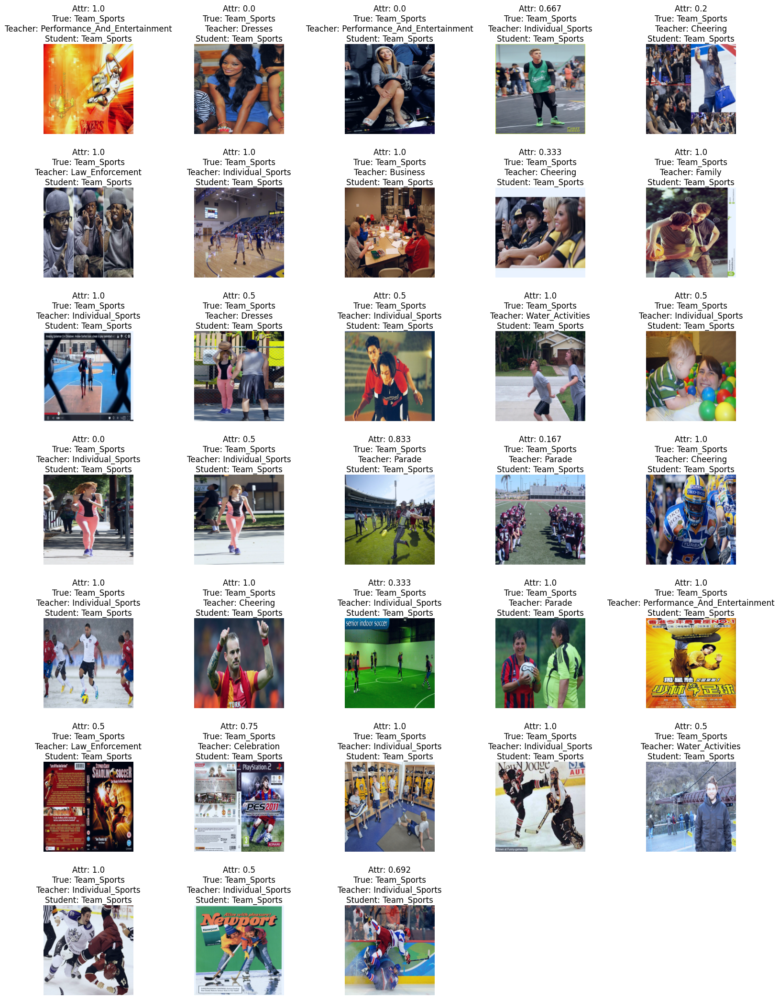

CLASS 1: Celebration


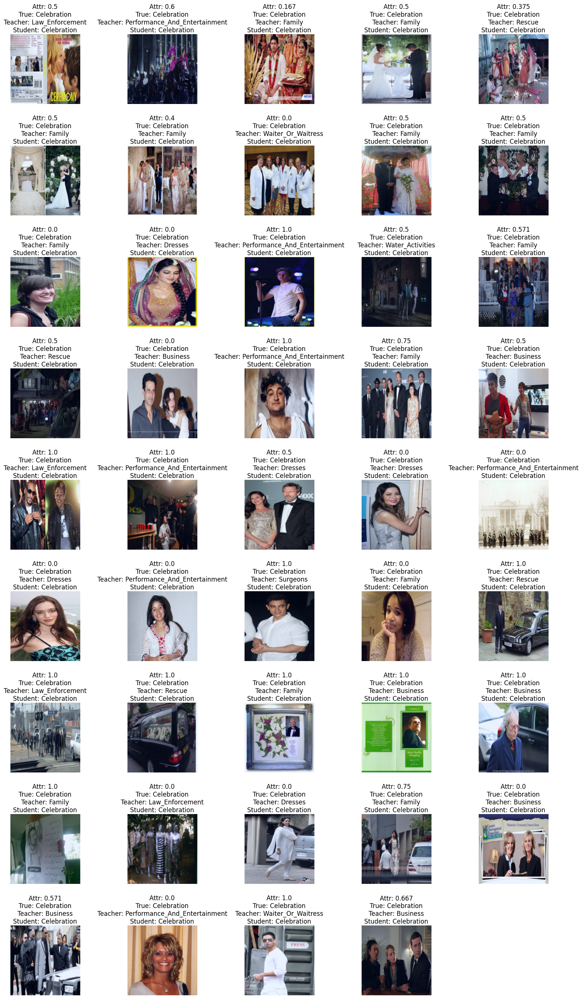

CLASS 2: Parade


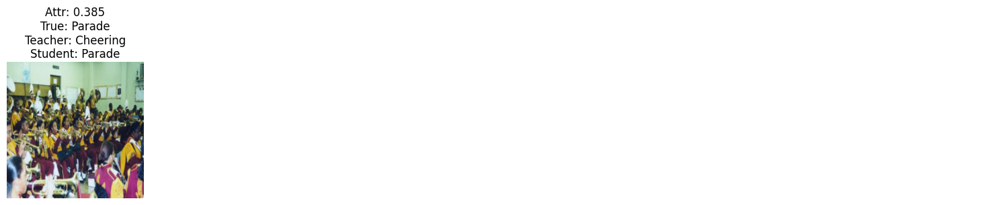

CLASS 3: Waiter_Or_Waitress
No images to display for class 3.
CLASS 4: Individual_Sports


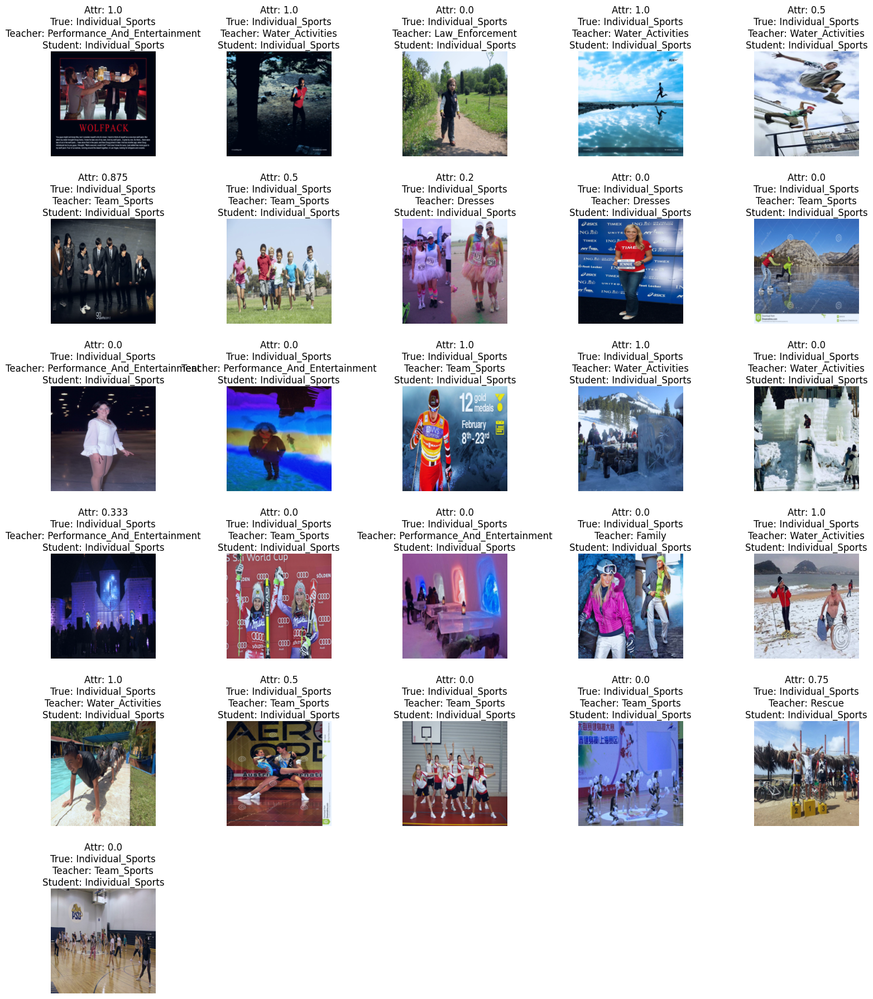

CLASS 5: Surgeons
No images to display for class 5.
CLASS 6: Spa
No images to display for class 6.
CLASS 7: Law_Enforcement
No images to display for class 7.
CLASS 8: Business
No images to display for class 8.
CLASS 9: Dresses


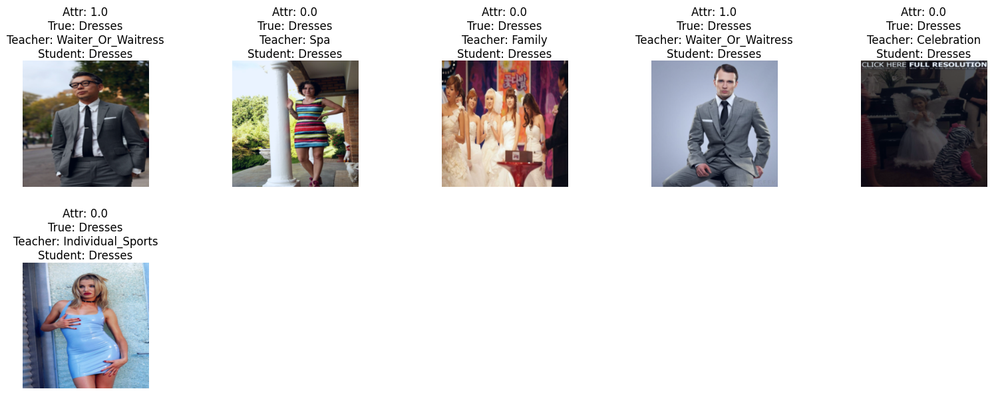

CLASS 10: Water_Activities
No images to display for class 10.
CLASS 11: Picnic
No images to display for class 11.
CLASS 12: Rescue
No images to display for class 12.
CLASS 13: Cheering


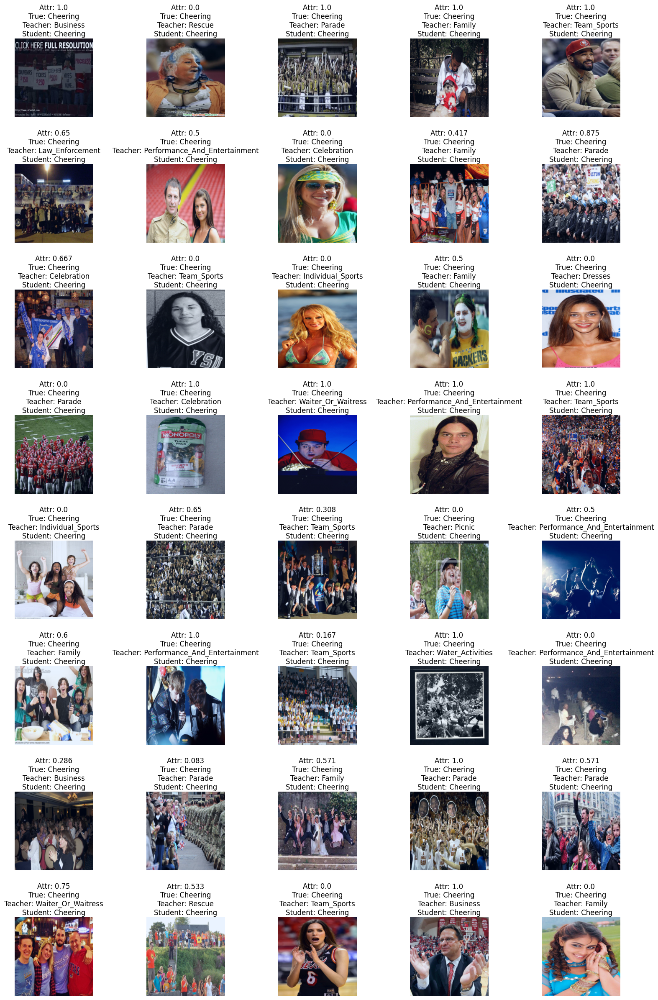

CLASS 14: Performance_And_Entertainment
No images to display for class 14.
CLASS 15: Family


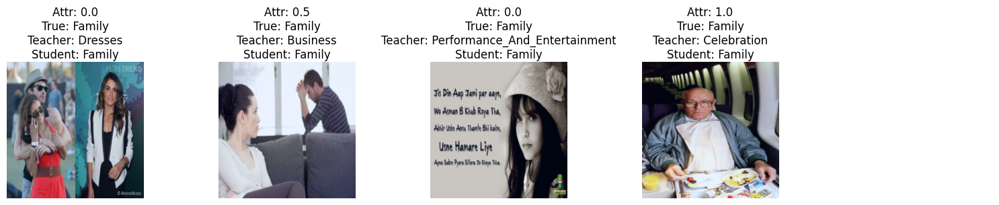

In [35]:
# Load the Teacher Model for a specific lambda value
def load_teacher_model(lambda_factor):
    lambda_dir = os.path.join(base_save_dir, f'TEACHER_lambda_{lambda_factor}')
    teacher_path = os.path.join(lambda_dir, f'TEACHER_best_model_lambda_{lambda_factor}.pth')

    teacher_model = models.efficientnet_b3(pretrained=False)
    num_ftrs = teacher_model.classifier[1].in_features
    teacher_model.classifier[1] = torch.nn.Linear(num_ftrs, num_classes)

    teacher_best_model_state = torch.load(teacher_path)
    teacher_model.load_state_dict(teacher_best_model_state['teacher_state_dict'])
    teacher_model = teacher_model.to(device)
    return teacher_model

# Load the Student Model for a specific lambda value
def load_student_model(lambda_factor):
    lambda_dir = os.path.join(base_save_dir, f'STUDENT_lambda_{lambda_factor}')
    student_path = os.path.join(lambda_dir, f'STUDENT_best_model_lambda_{lambda_factor}.pth')

    student_model = models.efficientnet_b0(pretrained=False)
    num_ftrs = student_model.classifier[1].in_features
    student_model.classifier[1] = torch.nn.Linear(num_ftrs, num_classes)

    student_best_model_state = torch.load(student_path)
    student_model.load_state_dict(student_best_model_state['student_state_dict'])
    student_model = student_model.to(device)
    return student_model

# Load models for a specific lambda value
teacher_lambda_factor = 0 
student_lambda_factor = 50

teacher_model = load_teacher_model(teacher_lambda_factor)
student_model = load_student_model(student_lambda_factor)

# Assuming 'testloader', 'new_label_mapping', and 'num_classes' are defined
# Get detailed info where student is correct and teacher is wrong
detailed_info = compare_performance_metrics_for_demo(teacher_model, student_model, testloader)

# Plot images
for i in range(num_classes):
    print('='*60)
    print(f'CLASS {i}: {new_label_mapping[i]}')
    print('='*60)
    plot_images_with_class_filter(detailed_info, display_class=i, new_label_mapping=new_label_mapping, rows=100, cols=5)


In [36]:
def compare_performance_metrics(teacher, student, dataloader):
    teacher.eval()
    student.eval()
    
    all_labels = []
    all_teacher_preds = []
    all_student_preds = []

    for batch in dataloader:
        inputs = batch['img'].to(device)
        labels = batch['label'].to(device)
        
        with torch.no_grad():
            teacher_outputs = teacher(inputs)
            student_outputs = student(inputs)
            
        teacher_preds = torch.argmax(teacher_outputs, dim=1).cpu().numpy()
        student_preds = torch.argmax(student_outputs, dim=1).cpu().numpy()
        
        all_labels.append(labels.cpu().numpy())
        all_teacher_preds.append(teacher_preds)
        all_student_preds.append(student_preds)

    all_labels = np.concatenate(all_labels)
    all_teacher_preds = np.concatenate(all_teacher_preds)
    all_student_preds = np.concatenate(all_student_preds)
    
    metrics = {
        'accuracy': (accuracy_score(all_labels, all_teacher_preds), accuracy_score(all_labels, all_student_preds)),
        'precision': (precision_score(all_labels, all_teacher_preds, average='weighted', zero_division=0), precision_score(all_labels, all_student_preds, average='weighted', zero_division=0)),
        'recall': (recall_score(all_labels, all_teacher_preds, average='weighted'), recall_score(all_labels, all_student_preds, average='weighted')),
        'f1': (f1_score(all_labels, all_teacher_preds, average='weighted'), f1_score(all_labels, all_student_preds, average='weighted'))
    }

    return {
        'metrics': metrics,
        'all_labels': all_labels,
        'all_teacher_preds': all_teacher_preds,
        'all_student_preds': all_student_preds
    }

def compare_model_size(teacher, student):
    teacher_params = sum(p.numel() for p in teacher.parameters())
    student_params = sum(p.numel() for p in student.parameters())
    return teacher_params, student_params

def compare_inference_time(teacher, student, dataloader):
    dataiter = iter(dataloader)
    data = next(dataiter)
    inputs = data['img']
    inputs = inputs.to(device)

    teacher_time, student_time = 0, 0

    if teacher is not None:
        teacher = teacher.to(device)
        start_time = time.time()
        with torch.no_grad():
            teacher_outputs = teacher(inputs)
        teacher_time = time.time() - start_time

    if student is not None:
        student = student.to(device)
        start_time = time.time()
        with torch.no_grad():
            student_outputs = student(inputs)
        student_time = time.time() - start_time
    
    return teacher_time, student_time

In [37]:
lambda_results = {}

# Loop through each lambda value
for lmda_teacher in teacher_lambda_factor_list:
    for lmda_student in student_lambda_factor_list:

        # Define the path to the saved model file for this lambda_factor
        lambda_dir = os.path.join(base_save_dir, f'TEACHER_lambda_{lmda_teacher}')
        teacher_path = os.path.join(lambda_dir, f'TEACHER_best_model_lambda_{lmda_teacher}.pth')
        
        # Initialize the EfficientNet model without pre-trained weights
        teacher_model = models.efficientnet_b3(pretrained=False)
        
        # Adjust the classifier layer to match your number of classes
        num_ftrs = teacher.classifier[1].in_features
        teacher_model.classifier[1] = nn.Linear(num_ftrs, num_classes)
        
        # Load the model state
        teacher_best_model_state = torch.load(teacher_path)
        teacher_model.load_state_dict(teacher_best_model_state['teacher_state_dict'])
        teacher_model = teacher_model.to(device)
        
        # Define the path to the saved model file for this lambda_factor
        lambda_dir = os.path.join(base_save_dir, f'STUDENT_lambda_{lmda_student}')
        student_path = os.path.join(lambda_dir, f'STUDENT_best_model_lambda_{lmda_student}.pth')
        
        # Initialize the EfficientNet model without pre-trained weights
        student_model = models.efficientnet_b0(pretrained=False)
        
        # Adjust the classifier layer to match your number of classes
        num_ftrs = student_model.classifier[1].in_features
        student_model.classifier[1] = nn.Linear(num_ftrs, num_classes)
        
        # Load the model state
        student_best_model_state = torch.load(student_path)
        student_model.load_state_dict(student_best_model_state['student_state_dict'])
        student_model = student_model.to(device)
        
        # Compute performance metrics
        performance_metrics = compare_performance_metrics(teacher_model, student_model, testloader)
    
        # Compute model sizes
        teacher_params, student_params = compare_model_size(teacher_model, student_model)
    
        # Construct a unique key for the current combination of lambda values
        lambda_key = (lmda_teacher, lmda_student)

        # Update results for the current lambda value
        if lambda_key in lambda_results:
            lambda_results[lambda_key].update({
                'performance_metrics': performance_metrics,
                'teacher_params': teacher_params,
                'student_params': student_params
            })
        else:
            lambda_results[lambda_key] = {
                'performance_metrics': performance_metrics,
                'teacher_params': teacher_params,
                'student_params': student_params
            }

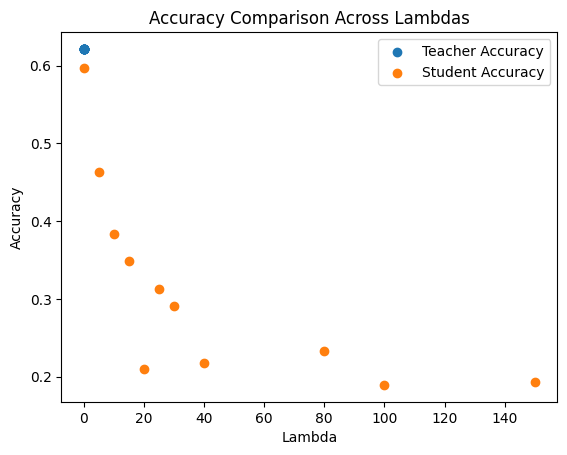

In [38]:
# Initialize lists to store accuracies
teacher_accuracies = []
student_accuracies = []
lambda_pairs = list(lambda_results.keys())

# Iterate over the keys in lambda_results
for key in lambda_pairs:
    # Check if the key is a tuple (indicating a lambda pair)
    if isinstance(key, tuple) and len(key) == 2:
        lmda_teacher, lmda_student = key
    else:
        # If the key is not a tuple, skip this iteration
        continue

    # Access the performance metrics for each pair
    teacher_accuracy = lambda_results[(lmda_teacher, lmda_student)]['performance_metrics']['metrics']['accuracy'][0]
    student_accuracy = lambda_results[(lmda_teacher, lmda_student)]['performance_metrics']['metrics']['accuracy'][1]

    # Append accuracies to the lists
    teacher_accuracies.append((lmda_teacher, teacher_accuracy))
    student_accuracies.append((lmda_student, student_accuracy))

# To plot, you might need to separate the lambda values and accuracies
teacher_lambdas, teacher_acc = zip(*teacher_accuracies)
student_lambdas, student_acc = zip(*student_accuracies)

# Plotting only with markers and no lines
plt.scatter(teacher_lambdas, teacher_acc, label='Teacher Accuracy', marker='o')
plt.scatter(student_lambdas, student_acc, label='Student Accuracy', marker='o')

# Adding labels and title
plt.xlabel('Lambda')
plt.ylabel('Accuracy')
plt.title('Accuracy Comparison Across Lambdas')
plt.legend()

# Show plot
plt.show()

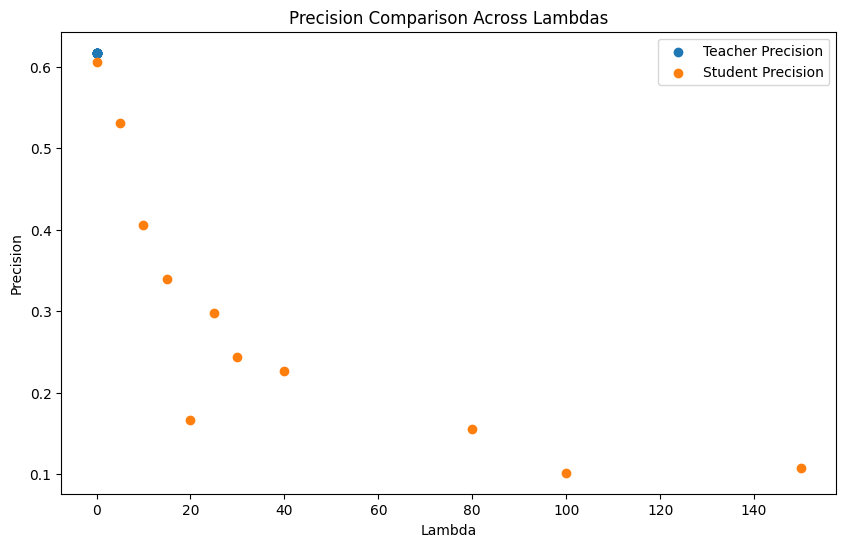

In [39]:
# Initialize lists to store precisions
teacher_precisions = []
student_precisions = []
lambda_pairs = list(lambda_results.keys())

# Iterate over the keys in lambda_results
for key in lambda_pairs:
    # Check if the key is a tuple (indicating a lambda pair)
    if isinstance(key, tuple) and len(key) == 2:
        lmda_teacher, lmda_student = key
        # Access the precision metrics for each pair
        teacher_precision = lambda_results[(lmda_teacher, lmda_student)]['performance_metrics']['metrics']['precision'][0]
        student_precision = lambda_results[(lmda_teacher, lmda_student)]['performance_metrics']['metrics']['precision'][1]
    else:
        # If the key is not a tuple, skip this iteration
        continue

    # Append precisions to the lists along with lambda values
    teacher_precisions.append((lmda_teacher, teacher_precision))
    student_precisions.append((lmda_student, student_precision))

# Extracting lambda values and precisions
teacher_lambdas, teacher_prec = zip(*teacher_precisions)
student_lambdas, student_prec = zip(*student_precisions)

# Creating a scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(teacher_lambdas, teacher_prec, label='Teacher Precision', marker='o')
plt.scatter(student_lambdas, student_prec, label='Student Precision', marker='o')

# Adding labels and title
plt.xlabel('Lambda')
plt.ylabel('Precision')
plt.title('Precision Comparison Across Lambdas')
plt.legend()

# Displaying the plot
plt.show()

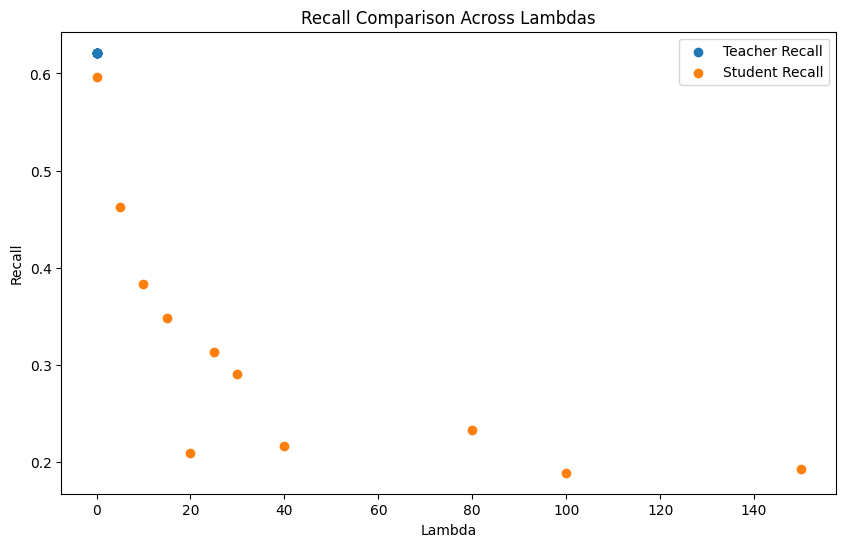

In [40]:
# Initialize lists to store recalls
teacher_recalls = []
student_recalls = []
lambda_pairs = list(lambda_results.keys())

# Iterate over the keys in lambda_results
for key in lambda_pairs:
    # Check if the key is a tuple (indicating a lambda pair)
    if isinstance(key, tuple) and len(key) == 2:
        lmda_teacher, lmda_student = key
        # Access the recall metrics for each pair
        teacher_recall = lambda_results[(lmda_teacher, lmda_student)]['performance_metrics']['metrics']['recall'][0]
        student_recall = lambda_results[(lmda_teacher, lmda_student)]['performance_metrics']['metrics']['recall'][1]
    else:
        # If the key is not a tuple, skip this iteration
        continue

    # Append recalls to the lists along with lambda values
    teacher_recalls.append((lmda_teacher, teacher_recall))
    student_recalls.append((lmda_student, student_recall))

# Extracting lambda values and recalls
teacher_lambdas, teacher_rec = zip(*teacher_recalls)
student_lambdas, student_rec = zip(*student_recalls)

# Creating a scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(teacher_lambdas, teacher_rec, label='Teacher Recall', marker='o')
plt.scatter(student_lambdas, student_rec, label='Student Recall', marker='o')

# Adding labels and title
plt.xlabel('Lambda')
plt.ylabel('Recall')
plt.title('Recall Comparison Across Lambdas')
plt.legend()

# Displaying the plot
plt.show()

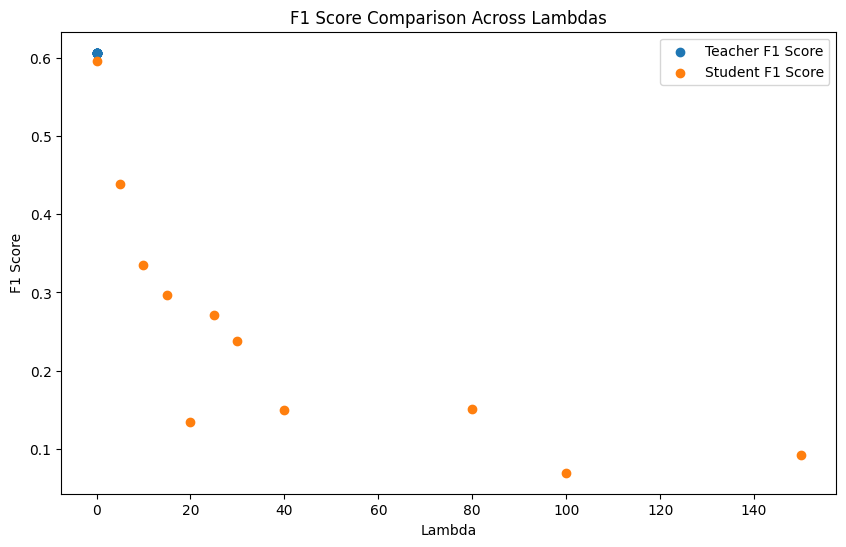

In [41]:
# Initialize lists to store F1 scores
teacher_f1s = []
student_f1s = []
lambda_pairs = list(lambda_results.keys())

# Iterate over the keys in lambda_results
for key in lambda_pairs:
    # Check if the key is a tuple (indicating a lambda pair)
    if isinstance(key, tuple) and len(key) == 2:
        lmda_teacher, lmda_student = key
        # Access the F1 scores for each pair
        teacher_f1 = lambda_results[(lmda_teacher, lmda_student)]['performance_metrics']['metrics']['f1'][0]
        student_f1 = lambda_results[(lmda_teacher, lmda_student)]['performance_metrics']['metrics']['f1'][1]
    else:
        # If the key is not a tuple, skip this iteration
        continue

    # Append F1 scores to the lists along with lambda values
    teacher_f1s.append((lmda_teacher, teacher_f1))
    student_f1s.append((lmda_student, student_f1))

# Extracting lambda values and F1 scores
teacher_lambdas, teacher_f1_scores = zip(*teacher_f1s)
student_lambdas, student_f1_scores = zip(*student_f1s)

# Creating a scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(teacher_lambdas, teacher_f1_scores, label='Teacher F1 Score', marker='o')
plt.scatter(student_lambdas, student_f1_scores, label='Student F1 Score', marker='o')

# Adding labels and title
plt.xlabel('Lambda')
plt.ylabel('F1 Score')
plt.title('F1 Score Comparison Across Lambdas')
plt.legend()

# Displaying the plot
plt.show()

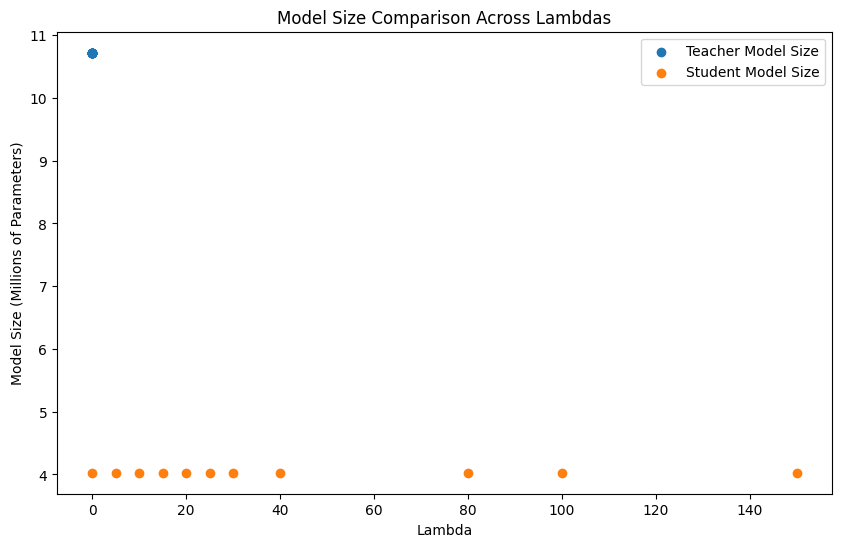

In [42]:
# Initialize lists to store model sizes
teacher_sizes = []
student_sizes = []
lambda_pairs = list(lambda_results.keys())

# Iterate over the keys in lambda_results
for key in lambda_pairs:
    # Check if the key is a tuple (indicating a lambda pair)
    if isinstance(key, tuple) and len(key) == 2:
        lmda_teacher, lmda_student = key
        # Access the model sizes for each pair
        teacher_size = lambda_results[(lmda_teacher, lmda_student)]['teacher_params'] / 1e6  # Convert to millions
        student_size = lambda_results[(lmda_teacher, lmda_student)]['student_params'] / 1e6
    else:
        # If the key is not a tuple, skip this iteration
        continue

    # Append model sizes to the lists along with lambda values
    teacher_sizes.append((lmda_teacher, teacher_size))
    student_sizes.append((lmda_student, student_size))

# Extracting lambda values and model sizes
teacher_lambdas, teacher_model_sizes = zip(*teacher_sizes)
student_lambdas, student_model_sizes = zip(*student_sizes)

# Creating a scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(teacher_lambdas, teacher_model_sizes, label='Teacher Model Size', marker='o')
plt.scatter(student_lambdas, student_model_sizes, label='Student Model Size', marker='o')

# Adding labels and title
plt.xlabel('Lambda')
plt.ylabel('Model Size (Millions of Parameters)')
plt.title('Model Size Comparison Across Lambdas')
plt.legend()

# Displaying the plot
plt.show()

In [43]:
        # Define the path to the saved model file for this lambda_factor
        lambda_dir = os.path.join(base_save_dir, f'TEACHER_lambda_{lmda_teacher}')
        teacher_path = os.path.join(lambda_dir, f'TEACHER_best_model_lambda_{lmda_teacher}.pth')
        
        # Initialize the EfficientNet model without pre-trained weights
        teacher_model = models.efficientnet_b3(pretrained=False)
        
        # Adjust the classifier layer to match your number of classes
        num_ftrs = teacher.classifier[1].in_features
        teacher_model.classifier[1] = nn.Linear(num_ftrs, num_classes)
        
        # Load the model state
        teacher_best_model_state = torch.load(teacher_path)
        teacher_model.load_state_dict(teacher_best_model_state['teacher_state_dict'])
        teacher_model = teacher_model.to(device)
        
        # Define the path to the saved model file for this lambda_factor
        lambda_dir = os.path.join(base_save_dir, f'STUDENT_lambda_{lmda_student}')
        student_path = os.path.join(lambda_dir, f'STUDENT_best_model_lambda_{lmda_student}.pth')
        
        # Initialize the EfficientNet model without pre-trained weights
        student_model = models.efficientnet_b0(pretrained=False)
        
        # Adjust the classifier layer to match your number of classes
        num_ftrs = student_model.classifier[1].in_features
        student_model.classifier[1] = nn.Linear(num_ftrs, num_classes)
        
        # Load the model state
        student_best_model_state = torch.load(student_path)
        student_model.load_state_dict(student_best_model_state['student_state_dict'])
        student_model = student_model.to(device)

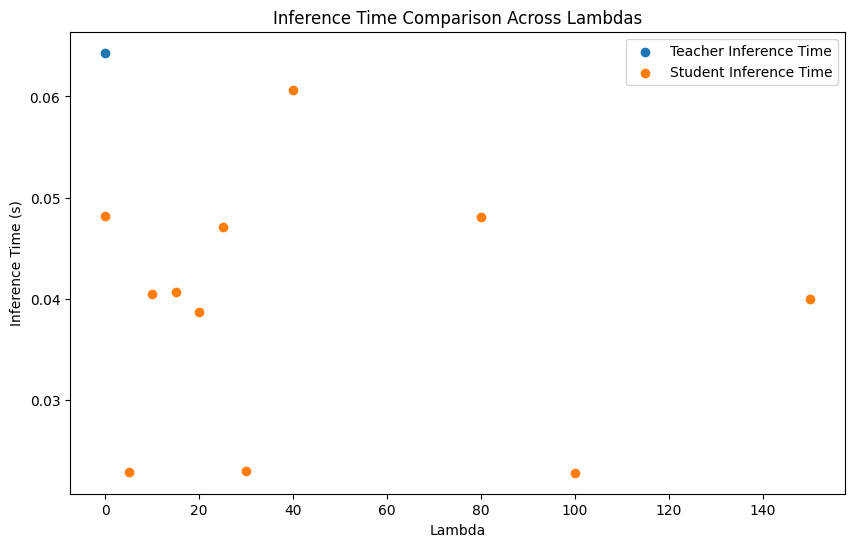

In [44]:
# Initialize dictionaries to store inference times for each lambda value
teacher_times = {}
student_times = {}

# Loop through each lambda value
for lmda_teacher in teacher_lambda_factor_list:
    # Define the path to the saved model file for this lambda_factor
    lambda_dir = os.path.join(base_save_dir, f'TEACHER_lambda_{lmda_teacher}')
    teacher_path = os.path.join(lambda_dir, f'TEACHER_best_model_lambda_{lmda_teacher}.pth')
    
    # Initialize the EfficientNet model without pre-trained weights
    teacher_model = models.efficientnet_b3(pretrained=False)
    
    # Adjust the classifier layer to match your number of classes
    num_ftrs = teacher.classifier[1].in_features
    teacher_model.classifier[1] = nn.Linear(num_ftrs, num_classes)
    
    # Load the model state
    teacher_best_model_state = torch.load(teacher_path)
    teacher_model.load_state_dict(teacher_best_model_state['teacher_state_dict'])
    teacher_model = teacher_model.to(device)

    teacher_time, _ = compare_inference_time(teacher_model, None, testloader)
    teacher_times[lmda_teacher] = teacher_time  # Store the inference time for the teacher model

for lmda_student in student_lambda_factor_list:
    # Define the path to the saved model file for this lambda_factor
    lambda_dir = os.path.join(base_save_dir, f'STUDENT_lambda_{lmda_student}')
    student_path = os.path.join(lambda_dir, f'STUDENT_best_model_lambda_{lmda_student}.pth')
    
    # Initialize the EfficientNet model without pre-trained weights
    student_model = models.efficientnet_b0(pretrained=False)
    
    # Adjust the classifier layer to match your number of classes
    num_ftrs = student_model.classifier[1].in_features
    student_model.classifier[1] = nn.Linear(num_ftrs, num_classes)
    
    # Load the model state
    student_best_model_state = torch.load(student_path)
    student_model.load_state_dict(student_best_model_state['student_state_dict'])
    student_model = student_model.to(device)

    _, student_time = compare_inference_time(None, student_model, testloader)
    student_times[lmda_student] = student_time  # Store the inference time for the student model

# Extracting lambda values and inference times
teacher_lambdas, teacher_inference_times = zip(*teacher_times.items())
student_lambdas, student_inference_times = zip(*student_times.items())

# Creating a scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(teacher_lambdas, teacher_inference_times, label='Teacher Inference Time', marker='o')
plt.scatter(student_lambdas, student_inference_times, label='Student Inference Time', marker='o')

# Adding labels and title
plt.xlabel('Lambda')
plt.ylabel('Inference Time (s)')
plt.title('Inference Time Comparison Across Lambdas')
plt.legend()

# Displaying the plot
plt.show()

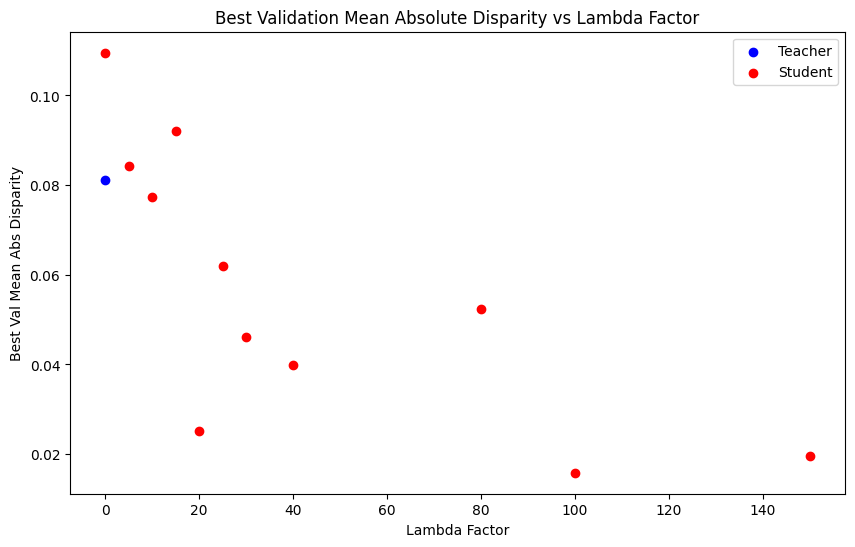

In [45]:
teacher_disparities = []
student_disparities = []

# Loop through each lambda_factor in the teacher_lambda_factor_list and extract the disparity values for the teacher
for lambda_factor in teacher_lambda_factor_list:
    # Load teacher model
    teacher_path = os.path.join(base_save_dir, f'TEACHER_lambda_{lambda_factor}', f'TEACHER_best_model_lambda_{lambda_factor}.pth')
    teacher_best_model_state = torch.load(teacher_path)
    teacher_disparities.append((lambda_factor, teacher_best_model_state['best_val_mean_abs_disparity']))

# Loop through each lambda_factor in the student_lambda_factor_list and extract the disparity values for the student
for lambda_factor in student_lambda_factor_list:
    # Load student model
    student_path = os.path.join(base_save_dir, f'STUDENT_lambda_{lambda_factor}', f'STUDENT_best_model_lambda_{lambda_factor}.pth')
    student_best_model_state = torch.load(student_path)
    student_disparities.append((lambda_factor, student_best_model_state['best_val_mean_abs_disparity']))

# Unpack the lambda factors and disparities for plotting
teacher_lambdas, teacher_disp_values = zip(*teacher_disparities)
student_lambdas, student_disp_values = zip(*student_disparities)

# Plotting
plt.figure(figsize=(10, 6))
plt.scatter(teacher_lambdas, teacher_disp_values, label='Teacher', color='blue')
plt.scatter(student_lambdas, student_disp_values, label='Student', color='red')
plt.xlabel('Lambda Factor')
plt.ylabel('Best Val Mean Abs Disparity')
plt.title('Best Validation Mean Absolute Disparity vs Lambda Factor')
plt.legend()
plt.show()


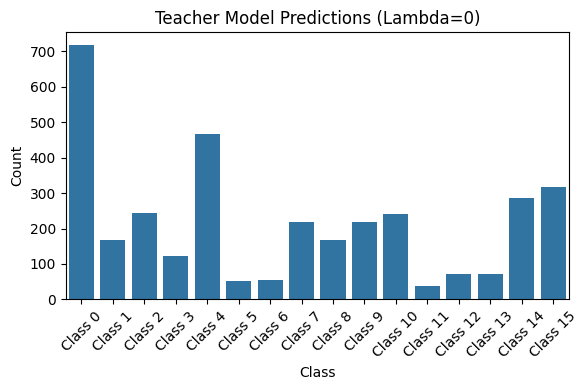

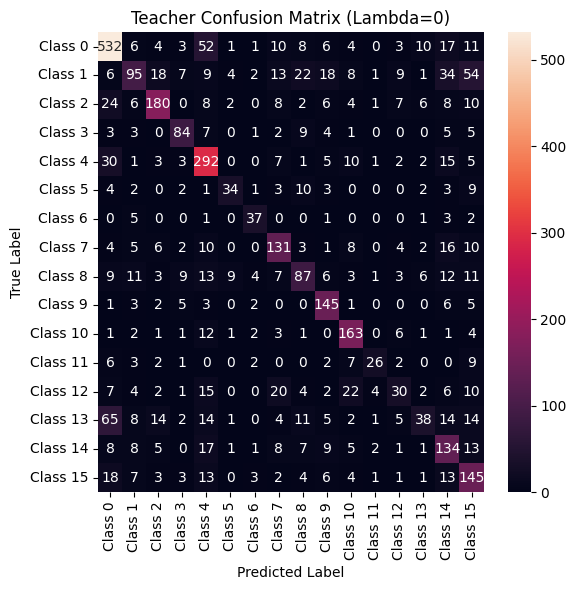

Classification Report - Teacher Model (Lambda=0)
              precision    recall  f1-score   support

     Class 0       0.74      0.80      0.77       668
     Class 1       0.56      0.32      0.40       301
     Class 2       0.74      0.66      0.70       272
     Class 3       0.68      0.68      0.68       124
     Class 4       0.63      0.77      0.69       377
     Class 5       0.64      0.46      0.54        74
     Class 6       0.66      0.74      0.70        50
     Class 7       0.60      0.65      0.62       202
     Class 8       0.51      0.45      0.48       194
     Class 9       0.66      0.84      0.74       173
    Class 10       0.67      0.82      0.74       199
    Class 11       0.68      0.43      0.53        60
    Class 12       0.41      0.23      0.30       129
    Class 13       0.52      0.19      0.28       198
    Class 14       0.47      0.61      0.53       220
    Class 15       0.46      0.65      0.54       224

    accuracy                   

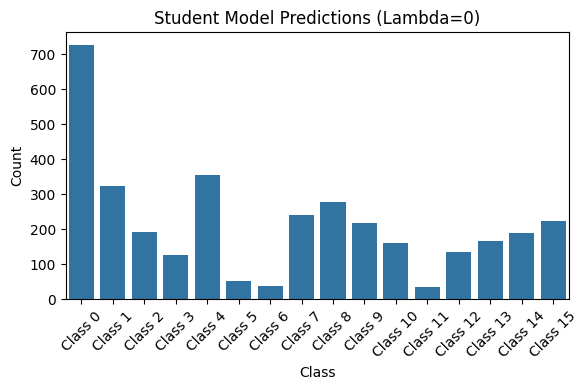

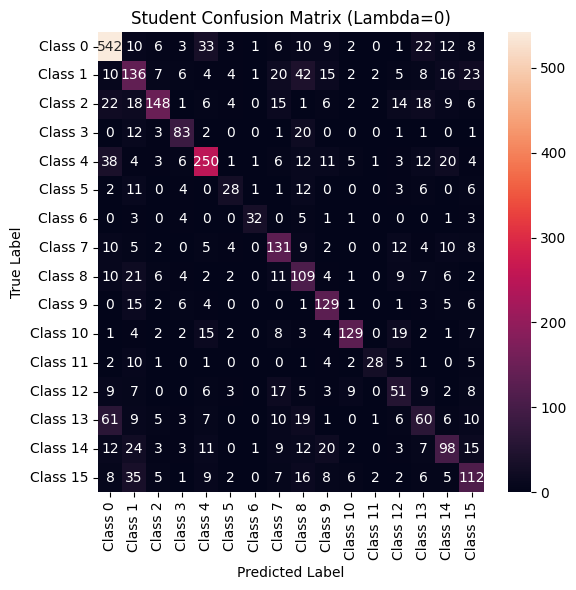

Classification Report - Student Model (Lambda=0)
              precision    recall  f1-score   support

     Class 0       0.75      0.81      0.78       668
     Class 1       0.42      0.45      0.44       301
     Class 2       0.77      0.54      0.64       272
     Class 3       0.66      0.67      0.66       124
     Class 4       0.70      0.66      0.68       377
     Class 5       0.53      0.38      0.44        74
     Class 6       0.86      0.64      0.74        50
     Class 7       0.54      0.65      0.59       202
     Class 8       0.39      0.56      0.46       194
     Class 9       0.59      0.75      0.66       173
    Class 10       0.80      0.65      0.71       199
    Class 11       0.78      0.47      0.58        60
    Class 12       0.38      0.40      0.39       129
    Class 13       0.36      0.30      0.33       198
    Class 14       0.51      0.45      0.48       220
    Class 15       0.50      0.50      0.50       224

    accuracy                   

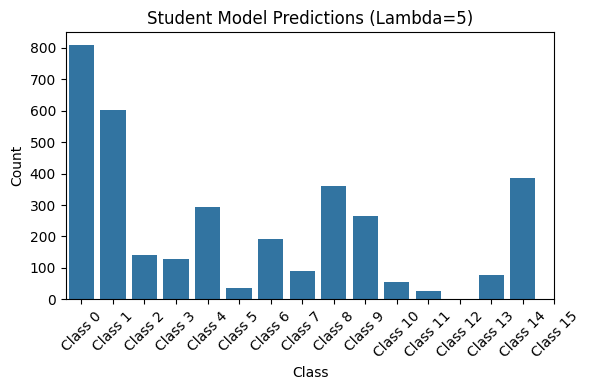

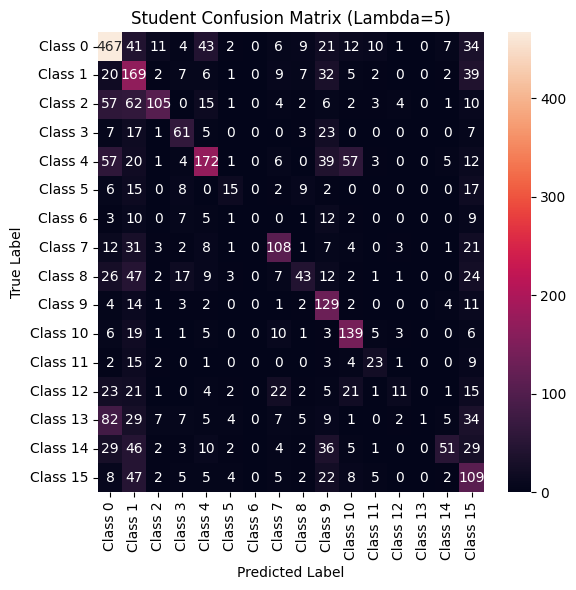

Classification Report - Student Model (Lambda=5)
              precision    recall  f1-score   support

     Class 0       0.58      0.70      0.63       668
     Class 1       0.28      0.56      0.37       301
     Class 2       0.74      0.39      0.51       272
     Class 3       0.47      0.49      0.48       124
     Class 4       0.58      0.46      0.51       377
     Class 5       0.41      0.20      0.27        74
     Class 6       0.00      0.00      0.00        50
     Class 7       0.57      0.53      0.55       202
     Class 8       0.48      0.22      0.30       194
     Class 9       0.36      0.75      0.48       173
    Class 10       0.53      0.70      0.60       199
    Class 11       0.43      0.38      0.40        60
    Class 12       0.42      0.09      0.14       129
    Class 13       1.00      0.01      0.01       198
    Class 14       0.65      0.23      0.34       220
    Class 15       0.28      0.49      0.36       224

    accuracy                   

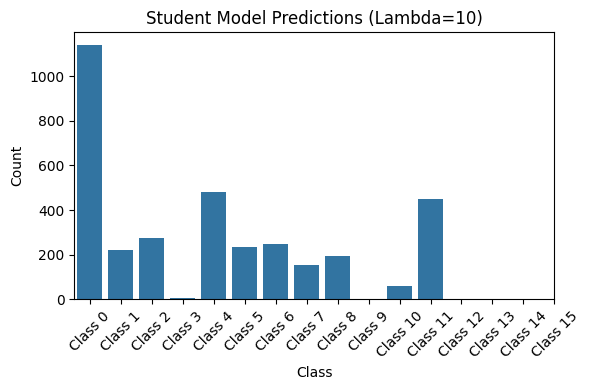

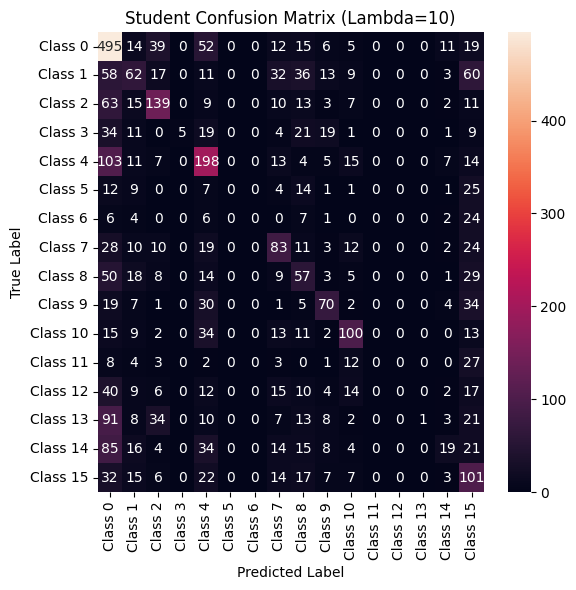

Classification Report - Student Model (Lambda=10)
              precision    recall  f1-score   support

     Class 0       0.43      0.74      0.55       668
     Class 1       0.28      0.21      0.24       301
     Class 2       0.50      0.51      0.51       272
     Class 3       1.00      0.04      0.08       124
     Class 4       0.41      0.53      0.46       377
     Class 5       0.00      0.00      0.00        74
     Class 6       0.00      0.00      0.00        50
     Class 7       0.35      0.41      0.38       202
     Class 8       0.23      0.29      0.26       194
     Class 9       0.45      0.40      0.43       173
    Class 10       0.51      0.50      0.51       199
    Class 11       0.00      0.00      0.00        60
    Class 12       0.00      0.00      0.00       129
    Class 13       1.00      0.01      0.01       198
    Class 14       0.31      0.09      0.14       220
    Class 15       0.22      0.45      0.30       224

    accuracy                  

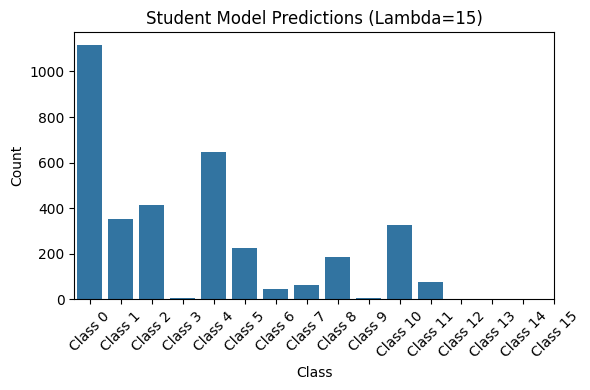

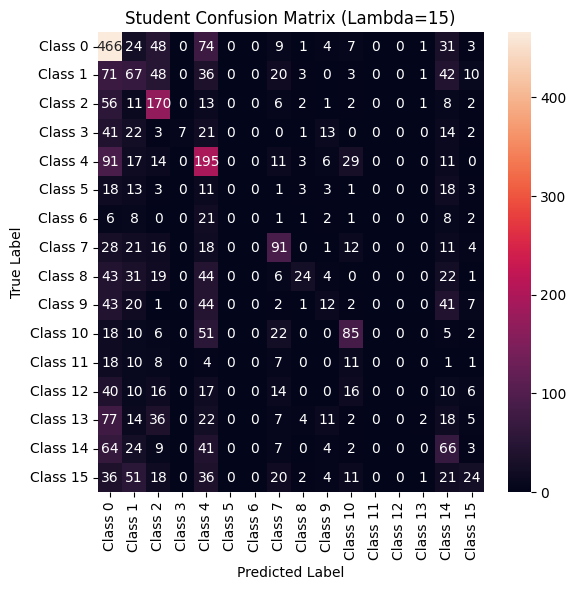

Classification Report - Student Model (Lambda=15)
              precision    recall  f1-score   support

     Class 0       0.42      0.70      0.52       668
     Class 1       0.19      0.22      0.20       301
     Class 2       0.41      0.62      0.49       272
     Class 3       1.00      0.06      0.11       124
     Class 4       0.30      0.52      0.38       377
     Class 5       0.00      0.00      0.00        74
     Class 6       0.00      0.00      0.00        50
     Class 7       0.41      0.45      0.43       202
     Class 8       0.53      0.12      0.20       194
     Class 9       0.18      0.07      0.10       173
    Class 10       0.46      0.43      0.44       199
    Class 11       0.00      0.00      0.00        60
    Class 12       0.00      0.00      0.00       129
    Class 13       0.33      0.01      0.02       198
    Class 14       0.20      0.30      0.24       220
    Class 15       0.32      0.11      0.16       224

    accuracy                  

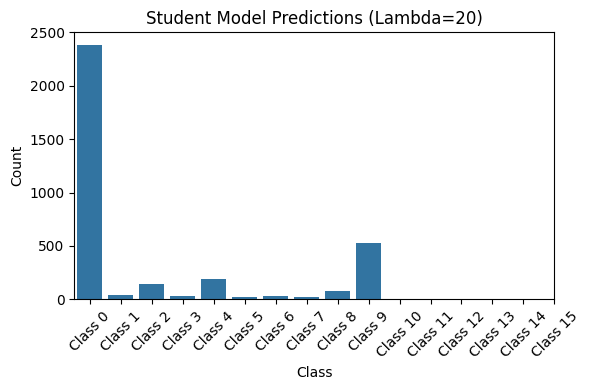

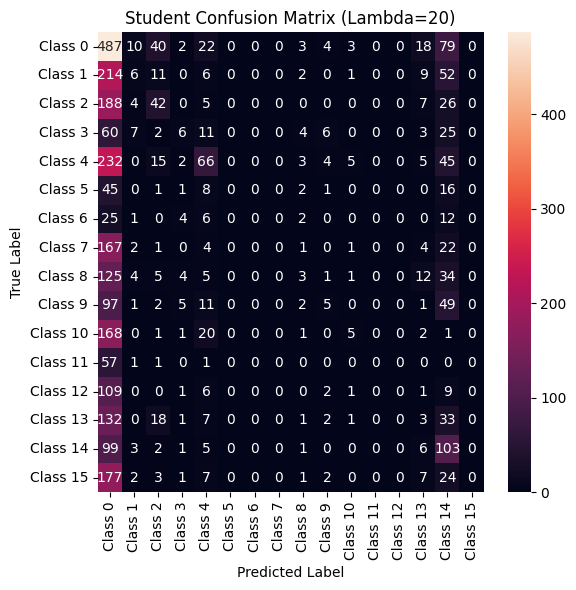

Classification Report - Student Model (Lambda=20)
              precision    recall  f1-score   support

     Class 0       0.20      0.73      0.32       668
     Class 1       0.15      0.02      0.04       301
     Class 2       0.29      0.15      0.20       272
     Class 3       0.21      0.05      0.08       124
     Class 4       0.35      0.18      0.23       377
     Class 5       0.00      0.00      0.00        74
     Class 6       0.00      0.00      0.00        50
     Class 7       0.00      0.00      0.00       202
     Class 8       0.12      0.02      0.03       194
     Class 9       0.19      0.03      0.05       173
    Class 10       0.28      0.03      0.05       199
    Class 11       0.00      0.00      0.00        60
    Class 12       0.00      0.00      0.00       129
    Class 13       0.04      0.02      0.02       198
    Class 14       0.19      0.47      0.27       220
    Class 15       0.00      0.00      0.00       224

    accuracy                  

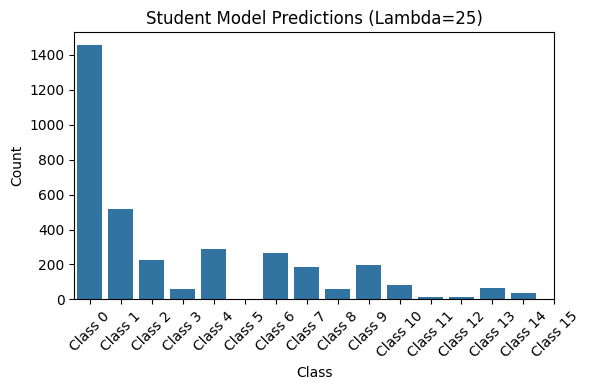

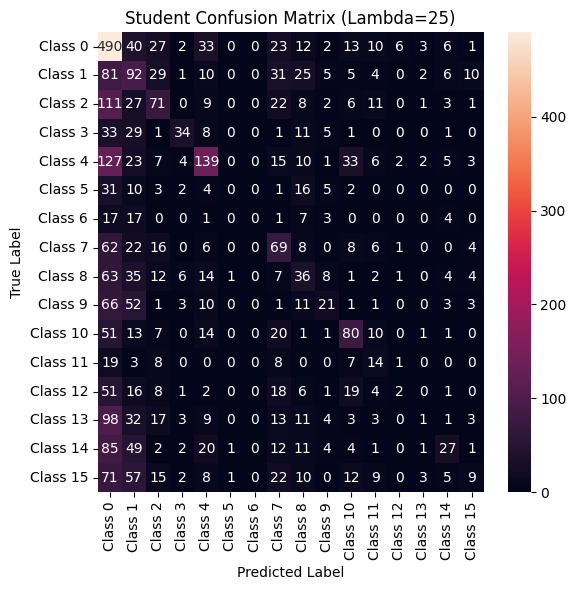

Classification Report - Student Model (Lambda=25)
              precision    recall  f1-score   support

     Class 0       0.34      0.73      0.46       668
     Class 1       0.18      0.31      0.22       301
     Class 2       0.32      0.26      0.29       272
     Class 3       0.57      0.27      0.37       124
     Class 4       0.48      0.37      0.42       377
     Class 5       0.00      0.00      0.00        74
     Class 6       0.00      0.00      0.00        50
     Class 7       0.26      0.34      0.30       202
     Class 8       0.20      0.19      0.19       194
     Class 9       0.34      0.12      0.18       173
    Class 10       0.41      0.40      0.41       199
    Class 11       0.17      0.23      0.20        60
    Class 12       0.15      0.02      0.03       129
    Class 13       0.07      0.01      0.01       198
    Class 14       0.40      0.12      0.19       220
    Class 15       0.23      0.04      0.07       224

    accuracy                  

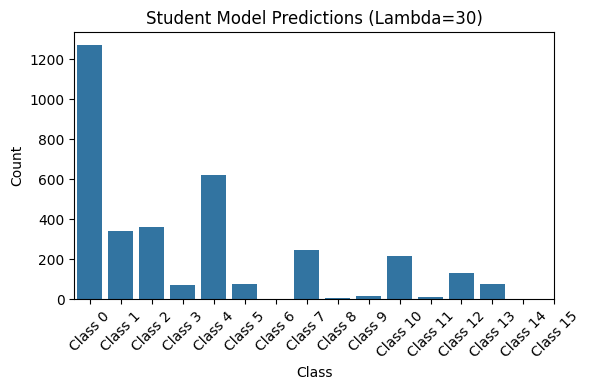

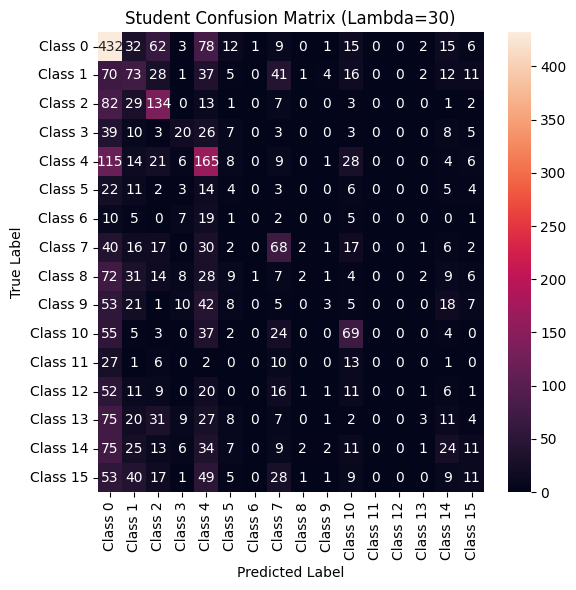

Classification Report - Student Model (Lambda=30)
              precision    recall  f1-score   support

     Class 0       0.34      0.65      0.45       668
     Class 1       0.21      0.24      0.23       301
     Class 2       0.37      0.49      0.42       272
     Class 3       0.27      0.16      0.20       124
     Class 4       0.27      0.44      0.33       377
     Class 5       0.05      0.05      0.05        74
     Class 6       0.00      0.00      0.00        50
     Class 7       0.27      0.34      0.30       202
     Class 8       0.22      0.01      0.02       194
     Class 9       0.19      0.02      0.03       173
    Class 10       0.32      0.35      0.33       199
    Class 11       0.00      0.00      0.00        60
    Class 12       0.00      0.00      0.00       129
    Class 13       0.25      0.02      0.03       198
    Class 14       0.18      0.11      0.14       220
    Class 15       0.14      0.05      0.07       224

    accuracy                  

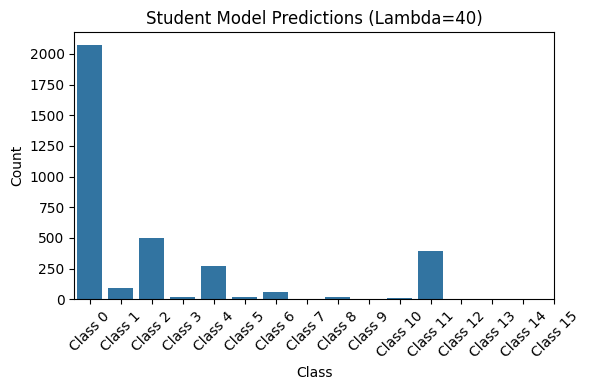

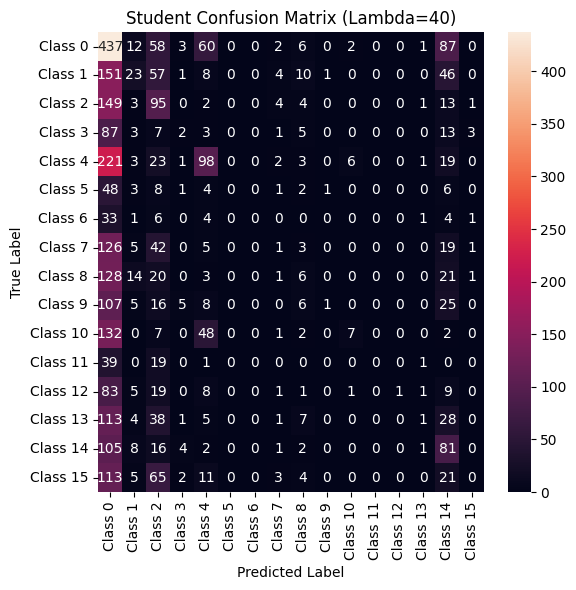

Classification Report - Student Model (Lambda=40)
              precision    recall  f1-score   support

     Class 0       0.21      0.65      0.32       668
     Class 1       0.24      0.08      0.12       301
     Class 2       0.19      0.35      0.25       272
     Class 3       0.10      0.02      0.03       124
     Class 4       0.36      0.26      0.30       377
     Class 5       0.00      0.00      0.00        74
     Class 6       0.00      0.00      0.00        50
     Class 7       0.04      0.00      0.01       202
     Class 8       0.10      0.03      0.05       194
     Class 9       0.33      0.01      0.01       173
    Class 10       0.44      0.04      0.07       199
    Class 11       0.00      0.00      0.00        60
    Class 12       1.00      0.01      0.02       129
    Class 13       0.12      0.01      0.01       198
    Class 14       0.21      0.37      0.26       220
    Class 15       0.00      0.00      0.00       224

    accuracy                  

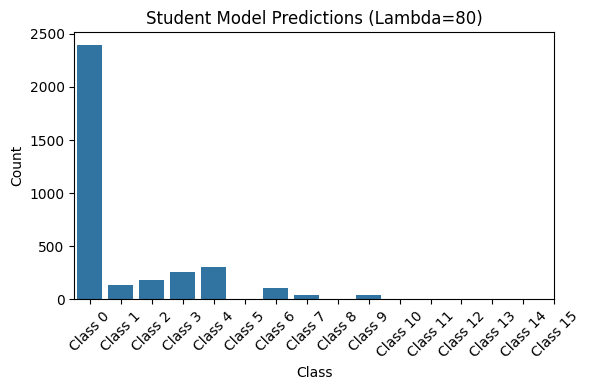

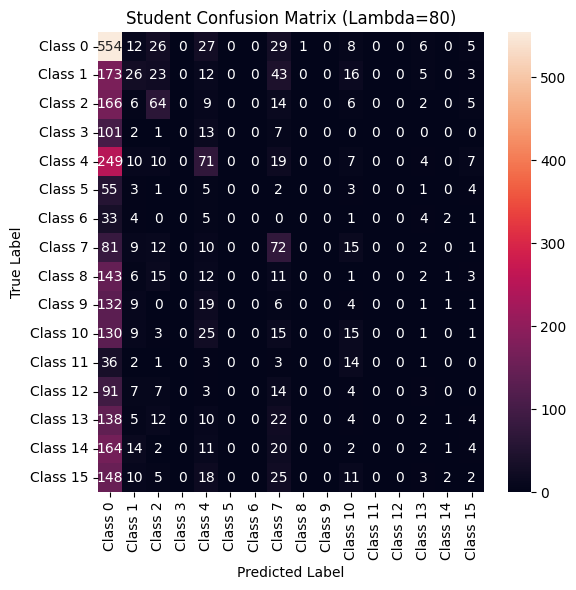

Classification Report - Student Model (Lambda=80)
              precision    recall  f1-score   support

     Class 0       0.23      0.83      0.36       668
     Class 1       0.19      0.09      0.12       301
     Class 2       0.35      0.24      0.28       272
     Class 3       0.00      0.00      0.00       124
     Class 4       0.28      0.19      0.23       377
     Class 5       0.00      0.00      0.00        74
     Class 6       0.00      0.00      0.00        50
     Class 7       0.24      0.36      0.29       202
     Class 8       0.00      0.00      0.00       194
     Class 9       0.00      0.00      0.00       173
    Class 10       0.14      0.08      0.10       199
    Class 11       0.00      0.00      0.00        60
    Class 12       0.00      0.00      0.00       129
    Class 13       0.05      0.01      0.02       198
    Class 14       0.12      0.00      0.01       220
    Class 15       0.05      0.01      0.02       224

    accuracy                  

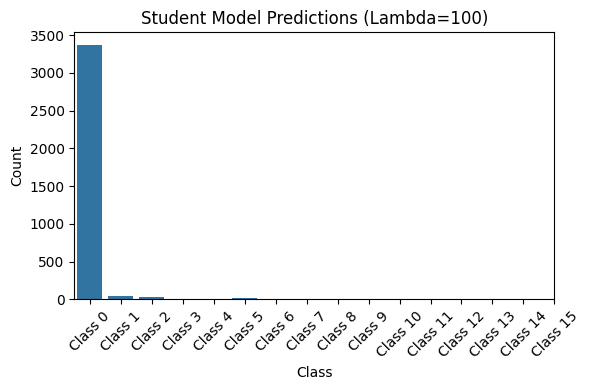

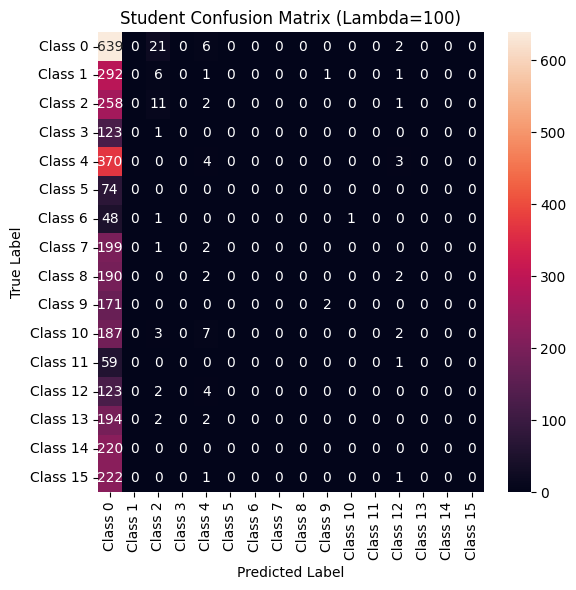

Classification Report - Student Model (Lambda=100)
              precision    recall  f1-score   support

     Class 0       0.19      0.96      0.32       668
     Class 1       0.00      0.00      0.00       301
     Class 2       0.23      0.04      0.07       272
     Class 3       0.00      0.00      0.00       124
     Class 4       0.13      0.01      0.02       377
     Class 5       0.00      0.00      0.00        74
     Class 6       0.00      0.00      0.00        50
     Class 7       0.00      0.00      0.00       202
     Class 8       0.00      0.00      0.00       194
     Class 9       0.67      0.01      0.02       173
    Class 10       0.00      0.00      0.00       199
    Class 11       0.00      0.00      0.00        60
    Class 12       0.00      0.00      0.00       129
    Class 13       0.00      0.00      0.00       198
    Class 14       0.00      0.00      0.00       220
    Class 15       0.00      0.00      0.00       224

    accuracy                 

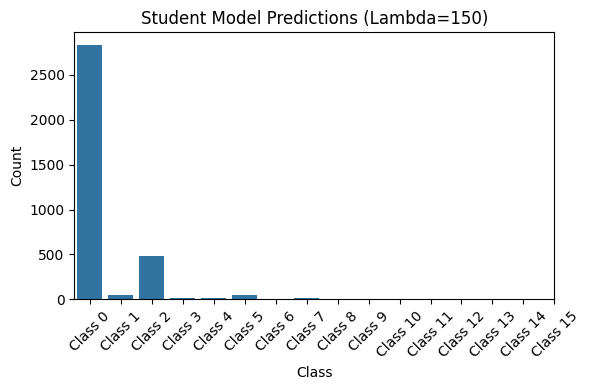

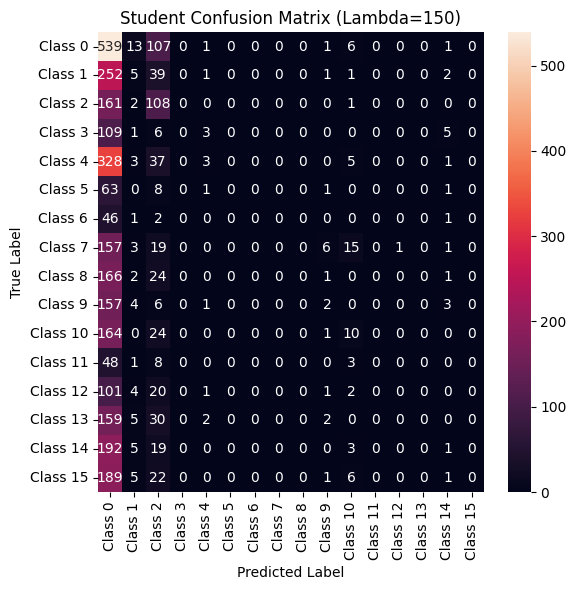

Classification Report - Student Model (Lambda=150)
              precision    recall  f1-score   support

     Class 0       0.19      0.81      0.31       668
     Class 1       0.09      0.02      0.03       301
     Class 2       0.23      0.40      0.29       272
     Class 3       0.00      0.00      0.00       124
     Class 4       0.23      0.01      0.02       377
     Class 5       0.00      0.00      0.00        74
     Class 6       0.00      0.00      0.00        50
     Class 7       0.00      0.00      0.00       202
     Class 8       0.00      0.00      0.00       194
     Class 9       0.12      0.01      0.02       173
    Class 10       0.19      0.05      0.08       199
    Class 11       0.00      0.00      0.00        60
    Class 12       0.00      0.00      0.00       129
    Class 13       0.00      0.00      0.00       198
    Class 14       0.06      0.00      0.01       220
    Class 15       0.00      0.00      0.00       224

    accuracy                 

In [46]:
def plot_distribution(predictions, class_names, title):
    plt.figure(figsize=(6, 4))
    sns.countplot(x=predictions)
    plt.title(title)
    plt.xlabel('Class')
    plt.ylabel('Count')
    plt.xticks(range(len(class_names)), class_names, rotation=45)
    plt.tight_layout()
    plt.show()

def plot_confusion_matrix(all_labels, predictions, class_names, title):
    cm = confusion_matrix(all_labels, predictions)
    plt.figure(figsize=(6, 6))
    sns.heatmap(pd.DataFrame(cm, index=class_names, columns=class_names), annot=True, fmt='g')
    plt.title(title)
    plt.ylabel('True Label')
    plt.xlabel('Predicted Label')
    plt.tight_layout()
    plt.show()

# Function to generate predictions and compute metrics
def generate_predictions_and_metrics(model, dataloader):
    model.eval()
    all_labels = []
    all_preds = []

    with torch.no_grad():
        for batch in dataloader:
            inputs = batch['img'].to(device)
            labels = batch['label'].to(device)
            
            outputs = model(inputs)
            preds = torch.argmax(outputs, dim=1).cpu().numpy()
            
            all_labels.append(labels.cpu().numpy())
            all_preds.append(preds)

    all_labels = np.concatenate(all_labels)
    all_preds = np.concatenate(all_preds)

    return all_labels, all_preds

# Loop over each lambda value for the teacher model
for lmda_teacher in teacher_lambda_factor_list:
    # Define the path to the saved model file for this lambda_factor
    lambda_dir = os.path.join(base_save_dir, f'TEACHER_lambda_{lmda_teacher}')
    teacher_path = os.path.join(lambda_dir, f'TEACHER_best_model_lambda_{lmda_teacher}.pth')
    
    # Initialize the EfficientNet model without pre-trained weights
    teacher_model = models.efficientnet_b3(pretrained=False)
    
    # Adjust the classifier layer to match your number of classes
    num_ftrs = teacher.classifier[1].in_features
    teacher_model.classifier[1] = nn.Linear(num_ftrs, num_classes)
    
    # Load the model state
    teacher_best_model_state = torch.load(teacher_path)
    teacher_model.load_state_dict(teacher_best_model_state['teacher_state_dict'])
    teacher_model = teacher_model.to(device)
    
    # Generate predictions for the teacher model
    all_labels, all_teacher_preds = generate_predictions_and_metrics(teacher_model, testloader)

    # Plot distribution and confusion matrix for the teacher model
    plot_distribution(all_teacher_preds, class_names_new, f'Teacher Model Predictions (Lambda={lmda_teacher})')
    plot_confusion_matrix(all_labels, all_teacher_preds, class_names_new, f'Teacher Confusion Matrix (Lambda={lmda_teacher})')

    # Print classification report for the teacher model
    teacher_report = classification_report(all_labels, all_teacher_preds, target_names=class_names_new, zero_division=0)
    print(f'Classification Report - Teacher Model (Lambda={lmda_teacher})')
    print(teacher_report)

# Loop over each lambda value for the student model
for lmda_student in student_lambda_factor_list:
    # Define the path to the saved model file for this lambda_factor
    lambda_dir = os.path.join(base_save_dir, f'STUDENT_lambda_{lmda_student}')
    student_path = os.path.join(lambda_dir, f'STUDENT_best_model_lambda_{lmda_student}.pth')
    
    # Initialize the EfficientNet model without pre-trained weights
    student_model = models.efficientnet_b0(pretrained=False)
    
    # Adjust the classifier layer to match your number of classes
    num_ftrs = student_model.classifier[1].in_features
    student_model.classifier[1] = nn.Linear(num_ftrs, num_classes)
    
    # Load the model state
    student_best_model_state = torch.load(student_path)
    student_model.load_state_dict(student_best_model_state['student_state_dict'])
    student_model = student_model.to(device)

    # Generate predictions for the student model
    all_labels, all_student_preds = generate_predictions_and_metrics(student_model, testloader)

    # Plot distribution and confusion matrix for the student model
    plot_distribution(all_student_preds, class_names_new, f'Student Model Predictions (Lambda={lmda_student})')
    plot_confusion_matrix(all_labels, all_student_preds, class_names_new, f'Student Confusion Matrix (Lambda={lmda_student})')

    # Print classification report for the student model
    student_report = classification_report(all_labels, all_student_preds, target_names=class_names_new, zero_division=0)
    print(f'Classification Report - Student Model (Lambda={lmda_student})')
    print(student_report)

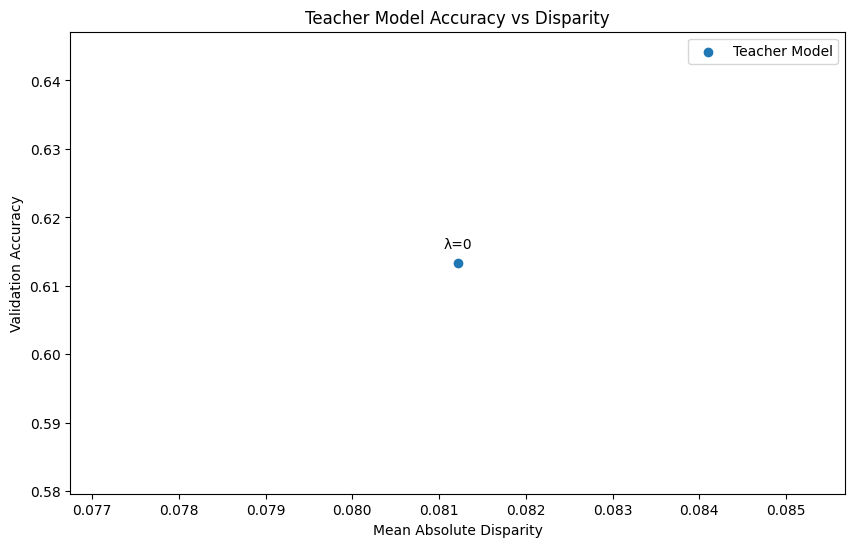

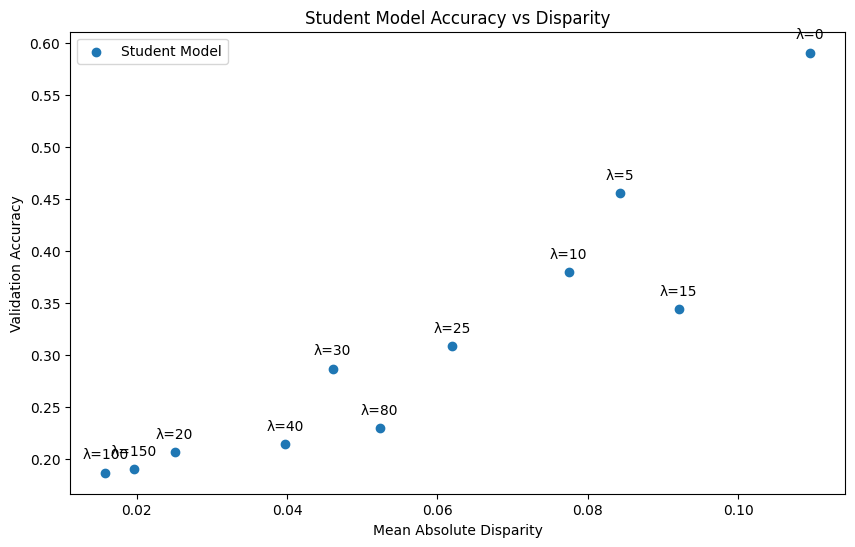

In [47]:
def plot_bias_variance_tradeoff(base_save_dir, model_type, lambda_list):
    bias_values = []
    accuracy_values = []

    for lambda_factor in lambda_list:
        model_path = os.path.join(base_save_dir, f'{model_type.upper()}_lambda_{lambda_factor}', f'{model_type.upper()}_best_model_lambda_{lambda_factor}.pth')
        if os.path.exists(model_path):
            model_state = torch.load(model_path)

            disparity = model_state['best_val_mean_abs_disparity']
            accuracy = model_state['best_val_accuracy']
            bias_values.append(disparity)
            accuracy_values.append(accuracy)

    # Plotting
    plt.figure(figsize=(10, 6))
    plt.scatter(bias_values, accuracy_values, label=f'{model_type.title()} Model')
    plt.xlabel('Mean Absolute Disparity')
    plt.ylabel('Validation Accuracy')
    plt.title(f'{model_type.title()} Model Accuracy vs Disparity')
    for i, lambda_factor in enumerate(lambda_list):
        plt.annotate(f'λ={lambda_factor}', (bias_values[i], accuracy_values[i]), textcoords="offset points", xytext=(0,10), ha='center')
    plt.legend()
    plt.show()

# Plot for Teacher
plot_bias_variance_tradeoff(base_save_dir, 'teacher', teacher_lambda_factor_list)

# Plot for Student
plot_bias_variance_tradeoff(base_save_dir, 'student', student_lambda_factor_list)

In [48]:
def compare_performance_metrics_for_demo(teacher, student, dataloader):
    teacher.eval()
    student.eval()

    detailed_info = []

    for batch in dataloader:
        inputs = batch['img'].to(device)
        labels = batch['label'].to(device)
        # Assuming gender or other attributes are part of 'target'
        attributes = batch['target'].to(device)  

        with torch.no_grad():
            teacher_outputs = teacher(inputs)
            student_outputs = student(inputs)

        teacher_preds = torch.argmax(teacher_outputs, dim=1)
        student_preds = torch.argmax(student_outputs, dim=1)

        for i in range(inputs.size(0)):
            if teacher_preds[i] != labels[i] and student_preds[i] == labels[i]:
                info = {
                    'image': inputs[i],
                    'actual_class': labels[i].item(),
                    'teacher_pred_class': teacher_preds[i].item(),
                    'student_pred_class': student_preds[i].item(),
                    'actual_attribute': attributes[i].item(),  # Modify based on your dataset
                    # If your model also predicts attributes, include them here
                }
                detailed_info.append(info)

    return detailed_info

In [49]:
def plot_images_with_class_filter(info_list, display_class, new_label_mapping, rows=10, cols=5):
    # Filter the info list based on the specified class, student correct and teacher incorrect predictions
    filtered_info = [info for info in info_list if info['actual_class'] == display_class and 
                     info['student_pred_class'] == display_class and 
                     info['teacher_pred_class'] != display_class]

    # Calculate the number of images to display based on the length of the filtered list
    num_images = len(filtered_info)
    if num_images == 0:
        print(f"No images to display for class {display_class}.")
        return  # Skip this class as there are no images to display

    total_plots = min(rows * cols, num_images)  # Ensure we don't exceed the number of filtered images

    # Determine the number of rows needed based on the number of images
    rows = (total_plots + cols - 1) // cols

    # Create a figure with the adjusted number of rows and columns
    fig, axes = plt.subplots(rows, cols, figsize=(15, 3 * rows))
    axes = axes.ravel()

    for i in range(total_plots):
        data = filtered_info[i]
        image = data['image']
        actual_class = new_label_mapping[data['actual_class']]  # Get class name from the mapping
        teacher_pred_class = new_label_mapping[data['teacher_pred_class']]  # Get class name from the mapping
        student_pred_class = new_label_mapping[data['student_pred_class']]  # Get class name from the mapping
        actual_attribute = round(data['actual_attribute'], 3)
    
        # Normalize the image for display
        image_display = image.cpu().numpy().transpose(1, 2, 0)
        image_display = (image_display - image_display.min()) / (image_display.max() - image_display.min())
    
        # Set the title with the class and attribute information
        title = f'Attr: {actual_attribute}\nTrue: {actual_class}\nTeacher: {teacher_pred_class}\nStudent: {student_pred_class}'
    
        axes[i].imshow(image_display)
        axes[i].set_title(title, fontsize=12, pad=4)
        axes[i].axis('off')

    # Turn off any unused axes
    for i in range(total_plots, len(axes)):
        axes[i].axis('off')

    # Adjust layout for clarity
    plt.tight_layout()
    plt.subplots_adjust(wspace=0.5, hspace=0.6)
    plt.show()


In [ ]:
# Load the Teacher Model for a specific lambda value
def load_teacher_model(lambda_factor):
    lambda_dir = os.path.join(base_save_dir, f'TEACHER_lambda_{lambda_factor}')
    teacher_path = os.path.join(lambda_dir, f'TEACHER_best_model_lambda_{lambda_factor}.pth')

    teacher_model = models.efficientnet_b3(pretrained=False)
    num_ftrs = teacher_model.classifier[1].in_features
    teacher_model.classifier[1] = torch.nn.Linear(num_ftrs, num_classes)

    teacher_best_model_state = torch.load(teacher_path)
    teacher_model.load_state_dict(teacher_best_model_state['teacher_state_dict'])
    teacher_model = teacher_model.to(device)
    return teacher_model

# Load the Student Model for a specific lambda value
def load_student_model(lambda_factor):
    lambda_dir = os.path.join(base_save_dir, f'STUDENT_lambda_{lambda_factor}')
    student_path = os.path.join(lambda_dir, f'STUDENT_best_model_lambda_{lambda_factor}.pth')

    student_model = models.efficientnet_b0(pretrained=False)
    num_ftrs = student_model.classifier[1].in_features
    student_model.classifier[1] = torch.nn.Linear(num_ftrs, num_classes)

    student_best_model_state = torch.load(student_path)
    student_model.load_state_dict(student_best_model_state['student_state_dict'])
    student_model = student_model.to(device)
    return student_model

# Load models for a specific lambda value
teacher_lambda_factor = 0 
student_lambda_factor = 50

teacher_model = load_teacher_model(teacher_lambda_factor)
student_model = load_student_model(student_lambda_factor)

# Assuming 'testloader', 'new_label_mapping', and 'num_classes' are defined
# Get detailed info where student is correct and teacher is wrong
detailed_info = compare_performance_metrics_for_demo(teacher_model, student_model, testloader)

# Plot images
for i in range(num_classes):
    print('='*60)
    print(f'CLASS {i}: {new_label_mapping[i]}')
    print('='*60)
    plot_images_with_class_filter(detailed_info, display_class=i, new_label_mapping=new_label_mapping, rows=100, cols=5)


CLASS 0: Team_Sports
